In [ ]:
# in this notebook, I will try to fit a model relating the mean behavior of L4, L2/3, SST and VIP cells

In [ ]:
# load the data

In [1]:
import pyute as ut
import autograd.numpy as np
import matplotlib.pyplot as plt
import sklearn
import h5py
import pdb
import scipy.optimize as sop
from mpl_toolkits.mplot3d import Axes3D
import sklearn.discriminant_analysis as skd
import autograd.scipy.special as ssp
from autograd import elementwise_grad as egrad
from autograd import grad
from autograd import jacobian
from autograd import hessian
import size_contrast_analysis as sca
import scipy.stats as sst
import sim_utils
from importlib import reload
reload(sim_utils)
import calnet.utils
import calnet.fitting_spatial_feature_model
import opto_utils
%matplotlib notebook

/Users/dan/Documents/code/downloads/OASIS/oasis/functions.py:14: UserWarning: Could not find cvxpy. Don't worry, you can still use OASIS, just not the slower interior point methods we compared to in the papers.
  "just not the slower interior point methods we compared to in the papers.")


In [2]:
dsbase = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/'
dsnames = [dsbase+x+'_data_struct.hdf5' for x in ['pyr_l4','pyr_l23','sst_l23','vip_l23','pv_l23']]

In [3]:
nsize,ncontrast = 5,6

In [4]:
with ut.hdf5read(dsnames[3]) as ds:
    keylist = list(ds.keys())
    print(ds[keylist[0]].keys())

<KeysViewHDF5 ['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'figure_ground_0', 'mouse_id', 'retinotopy_0']>


In [5]:
with ut.hdf5read(dsnames[0]) as ds:
    keylist = list(ds.keys())
    print(list(ds[keylist[3]].keys()))

['cell_center', 'cell_depth', 'cell_id', 'cell_mask', 'cell_type', 'figure_ground_0', 'mouse_id', 'retinotopy_0', 'size_contrast_0']


In [6]:
expttype = 'figure_ground_0'

In [7]:
to_exclude = ['session_'+exptname for exptname in ['180714_M9053','180321_M7955', '180519_M8959', '180531_M8961', '180618_M8956','190202_M10075', '190620_M10619']]
tuning,uparam,displacement,pval = sim_utils.compute_tuning(dsnames[-2],datafield='decon',running=False,expttype=expttype)
modal_uparam = uparam[0].copy()


<HDF5 group "/session_180321_M7955" (8 members)>
decon
0.08333333333333333
<HDF5 group "/session_180412_M7955" (8 members)>
<HDF5 group "/session_180516_M8956" (9 members)>
decon
0.67
<HDF5 group "/session_180519_M8959" (9 members)>
decon
0.159375
<HDF5 group "/session_180528_M8959" (9 members)>
decon
0.4875
<HDF5 group "/session_180531_M8961" (9 members)>
decon
0.395
<HDF5 group "/session_180618_M8956" (9 members)>
decon
0.125
<HDF5 group "/session_180719_M8961" (8 members)>
<HDF5 group "/session_180720_M8961" (8 members)>
<HDF5 group "/session_180903_M8961" (9 members)>
decon
0.3075
<HDF5 group "/session_190710_M0208" (13 members)>
decon
0.7375
<HDF5 group "/session_191215_M0385" (13 members)>
decon
0.7875
<HDF5 group "/session_200103_M0388" (13 members)>
decon
0.915


In [8]:
reload(sim_utils)
reload(calnet.utils)
reload(ut)
dsnames = [dsbase+x+'_data_struct.hdf5' for x in ['pyr_l4','pyr_l23','sst_l23','vip_l23','pv_l23']]
# dsnames = [dsnames[0],dsnames[2],dsnames[3],dsnames[4]]
ncelltypes = len(dsnames)
selection = [None for itype in range(ncelltypes)]
for itype in range(ncelltypes):
    with ut.hdf5read(dsnames[itype]) as ds:
        keylist = list(ds.keys())
        nexpt = len(keylist)
        to_keep = np.array([k not in to_exclude for k in keylist])
        selection[itype] = np.arange(nexpt)[to_keep]
# selection = utils.default_selection()
# selection[1] = [0,1,2,3,4,5,7,8,9]
# selection[3] = None
reload(calnet.utils)
# itype = 2
# rs,expt_ids = calnet.utils.gen_rs_modal_uparam_expt(dsnames=[dsnames[itype]],selection=[selection[itype]],running=False,modal_uparam=modal_uparam,expttype='size_contrast_0',pval_cutoff=1.1,average_ori=False,dcutoff=10.)
rs,rs_sem,expt_ids,roi_ids,disps = [[None for irun in range(2)] for ivar in range(5)]
for irun in range(2):
    rs[irun],rs_sem[irun],expt_ids[irun],roi_ids[irun],disps[irun] = calnet.utils.gen_rs_modal_uparam_expt_with_sem(dsnames=dsnames,\
                                                                    selection=selection,running=irun,\
                                                                    modal_uparam=modal_uparam,expttype=expttype,\
                                                                    pval_cutoff=1.1,average_ori=False,dcutoff=10.,\
                                                                    run_cutoff=1,running_pct_cutoff=0.2)
# ut.mkdir('data')
# np.save('data/celltype_rate_summary.npy',rs)
# rs = np.load('data/celltype_rate_summary.npy',allow_pickle=True)

/Users/dan/Documents/notebooks/mossing-PC/shared_data/pyr_l4_data_struct.hdf5
<HDF5 group "/session_181127_M10073" (8 members)>
<HDF5 group "/session_190202_M10075" (9 members)>
decon
0.49
<HDF5 group "/session_190304_M10077" (9 members)>
decon
0.61
<HDF5 group "/session_190607_M10443" (9 members)>
decon
0.0825
<HDF5 group "/session_190620_M10616" (9 members)>
decon
0.41625
<HDF5 group "/session_190620_M10619" (9 members)>
decon
0.775
<HDF5 group "/session_190624_M10615" (8 members)>
<HDF5 group "/session_190627_M10616" (9 members)>
decon
0.93625
<HDF5 group "/session_190701_M10615" (9 members)>
decon
0.67
<HDF5 group "/session_191212_M0762" (12 members)>
/Users/dan/Documents/notebooks/mossing-PC/shared_data/pyr_l23_data_struct.hdf5
<HDF5 group "/session_181205_M10130" (8 members)>
<HDF5 group "/session_181209_M8536" (9 members)>
decon
0.7975
<HDF5 group "/session_181213_M8536" (8 members)>
<HDF5 group "/session_181214_M10130" (8 members)>
<HDF5 group "/session_190102_M10130" (8 member

/Users/dan/Documents/code/adesnal/pyute.py:1250: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(this_data,1)
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


<HDF5 group "/session_191002_M0293" (12 members)>
<HDF5 group "/session_191108_M0403" (12 members)>
<HDF5 group "/session_200822_M0771" (13 members)>
decon
0.6633333333333333
/Users/dan/Documents/notebooks/mossing-PC/shared_data/sst_l23_data_struct.hdf5
<HDF5 group "/session_180713_M9053" (9 members)>
decon
0.11833333333333333
<HDF5 group "/session_180714_M9053" (9 members)>
decon
0.1775
<HDF5 group "/session_180802_M9053" (8 members)>
<HDF5 group "/session_180821_M9417" (9 members)>
decon
0.6375
<HDF5 group "/session_181117_M10039" (9 members)>
decon
0.425
<HDF5 group "/session_181120_M10039" (8 members)>
<HDF5 group "/session_181121_M10039" (8 members)>
<HDF5 group "/session_191224_M0390" (13 members)>
decon
0.6075
<HDF5 group "/session_200109_M0755" (13 members)>
decon
0.7633333333333333
<HDF5 group "/session_200819_M0638" (13 members)>
decon
0.7083333333333334
/Users/dan/Documents/notebooks/mossing-PC/shared_data/vip_l23_data_struct.hdf5
<HDF5 group "/session_180321_M7955" (8 membe

/Users/dan/Documents/code/adesnal/pyute.py:1250: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(this_data,1)
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


<HDF5 group "/session_180618_M8956" (9 members)>
decon
0.0325
<HDF5 group "/session_180719_M8961" (8 members)>
<HDF5 group "/session_180720_M8961" (8 members)>
<HDF5 group "/session_180903_M8961" (9 members)>
decon
0.1325
<HDF5 group "/session_190710_M0208" (13 members)>
decon
0.62625
<HDF5 group "/session_191215_M0385" (13 members)>
decon
0.7
<HDF5 group "/session_200103_M0388" (13 members)>
decon
0.8166666666666667
/Users/dan/Documents/notebooks/mossing-PC/shared_data/pv_l23_data_struct.hdf5
<HDF5 group "/session_191105_M0589" (12 members)>
<HDF5 group "/session_191220_M0589" (12 members)>
<HDF5 group "/session_191229_M0892" (12 members)>
<HDF5 group "/session_200102_M0892" (12 members)>
<HDF5 group "/session_200108_M0891" (12 members)>
<HDF5 group "/session_200620_M0891" (13 members)>
decon
0.5216666666666666
<HDF5 group "/session_200621_M0893" (13 members)>
decon
0.705
non-numerical parameter
non-numerical parameter


/Users/dan/Documents/code/adesnal/calnet/utils.py:602: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  big_ind = big_ind*iit[slc]
/Users/dan/Documents/code/adesnal/calnet/utils.py:608: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  a[[slice(None) for iind in range(ignore_first)]+[a_bool]] = b[[slice(None) for iind in range(ignore_first)]+[b_bool]]


non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical parameter
non-numerical pa

/Users/dan/Documents/code/adesnal/pyute.py:1250: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(this_data,1)
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


<HDF5 group "/session_181213_M8536" (8 members)>
<HDF5 group "/session_181214_M10130" (8 members)>
<HDF5 group "/session_190102_M10130" (8 members)>
<HDF5 group "/session_190128_M8982" (9 members)>
decon
0.235


/Users/dan/Documents/code/adesnal/pyute.py:1250: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(this_data,1)
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


<HDF5 group "/session_190130_M9667" (9 members)>
decon
0.8475
<HDF5 group "/session_190131_M9355" (9 members)>
decon
0.095
<HDF5 group "/session_190208_M9355" (9 members)>
decon
0.03
<HDF5 group "/session_190212_M8536" (9 members)>
decon
0.7575
<HDF5 group "/session_191002_M0293" (12 members)>
<HDF5 group "/session_191108_M0403" (12 members)>
<HDF5 group "/session_200822_M0771" (13 members)>
decon
0.33666666666666667
/Users/dan/Documents/notebooks/mossing-PC/shared_data/sst_l23_data_struct.hdf5
<HDF5 group "/session_180713_M9053" (9 members)>
decon
0.8816666666666667
<HDF5 group "/session_180714_M9053" (9 members)>
decon
0.8225
<HDF5 group "/session_180802_M9053" (8 members)>
<HDF5 group "/session_180821_M9417" (9 members)>
decon
0.3625
<HDF5 group "/session_181117_M10039" (9 members)>
decon
0.575
<HDF5 group "/session_181120_M10039" (8 members)>
<HDF5 group "/session_181121_M10039" (8 members)>
<HDF5 group "/session_191224_M0390" (13 members)>
decon
0.3925
<HDF5 group "/session_200109

/Users/dan/Documents/code/adesnal/pyute.py:1250: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(this_data,1)
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


<HDF5 group "/session_200819_M0638" (13 members)>
decon
0.2916666666666667
/Users/dan/Documents/notebooks/mossing-PC/shared_data/vip_l23_data_struct.hdf5
<HDF5 group "/session_180321_M7955" (8 members)>
decon
0.9716666666666667
<HDF5 group "/session_180412_M7955" (8 members)>
<HDF5 group "/session_180516_M8956" (9 members)>
decon
0.41
<HDF5 group "/session_180519_M8959" (9 members)>
decon
0.940625


/Users/dan/Documents/code/adesnal/pyute.py:1250: RuntimeWarning: Mean of empty slice
  tuning[:,itype] = np.nanmean(this_data,1)
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1665: RuntimeWarning: Degrees of freedom <= 0 for slice.
  keepdims=keepdims)


<HDF5 group "/session_180528_M8959" (9 members)>
decon
0.6225
<HDF5 group "/session_180531_M8961" (9 members)>
decon
0.715
<HDF5 group "/session_180618_M8956" (9 members)>
decon
0.9675
<HDF5 group "/session_180719_M8961" (8 members)>
<HDF5 group "/session_180720_M8961" (8 members)>
<HDF5 group "/session_180903_M8961" (9 members)>
decon
0.8675
<HDF5 group "/session_190710_M0208" (13 members)>
decon
0.37375
<HDF5 group "/session_191215_M0385" (13 members)>
decon
0.3
<HDF5 group "/session_200103_M0388" (13 members)>
decon
0.18333333333333332
/Users/dan/Documents/notebooks/mossing-PC/shared_data/pv_l23_data_struct.hdf5
<HDF5 group "/session_191105_M0589" (12 members)>
<HDF5 group "/session_191220_M0589" (12 members)>
<HDF5 group "/session_191229_M0892" (12 members)>
<HDF5 group "/session_200102_M0892" (12 members)>
<HDF5 group "/session_200108_M0891" (12 members)>
<HDF5 group "/session_200620_M0891" (13 members)>
decon
0.47833333333333333
<HDF5 group "/session_200621_M0893" (13 members)>
d

/Users/dan/Documents/code/adesnal/calnet/utils.py:602: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  big_ind = big_ind*iit[slc]
/Users/dan/Documents/code/adesnal/calnet/utils.py:608: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  a[[slice(None) for iind in range(ignore_first)]+[a_bool]] = b[[slice(None) for iind in range(ignore_first)]+[b_bool]]


In [17]:
import scipy.io as sio
reload(calnet.utils)

irun = 0
ialign = 0

stim_lbls = ['ctrl','figure','ground','iso','cross']
running_lbls = ['non_running','running']
alignment_lbls = ['aligned','misaligned']
celltype_lbls = ['l4_pc','l23_pc','sst','vip','pv']

matdict = {'stim_lbls':stim_lbls,\
               'running_lbls':running_lbls,\
               'array_dims':'Neuron_x_Running_x_Stimtype_x_Direction'}

ntypes = len(expt_ids[0])

def norm_to_exptwise_mean_non_running(vip_sc_event_rate,vip_sc_expt_ids):
    nexpt = int(vip_sc_expt_ids.max()+1)
    mn = np.ones((nexpt,))
    for iexpt in range(nexpt):
        mn[iexpt] = np.nanmean(vip_sc_event_rate[vip_sc_expt_ids==iexpt,0])
    print(mn)
    return vip_sc_event_rate/mn[vip_sc_expt_ids.astype('int')][:,np.newaxis,np.newaxis,np.newaxis]

entry_fg = np.array((0,0,2,2,0))

all_fg_event_rate,all_fg_expt_ids,all_fg_neuron_ids,all_fg_event_rate_norm = [[[None for itype in range(ntypes)] for ialign in range(2)] for _ in range(4)]

for ialign in range(2):
    for itype in range(ntypes):

        lkat = [(expt_ids[irun][itype][ialign]!=10) for irun in range(2)]
        this_data = [rs[irun][itype][ialign][lkat[irun]] for irun in range(2)]
        this_data = [ut.circ_align_to_entry_axiswise(this_data[irun],entry_fg,based_axis=1,entry_axis=2)
                         for irun in range(2)]
        all_fg_event_rate[ialign][itype] = [this_data[irun] for irun in range(2)]
        all_fg_expt_ids[ialign][itype] = [expt_ids[irun][itype][ialign][lkat[irun]] for irun in range(2)]
        all_fg_event_rate[ialign][itype],all_fg_expt_ids[ialign][itype],all_fg_neuron_ids[ialign][itype] = calnet.utils.merge_by_neuron(*all_fg_event_rate[ialign][itype],
                                                                                                                                        *all_fg_expt_ids[ialign][itype])
        all_fg_event_rate_norm[ialign][itype] = norm_to_exptwise_mean_non_running(all_fg_event_rate[ialign][itype],
                                                                                  all_fg_expt_ids[ialign][itype])
        matdict_new = {'%s_fg_event_rate_%s'%(celltype_lbls[itype],alignment_lbls[ialign]):all_fg_event_rate[ialign][itype],\
           '%s_fg_event_rate_norm_%s'%(celltype_lbls[itype],alignment_lbls[ialign]):all_fg_event_rate_norm[ialign][itype],\
           '%s_fg_expt_ids_%s'%(celltype_lbls[itype],alignment_lbls[ialign]):all_fg_expt_ids[ialign][itype],\
           '%s_fg_neuron_ids_%s'%(celltype_lbls[itype],alignment_lbls[ialign]):all_fg_neuron_ids[ialign][itype]}
        matdict.update(matdict_new)
sio.savemat('fg_responses_by_running.mat',matdict)

[1764, 1764]
[0, 1311]
[78, 78]
[1168, 0]
[995, 995]
[       nan        nan 0.01168444        nan 0.00593499        nan
        nan 0.01149692 0.00929661]
[1404, 1404]
[974, 974]
[0, 1260]
[964, 0]
[1318, 0]
[885, 885]
[2001, 2001]
[       nan 0.02000666        nan        nan        nan 0.00615086
        nan 0.01342914 0.01010212 0.00545919        nan        nan
 0.01090416]
[0, 191]
[98, 98]
[80, 80]
[229, 229]
[149, 149]
[59, 59]
[       nan        nan        nan 0.03610868 0.05186261        nan
        nan 0.02631273 0.01844604 0.01521367]
[144, 144]
[80, 80]
[0, 192]
[261, 261]
[266, 0]
[       nan        nan 0.02179155        nan 0.00807541        nan
        nan        nan        nan        nan        nan 0.01161132
 0.01328171]
[50, 50]
[59, 59]
[       nan        nan        nan        nan        nan 0.01119603
 0.00905808]
[1301, 1301]
[350, 0]
[452, 452]
[       nan        nan        nan        nan 0.00580165        nan
        nan 0.00688574 0.00521514]
[283, 283]
[369, 369]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


In [9]:
import scipy.io as sio
matfile_fg = sio.loadmat('vip_sst_fg_responses_by_running.mat')
matfile_sc = sio.loadmat('vip_sst_sc_responses_by_running.mat')

In [10]:
for i in range(matfile_fg['vip_fg_expt_ids'].max()+1):
    print(np.sum(matfile_fg['vip_fg_expt_ids']==i))
print('\n')
for i in range(matfile_sc['vip_sc_expt_ids'].max()+1):
    print(np.sum(matfile_sc['vip_sc_expt_ids']==i))
print('\n')
for i in range(matfile_fg['sst_fg_expt_ids'].max()+1):
    print(np.sum(matfile_fg['sst_fg_expt_ids']==i))
print('\n')
for i in range(matfile_sc['sst_sc_expt_ids'].max()+1):
    print(np.sum(matfile_sc['sst_sc_expt_ids']==i))

TypeError: 'numpy.float64' object cannot be interpreted as an integer

In [ ]:
expt_ids[0][2]

In [ ]:
reload(sim_utils)
reload(calnet.utils)
reload(ut)
dsnames = [dsbase+x+'_data_struct.hdf5' for x in ['pyr_l4','pyr_l23','sst_l23','vip_l23','pv_l23']]
# dsnames = [dsnames[0],dsnames[2],dsnames[3],dsnames[4]]
ncelltypes = len(dsnames)
selection = [None for itype in range(ncelltypes)]
for itype in range(ncelltypes):
    with ut.hdf5read(dsnames[itype]) as ds:
        keylist = list(ds.keys())
        nexpt = len(keylist)
        to_keep = np.array([k not in to_exclude for k in keylist])
        selection[itype] = np.arange(nexpt)[to_keep]
# selection = utils.default_selection()
# selection[1] = [0,1,2,3,4,5,7,8,9]
# selection[3] = None
reload(calnet.utils)
# itype = 2
# rs,expt_ids = calnet.utils.gen_rs_modal_uparam_expt(dsnames=[dsnames[itype]],selection=[selection[itype]],running=False,modal_uparam=modal_uparam,expttype='size_contrast_0',pval_cutoff=1.1,average_ori=False,dcutoff=10.)
rs_f,rs_sem_f,expt_ids_f,roi_ids_f,disps_f = [[None for irun in range(2)] for ivar in range(5)]
for irun in range(2):
    rs_f[irun],rs_sem_f[irun],expt_ids_f[irun],roi_ids_f[irun],disps_f[irun] = calnet.utils.gen_rs_modal_uparam_expt_with_sem(dsnames=dsnames,selection=selection,running=irun,\
                                                                    modal_uparam=modal_uparam,expttype=expttype,\
                                                                    pval_cutoff=1.1,average_ori=False,dcutoff=10.,\
                                                                    run_cutoff=1,running_pct_cutoff=0.2,datafield='F')
# ut.mkdir('data')
# np.save('data/celltype_rate_summary.npy',rs)
# rs = np.load('data/celltype_rate_summary.npy',allow_pickle=True)

In [ ]:
animal_ids = [[] for dsname in dsnames]
for ids,dsname in enumerate(dsnames):
    with ut.hdf5read(dsname) as ds:
        keylist = list(ds.keys())
        for key in keylist:
            if expttype in ds[key] and not key in to_exclude:
                parts = key.split('_')
                animal_ids[ids].append(parts[2])

In [ ]:
print([len(np.unique(aid)) for aid in animal_ids])
print([len(aid) for aid in animal_ids])

In [ ]:
irun = 0
itype = 3
ialign = 1
plt.figure()
this_data = np.nanmean(rs[irun][itype][ialign],2)
plt.scatter(this_data[:,3],this_data[:,4],s=5)
plt.plot((0,0.05),(0,0.05),c='k')

In [ ]:
with ut.hdf5read(dsnames[4]) as ds:
    keylist = list(ds.keys())
    plt.figure()
    for ikey in range(len(keylist)):
        plt.subplot(2,4,ikey+1)
        plt.hist(np.nanmean(ds[keylist[ikey]]['size_contrast_0']['running_speed_cm_s'][:,8:-8],-1))

In [ ]:
irun,itype,ialign = 1,4,1
for iexpt in range(4):
    plt.figure()
    plt.imshow(np.nanmean(rsexpt[irun][itype][ialign][iexpt],-1))

In [ ]:
# rs: [irun][itype][ialignment]

In [ ]:
with ut.hdf5read(dsnames[2]) as ds:
    keylist = list(ds.keys())
    print(list(ds[keylist[ikey]]['retinotopy_0'].keys()))

In [ ]:
with ut.hdf5read(dsnames[2]) as ds:
    keylist = list(ds.keys())
    for ikey in [-2,-1]:
        plt.figure()
        for i1 in range(2):
            for i2 in range(2):
                plt.subplot(2,2,2*i1+i2+1)
                lkat = (ds[keylist[ikey]]['retinotopy_0']['rf_mapping_pval'][:]<0.05) & (ds[keylist[ikey]]['retinotopy_0']['rf_sigma'][:]>5)
                plt.scatter(ds[keylist[ikey]]['cell_center'][lkat,i1],ds[keylist[ikey]]['retinotopy_0']['rf_ctr'][i2,lkat])
#     plt.figure()

In [ ]:
with ut.hdf5read(dsnames[2]) as ds:
    keylist = list(ds.keys())
    print(keylist)
    plt.figure()
    for key in keylist[-5:]:
        plt.plot(ds[key]['size_contrast_0']['F'][:].mean(0).mean(0))

In [ ]:
rs_sem[0][0][0].shape

In [ ]:
rs_f[1][0][0].shape

In [ ]:
expt_ids[1][0][0].shape

In [ ]:
with ut.hdf5read(dsnames[itype]) as ds:
    print(list(ds.keys()))

In [20]:
reload(opto_utils)
rso = [None for irun in range(2)]
rso_sem = [None for irun in range(2)]
for irun in range(2):
    rso[irun] = [None for icelltype in range(len(rs[irun]))]
    rso_sem[irun] = [None for icelltype in range(len(rs_sem[irun]))]
    for icelltype in range(len(rs[irun])):
        if not rs[irun][icelltype][0] is None or not rs[irun][icelltype][1] is None:
#             rso[irun][icelltype] = opto_utils.sort_by_pref_dir(rs[irun][icelltype].copy())
#             for ialign in range(2):
#                 these_expt_ids = expt_ids[irun][icelltype][ialign]
#                 for expt_id in np.unique(these_expt_ids):
#                     mn = np.nanmean(rso[irun][icelltype][ialign][these_expt_ids==expt_id])
#                     rso[irun][icelltype][ialign][these_expt_ids==expt_id] = rso[irun][icelltype][ialign][these_expt_ids==expt_id]/mn
            rso[irun][icelltype],rso_sem[irun][icelltype] = opto_utils.sort_both_by_pref_dir(rs[irun][icelltype].copy(),rs_sem[irun][icelltype].copy(),ori_axis=2)
            for ialign in range(2):
                these_expt_ids = expt_ids[irun][icelltype][ialign]
                for expt_id in np.unique(these_expt_ids):
#                     mn = np.nanmean(rso[irun][icelltype][ialign][these_expt_ids==expt_id])
                    rso[irun][icelltype][ialign][these_expt_ids==expt_id] = rso[irun][icelltype][ialign][these_expt_ids==expt_id]#/mn
                    rso_sem[irun][icelltype][ialign][these_expt_ids==expt_id] = rso_sem[irun][icelltype][ialign][these_expt_ids==expt_id]#/mn

/Users/dan/Documents/code/adesnal/opto_utils.py:325: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  rs_sort[ir][iroi] = rs_sort[ir][iroi][slicer]
/Users/dan/Documents/code/adesnal/opto_utils.py:328: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  others_sort[iother][ir][iroi] = others_sort[iother][ir][iroi][other_slicers[iother]]


In [21]:
rsexpt = [None for irun in range(2)]
rsexpt_sem = [None for irun in range(2)]
for irun in range(2):
    rsexpt[irun] = [None for itype in range(len(rso[irun]))]
    rsexpt_sem[irun] = [None for itype in range(len(rso[irun]))]
    for itype in range(len(rsexpt[irun])):
        rsexpt[irun][itype] = [None for ialign in range(len(rso[irun][itype]))]
        rsexpt_sem[irun][itype] = [None for ialign in range(len(rso[irun][itype]))]
        for ialign in range(len(rsexpt[irun][itype])):
            if not rso[irun][itype][ialign] is None:
                this_nexpt = int(expt_ids[irun][itype][ialign].max()+1)
                that_nexpt = int(expt_ids[1-irun][itype][ialign].max()+1)
                and_nexpt = int(expt_ids[irun][itype][1-ialign].max()+1)
                the_other_nexpt = int(expt_ids[1-irun][itype][1-ialign].max()+1)
                nexpt = np.max(np.array((this_nexpt,that_nexpt,and_nexpt,the_other_nexpt)))
                rsexpt[irun][itype][ialign] = np.nan*np.ones((nexpt,)+rso[irun][itype][ialign].shape[1:])
                rsexpt_sem[irun][itype][ialign] = np.nan*np.ones((nexpt,)+rso[irun][itype][ialign].shape[1:])
                for iexpt in range(nexpt):
                    if np.any(expt_ids[irun][itype][ialign]==iexpt):
                        rsexpt[irun][itype][ialign][iexpt] = np.nanmean(rso[irun][itype][ialign][expt_ids[irun][itype][ialign]==iexpt],0)
                        rsexpt_sem[irun][itype][ialign][iexpt] = np.nanmean(rso_sem[irun][itype][ialign][expt_ids[irun][itype][ialign]==iexpt],0)
                        

In [22]:
def merge_by_neuron(r1,r2,expt_ids1,expt_ids2):
    # merge r1 and r2 into a single array with one row per neuron
    # find unique expt_ids of each
    u1 = np.unique(expt_ids1)
    u2 = np.unique(expt_ids2)
    uall = np.unique(np.concatenate((expt_ids1,expt_ids2)))
    
    # build a logical array of which neurons are present in which of r1, r2
    Nneurons = 0
    in_each = np.zeros((Nneurons,2),dtype='bool')
    for u in uall:
        if u in u1:
            this_Nneurons = np.sum(expt_ids1==u)
            Nneurons = Nneurons + this_Nneurons
        else:
            this_Nneurons = np.sum(expt_ids2==u)
            Nneurons = Nneurons + this_Nneurons
        this_in_each = np.zeros((this_Nneurons,2),dtype='bool')
        this_in_each[:,0] = (u in u1)
        this_in_each[:,1] = (u in u2)
        in_each = np.concatenate((in_each,this_in_each),axis=0)
        
    # use this to construct an array of merged expt_ids (1 and 2), and new neuron_ids
    neuron_ids = np.arange(Nneurons)
    expt_ids = np.zeros_like(neuron_ids)
    expt_ids[in_each[:,0]] = expt_ids1
    expt_ids[in_each[:,1]] = expt_ids2
    
    # use this to construct an array of merged rs (1 and 2)
    rmerged = np.nan*np.ones((Nneurons,2)+r1.shape[1:])
    rmerged[in_each[:,0],0] = r1
    rmerged[in_each[:,1],1] = r2
    
    return rmerged,expt_ids,neuron_ids

In [ ]:
# import scipy.io as sio

# irun = 0
# ialign = 0

# def norm_to_exptwise_mean(vip_sc_event_rate,vip_sc_expt_ids):
#     nexpt = int(vip_sc_expt_ids.max()+1)
#     mn = np.ones((nexpt,))
#     for iexpt in range(nexpt):
#         mn[iexpt] = np.nanmean(vip_sc_event_rate[vip_sc_expt_ids==iexpt])
#     print(mn)
#     return vip_sc_event_rate/mn[vip_sc_expt_ids.astype('int')][:,np.newaxis]

# itype = 3
# lkat = (expt_ids[irun][itype][ialign]!=10)
# vip_fg_event_rate = np.nanmean(rs[irun][itype][ialign][lkat],2)
# vip_fg_expt_ids = expt_ids[irun][itype][ialign][lkat]
# vip_fg_event_rate_norm = norm_to_exptwise_mean(vip_fg_event_rate,vip_fg_expt_ids)

# itype = 2
# sst_fg_event_rate = np.nanmean(rs[irun][itype][ialign],2)
# sst_fg_expt_ids = expt_ids[irun][itype][ialign]
# sst_fg_event_rate_norm = norm_to_exptwise_mean(sst_fg_event_rate,sst_fg_expt_ids)

# stim_lbls = ['ctrl','figure','ground','iso','cross']

# running_lbls = ['non_running','running']

# matdict = {'vip_fg_event_rate':vip_fg_event_rate,\
#            'vip_fg_event_rate_norm':vip_fg_event_rate_norm,\
#            'sst_fg_event_rate':sst_fg_event_rate,\
#            'sst_fg_event_rate_norm':sst_fg_event_rate_norm,\
#            'stim_lbls':stim_lbls,\
#            'running_lbls':running_lbls,\
#            'array_dims':'Neuron_x_Stim',\
#            'vip_fg_expt_ids':vip_fg_expt_ids,\
#            'sst_fg_expt_ids':sst_fg_expt_ids}

# sio.savemat('vip_sst_fg_responses.mat',matdict)

In [ ]:
import scipy.io as sio
reload(calnet.utils)

irun = 0
ialign = 0

def norm_to_exptwise_mean_non_running(vip_sc_event_rate,vip_sc_expt_ids):
    nexpt = int(vip_sc_expt_ids.max()+1)
    mn = np.ones((nexpt,))
    for iexpt in range(nexpt):
        mn[iexpt] = np.nanmean(vip_sc_event_rate[vip_sc_expt_ids==iexpt,0])
    print(mn)
    return vip_sc_event_rate/mn[vip_sc_expt_ids.astype('int')][:,np.newaxis,np.newaxis]

itype = 3
lkat = [(expt_ids[irun][itype][ialign]!=10) for irun in range(2)]
vip_fg_event_rate = [np.nanmean(rs[irun][itype][ialign][lkat[irun]],2) for irun in range(2)]
vip_fg_expt_ids = [expt_ids[irun][itype][ialign][lkat[irun]] for irun in range(2)]
vip_fg_event_rate,vip_fg_expt_ids,vip_fg_neuron_ids = calnet.utils.merge_by_neuron(*vip_fg_event_rate,*vip_fg_expt_ids)
vip_fg_event_rate_norm = norm_to_exptwise_mean_non_running(vip_fg_event_rate,vip_fg_expt_ids)

itype = 2
lkat = [(expt_ids[irun][itype][ialign]!=10) for irun in range(2)]
sst_fg_event_rate = [np.nanmean(rs[irun][itype][ialign][lkat[irun]],2) for irun in range(2)]
sst_fg_expt_ids = [expt_ids[irun][itype][ialign][lkat[irun]] for irun in range(2)]
sst_fg_event_rate,sst_fg_expt_ids,sst_fg_neuron_ids = calnet.utils.merge_by_neuron(*sst_fg_event_rate,*sst_fg_expt_ids)
sst_fg_event_rate_norm = norm_to_exptwise_mean_non_running(sst_fg_event_rate,sst_fg_expt_ids)

stim_lbls = ['ctrl','figure','ground','iso','cross']

running_lbls = ['non_running','running']

matdict = {'vip_fg_event_rate':vip_fg_event_rate,\
           'vip_fg_event_rate_norm':vip_fg_event_rate_norm,\
           'sst_fg_event_rate':sst_fg_event_rate,\
           'sst_fg_event_rate_norm':sst_fg_event_rate_norm,\
           'stim_lbls':stim_lbls,\
           'running_lbls':running_lbls,\
           'array_dims':'Neuron_x_Running_x_Stim',\
           'vip_fg_expt_ids':vip_fg_expt_ids,\
           'sst_fg_expt_ids':sst_fg_expt_ids,\
           'vip_fg_neuron_ids':vip_fg_neuron_ids,\
           'sst_fg_neuron_ids':sst_fg_neuron_ids}

sio.savemat('vip_sst_fg_responses_by_running.mat',matdict)

In [25]:
rsexpt[0][1][0].shape

(13, 5, 8)

In [ ]:
expt_ids

<IPython.core.display.Javascript object>


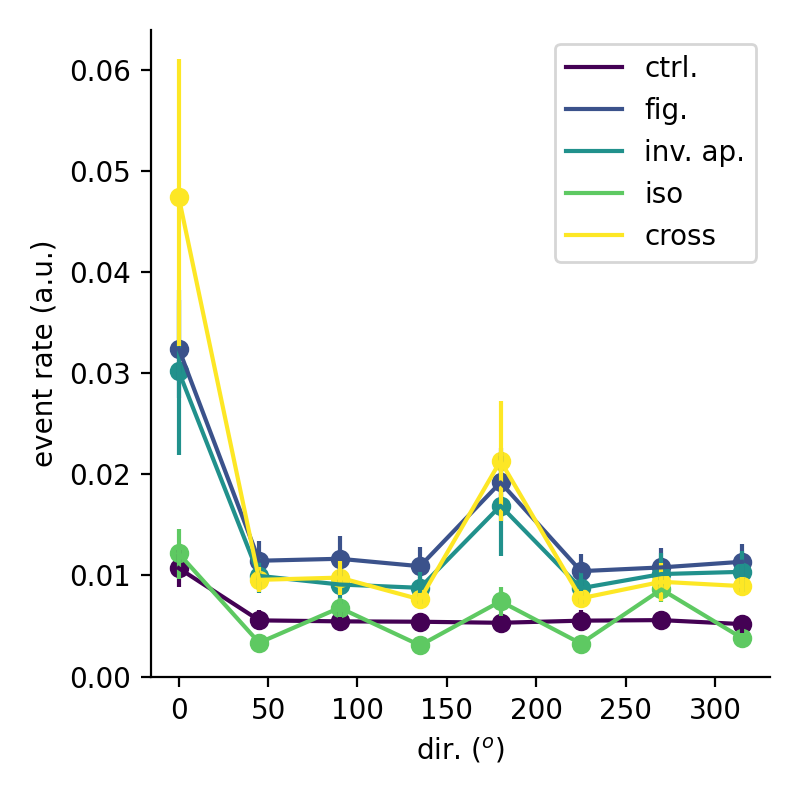

/Users/dan/Documents/code/adesnal/pyute.py:141: RuntimeWarning: Mean of empty slice
  #lb = np.percentile(stat,pct[0],axis=-1) # resampled axis rolled to last position
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyw

0.03267009943611727
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting


In [32]:
plt.figure(figsize=(4,4))
ut.plot_bootstrapped_errorbars_hillel(np.arange(0,360,45),rsexpt[0][1][0],pct=(16,84))
plt.legend(['ctrl.','fig.','inv. ap.','iso','cross'])
plt.xlabel('dir. ($^o$)')
plt.ylabel('event rate (a.u.)')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_figure_ground_average_tuning.eps')

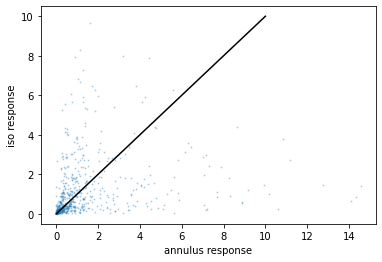

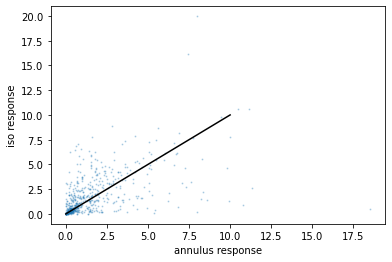

In [35]:
lim = (0,10)
lbl = 'sst'
for irun in range(2):
    plt.figure()
    plt.scatter(matdict['%s_fg_event_rate_norm_aligned'%lbl][:,irun,2],\
                matdict['%s_fg_event_rate_norm_aligned'%lbl][:,irun,3],s=1,alpha=0.25)
    plt.plot(lim,lim,c='k')
    plt.xlabel('annulus response')
    plt.ylabel('iso response')

In [39]:
rso[irun][itype][ialign].shape

(636, 5, 8)

In [41]:
rsexpt[irun][itype][ialign].shape

(13, 5, 8)

In [ ]:
plt.figure()
istim = 3
plt.scatter(sst_fg_event_rate[:,0,istim],sst_fg_event_rate[:,1,istim])
plt.plot((0,0.5),(0,0.5),c='k',linestyle='dashed')

In [ ]:
irun = 1
plt.figure(figsize=(5,5))
cs = [np.array((0,0.5,0)),np.array((0,0,0)),np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1))]
celltype_lbls = ['L4 PC','L2/3 PC','SST','VIP','PV']

for iitype,itype in enumerate([1,4,2,3]):

    plt.subplot(2,2,iitype+1)
    istim1,istim2 = 3,4
    mx = np.nanpercentile(all_fg_event_rate[itype],99.9)
    plt.scatter(all_fg_event_rate[itype][:,irun,istim1],all_fg_event_rate[itype][:,irun,istim2],s=5,c=cs[itype])
    plt.plot((0,mx),(0,mx),c='k',linestyle='dashed')
    plt.xlim((-0.02*mx,mx))
    plt.ylim((-0.02*mx,mx))
    plt.xlabel('event rate, iso')
    plt.ylabel('event rate, cross')
    plt.title(celltype_lbls[itype])
plt.tight_layout()
plt.savefig('figures/four_celltypes_iso_cross_scatter_plots_non_normalized.eps')


<IPython.core.display.Javascript object>


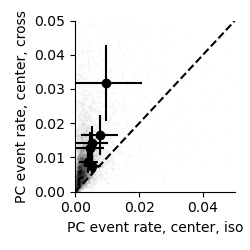

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


<IPython.core.display.Javascript object>


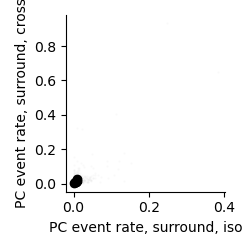

<IPython.core.display.Javascript object>


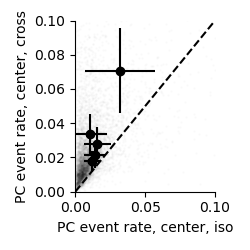

<IPython.core.display.Javascript object>


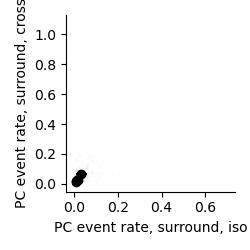

In [57]:
space_lbls = ['center','surround']
stim_lbls = ['ctrl','figure','ground','iso','cross']
running_lbls = ['non_running','running']
type_lbls = ['','PC','SST','VIP','']

c_expt = 'k'
c_cell = 'k'
alpha_cell = 0.01
s_cell = 1

lim = (0,0.05)
irun = 0
itype = 3
ialign1 = 0
ialign2 = 1
lim = [[[None for _ in r] for r in s] for s in rso]
lim[0][1][0] = (0,0.05)
lim[1][1][0] = (0,0.1)

bad_ind = 10

for itype in [1]:
    for irun in range(2):

#         lkat = np.ones((rsexpt[irun][itype][ialign1].shape[0],),dtype='bool')
#         lkat[bad_ind] = False
        
#         lkat_cell = np.ones((rso[irun][itype][ialign1].shape[0],),dtype='bool')
#         lkat_cell[expt_ids[irun][itype][ialign] == bad_ind] = False

#         for istim in [3,4]:
#             plt.figure(figsize=(2.5,2.5))
#             xdata = np.nanmean(rsexpt[irun][itype][ialign1],2)[:,istim][lkat]
#             ydata = np.nanmean(rsexpt[irun][itype][ialign2],2)[:,istim][lkat]
#             xerr = np.nanmean(rsexpt_sem[irun][itype][ialign1],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
#             yerr = np.nanmean(rsexpt_sem[irun][itype][ialign2],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
#             plt.scatter(xdata,ydata)
#             plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none')
#             plt.plot(lim,lim,c='k',linestyle='dashed')
#             ut.erase_top_right()
#             plt.xlim(lim)
#             plt.ylim(lim)
#             plt.xlabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign1],stim_lbls[istim]))
#             plt.ylabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign2],stim_lbls[istim]))
#             plt.tight_layout()
# #             plt.savefig('figures/%s_fg_event_rate_%s_%s_%s_vs_%s.eps'%(type_lbls[itype],stim_lbls[istim],running_lbls[irun],space_lbls[ialign2],space_lbls[ialign1]))


        istim1 = 3
        istim2 = 4
        for ialign in [0,1]:
            
            if itype == 1:
                lkat = np.ones((rsexpt[irun][itype][ialign].shape[0],),dtype='bool')
                lkat[bad_ind] = False

                lkat_cell = np.ones((rso[irun][itype][ialign].shape[0],),dtype='bool')
                lkat_cell[expt_ids[irun][itype][ialign] == bad_ind] = False
            
            plt.figure(figsize=(2.5,2.5))
            xdata = np.nanmean(rsexpt[irun][itype][ialign],2)[:,istim1][lkat]
            ydata = np.nanmean(rsexpt[irun][itype][ialign],2)[:,istim2][lkat]
            xerr = np.nanmean(rsexpt_sem[irun][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
            yerr = np.nanmean(rsexpt_sem[irun][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
            plt.scatter(xdata,ydata,c=c_expt)
            plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none',c=c_expt)
            
            xdata = np.nanmean(rso[irun][itype][ialign],2)[:,istim1][lkat_cell]
            ydata = np.nanmean(rso[irun][itype][ialign],2)[:,istim2][lkat_cell]
            plt.scatter(xdata,ydata,c=c_cell,s=s_cell,alpha=alpha_cell)
            
            ut.erase_top_right()
            if not lim[irun][itype][ialign] is None:
                plt.plot(lim[irun][itype][ialign],lim[irun][itype][ialign],c='k',linestyle='dashed')
                plt.xlim(lim[irun][itype][ialign])
                plt.ylim(lim[irun][itype][ialign])
            plt.xlabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim1]))
            plt.ylabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim2]))
            plt.tight_layout()
            plt.savefig('figures/%s_fg_event_rate_%s_%s_%s_vs_%s.jpg'%(type_lbls[itype],space_lbls[ialign],running_lbls[irun],stim_lbls[istim1],stim_lbls[istim2]),dpi=300)

#     irun1 = 0
#     irun2 = 1
#     for istim in [3,4]:
#         for ialign in [0,1]:
            
#             if itype == 1:
#                 lkat = np.ones((rsexpt[irun][itype][ialign].shape[0],),dtype='bool')
#                 lkat[bad_ind] = False

#                 lkat_cell = np.ones((rso[irun][itype][ialign].shape[0],),dtype='bool')
#                 lkat_cell[expt_ids[irun][itype][ialign] == bad_ind] = False
            
#             plt.figure(figsize=(2.5,2.5))
#             xdata = np.nanmean(rsexpt[irun1][itype][ialign],2)[:,istim][lkat]
#             ydata = np.nanmean(rsexpt[irun2][itype][ialign],2)[:,istim][lkat]
#             xerr = np.nanmean(rsexpt_sem[irun1][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun1][itype][ialign].shape[2])
#             yerr = np.nanmean(rsexpt_sem[irun2][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun2][itype][ialign].shape[2])
#             plt.scatter(xdata,ydata,c=c_expt)
#             plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none',c=c_expt)
#             plt.plot(lim,lim,c='k',linestyle='dashed')
#             ut.erase_top_right()
#             plt.xlabel('%s event rate, %s, \n %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim],running_lbls[irun1]))
#             plt.ylabel('%s event rate, %s, \n %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim],running_lbls[irun2]))
#             plt.tight_layout()
# #             plt.savefig('figures/%s_fg_event_rate_%s_%s_%s_vs_%s.eps'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim],running_lbls[irun1],running_lbls[irun2]))

<IPython.core.display.Javascript object>


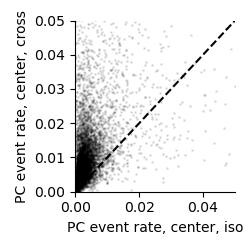

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


<IPython.core.display.Javascript object>


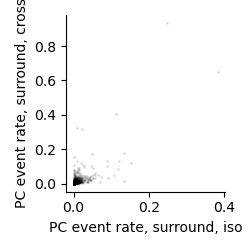

<IPython.core.display.Javascript object>


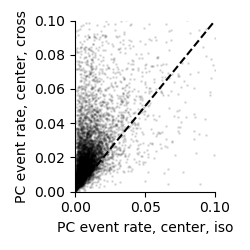

<IPython.core.display.Javascript object>


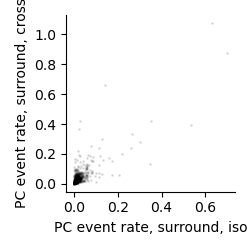

In [56]:
space_lbls = ['center','surround']
stim_lbls = ['ctrl','figure','ground','iso','cross']
running_lbls = ['non_running','running']
type_lbls = ['','PC','SST','VIP','']

c_expt = 'k'
c_cell = 'k'
alpha_cell = 0.01
s_cell = 1

lim = (0,0.05)
irun = 0
itype = 3
ialign1 = 0
ialign2 = 1
lim = [[[None for _ in r] for r in s] for s in rso]
lim[0][1][0] = (0,0.05)
lim[1][1][0] = (0,0.1)

bad_ind = 10

for itype in [1]:
    for irun in range(2):

#         lkat = np.ones((rsexpt[irun][itype][ialign1].shape[0],),dtype='bool')
#         lkat[bad_ind] = False
        
#         lkat_cell = np.ones((rso[irun][itype][ialign1].shape[0],),dtype='bool')
#         lkat_cell[expt_ids[irun][itype][ialign] == bad_ind] = False

#         for istim in [3,4]:
#             plt.figure(figsize=(2.5,2.5))
#             xdata = np.nanmean(rsexpt[irun][itype][ialign1],2)[:,istim][lkat]
#             ydata = np.nanmean(rsexpt[irun][itype][ialign2],2)[:,istim][lkat]
#             xerr = np.nanmean(rsexpt_sem[irun][itype][ialign1],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
#             yerr = np.nanmean(rsexpt_sem[irun][itype][ialign2],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
#             plt.scatter(xdata,ydata)
#             plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none')
#             plt.plot(lim,lim,c='k',linestyle='dashed')
#             ut.erase_top_right()
#             plt.xlim(lim)
#             plt.ylim(lim)
#             plt.xlabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign1],stim_lbls[istim]))
#             plt.ylabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign2],stim_lbls[istim]))
#             plt.tight_layout()
# #             plt.savefig('figures/%s_fg_event_rate_%s_%s_%s_vs_%s.eps'%(type_lbls[itype],stim_lbls[istim],running_lbls[irun],space_lbls[ialign2],space_lbls[ialign1]))


        istim1 = 3
        istim2 = 4
        for ialign in [0,1]:
            
            if itype == 1:
                lkat = np.ones((rsexpt[irun][itype][ialign].shape[0],),dtype='bool')
                lkat[bad_ind] = False

                lkat_cell = np.ones((rso[irun][itype][ialign].shape[0],),dtype='bool')
                lkat_cell[expt_ids[irun][itype][ialign] == bad_ind] = False
            
            plt.figure(figsize=(2.5,2.5))
            xdata = np.nanmean(rsexpt[irun][itype][ialign],2)[:,istim1][lkat]
            ydata = np.nanmean(rsexpt[irun][itype][ialign],2)[:,istim2][lkat]
            xerr = np.nanmean(rsexpt_sem[irun][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
            yerr = np.nanmean(rsexpt_sem[irun][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
#             plt.scatter(xdata,ydata,c=c_expt)
#             plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none',c=c_expt)
            
            xdata = np.nanmean(rso[irun][itype][ialign],2)[:,istim1][lkat_cell]
            ydata = np.nanmean(rso[irun][itype][ialign],2)[:,istim2][lkat_cell]
            plt.scatter(xdata,ydata,c=c_cell,s=s_cell,alpha=alpha_cell*10)
            
            ut.erase_top_right()
            if not lim[irun][itype][ialign] is None:
                plt.plot(lim[irun][itype][ialign],lim[irun][itype][ialign],c='k',linestyle='dashed')
                plt.xlim(lim[irun][itype][ialign])
                plt.ylim(lim[irun][itype][ialign])
            plt.xlabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim1]))
            plt.ylabel('%s event rate, %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim2]))
            plt.tight_layout()
            plt.savefig('figures/%s_fg_event_rate_just_neurons_%s_%s_%s_vs_%s.jpg'%(type_lbls[itype],space_lbls[ialign],running_lbls[irun],stim_lbls[istim1],stim_lbls[istim2]),dpi=300)

#     irun1 = 0
#     irun2 = 1
#     for istim in [3,4]:
#         for ialign in [0,1]:
            
#             if itype == 1:
#                 lkat = np.ones((rsexpt[irun][itype][ialign].shape[0],),dtype='bool')
#                 lkat[bad_ind] = False

#                 lkat_cell = np.ones((rso[irun][itype][ialign].shape[0],),dtype='bool')
#                 lkat_cell[expt_ids[irun][itype][ialign] == bad_ind] = False
            
#             plt.figure(figsize=(2.5,2.5))
#             xdata = np.nanmean(rsexpt[irun1][itype][ialign],2)[:,istim][lkat]
#             ydata = np.nanmean(rsexpt[irun2][itype][ialign],2)[:,istim][lkat]
#             xerr = np.nanmean(rsexpt_sem[irun1][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun1][itype][ialign].shape[2])
#             yerr = np.nanmean(rsexpt_sem[irun2][itype][ialign],2)[:,istim][lkat]/np.sqrt(rsexpt[irun2][itype][ialign].shape[2])
#             plt.scatter(xdata,ydata,c=c_expt)
#             plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none',c=c_expt)
#             plt.plot(lim,lim,c='k',linestyle='dashed')
#             ut.erase_top_right()
#             plt.xlabel('%s event rate, %s, \n %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim],running_lbls[irun1]))
#             plt.ylabel('%s event rate, %s, \n %s, %s'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim],running_lbls[irun2]))
#             plt.tight_layout()
# #             plt.savefig('figures/%s_fg_event_rate_%s_%s_%s_vs_%s.eps'%(type_lbls[itype],space_lbls[ialign],stim_lbls[istim],running_lbls[irun1],running_lbls[irun2]))

In [42]:
expt_ids

[[[array([2., 2., 2., ..., 7., 7., 7.]), array([4., 4., 4., ..., 7., 7., 7.])],
  [array([ 1.,  1.,  1., ..., 12., 12., 12.]),
   array([ 1.,  1.,  1., ..., 12., 12., 12.])],
  [array([3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
          3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
          3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
          3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
          3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3., 3.,
          4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4.,
          4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4.,
          4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4.,
          4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4.,
          4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4., 4.,
          4., 4., 7., 7., 7., 7., 7., 7., 7.,

<IPython.core.display.Javascript object>


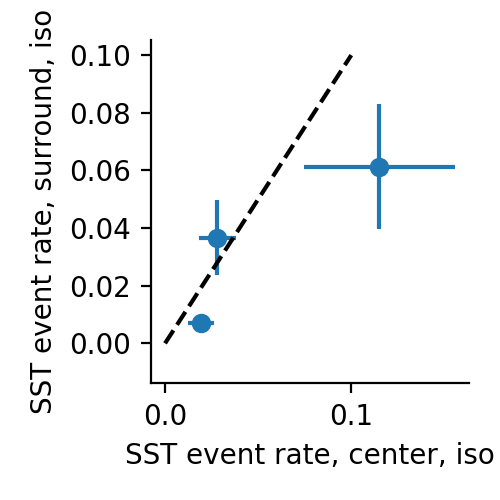

<IPython.core.display.Javascript object>


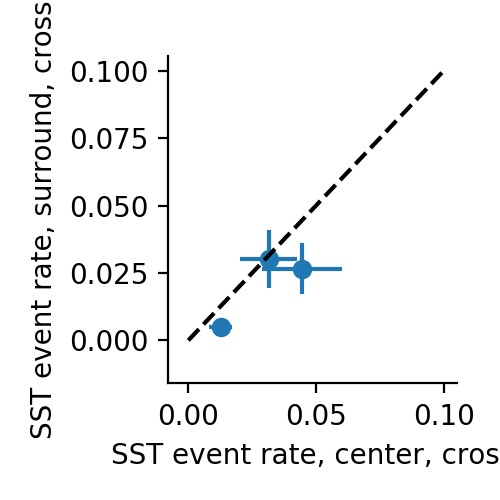

<IPython.core.display.Javascript object>


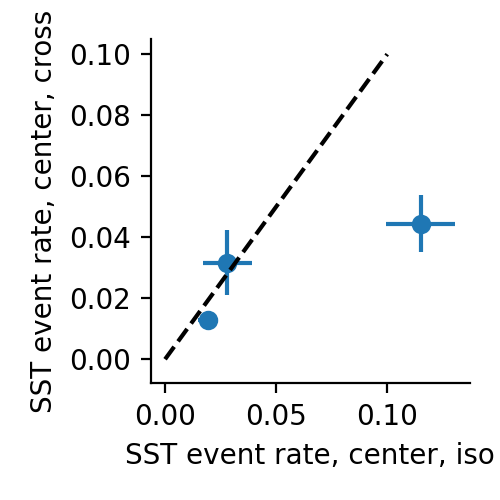

<IPython.core.display.Javascript object>


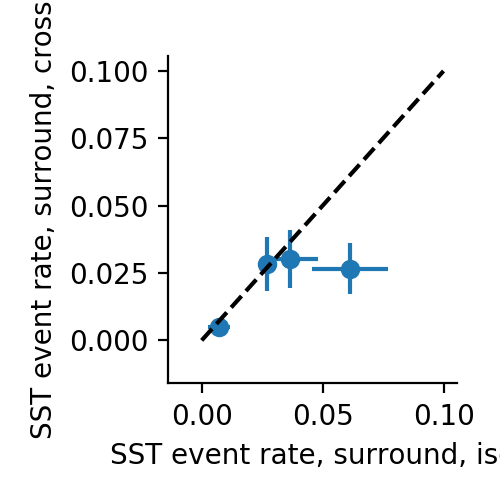

In [85]:
space_lbls = ['center','surround']
stim_lbls = ['ctrl','figure','ground','iso','cross']


lim = (0,0.1)
irun = 0
itype = 2
ialign1 = 0
ialign2 = 1

lkat = np.ones((rsexpt[irun][itype][ialign1].shape[0],),dtype='bool')
lkat[-3] = False

for istim in [3,4]:
    plt.figure(figsize=(2.5,2.5))
    xdata = np.nanmean(rsexpt[irun][itype][ialign1],2)[:,istim][lkat]
    ydata = np.nanmean(rsexpt[irun][itype][ialign2],2)[:,istim][lkat]
    xerr = np.nanmean(rsexpt_sem[irun][itype][ialign1],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
    yerr = np.nanmean(rsexpt_sem[irun][itype][ialign2],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
    plt.scatter(xdata,ydata)
    plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none')
    plt.plot(lim,lim,c='k',linestyle='dashed')
    ut.erase_top_right()
#     plt.xlim(lim)
#     plt.ylim(lim)
    plt.xlabel('SST event rate, %s, %s'%(space_lbls[ialign1],stim_lbls[istim]))
    plt.ylabel('SST event rate, %s, %s'%(space_lbls[ialign2],stim_lbls[istim]))
    plt.tight_layout()
    plt.savefig('figures/sst_fg_event_rate_%s_%s_vs_%s.eps'%(stim_lbls[istim],space_lbls[ialign2],space_lbls[ialign1]))
    
    
istim1 = 3
istim2 = 4
for ialign in [0,1]:
    plt.figure(figsize=(2.5,2.5))
    xdata = np.nanmean(rsexpt[irun][itype][ialign],2)[:,istim1][lkat]
    ydata = np.nanmean(rsexpt[irun][itype][ialign],2)[:,istim2][lkat]
    xerr = np.nanmean(rsexpt_sem[irun][itype][ialign1],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
    yerr = np.nanmean(rsexpt_sem[irun][itype][ialign2],2)[:,istim][lkat]/np.sqrt(rsexpt[irun][itype][ialign1].shape[2])
    plt.scatter(xdata,ydata)
    plt.errorbar(xdata,ydata,yerr=yerr,xerr=xerr,fmt='none')
    plt.plot(lim,lim,c='k',linestyle='dashed')
    ut.erase_top_right()
#     plt.xlim(lim)
#     plt.ylim(lim)
    plt.xlabel('SST event rate, %s, %s'%(space_lbls[ialign],stim_lbls[istim1]))
    plt.ylabel('SST event rate, %s, %s'%(space_lbls[ialign],stim_lbls[istim2]))
    plt.tight_layout()
    plt.savefig('figures/sst_fg_event_rate_%s_%s_vs_%s.eps'%(space_lbls[ialign],stim_lbls[istim1],stim_lbls[istim2]))

In [16]:
irun = 0
np.save('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/rs_200828.npy',{'rs':rso[irun]},allow_pickle=True)

<IPython.core.display.Javascript object>


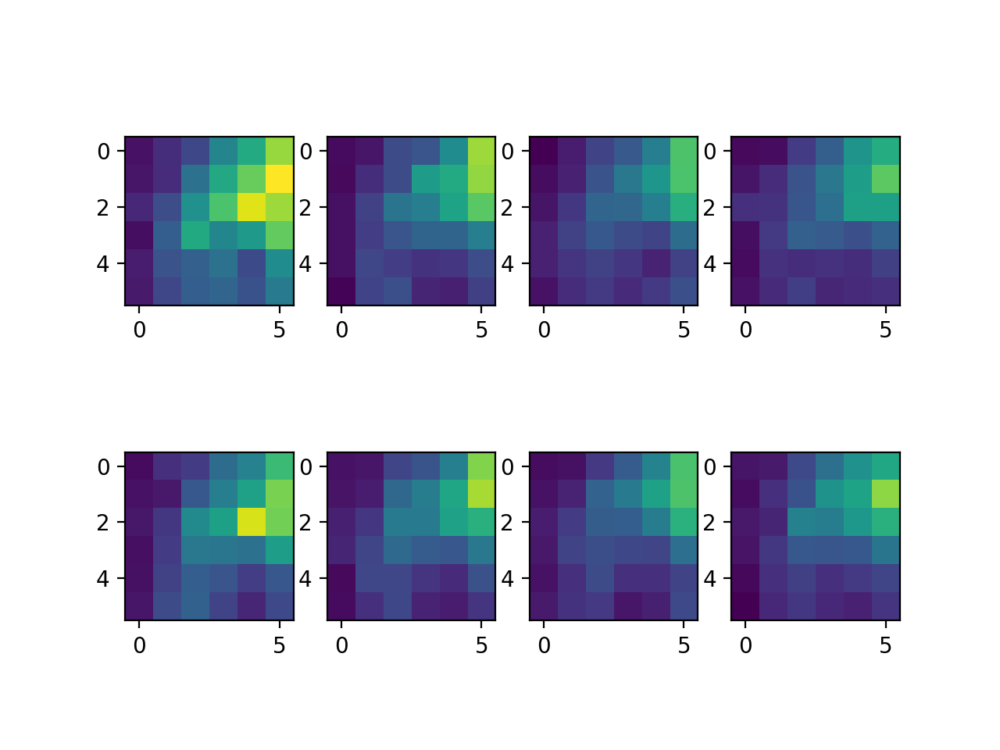

In [17]:
plt.figure()
irun,itype,ialign = 0,4,0
data = np.nanmean(rso[irun][itype][ialign],0)
for idir in range(8):
    plt.subplot(2,4,idir+1)
    plt.imshow(data[:,:,idir],vmin=data.min(),vmax=data.max())

In [370]:
Iexc,Iinh = ut.loadmat('/Users/dan/Documents/data/hillel/data for theorists/Vclamp_contrast_tuning_data.mat',['all_exc_mean_interp','all_inh_mean_interp'])


In [18]:
rrs,rfs = ut.loadmat('/Users/dan/Documents/data/julia/VIPHaloSizeContSizeInterp.mat',['rrs','rfs'])

In [19]:
ucontrast_ephys = [0,5,10,20,40,80]

In [20]:
def norm_lo_hi(data):
    mn = data[:,0:1]
    mx = data[:,-1:]
    return (data-mn)/(mx-mn)

<IPython.core.display.Javascript object>


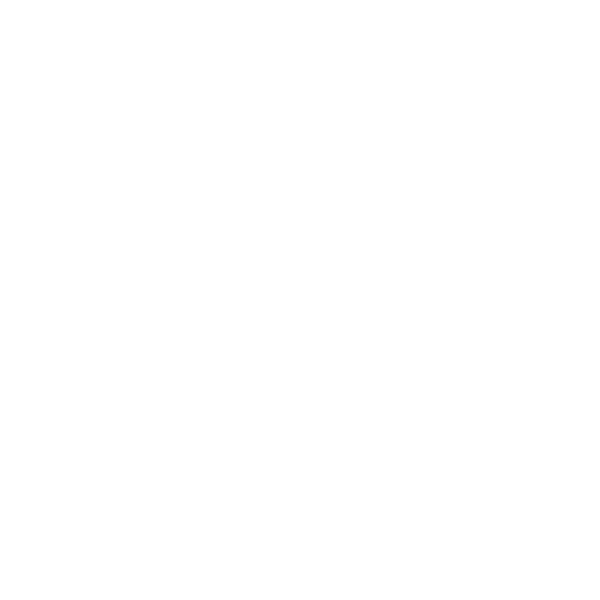

NameError: name 'ucontrast' is not defined

In [21]:
plt.figure(figsize=(3,3))
reload(ut)
for this_irun in range(0,1):
#     plt.subplot(1,2,this_irun+1)
    # ut.plot_bootstrapped_errorbars_hillel(ucontrast,Iinh[1][:,np.newaxis]/Iinh[1].max(-1)[:,np.newaxis,np.newaxis],pct=(16,84))
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,ut.norm01(Iinh[this_irun])[:,np.newaxis],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
    irun,itype,ialign,isize,iangle = this_irun,2,0,2,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
    data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
    irun,itype,ialign,isize,iangle,ilight = 0,4,0,2,0,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
#     data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    data = ut.norm01(rfs[this_irun][:,isize,:,ilight])
#     ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast_ephys,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
    plt.xlabel('contrast (%)')
    plt.ylabel('norm. activity')
    plt.tight_layout()
    plt.savefig('figures/inhibition_currents_and_sources_non_running.eps',dpi=300)
    

<IPython.core.display.Javascript object>


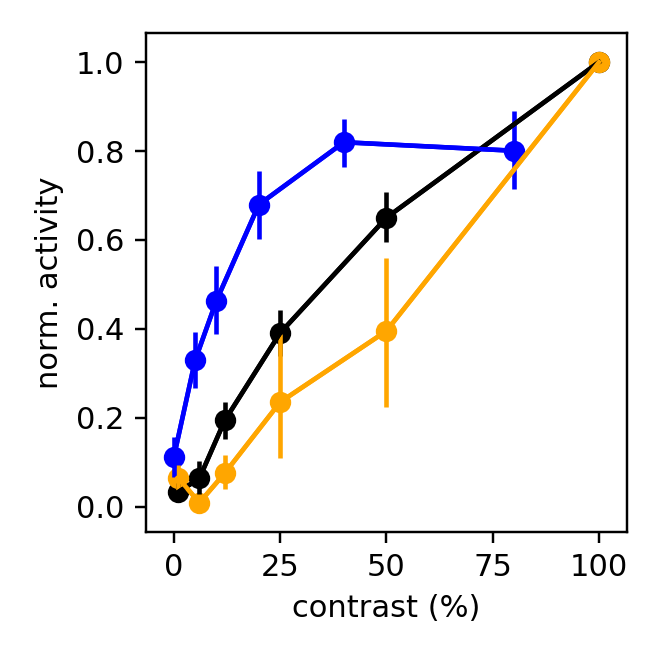

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0
1.0
0.768320090078792


In [364]:
plt.figure(figsize=(3,3))
reload(ut)
for this_irun in range(1,2):
#     plt.subplot(1,2,this_irun+1)
    # ut.plot_bootstrapped_errorbars_hillel(ucontrast,Iinh[1][:,np.newaxis]/Iinh[1].max(-1)[:,np.newaxis,np.newaxis],pct=(16,84))
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,ut.norm01(Iinh[this_irun])[:,np.newaxis],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
    irun,itype,ialign,isize,iangle = this_irun,2,0,2,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
    data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
    irun,itype,ialign,isize,iangle,ilight = 0,4,0,2,0,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
#     data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    data = ut.norm01(rfs[this_irun][:,isize,:,ilight])
#     ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast_ephys,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
    plt.xlabel('contrast (%)')
    plt.ylabel('norm. activity')
    plt.tight_layout()
    plt.savefig('figures/inhibition_currents_and_sources.eps',dpi=300)
    

In [360]:
np.array((0,0,1))[np.newaxis].shape

(1, 3)

<IPython.core.display.Javascript object>


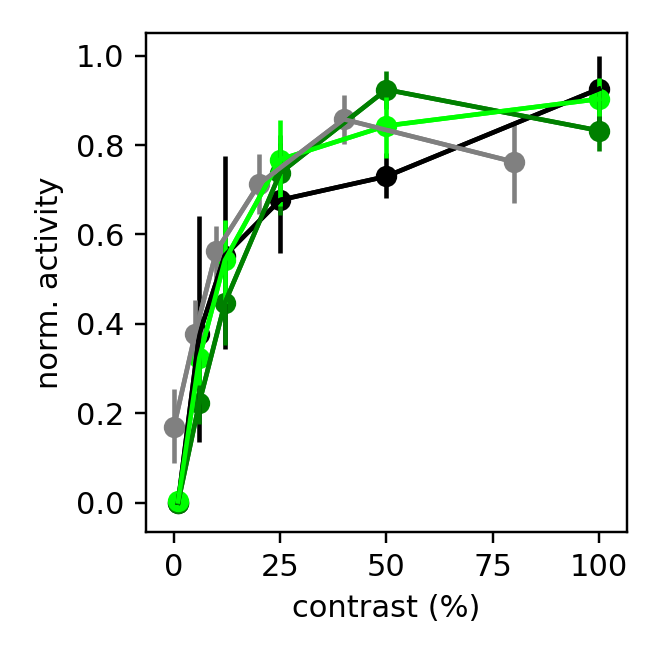

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.8512463118169301
0.88164802767285
0.8571161094363535
0.8037774397561174


In [374]:
plt.figure(figsize=(3,3))
reload(ut)
for this_irun in range(0,1):
#     plt.subplot(1,2,this_irun+1)
    # ut.plot_bootstrapped_errorbars_hillel(ucontrast,Iinh[1][:,np.newaxis]/Iinh[1].max(-1)[:,np.newaxis,np.newaxis],pct=(16,84))
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,ut.norm01(-Iexc[this_irun])[:,np.newaxis],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
    
    irun,itype,ialign,isize,iangle = this_irun,0,0,2,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
    data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0.5,0))[np.newaxis])
    
    irun,itype,ialign,isize,iangle = this_irun,1,0,2,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
    data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])
    
    irun,itype,ialign,isize,iangle,ilight = 0,4,0,2,0,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
#     data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    data = ut.norm01(rrs[this_irun][:,isize,:,ilight])
#     ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast_ephys,data[:,np.newaxis],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

    plt.xlabel('contrast (%)')
    plt.ylabel('norm. activity')
    plt.tight_layout()
    
    plt.savefig('figures/excitation_currents_and_sources_non_running.eps',dpi=300)

<IPython.core.display.Javascript object>


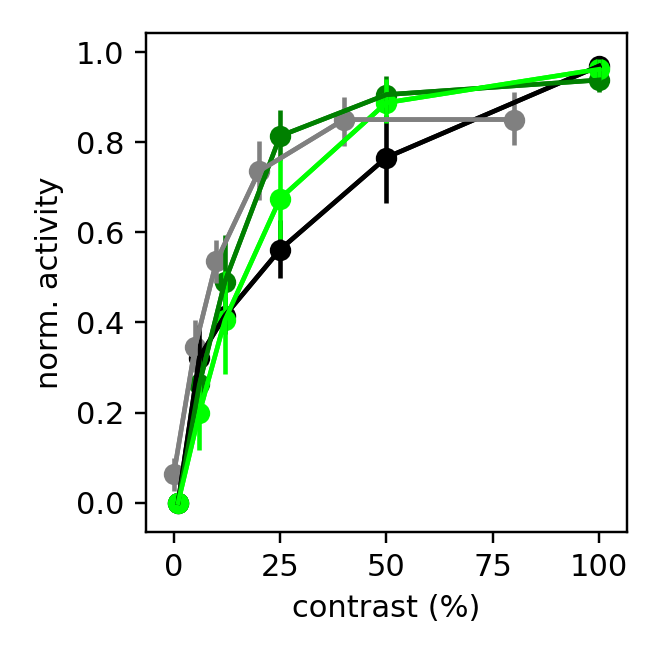

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.9461587452300404
0.9114238703291512
0.9388410592724732
0.7995856223187712


In [372]:
plt.figure(figsize=(3,3))
reload(ut)
for this_irun in range(1,2):
#     plt.subplot(1,2,this_irun+1)
    # ut.plot_bootstrapped_errorbars_hillel(ucontrast,Iinh[1][:,np.newaxis]/Iinh[1].max(-1)[:,np.newaxis,np.newaxis],pct=(16,84))
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,ut.norm01(-Iexc[this_irun])[:,np.newaxis],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
    
    irun,itype,ialign,isize,iangle = this_irun,0,0,2,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
    data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0.5,0))[np.newaxis])
    
    irun,itype,ialign,isize,iangle = this_irun,1,0,2,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
    data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])
    
    irun,itype,ialign,isize,iangle,ilight = 0,4,0,2,0,0
    # data = rsexpt[irun][itype][ialign][:,isize,:,iangle]
#     data = ut.norm01(rsexpt[irun][itype][ialign][:,isize,:,iangle])
    data = ut.norm01(rrs[this_irun][:,isize,:,ilight])
#     ut.plot_bootstrapped_errorbars_hillel(ucontrast,data[:,np.newaxis],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
    ut.plot_bootstrapped_errorbars_hillel(ucontrast_ephys,data[:,np.newaxis],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

    plt.xlabel('contrast (%)')
    plt.ylabel('norm. activity')
    plt.tight_layout()
    
    plt.savefig('figures/excitation_currents_and_sources.eps',dpi=300)

In [444]:
print([rs[irun][1][0].shape for irun in range(2)])

[(8870, 6, 6, 8), (5688, 6, 6, 8)]


In [445]:
print([expt_ids[irun][1][0].shape for irun in range(2)])

[(8870,), (5688,)]


In [491]:
data2.shape

(3972, 6, 6, 8)

<IPython.core.display.Javascript object>


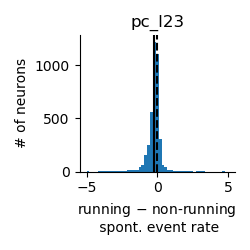

<IPython.core.display.Javascript object>


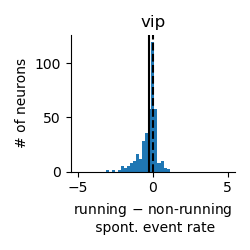

In [515]:
ialign = 0
for itype in [1,3]:
    these_expt_ids = [np.unique(expt_ids[irun][itype][ialign]).astype('int') for irun in range(2)]
    shared_expt_ids = [val for val in these_expt_ids[0] if val in these_expt_ids[1]]
#     plt.figure()
    data1,data2 = [rs[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
#     plt.scatter(np.nanmean(np.nanmean(np.nanmean(data1[:,:,0:1,:],1),1),1),np.nanmean(np.nanmean(np.nanmean(data2[:,:,0:1,:],1),1),1))
#     mx = np.nanmax(data1)/10
#     plt.plot((0,mx),(0,mx),c='k')
    plt.figure(figsize=(2.5,2.5))
    dif = -np.nanmean(np.nanmean(np.nanmean(data1[:,:,0:1,:],1),1),1)+np.nanmean(np.nanmean(np.nanmean(data2[:,:,0:1,:],1),1),1)
    plt.hist(dif,bins=np.linspace(-5,5,50))
    plt.axvline(0,c='k',linestyle='dashed')
    plt.axvline(np.nanmean(dif),c='k')
    plt.title(lbls[itype])
    plt.ylabel('# of neurons')
    plt.xlabel('running $-$ non-running \n spont. event rate')
    ut.erase_top_right()
    plt.tight_layout()
    plt.savefig('figures/%s_spont_running_effect.eps'%lbls[itype])

<IPython.core.display.Javascript object>


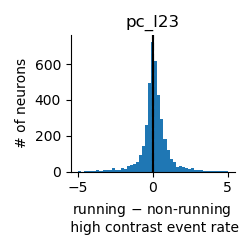

<IPython.core.display.Javascript object>


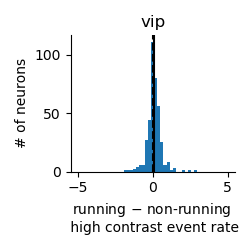

In [514]:
ialign = 0
for itype in [1,3]:
    these_expt_ids = [np.unique(expt_ids[irun][itype][ialign]).astype('int') for irun in range(2)]
    shared_expt_ids = [val for val in these_expt_ids[0] if val in these_expt_ids[1]]
#     plt.figure()
    data1,data2 = [rs[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
#     plt.scatter(np.nanmean(np.nanmean(np.nanmean(data1[:,:,0:1,:],1),1),1),np.nanmean(np.nanmean(np.nanmean(data2[:,:,0:1,:],1),1),1))
#     mx = np.nanmax(data1)/10
#     plt.plot((0,mx),(0,mx),c='k')
    plt.figure(figsize=(2.5,2.5))
    dif = -np.nanmean(np.nanmean(np.nanmean(data1[:,:,5:6,:],1),1),1)+np.nanmean(np.nanmean(np.nanmean(data2[:,:,5:6,:],1),1),1)
    plt.hist(dif,bins=np.linspace(-5,5,50))
    plt.axvline(0,c='k',linestyle='dashed')
    plt.axvline(np.nanmean(dif),c='k')
    plt.title(lbls[itype])
    plt.ylabel('# of neurons')
    plt.xlabel('running $-$ non-running \n high contrast event rate')
    ut.erase_top_right()
    plt.tight_layout()
    plt.savefig('figures/%s_high_contrast_running_effect.eps'%lbls[itype])

<IPython.core.display.Javascript object>


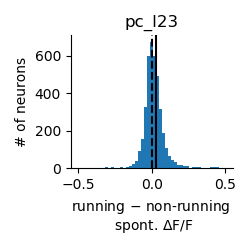

<IPython.core.display.Javascript object>


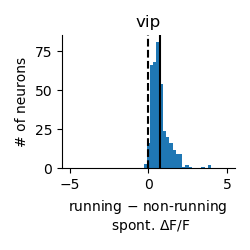

In [523]:
ialign = 0
for itype,bins in zip([1,3],[np.linspace(-0.5,0.5,50),np.linspace(-5,5,50)]):
    these_expt_ids = [np.unique(expt_ids[irun][itype][ialign]).astype('int') for irun in range(2)]
    shared_expt_ids = [val for val in these_expt_ids[0] if val in these_expt_ids[1]]
#     plt.figure()
    data1,data2 = [rs_f[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
#     plt.scatter(np.nanmean(np.nanmean(np.nanmean(data1[:,:,0:1,:],1),1),1),np.nanmean(np.nanmean(np.nanmean(data2[:,:,0:1,:],1),1),1))
#     mx = np.nanmax(data1)/10
#     plt.plot((0,mx),(0,mx),c='k')
    plt.figure(figsize=(2.5,2.5))
    dif = -np.nanmean(np.nanmean(np.nanmean(data1[:,:,0:1,:],1),1),1)+np.nanmean(np.nanmean(np.nanmean(data2[:,:,0:1,:],1),1),1)
    plt.hist(dif,bins=bins)
    plt.axvline(0,c='k',linestyle='dashed')
    plt.axvline(np.nanmean(dif),c='k')
    plt.title(lbls[itype])
    plt.ylabel('# of neurons')
    plt.xlabel('running $-$ non-running \n spont. $\Delta$F/F')
    ut.erase_top_right()
    plt.tight_layout()
    plt.savefig('figures/%s_spont_running_effect_dfof.eps'%lbls[itype])

<IPython.core.display.Javascript object>


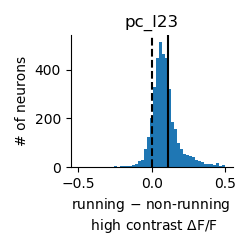

<IPython.core.display.Javascript object>


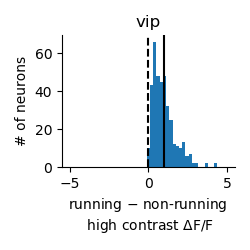

In [524]:
ialign = 0
for itype,bins in zip([1,3],[np.linspace(-0.5,0.5,50),np.linspace(-5,5,50)]):
    these_expt_ids = [np.unique(expt_ids[irun][itype][ialign]).astype('int') for irun in range(2)]
    shared_expt_ids = [val for val in these_expt_ids[0] if val in these_expt_ids[1]]
#     plt.figure()
    data1,data2 = [rs_f[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
#     plt.scatter(np.nanmean(np.nanmean(np.nanmean(data1[:,:,0:1,:],1),1),1),np.nanmean(np.nanmean(np.nanmean(data2[:,:,0:1,:],1),1),1))
#     mx = np.nanmax(data1)/10
#     plt.plot((0,mx),(0,mx),c='k')
    plt.figure(figsize=(2.5,2.5))
    dif = -np.nanmean(np.nanmean(np.nanmean(data1[:,:,5:6,:],1),1),1)+np.nanmean(np.nanmean(np.nanmean(data2[:,:,5:6,:],1),1),1)
    plt.hist(dif,bins=bins)
    plt.axvline(0,c='k',linestyle='dashed')
    plt.axvline(np.nanmean(dif),c='k')
    plt.title(lbls[itype])
    plt.ylabel('# of neurons')
    plt.xlabel('running $-$ non-running \n high contrast $\Delta$F/F')
    ut.erase_top_right()
    plt.tight_layout()
    plt.savefig('figures/%s_high_contrast_running_effect_dfof.eps'%lbls[itype])

<IPython.core.display.Javascript object>


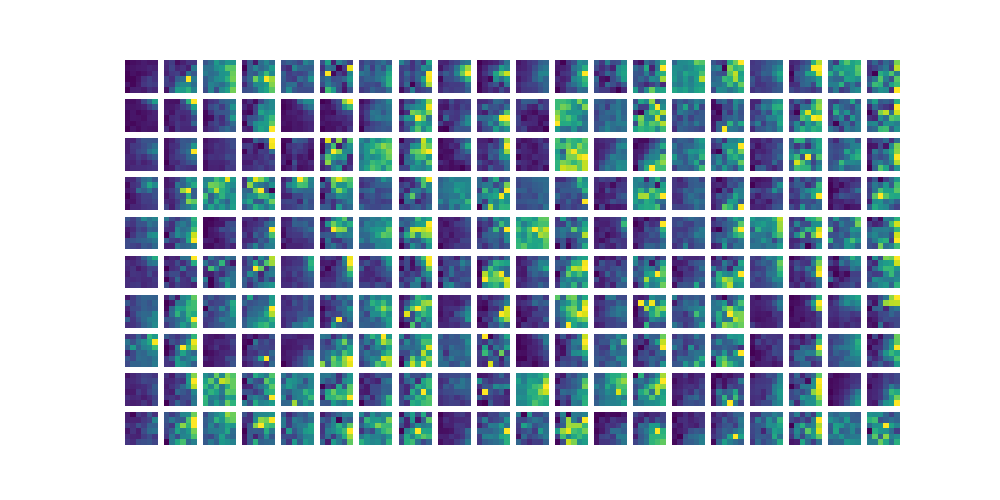

<IPython.core.display.Javascript object>


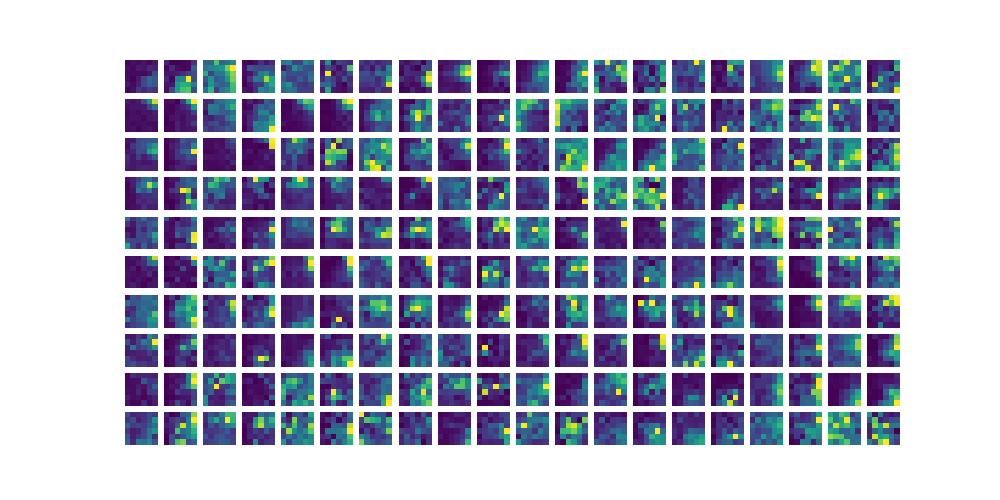

<IPython.core.display.Javascript object>


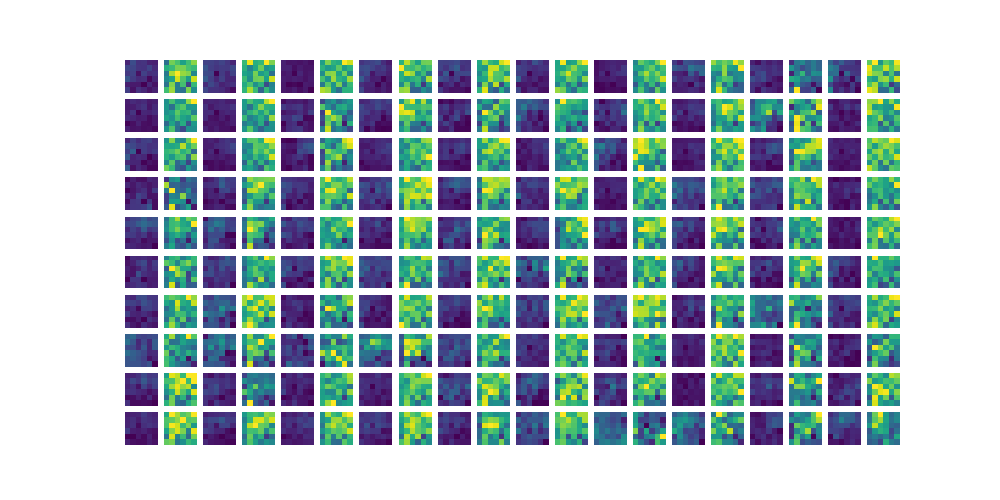

<IPython.core.display.Javascript object>


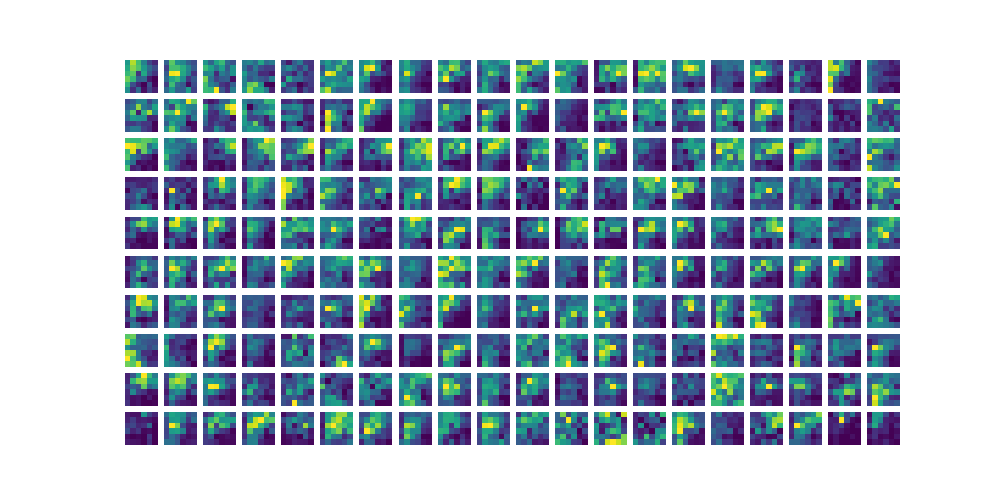

In [547]:
ialign = 0
for itype in [1,3]:#,bins in zip([1,3],[np.linspace(-0.5,0.5,50),np.linspace(-5,5,50)]):
    these_expt_ids = [np.unique(expt_ids[irun][itype][ialign]).astype('int') for irun in range(2)]
    shared_expt_ids = [val for val in these_expt_ids[0] if val in these_expt_ids[1]]
    data1,data2 = [rs[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
    data1f,data2f = [rs_f[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
    
    rg = slice(-100,None)
    ut.imshow_in_pairs(np.nanmean(data1f[rg],3),np.nanmean(data2f[rg],3))
    ut.imshow_in_pairs(np.nanmean(data1[rg],3),np.nanmean(data2[rg],3))

In [573]:
np.save('../shared_data/decon_dfof_tavg_comparison.npy',{'rs':rs,'rs_f':rs_f,'expt_ids':expt_ids})

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


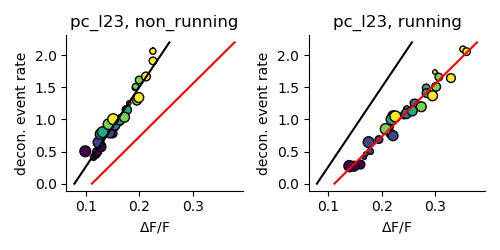

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:14: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:19: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


<IPython.core.display.Javascript object>


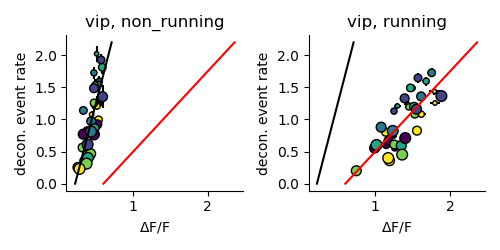

In [572]:
ialign = 0
for itype in [1,3]:#,bins in zip([1,3],[np.linspace(-0.5,0.5,50),np.linspace(-5,5,50)]):
    these_expt_ids = [np.unique(expt_ids[irun][itype][ialign]).astype('int') for irun in range(2)]
    shared_expt_ids = [val for val in these_expt_ids[0] if val in these_expt_ids[1]]
    data1,data2 = [rs[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
    data1f,data2f = [rs_f[irun][itype][ialign][np.in1d(expt_ids[irun][itype][ialign],shared_expt_ids)] for irun in range(2)]
    
    plt.figure(figsize=(5,2.5))
    
    for iplot,(xdata,ydata,c) in enumerate(zip([np.nanmean(data1f,3),np.nanmean(data2f,3)],[np.nanmean(data1,3),np.nanmean(data2,3)],['k','r'])):
        slope,intercept,_,_,_ = sst.linregress(np.nanmean(xdata,0)[~np.isnan(np.nanmean(xdata,0))],np.nanmean(ydata,0)[~np.isnan(np.nanmean(ydata,0))])
        y = np.array((0,2.2))
        for this_iplot in range(2):
            plt.subplot(1,2,this_iplot+1)
            plt.title('%s, %s'%(lbls[itype],running_lbls[this_iplot]))
            plt.plot((y-intercept)/slope,y,c=c)
        
    for iplot,(xdata,ydata,c) in enumerate(zip([np.nanmean(data1f,3),np.nanmean(data2f,3)],[np.nanmean(data1,3),np.nanmean(data2,3)],['k','r'])):
        plt.subplot(1,2,iplot+1)
#         xdata,ydata = np.nanmean(data1,3),np.nanmean(data1f,3)
        sca.scatter_size_contrast_errorbar(xdata,ydata,equality_line=False,square=False)
        ut.erase_top_right()
        plt.xlabel('$\Delta$F/F')
        plt.ylabel('decon. event rate')
    plt.tight_layout()
    plt.savefig('figures/decon_vs_dfof_running_non_running_%s.eps'%lbls[itype])
#         plt.subplot(1,2,2)
#         sca.scatter_size_contrast_errorbar(np.nanmean(data2,3),np.nanmean(data2f,3),equality_line=False,square=False)
#         ut.erase_top_right()
#         plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


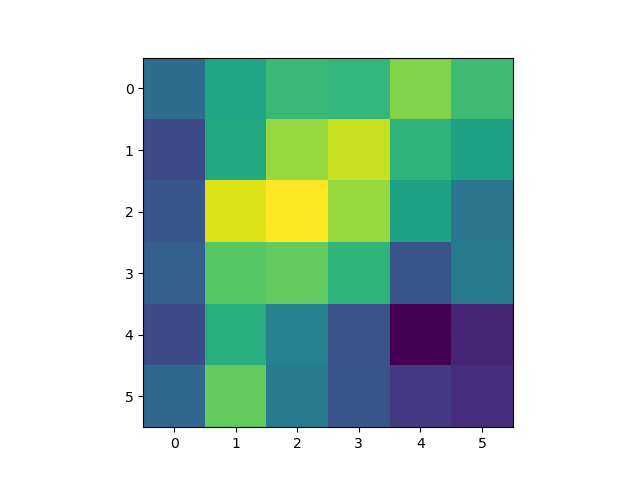

In [566]:
plt.figure()
plt.imshow(np.nanmean(np.nanmean(data2,3),0))

In [81]:
lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = np.array((0.5,0.5,0.5))
c_sst = np.array((1,0.65,0))
c_vip = np.array((1,0,1))
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

In [780]:
import naka_rushton_analysis as nra

In [781]:
def combine_sem(sem,axis=0):
    n_non_nan = np.sum(~np.isnan(sem),axis=axis)
    this_sem = np.sqrt(np.nansum(sem**2,axis=axis))/n_non_nan
    return this_sem

0
1
2
3
4
5
6
7
8
9


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


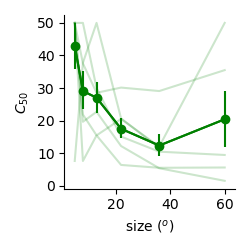

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


35.87089740296599
0
1
2
3
4
5
6
7
8
9
10
11
12


<IPython.core.display.Javascript object>


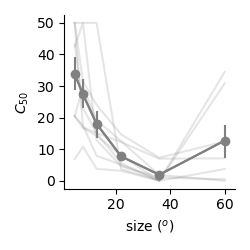

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


28.739483829462078
0
1
2
3
4
5
6


<IPython.core.display.Javascript object>


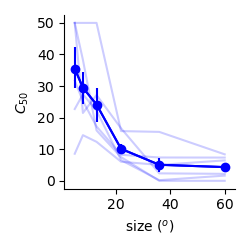

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


29.28699108819839
0
1
2
3
4
5
6
7
8
9


<IPython.core.display.Javascript object>


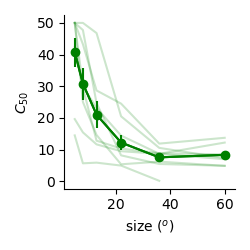

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


36.04726269429956
0
1
2
3
4
5
6
7
8
9
10
11
12


<IPython.core.display.Javascript object>


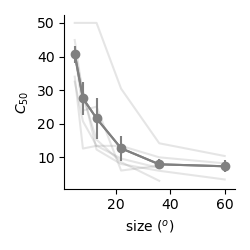

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


38.097212758054546
0
1
2
3
4
5
6


<IPython.core.display.Javascript object>


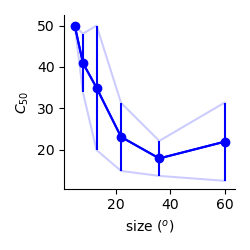

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


49.99999999999999
0
1
2
3
4
5
6
7
8
9


<IPython.core.display.Javascript object>


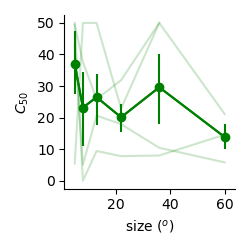

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


27.419176236225223
0
1
2
3
4
5
6
7
8
9
10
11
12


<IPython.core.display.Javascript object>


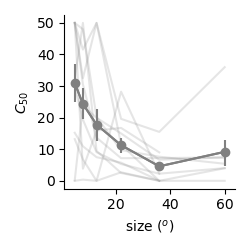

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


24.876156123639504
0
1
2
3
4
5
6


<IPython.core.display.Javascript object>


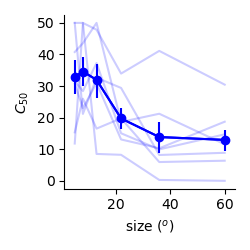

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


30.105656982547586
0
1
2
3
4
5
6
7
8
9


<IPython.core.display.Javascript object>


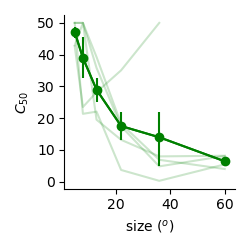

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


45.27750140976161
0
1
2
3
4
5
6
7
8
9
10
11
12


<IPython.core.display.Javascript object>


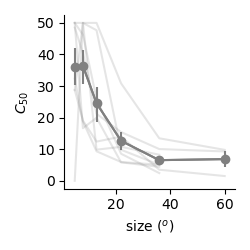

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


30.681182115388335
0
1
2
3
4
5
6


<IPython.core.display.Javascript object>


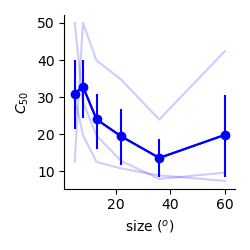

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


24.274877678303305


In [72]:
lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = np.array((0.5,0.5,0.5))
c_sst = np.array((1,0.65,0))
c_vip = np.array((1,0,1))
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
import naka_rushton_analysis as nra
reload(nra)
ucontrast = np.array([0,6,12,25,50,100])
c50mis = [None for ialign in range(2)]
c50s = [None for ialign in range(2)]
cmax = 5
for ialign in range(2):
    c50mis[ialign] = [None for irun in range(2)]
    c50s[ialign] = [None for irun in range(2)]
    for irun in range(2):
        c50mis[ialign][irun] = [None for itype in range(5)]
        c50s[ialign][irun] = [None for itype in range(5)]
        for itype in [0,1,4]:
#             irun,ialign = 0,0
            nroi = rsexpt[irun][itype][ialign].shape[0]
            c50s[ialign][irun][itype] = np.nan*np.ones((nroi,6))
            for iroi in range(nroi):
                print(iroi)
            #     this_data,this_error = rs[irun][itype][ialign][iroi],rs_sem[irun][itype][ialign][iroi]
            #     this_data = np.nanmean(this_data,2)
            #     this_error = combine_sem(this_error,2)
                this_data = np.nanmean(rsexpt[irun][itype][ialign][iroi],2)
                lkat = np.all(~np.isnan(this_data),1)
                nparams = np.sum(lkat)
                opt_params = nra.fit_opt_params_two_n(ucontrast[:cmax],this_data[lkat,:cmax])
#                 opt_params = nra.fit_opt_params(ucontrast[:cmax],this_data[lkat,:cmax])
                c50s[ialign][irun][itype][iroi,lkat] = opt_params[nparams+1:2*nparams+1]
            c50mis[ialign][irun][itype] = c50s[ialign][irun][itype][:,0]-c50s[ialign][irun][itype][:,-1]

            plt.figure(figsize=(2.5,2.5))
            plt.plot(usize,c50s[ialign][irun][itype].T,alpha=0.2,c=colors[itype])
            ut.plot_bootstrapped_errorbars_hillel(usize,c50s[ialign][irun][itype][:,np.newaxis],pct=(16,84),colors=np.array(colors[itype])[np.newaxis])
            plt.xlabel('size ($^o$)')
            plt.ylabel('$C_{50}$')
            ut.erase_top_right()
            plt.tight_layout()
            plt.savefig('figures/%s_c50_by_size_%s_%s.jpg'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]),dpi=300)

In [163]:
this_data.shape

(6, 6)

In [68]:
import naka_rushton_analysis as nra
reload(nra)
ucontrast = np.array([0,6,12,25,50,100])
c50mis = [None for ialign in range(2)]
c50s = [None for ialign in range(2)]
cmax = 5
for ialign in range(1):
    c50mis[ialign] = [None for irun in range(2)]
    c50s[ialign] = [None for irun in range(2)]
    for irun in range(1):
        c50mis[ialign][irun] = [None for itype in range(5)]
        c50s[ialign][irun] = [None for itype in range(5)]
        for itype in [1]:
#             irun,ialign = 0,0
            nroi = rsexpt[irun][itype][ialign].shape[0]
            c50s[ialign][irun][itype] = np.nan*np.ones((nroi,6))
            for iroi in range(nroi):
                print(iroi)
            #     this_data,this_error = rs[irun][itype][ialign][iroi],rs_sem[irun][itype][ialign][iroi]
            #     this_data = np.nanmean(this_data,2)
            #     this_error = combine_sem(this_error,2)
                this_data = np.nanmean(rsexpt[irun][itype][ialign][iroi],2)
                this_sem = np.nanmean(rs_sem[irun][itype][ialign][iroi],2)
                this_data[:,0] = np.nanmean(this_data[:,0])
                lkat = np.all(~np.isnan(this_data),1)
                nparams = np.sum(lkat)
#                 opt_params = nra.fit_opt_params_two_n(ucontrast[:cmax],this_data[lkat,:cmax],)
                opt_params = nra.fit_opt_params(ucontrast[:cmax],this_data[lkat,:cmax])
                c50s[ialign][irun][itype][iroi,lkat] = opt_params[nparams+1:2*nparams+1]
                plt.figure()
                x = np.arange(100)
#                 nr_data = nra.naka_rushton_two_n(x,opt_params,lkat.sum())
                nr_data = nra.naka_rushton(x,opt_params,lkat.sum())
                iisize = 0
                for isize in range(6):
                    if lkat[isize]:
                        plt.subplot(2,3,isize+1)
                        plt.plot(ucontrast,this_data[isize])
                        plt.plot(x,nr_data[iisize])
                    iisize = iisize+1
            c50mis[ialign][irun][itype] = c50s[ialign][irun][itype][:,0]-c50s[ialign][irun][itype][:,-1]

            plt.figure(figsize=(2.5,2.5))
            plt.plot(usize,c50s[ialign][irun][itype].T,alpha=0.2,c=colors[itype])
            ut.plot_bootstrapped_errorbars_hillel(usize,c50s[ialign][irun][itype][:,np.newaxis],pct=(16,84),colors=np.array(colors[itype])[np.newaxis])
            plt.xlabel('size ($^o$)')
            plt.ylabel('$C_{50}$')
            ut.erase_top_right()
            plt.tight_layout()
#             plt.savefig('figures/%s_c50_by_size_%s_%s.jpg'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]),dpi=300)

0


ValueError: all the input arrays must have same number of dimensions, but the array at index 0 has 1 dimension(s) and the array at index 2 has 0 dimension(s)

In [190]:
pdb.pm()

> <__array_function__ internals>(6)concatenate()
(Pdb) u
> /Users/dan/Documents/code/adesnal/naka_rushton_analysis.py(28)fit_opt_params()
-> params_0 = np.concatenate((a_0,(b_0,),c50_0,(n_0,)))
(Pdb) b_0
0
(Pdb) a_0
array([], dtype=float64)
(Pdb) u
> <ipython-input-189-21996c3e8d65>(28)<module>()
-> opt_params = nra.fit_opt_params(ucontrast[:cmax],this_data[lkat,:cmax])
(Pdb) cmax
5
(Pdb) lkat.sum()
0
(Pdb) exit


0
1
2
3
4
5
6
7
8
9


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:43: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


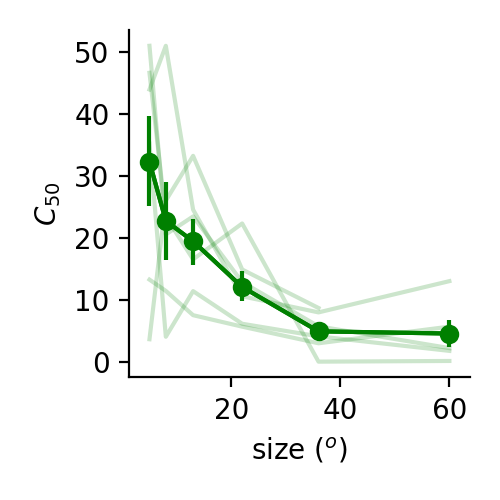

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


24.818674138432286
0
1
2
3
4
5
6
7
8
9
10
11
12


<IPython.core.display.Javascript object>


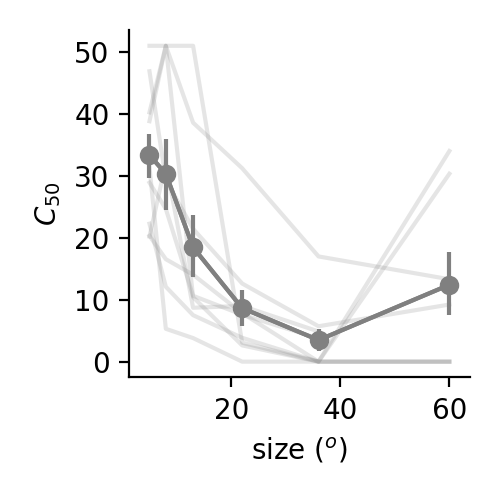

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


29.866983710564497
0
1
2
3
4
5
6


<IPython.core.display.Javascript object>


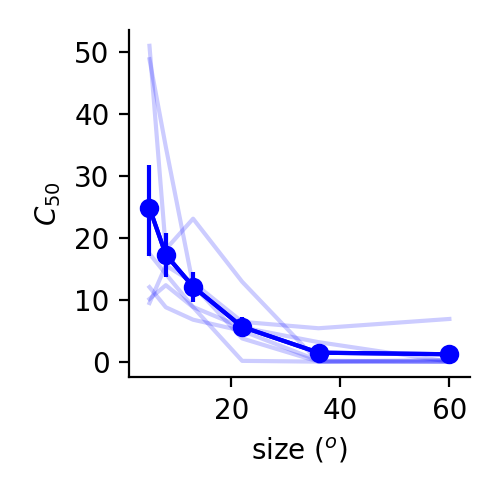

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


17.91713835655445
0
1
2
3
4
5
6
7
8
9


<IPython.core.display.Javascript object>


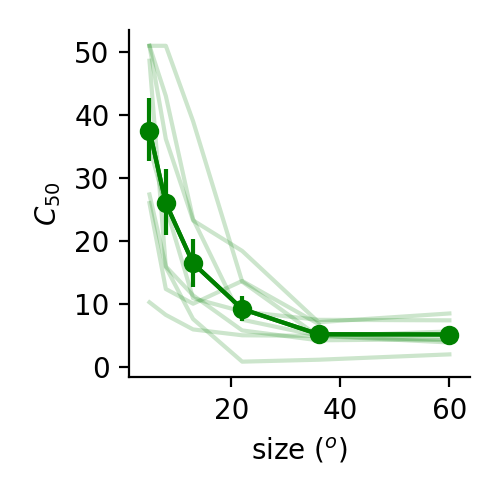

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


32.34665418617746
0
1
2
3
4
5
6
7
8
9
10
11
12


<IPython.core.display.Javascript object>


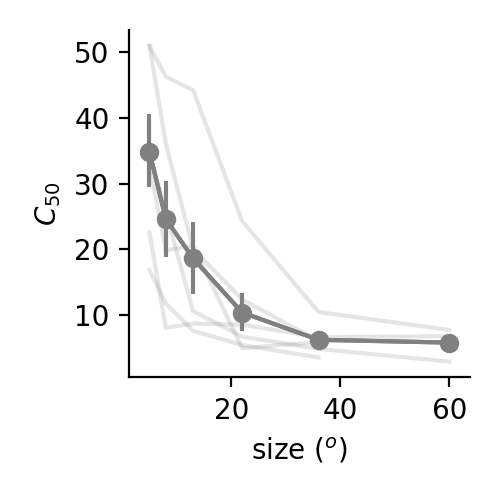

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


29.13274142049069
0
1
2
3
4
5
6


<IPython.core.display.Javascript object>


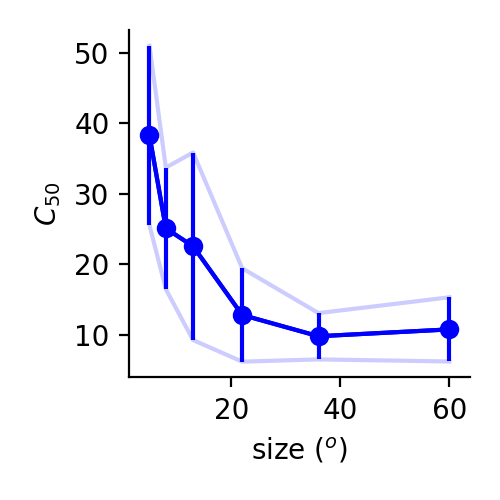

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


25.56096696827991


In [64]:
import naka_rushton_analysis as nra
reload(nra)
ucontrast = np.array([0,6,12,25,50,100])
c50mis = [None for ialign in range(2)]
c50s = [None for ialign in range(2)]
cmax = 5
smax = 5
for ialign in range(1):
    c50mis[ialign] = [None for irun in range(2)]
    c50s[ialign] = [None for irun in range(2)]
    for irun in range(2):
        c50mis[ialign][irun] = [None for itype in range(5)]
        c50s[ialign][irun] = [None for itype in range(5)]
        for itype in [0,1,4]:
#             irun,ialign = 0,0
            nroi = rsexpt[irun][itype][ialign].shape[0]
            c50s[ialign][irun][itype] = np.nan*np.ones((nroi,6))
            for iroi in range(nroi):
                print(iroi)
            #     this_data,this_error = rs[irun][itype][ialign][iroi],rs_sem[irun][itype][ialign][iroi]
            #     this_data = np.nanmean(this_data,2)
            #     this_error = combine_sem(this_error,2)
                this_data = np.nanmean(rsexpt[irun][itype][ialign][iroi],2)
                this_sem = np.nanmean(rs_sem[irun][itype][ialign][iroi],2)
                this_data[:,0] = np.nanmean(this_data[:,0])
                lkat = np.all(~np.isnan(this_data),1)
                nparams = np.sum(lkat)
                
                opt_params = nra.fit_opt_params_monotonic(ucontrast[:cmax],this_data[lkat,:cmax])
                c50s[ialign][irun][itype][iroi,lkat] = opt_params[nparams+1:2*nparams+1]
                x = np.arange(100)
                nr_data = nra.naka_rushton(x,opt_params,nparams)
                
#                 plt.figure()
#                 for isize in range(6):
#                     if lkat[isize]:
#                         plt.subplot(2,3,isize+1)
#                         plt.plot(ucontrast,this_data[isize])
#                         plt.plot(x,nr_data[isize])
                        
            c50mis[ialign][irun][itype] = c50s[ialign][irun][itype][:,0]-c50s[ialign][irun][itype][:,smax-1]

            plt.figure(figsize=(2.5,2.5))
            plt.plot(usize,c50s[ialign][irun][itype].T,alpha=0.2,c=colors[itype])
            ut.plot_bootstrapped_errorbars_hillel(usize,c50s[ialign][irun][itype][:,np.newaxis],pct=(16,84),colors=np.array(colors[itype])[np.newaxis])
            plt.xlabel('size ($^o$)')
            plt.ylabel('$C_{50}$')
            ut.erase_top_right()
            plt.tight_layout()
#             plt.savefig('figures/%s_c50_by_size_%s_%s.jpg'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]),dpi=300)

In [183]:
opt_params

array([ 1.34504002,  1.58964272,  1.53345788,  1.62095306,  1.58502806,
        0.35462521, 35.45104824, 25.65435796, 10.59479448,  7.51272564,
        5.37411936,  1.62817577])

In [184]:
opt_params.shape

(12,)

<IPython.core.display.Javascript object>


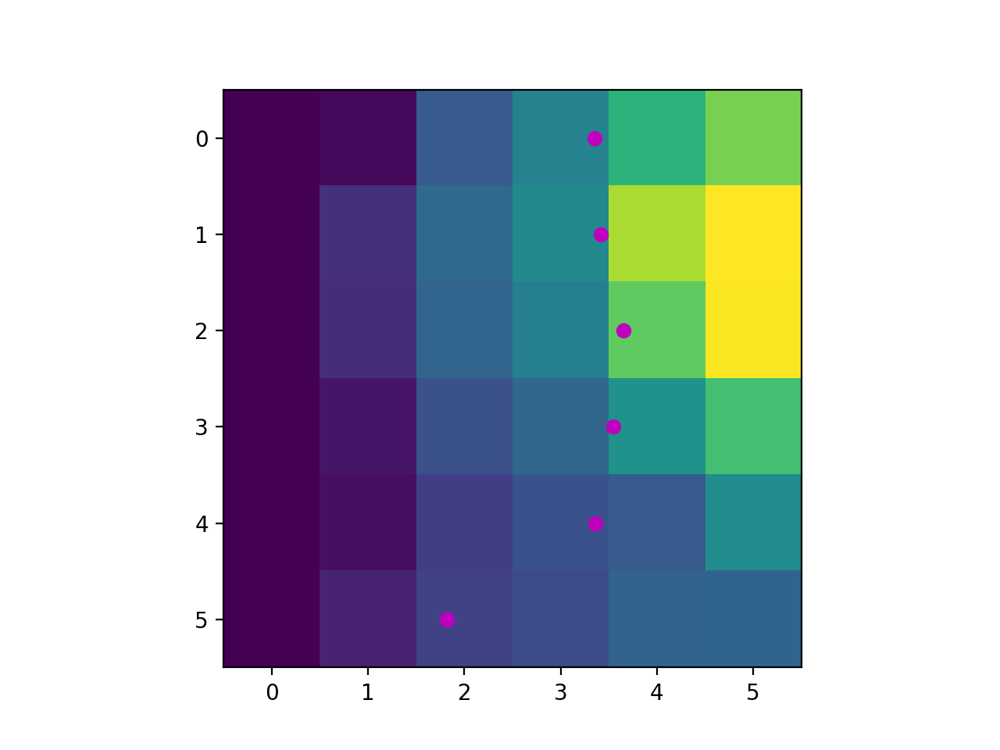

In [92]:
plt.figure()
plt.imshow(this_data)
plt.scatter(np.log2(c50s[ialign][irun][itype][iroi,lkat])-np.log2(3),np.arange(6),c='m')

<IPython.core.display.Javascript object>


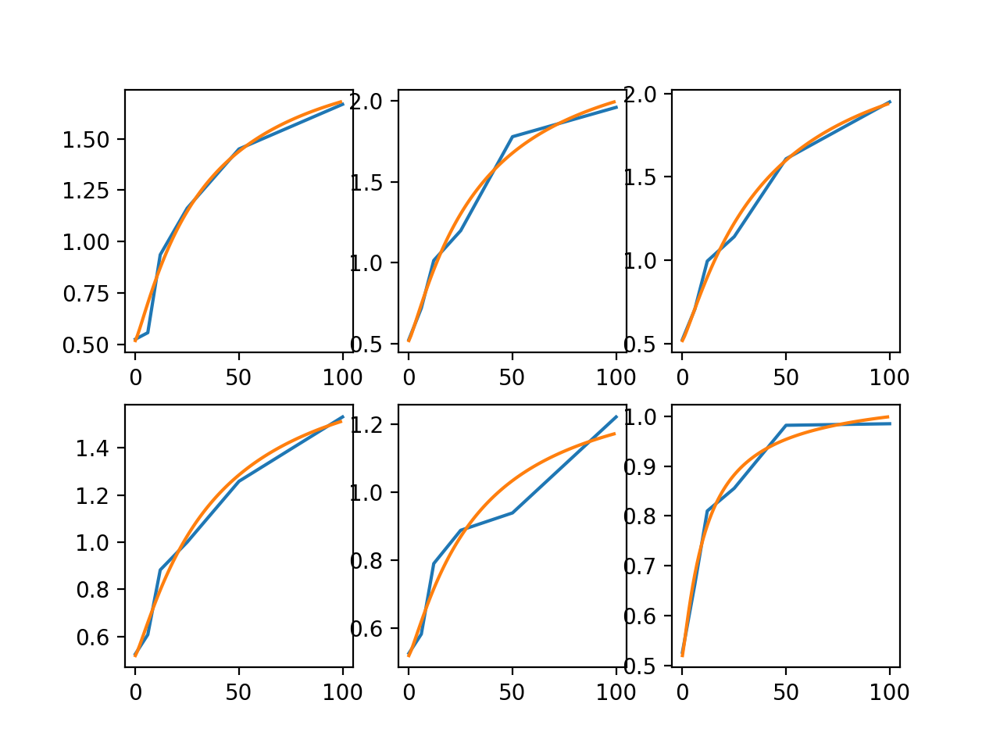

In [1157]:
ialign = 0
itype = 1
c50mis_run = np.concatenate([c50mis[ialign][irun][itype][:,np.newaxis] for irun in range(2)],axis=1)
c50s_run = np.concatenate([c50s[ialign][irun][itype][:,:,np.newaxis] for irun in range(2)],axis=2)

In [218]:
c50mis[ialign][irun][itype]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


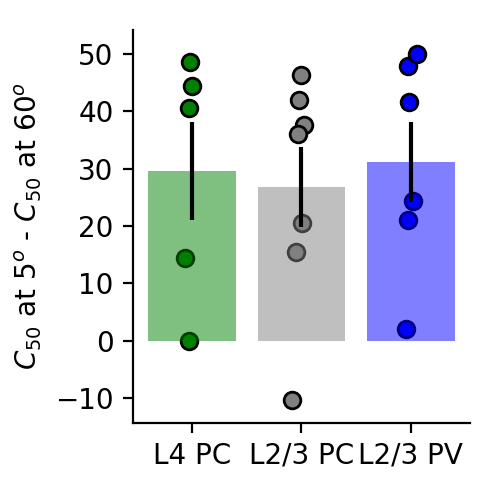

0.193359375
0.21630859375
0.296875


<IPython.core.display.Javascript object>


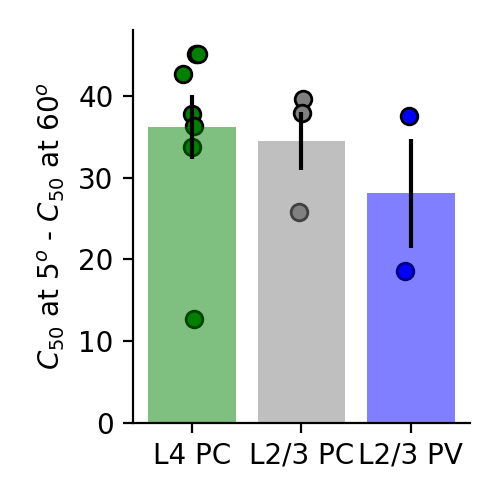

1.0
0.00341796875
0.078125


In [32]:
ialign = 0

for irun in range(2):
    plt.figure(figsize=(2.5,2.5))
    epsilon = 0.05
    colors = [(0,0.5,0),(0.5,0.5,0.5),None,None,(0,0,1)]
    for iitype,itype in enumerate([0,1,4]):
        smimi = c50mis[ialign][irun][itype].copy()
        plt.bar((iitype,),np.nanmean(smimi,0),color=colors[itype],alpha=0.5)
        plt.errorbar((iitype,),np.nanmean(smimi,0),np.nanstd(smimi,0)/np.sqrt(np.sum(~np.isnan(smimi),0)),fmt='none',c='k')
        plt.scatter(iitype*np.ones_like(smimi)+epsilon*np.random.randn(smimi.shape[0]),smimi,facecolor=colors[itype],linewidth=1,edgecolor='k')
        _,p = sst.wilcoxon(smimi)
        print(p)
        # plt.plot((0+epsilon,1-epsilon),smimi.T,c='k',alpha=0.5)
    plt.xticks((0,1,2),['L4 PC','L2/3 PC','L2/3 PV'])
    plt.ylabel('$C_{50}$ at 5$^o$ - $C_{50}$ at 60$^o$')
    ut.erase_top_right()
    plt.tight_layout()

# print(p)
#     plt.savefig('figures/pc_pv_c50mi_bars_%s.jpg'%running_lbls[irun],dpi=300)
    

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


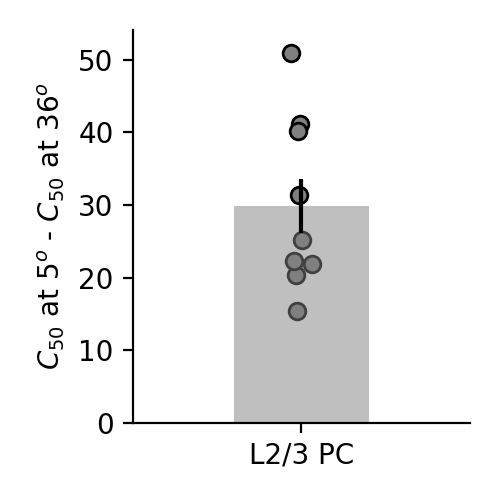

0.00390625


<IPython.core.display.Javascript object>


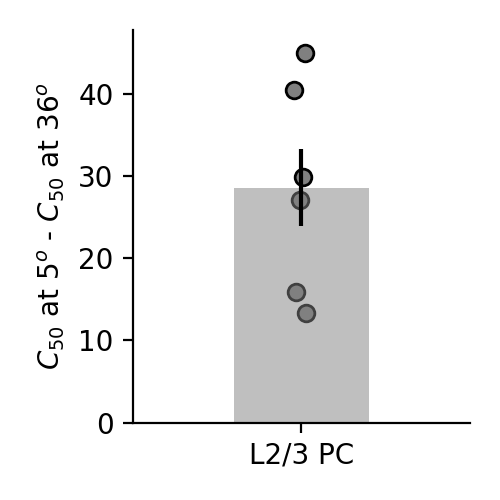

0.03125


In [65]:
ialign = 0

for irun in range(2):
    plt.figure(figsize=(2.5,2.5))
    epsilon = 0.05
    colors = [(0,0.5,0),(0.5,0.5,0.5),None,None,(0,0,1)]
    for iitype,itype in enumerate([1]):
        smimi = c50mis[ialign][irun][itype].copy()
        plt.bar((iitype,),np.nanmean(smimi,0),color=colors[itype],alpha=0.5)
        plt.errorbar((iitype,),np.nanmean(smimi,0),np.nanstd(smimi,0)/np.sqrt(np.sum(~np.isnan(smimi),0)),fmt='none',c='k')
        plt.scatter(iitype*np.ones_like(smimi)+epsilon*np.random.randn(smimi.shape[0]),smimi,facecolor=colors[itype],linewidth=1,edgecolor='k')
        _,p = sst.wilcoxon(smimi[~np.isnan(smimi)])
        print(p)
        # plt.plot((0+epsilon,1-epsilon),smimi.T,c='k',alpha=0.5)
    plt.xticks((0,),['L2/3 PC'])
    plt.ylabel('$C_{50}$ at 5$^o$ - $C_{50}$ at %d$^o$'%usize[smax-1])
    plt.xlim((-1,1))
    ut.erase_top_right()
    plt.tight_layout()

# print(p)
    plt.savefig('figures/pc_c50mi_bars_%s.jpg'%running_lbls[irun],dpi=300)
    

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


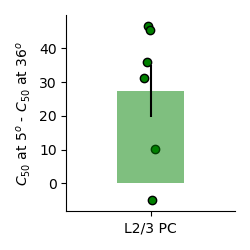

0.0625


<IPython.core.display.Javascript object>


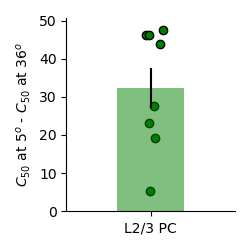

0.0078125


In [67]:
ialign = 0

for irun in range(2):
    plt.figure(figsize=(2.5,2.5))
    epsilon = 0.05
    colors = [(0,0.5,0),(0.5,0.5,0.5),None,None,(0,0,1)]
    for iitype,itype in enumerate([0]):
        smimi = c50mis[ialign][irun][itype].copy()
        plt.bar((iitype,),np.nanmean(smimi,0),color=colors[itype],alpha=0.5)
        plt.errorbar((iitype,),np.nanmean(smimi,0),np.nanstd(smimi,0)/np.sqrt(np.sum(~np.isnan(smimi),0)),fmt='none',c='k')
        plt.scatter(iitype*np.ones_like(smimi)+epsilon*np.random.randn(smimi.shape[0]),smimi,facecolor=colors[itype],linewidth=1,edgecolor='k')
        _,p = sst.wilcoxon(smimi[~np.isnan(smimi)])
        print(p)
        # plt.plot((0+epsilon,1-epsilon),smimi.T,c='k',alpha=0.5)
    plt.xticks((0,),['L2/3 PC'])
    plt.ylabel('$C_{50}$ at 5$^o$ - $C_{50}$ at %d$^o$'%usize[smax-1])
    plt.xlim((-1,1))
    ut.erase_top_right()
    plt.tight_layout()

# print(p)
    plt.savefig('figures/pc_c50mi_bars_%s.jpg'%running_lbls[irun],dpi=300)
    

In [58]:
smimi.shape

(13,)

In [639]:
irun1,irun2 = 0,1
ialign = 0
itype = 0
data1 = c50mis[ialign][irun1][itype]
data2 = c50mis[ialign][irun2][itype]
sst.mannwhitneyu(data1[~np.isnan(data1)],data2[~np.isnan(data2)])
sst.wilcoxon(data1[~np.isnan(data1) & ~np.isnan(data2)],data2[~np.isnan(data1) & ~np.isnan(data2)])

WilcoxonResult(statistic=3.0, pvalue=0.22491588401596185)

In [637]:
(~np.isnan(data2)).sum()

3

In [634]:
c50mis[ialign][irun1][itype].copy()

array([         nan,          nan,          nan,          nan,
                nan,  38.71433118,          nan, -11.67013155,
       -89.35580685,  11.66016467,  54.89878023,  25.91440071,
        20.07447639])

In [862]:
ialign,irun

[6, 12, 25, 50, 100]

<IPython.core.display.Javascript object>


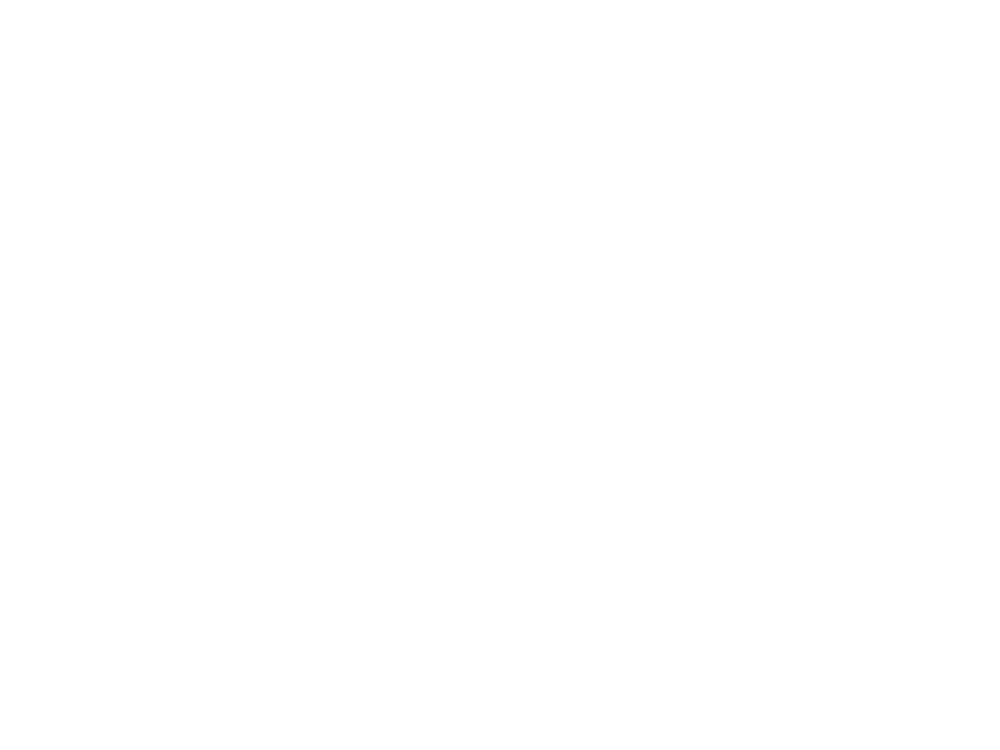

NameError: name 'ucontrast' is not defined

In [10]:
plt.figure()
ut.plot_bootstrapped_errorbars_hillel(ucontrast,np.nanmean(rsexpt[irun][itype][ialign],3))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


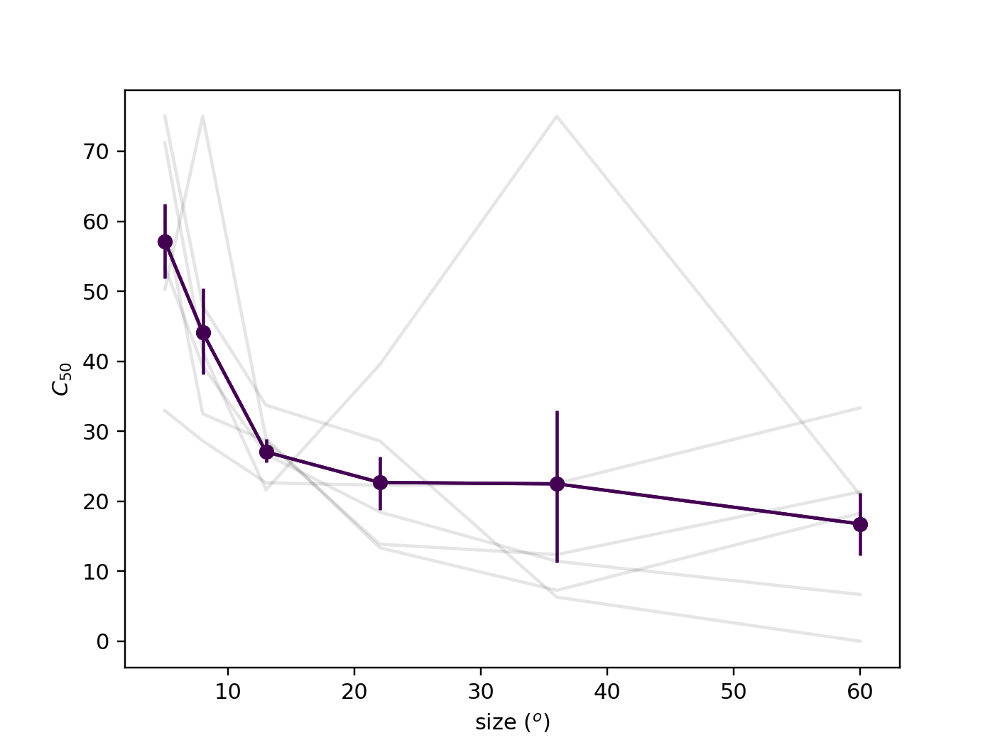

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


51.85660812491805


Text(0, 0.5, '$C_{50}$')

In [785]:
plt.figure()
plt.plot(usize,c50s.T,c='k',alpha=0.1)
ut.plot_bootstrapped_errorbars_hillel(usize,c50s[:,np.newaxis],pct=(16,84))
plt.xlabel('size ($^o$)')
plt.ylabel('$C_{50}$')

In [801]:
plt.close('all')

In [798]:
np.nanmean(rsexpt[irun][itype][ialign],-1)

array([[[       nan,        nan,        nan,        nan,        nan,
                nan],
        [       nan,        nan,        nan,        nan,        nan,
                nan],
        [       nan,        nan,        nan,        nan,        nan,
                nan],
        [       nan,        nan,        nan,        nan,        nan,
                nan],
        [       nan,        nan,        nan,        nan,        nan,
                nan],
        [       nan,        nan,        nan,        nan,        nan,
                nan]],

       [[0.00798857, 0.01556379, 0.01439947, 0.02323603, 0.03611092,
         0.04888657],
        [0.01012355, 0.01399803, 0.01986543, 0.04964675, 0.0576044 ,
         0.06515359],
        [0.01121137, 0.02109679, 0.02900582, 0.05366821, 0.07625494,
         0.08441243],
        [0.00931738, 0.0427483 , 0.06521712, 0.06968206, 0.06035818,
         0.07199133],
        [0.01161595, 0.03721124, 0.05199117, 0.0522252 , 0.0667217 ,
         0.06928372

In [48]:
running_lbls = ['non_running','running']

In [43]:
cmax = 6

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


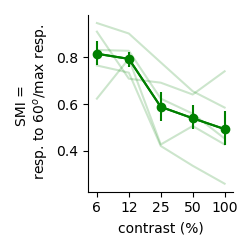

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7656290839469333


<IPython.core.display.Javascript object>


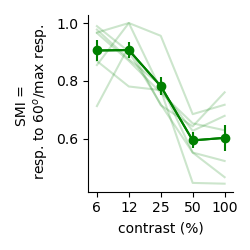

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8788020327490744


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in true_divide
  del sys.path[0]


<IPython.core.display.Javascript object>


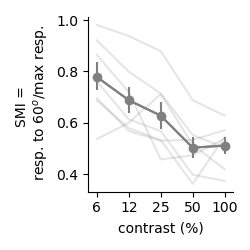

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7259634937519146


<IPython.core.display.Javascript object>


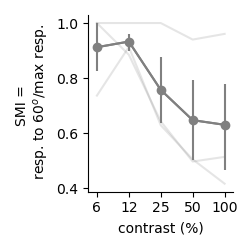

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8989345663174675


<IPython.core.display.Javascript object>


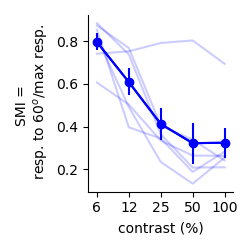

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7595323583214648


<IPython.core.display.Javascript object>


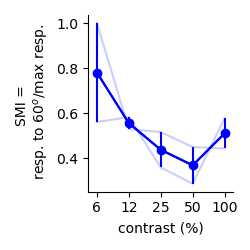

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.5606034978417729


In [74]:
lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = np.array((0.5,0.5,0.5))
c_sst = np.array((1,0.65,0))
c_vip = np.array((1,0,1))
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

for itype in [0,1,4]:
    for irun in range(2):
        ialign = 0
        rs[irun][itype][ialign].shape
        smi = np.nanmean(rs[irun][itype][ialign],-1)[:,-1,:]/np.nanmax(np.nanmean(rs[irun][itype][ialign],-1),1)
        smi_expt = np.nanmean(rsexpt[irun][itype][ialign],-1)[:,-1,:]/np.nanmax(np.nanmean(rsexpt[irun][itype][ialign],-1),1)
        these_expt_ids = expt_ids[irun][itype][ialign]

        plt.figure(figsize=(2.5,2.5))
        ucontrast = [6,12,25,50,100]
        x = np.arange(1,6)
        plt.plot(x,smi_expt[:,1:].T,c=colors[itype],alpha=0.2)
        # for iexpt in range(int(these_expt_ids.max())+1):
        #     if np.sum(these_expt_ids==iexpt):
        #         ut.plot_bootstrapped_errorbars_hillel(ucontrast,smi[these_expt_ids==iexpt,np.newaxis,1:],colors=np.array((0.75,0.75,0.75))[np.newaxis])
        ut.plot_bootstrapped_errorbars_hillel(x,smi_expt[:,np.newaxis,1:],colors=colors[itype][np.newaxis],pct=(16,84))
        plt.xticks(x,ucontrast)
        plt.ylabel('SMI = \n resp. to 60$^o$/max resp.')
        plt.xlabel('contrast (%)')
        ut.erase_top_right()
        plt.tight_layout()
        plt.savefig('figures/semilogx_%s_smi_by_contrast_%s.jpg'%(lbls[itype],running_lbls[irun]),dpi=300)


<IPython.core.display.Javascript object>


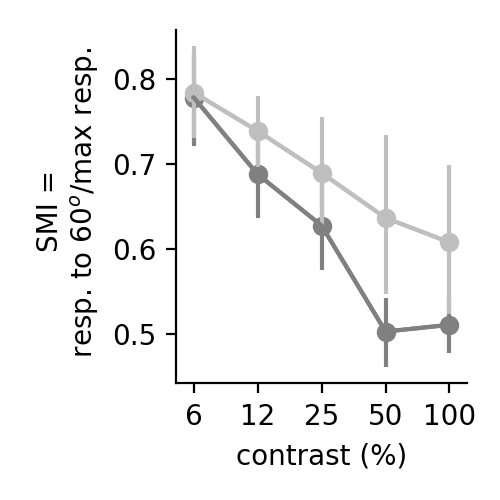

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:19: RuntimeWarning: invalid value encountered in true_divide
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7259634937519146
0.7294943332065865


In [570]:
lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = np.array((0.5,0.5,0.5))
c_sst = np.array((1,0.65,0))
c_vip = np.array((1,0,1))
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

colors_dist = [0.5*c+0.5*np.array((1,1,1)) for c in colors]

both_colors = [colors,colors_dist]

for itype in [1]:
    for irun in range(1):
        plt.figure(figsize=(2.5,2.5))
        smi_expts = [None for ialign in range(2)]
        for ialign in range(2):
            rs[irun][itype][ialign].shape
            smi = np.nanmean(rs[irun][itype][ialign],-1)[:,-1,:]/np.nanmax(np.nanmean(rs[irun][itype][ialign],-1),1)
            smi_expt = np.nanmean(rsexpt[irun][itype][ialign],-1)[:,-1,:]/np.nanmax(np.nanmean(rsexpt[irun][itype][ialign],-1),1)
            smi_expts[ialign] = smi_expt
            these_expt_ids = expt_ids[irun][itype][ialign]

            ucontrast = [6,12,25,50,100]
            x = np.arange(1,6)
    #         plt.plot(x,smi_expt[:,1:].T,c=colors[itype],alpha=0.2)
            # for iexpt in range(int(these_expt_ids.max())+1):
            #     if np.sum(these_expt_ids==iexpt):
            #         ut.plot_bootstrapped_errorbars_hillel(ucontrast,smi[these_expt_ids==iexpt,np.newaxis,1:],colors=np.array((0.75,0.75,0.75))[np.newaxis])
            ut.plot_bootstrapped_errorbars_hillel(x,smi_expt[:,np.newaxis,1:],colors=both_colors[ialign][itype][np.newaxis],pct=(16,84))
        plt.xticks(x,ucontrast)
        plt.ylabel('SMI = \n resp. to 60$^o$/max resp.')
        plt.xlabel('contrast (%)')
        ut.erase_top_right()
        plt.tight_layout()
        plt.savefig('figures/semilogx_%s_smi_by_contrast_%s_near_far.jpg'%(lbls[itype],running_lbls[irun]),dpi=300)
        smi_expts = np.concatenate([se[:,:,np.newaxis] for se in smi_expts],axis=2)
        p = np.zeros((6,))
        for icontrast in range(6):
            this_lkat = ~np.isnan(smi_expts[:,icontrast].sum(1))
            _,p[icontrast] = sst.wilcoxon(smi_expts[this_lkat,icontrast,0],smi_expts[this_lkat,icontrast,1])

In [571]:
p

array([0.05792575, 0.43288619, 0.08814819, 0.08814819, 0.04548447,
       0.15524722])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


<IPython.core.display.Javascript object>


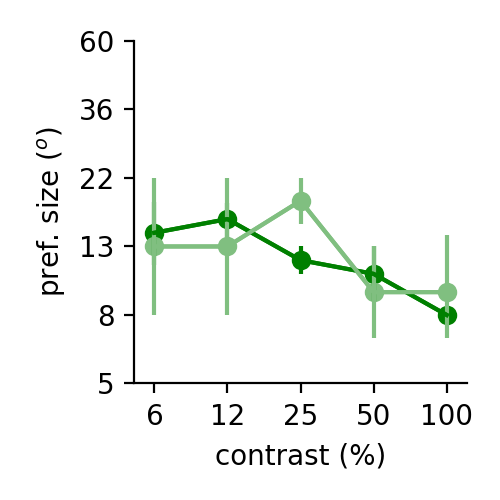

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.3333333333333335
[       nan 0.15729921 0.65472085 0.15729921 0.31731051 0.65472085]


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/scipy/stats/morestats.py:2957: UserWarning: Exact p-value calculation does not work if there are ties. Switching to normal approximation.
  warnings.warn("Exact p-value calculation does not work if there are "
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/scipy/stats/morestats.py:2971: UserWarning: Sample size too small for normal approximation.
  warnings.warn("Sample size too small for normal approximation.")


<IPython.core.display.Javascript object>


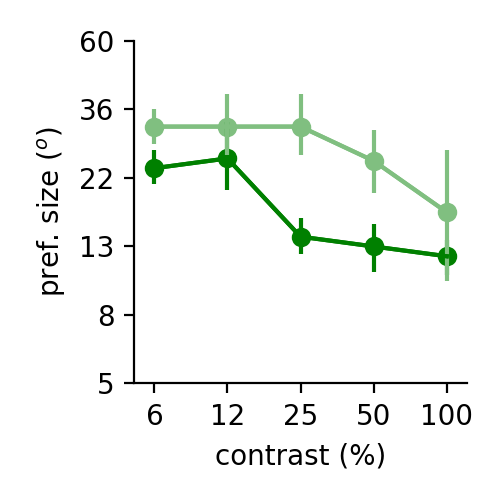

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.5
[       nan 0.31731051 0.31731051 0.10247043 0.17971249 0.78549475]


<IPython.core.display.Javascript object>


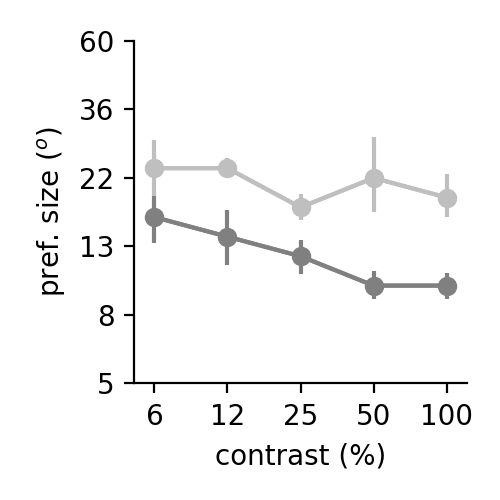

3.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[       nan 0.02534732 0.03843393 0.05878172 0.0421682  0.02435792]


<IPython.core.display.Javascript object>


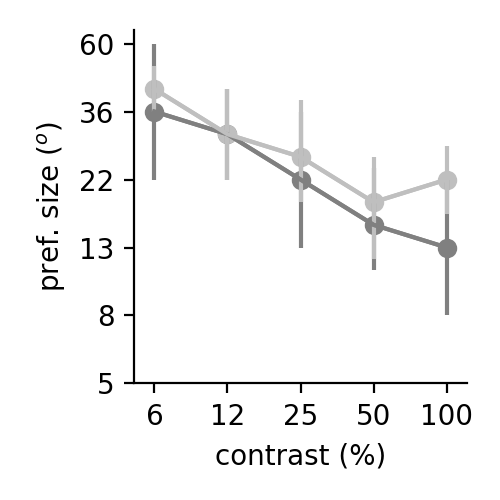

4.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[       nan 0.65472085        nan 0.31731051 0.65472085 0.17971249]


<IPython.core.display.Javascript object>


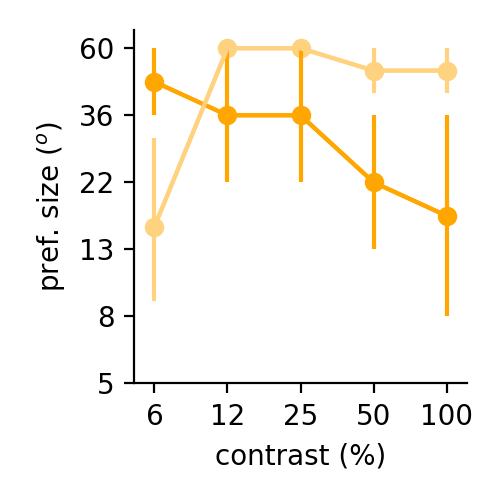

5.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[       nan 0.5        0.31731051 0.31731051 0.31731051 0.31731051]


<IPython.core.display.Javascript object>


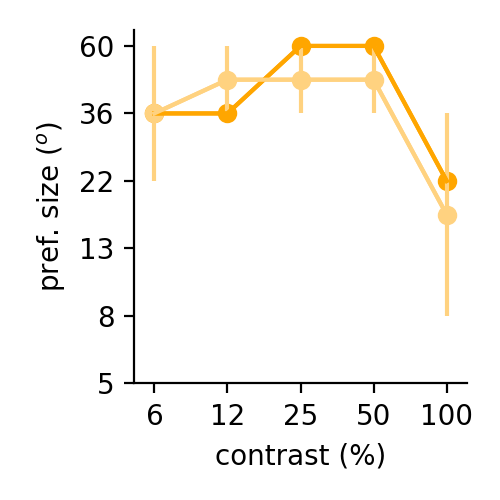

5.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[nan  1. nan  1. nan  1.]


<IPython.core.display.Javascript object>


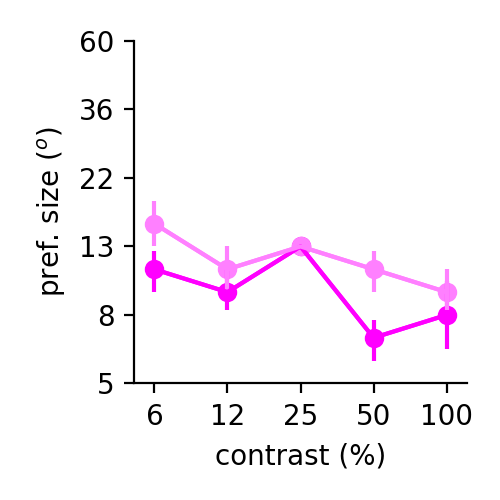

2.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[       nan 0.15729921 0.31731051        nan 0.25       0.31731051]


<IPython.core.display.Javascript object>


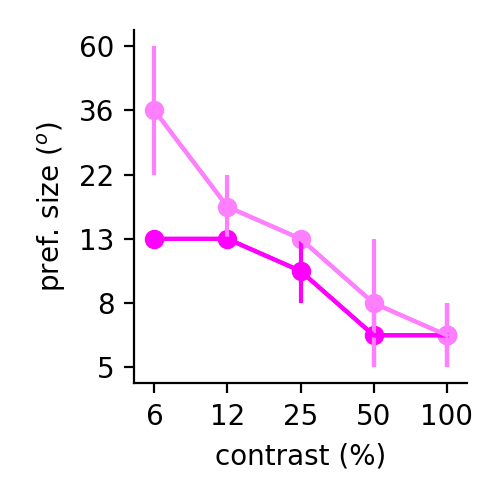

3.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[       nan 0.5        0.31731051 0.31731051 0.31731051        nan]


<IPython.core.display.Javascript object>


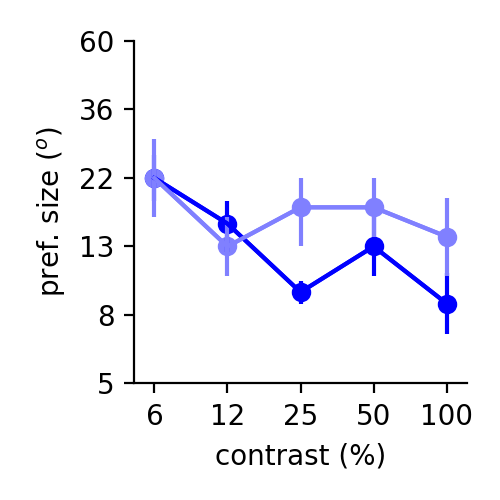

2.6666666666666665


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[       nan 0.65472085 0.31731051 0.0741499  0.10247043 0.0741499 ]


<IPython.core.display.Javascript object>


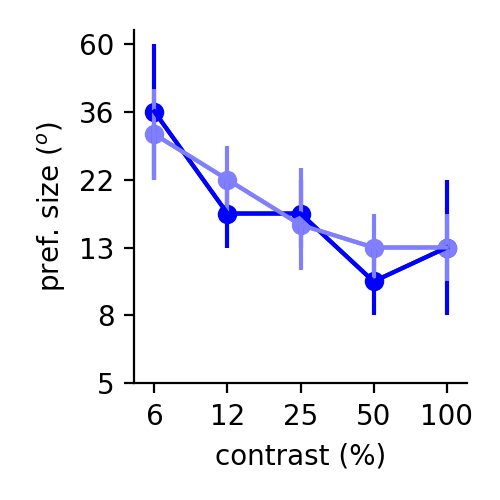

3.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


[       nan        nan 0.5        0.31731051 0.5        0.31731051]


In [41]:
lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = np.array((0.5,0.5,0.5))
c_sst = np.array((1,0.65,0))
c_vip = np.array((1,0,1))
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

colors_dist = [0.5*c+0.5*np.array((1,1,1)) for c in colors]

both_colors = [colors,colors_dist]

for itype in [0,1,2,3,4]:
    both_these_colors = [colors[itype],colors_dist[itype]]
    for irun in range(2):
        plt.figure(figsize=(2.5,2.5))
        pref_size = [None for ialign in range(2)]
        these_expt_ids = [None for ialign in range(2)]
        for ialign in range(2):
            pref_size[ialign] = np.argmax(np.nanmean(rsexpt[irun][itype][ialign],-1),1).astype('float')
            nan_out = (np.sum(np.isnan(np.nanmean(rsexpt[irun][itype][ialign],-1)),1)>0)
            pref_size[ialign][nan_out] = np.nan
#             these_expt_ids[ialign] = np.unique(expt_ids[irun][itype][ialign])
        pref_size = np.concatenate([ps[:,:,np.newaxis] for ps in pref_size],axis=2)
        ut.plot_bootstrapped_errorbars_hillel(np.arange(1,6),pref_size[:,1:].transpose((0,2,1)),pct=(16,84),colors=both_these_colors)
        plt.xticks(np.arange(1,6),ucontrast)
        plt.yticks(np.arange(6),usize)
        plt.xlabel('contrast (%)')
        plt.ylabel('pref. size ($^o$)')
        ut.erase_top_right()
        plt.tight_layout()
        plt.savefig('figures/%s_pref_size_by_contrast_%s_near_far.jpg'%(lbls[itype],running_lbls[irun]),dpi=300)
        p = np.nan*np.ones((6,))
        for icontrast in range(1,6):
            this_lkat = ~np.isnan(pref_size.sum(1).sum(1))
            try:
                _,p[icontrast] = sst.wilcoxon(pref_size[this_lkat,icontrast,0],pref_size[this_lkat,icontrast,1])
            except:
                p[icontrast] = np.nan
        print(p)

In [46]:
irun,ialign=0,0
ntypes = 5
smi_expt = [None for irun in range(2)]
smimis = [None for irun in range(2)]
p = [None for irun in range(2)]
for irun in range(2):
    smi_expt[irun] = [None for itype in range(ntypes)]
    for itype in range(ntypes):
        smi_expt[irun][itype] = np.nanmean(rsexpt[irun][itype][ialign],-1)[:,-1,:]/np.nanmax(np.nanmean(rsexpt[irun][itype][ialign],-1),1)
    smimis[irun] = [None for itype in range(ntypes)]
    p[irun] = np.zeros((ntypes,))
    for itype in range(ntypes):
        smimis[irun][itype] = smi_expt[irun][itype][:,1]-smi_expt[irun][itype][:,5]
        _,p[irun][itype] = sst.wilcoxon(smi_expt[irun][itype][:,1],smi_expt[irun][itype][:,-1])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


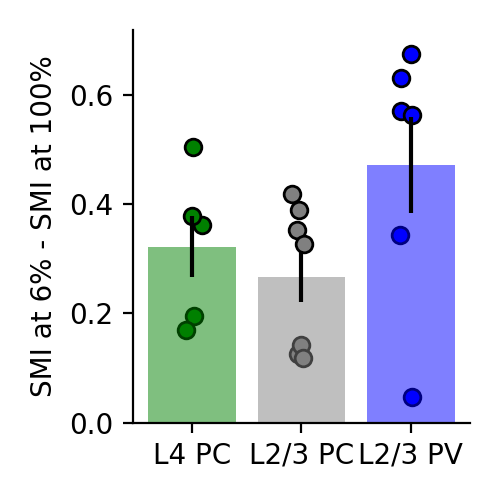

0.232421875
0.243896484375
0.296875


<IPython.core.display.Javascript object>


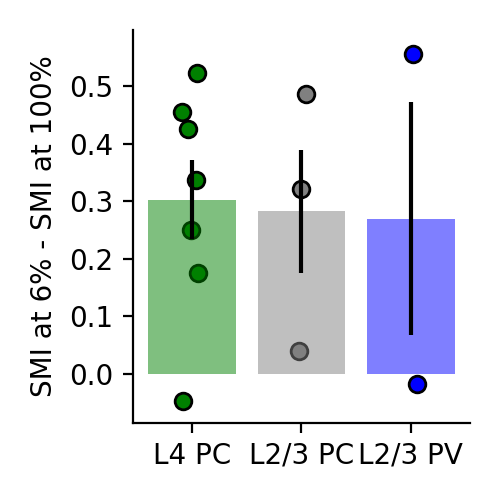

1.0
0.00341796875
0.046875


In [52]:

epsilon = 0.05
colors = [(0,0.5,0),(0.5,0.5,0.5),None,None,(0,0,1)]
irun = 0
running_lbls = ['non_running','running']
for irun in range(2):
    plt.figure(figsize=(2.5,2.5))
    for iitype,itype in enumerate([0,1,4]):
        smimi = smimis[irun][itype].copy()
        plt.bar((iitype,),np.nanmean(smimi,0),color=colors[itype],alpha=0.5)
        plt.errorbar((iitype,),np.nanmean(smimi,0),np.nanstd(smimi,0)/np.sqrt(np.sum(~np.isnan(smimi),0)),fmt='none',c='k')
        plt.scatter(iitype*np.ones_like(smimi)+epsilon*np.random.randn(smimi.shape[0]),smimi,facecolor=colors[itype],linewidth=1,edgecolor='k')
        _,p = sst.wilcoxon(smimi)
        print(p)
    # plt.plot((0+epsilon,1-epsilon),smimi.T,c='k',alpha=0.5)
    ut.erase_top_right()
    plt.xticks((0,1,2),['L4 PC','L2/3 PC','L2/3 PV'])
    plt.ylabel('SMI at 6% - SMI at 100%')
    plt.tight_layout()
    # print(p)
    plt.savefig('figures/pc_pv_smimi_bars_%s.jpg'%running_lbls[irun],dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


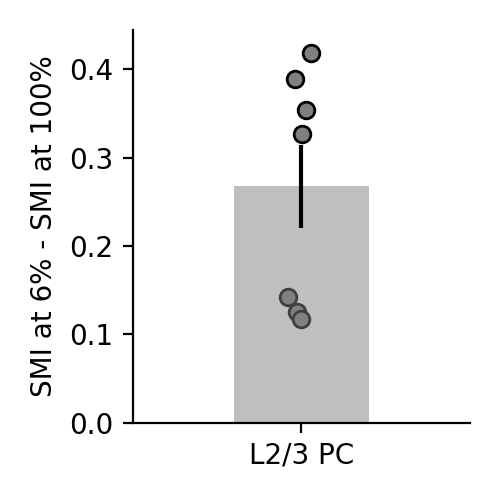

0.243896484375


<IPython.core.display.Javascript object>


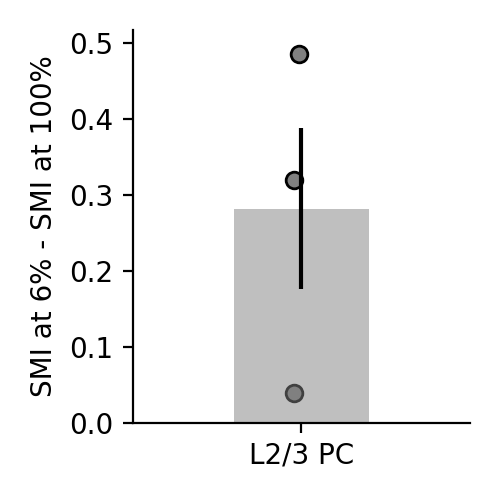

0.00341796875


In [53]:

epsilon = 0.05
colors = [(0,0.5,0),(0.5,0.5,0.5),None,None,(0,0,1)]
irun = 0
running_lbls = ['non_running','running']
for irun in range(2):
    plt.figure(figsize=(2.5,2.5))
    for iitype,itype in enumerate([1]):
        smimi = smimis[irun][itype].copy()
        plt.bar((iitype,),np.nanmean(smimi,0),color=colors[itype],alpha=0.5)
        plt.errorbar((iitype,),np.nanmean(smimi,0),np.nanstd(smimi,0)/np.sqrt(np.sum(~np.isnan(smimi),0)),fmt='none',c='k')
        plt.scatter(iitype*np.ones_like(smimi)+epsilon*np.random.randn(smimi.shape[0]),smimi,facecolor=colors[itype],linewidth=1,edgecolor='k')
        _,p = sst.wilcoxon(smimi)
        print(p)
    # plt.plot((0+epsilon,1-epsilon),smimi.T,c='k',alpha=0.5)
    ut.erase_top_right()
    plt.xticks((0,),['L2/3 PC'])
    plt.xlim((-1,1))
    plt.ylabel('SMI at 6% - SMI at 100%')
    plt.tight_layout()
    # print(p)
    plt.savefig('figures/pc_smimi_bars_%s.jpg'%running_lbls[irun],dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


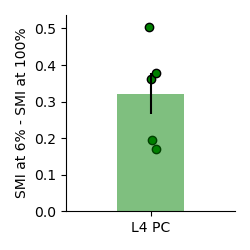

0.232421875


<IPython.core.display.Javascript object>


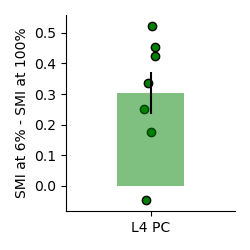

1.0


In [66]:

epsilon = 0.05
colors = [(0,0.5,0),(0.5,0.5,0.5),None,None,(0,0,1)]
irun = 0
running_lbls = ['non_running','running']
for irun in range(2):
    plt.figure(figsize=(2.5,2.5))
    for iitype,itype in enumerate([0]):
        smimi = smimis[irun][itype].copy()
        plt.bar((iitype,),np.nanmean(smimi,0),color=colors[itype],alpha=0.5)
        plt.errorbar((iitype,),np.nanmean(smimi,0),np.nanstd(smimi,0)/np.sqrt(np.sum(~np.isnan(smimi),0)),fmt='none',c='k')
        plt.scatter(iitype*np.ones_like(smimi)+epsilon*np.random.randn(smimi.shape[0]),smimi,facecolor=colors[itype],linewidth=1,edgecolor='k')
        _,p = sst.wilcoxon(smimi)
        print(p)
    # plt.plot((0+epsilon,1-epsilon),smimi.T,c='k',alpha=0.5)
    ut.erase_top_right()
    plt.xticks((0,),['L4 PC'])
    plt.xlim((-1,1))
    plt.ylabel('SMI at 6% - SMI at 100%')
    plt.tight_layout()
    # print(p)
    plt.savefig('figures/pc_l4_smimi_bars_%s.jpg'%running_lbls[irun],dpi=300)

In [568]:
smi[these_expt_ids==iexpt,1:].shape

(905, 5)

In [370]:
rrs,rfs = ut.loadmat('/Users/dan/Documents/data/julia/VIPHaloSizeContNoInterp.mat',['rrs','rfs'])
ucontrast_ephys = [0,5,10,20,40,80]
usize_ephys = [8,20,60]
usize_ephys0 = [0]+usize_ephys

In [372]:
# c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
# c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
# c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
# c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
# colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

cfrac = np.linspace(1,0,this_ncontrast+1)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


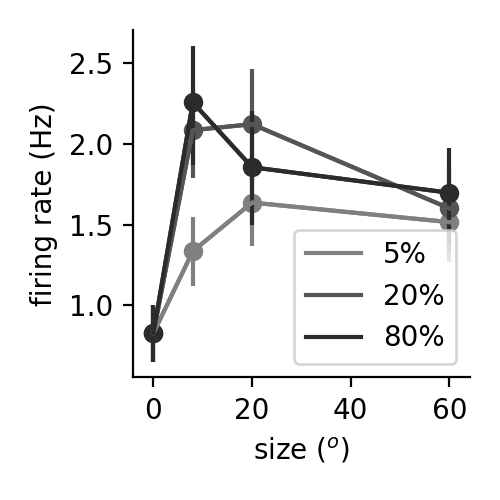

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.907243383597598


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


<IPython.core.display.Javascript object>


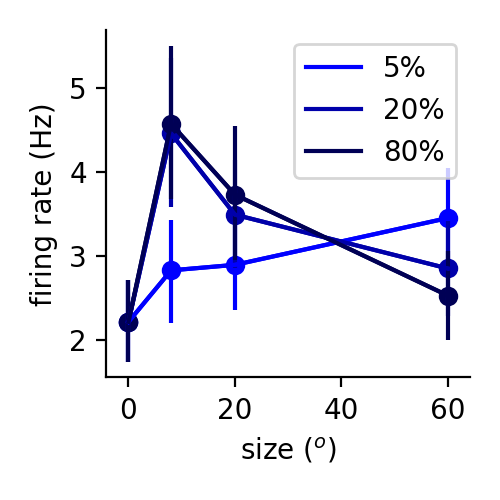

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support tr

3.6477635756056808


<IPython.core.display.Javascript object>


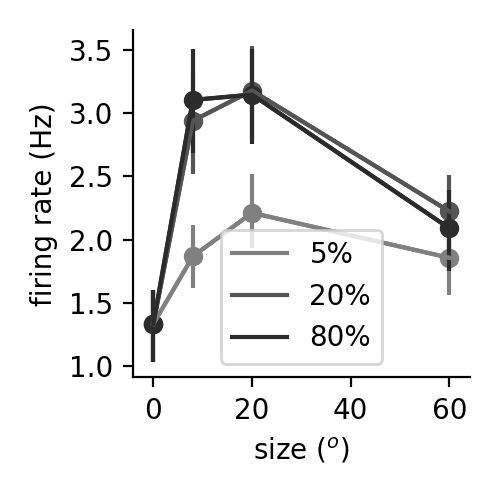

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.824034239840092


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


<IPython.core.display.Javascript object>


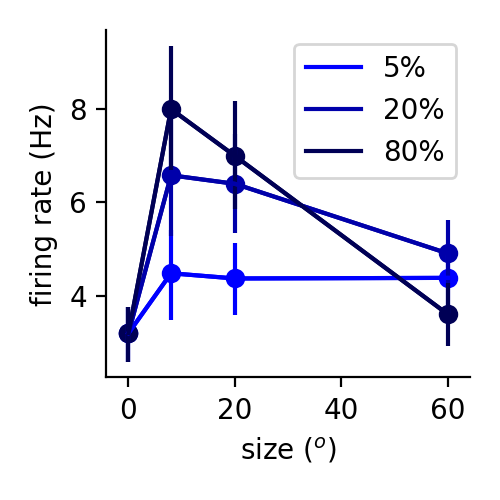

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


6.64054198158223


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


In [375]:
for irun in range(2):
    for data,c,lbl in zip([rrs[irun],rfs[irun]],[c_l23,c_pv],['pc_l23','pv_l23']):
        shp = data.shape
        nexpt = shp[0]
        nlight = shp[3]
        size_tuning = np.zeros((shp[0],shp[1]+1,shp[2],shp[3]))
        for iexpt in range(nexpt):
            for ilight in range(nlight):
                size_tuning[iexpt,:,:,ilight] = gen_size_tuning(data[iexpt,:,:,ilight])

        plt.figure(figsize=(2.5,2.5))
        ut.plot_bootstrapped_errorbars_hillel(usize_ephys0,size_tuning[:,:,[1,3,5],0].transpose((0,2,1)),pct=(16,84),colors=c)
        plt.legend(['5%','20%','80%'])
        plt.xlabel('size ($^o$)')
        plt.ylabel('firing rate (Hz)')
        plt.tight_layout()
        ut.erase_top_right()
        plt.savefig('figures/ephys_%s_size_by_3_contrasts_%s_.eps'%(lbl,running_lbls[irun]))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


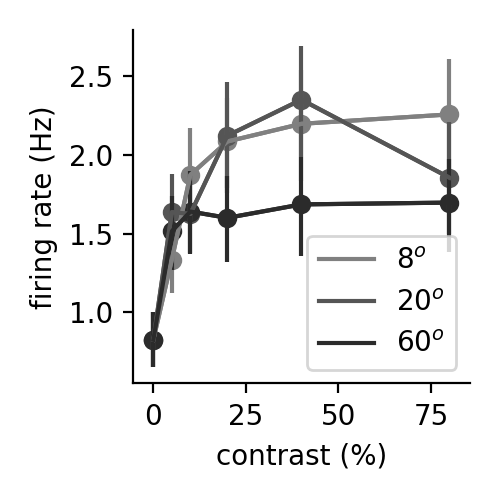

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support tr

2.0111704939768407


<IPython.core.display.Javascript object>


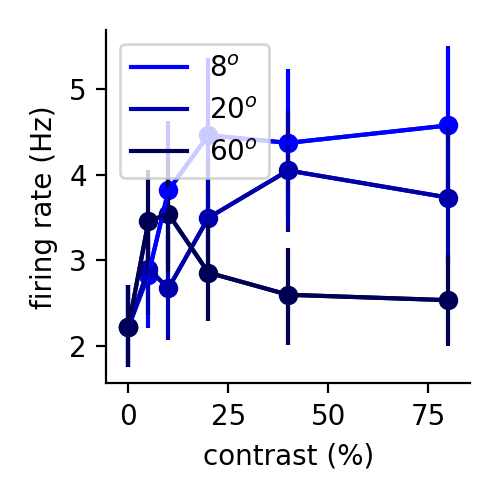

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support tr

3.6477635756056808


<IPython.core.display.Javascript object>


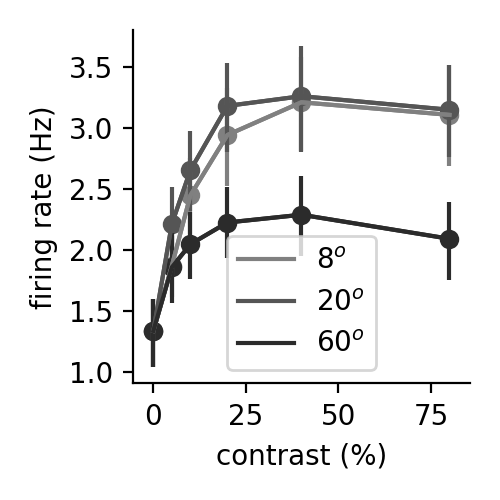

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.847084162328082


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


<IPython.core.display.Javascript object>


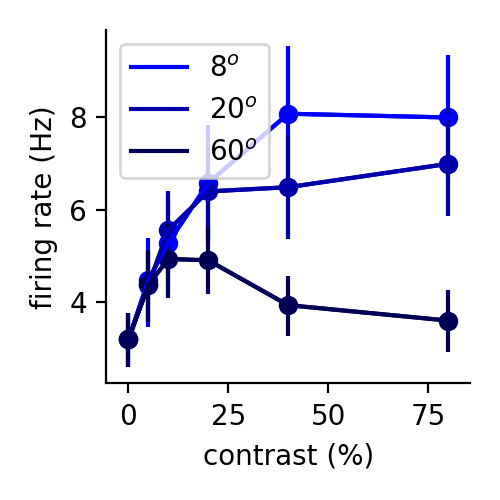

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


6.64054198158223


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


In [383]:
for irun in range(2):
    for data,c,lbl in zip([rrs[irun],rfs[irun]],[c_l23,c_pv],['pc_l23','pv_l23']):
        shp = data.shape
        nexpt = shp[0]
        nlight = shp[3]
#         size_tuning = np.zeros((shp[0],shp[1]+1,shp[2],shp[3]))
#         for iexpt in range(nexpt):
#             for ilight in range(nlight):
#                 size_tuning[iexpt,:,:,ilight] = gen_size_tuning(data[iexpt,:,:,ilight])

        plt.figure(figsize=(2.5,2.5))
        ut.plot_bootstrapped_errorbars_hillel(ucontrast_ephys,data[:,:,:,0].transpose((0,1,2)),pct=(16,84),colors=c)
        plt.legend(['8$^o$','20$^o$','60$^o$'])
        plt.xlabel('contrast (%)')
        plt.ylabel('firing rate (Hz)')
        plt.tight_layout()
        ut.erase_top_right()
        plt.savefig('figures/ephys_%s_contrast_by_3_sizes_%s_.eps'%(lbl,running_lbls[irun]))


0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


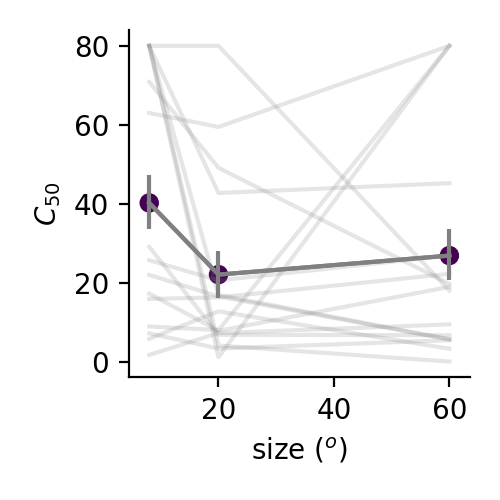

33.06091342311118
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20


<IPython.core.display.Javascript object>


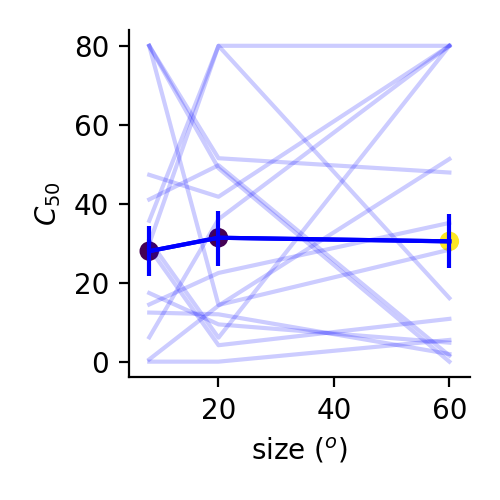

24.67661439831986
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20


<IPython.core.display.Javascript object>


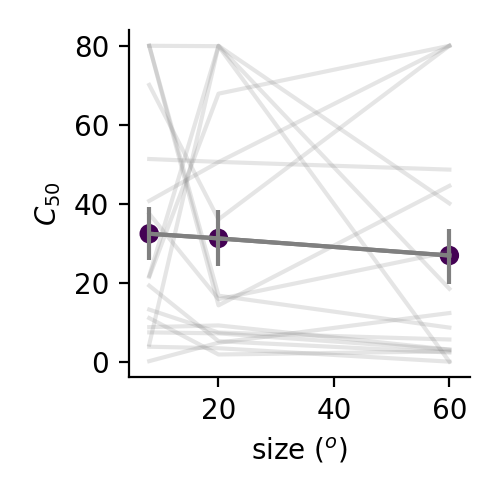

25.499353095551747
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20


<IPython.core.display.Javascript object>


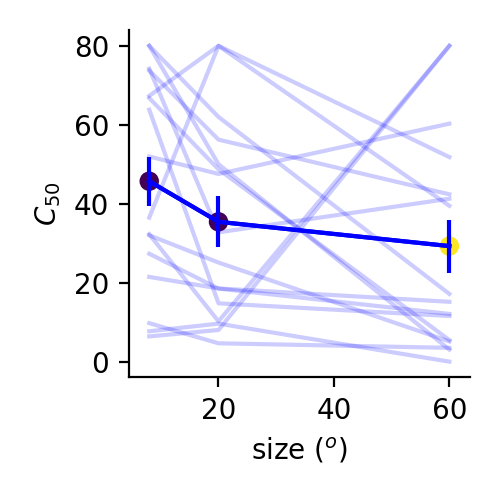

39.72655233197093


In [400]:
    lbls = ['pc_l4','pc_l23','sst','vip','pv']
    c_l4 = np.array((0,0.5,0))
    c_l23 = np.array((0.5,0.5,0.5))
    c_sst = np.array((1,0.65,0))
    c_vip = np.array((1,0,1))
    c_pv = np.array((0,0,1))
    colors = [c_l23,c_pv]
    import naka_rushton_analysis as nra
    reload(nra)
    ucontrast = np.array([0,6,12,25,50,100])
    c50mis = [None for irun in range(2)]
    c50s = [None for irun in range(2)]
    cmax = 6
# for ialign in range(2):
#     c50mis[ialign] = [None for irun in range(2)]
#     c50s[ialign] = [None for irun in range(2)]
    for irun in range(2):
        c50mis[irun] = [None for itype in range(2)]
        c50s[irun] = [None for itype in range(2)]
        for data,c,lbl,itype in zip([rrs[irun],rfs[irun]],[c_l23,c_pv],['pc_l23','pv_l23'],[0,1]):
            nroi = data.shape[0]
            c50s[irun][itype] = np.nan*np.ones((nroi,3))
            for iroi in range(nroi):
                print(iroi)
            #     this_data,this_error = rs[irun][itype][ialign][iroi],rs_sem[irun][itype][ialign][iroi]
            #     this_data = np.nanmean(this_data,2)
            #     this_error = combine_sem(this_error,2)
                this_data = data[iroi,:,:,0]
                lkat = np.all(~np.isnan(this_data),1)
                nparams = np.sum(lkat)
                opt_params = nra.fit_opt_params_two_n(np.array(ucontrast_ephys[:cmax]),this_data[lkat,:cmax])
#                 opt_params = nra.fit_opt_params(ucontrast[:cmax],this_data[lkat,:cmax])
                c50s[irun][itype][iroi,lkat] = opt_params[nparams+1:2*nparams+1]
            c50mis[irun][itype] = c50s[irun][itype][:,0]-c50s[irun][itype][:,-1]

            plt.figure(figsize=(2.5,2.5))
            plt.plot(usize_ephys,c50s[irun][itype].T,alpha=0.2,c=colors[itype])
            ut.plot_bootstrapped_errorbars_hillel(usize_ephys,c50s[irun][itype][:,np.newaxis],pct=(16,84),colors=np.array(colors[itype])[np.newaxis])
            plt.xlabel('size ($^o$)')
            plt.ylabel('$C_{50}$')
            ut.erase_top_right()
            plt.tight_layout()
            plt.savefig('figures/ephys_%s_c50_by_size_%s_%s.jpg'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]),dpi=300)

In [405]:
for irun in range(2):
    for itype in range(2):
        _,p = sst.wilcoxon(c50mis[irun][itype])
        print(p)

0.05818627247985126
0.2586348521835137
0.0987409489608765
0.005723186500070235


In [394]:
this_data.shape

(3, 6)

In [395]:
lkat.shape

(3,)

In [440]:
lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = np.array((0.5,0.5,0.5))
c_sst = np.array((1,0.65,0))
c_vip = np.array((1,0,1))
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in true_divide
  # Remove the CWD from sys.path while we load stuff.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


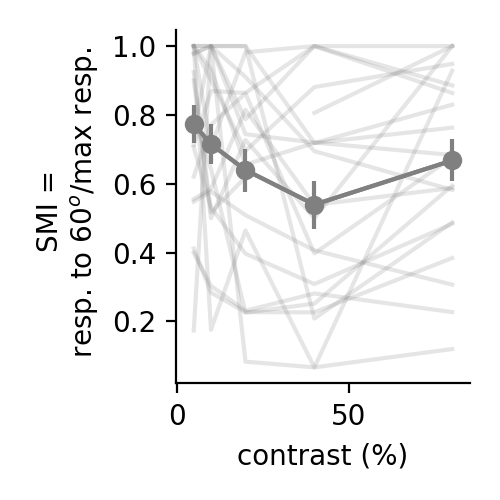

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7164073455115809


<IPython.core.display.Javascript object>


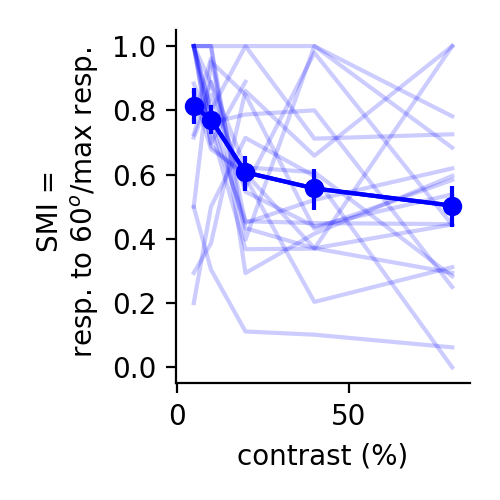

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.75517468365413


<IPython.core.display.Javascript object>


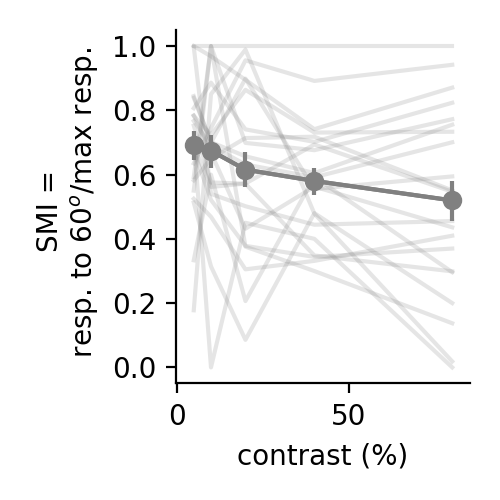

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.651380668372353


<IPython.core.display.Javascript object>


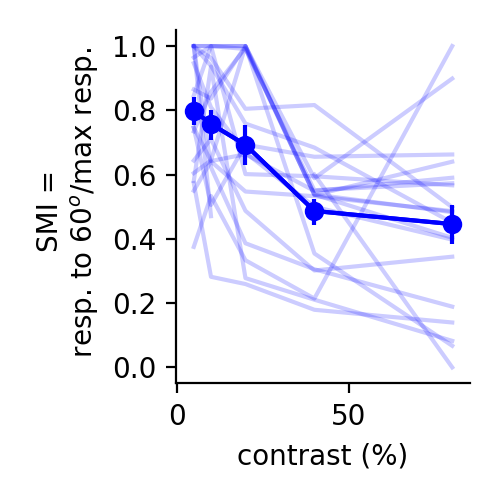

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7545351075940296


In [443]:
smimis = [None for irun in range(2)]
p = [None for irun in range(2)]
for irun in range(2):
    smimis[irun] = [None for itype in range(2)]
    p[irun] = [None for itype in range(2)]
    for itype,data,c,lbl in zip([0,1],[rrs[irun],rfs[irun]],[c_l23,c_pv],['pc_l23','pv_l23']):
        shp = data.shape
        nexpt = shp[0]
        nlight = shp[3]
        smi_expt = data[:,-1,:,0]/np.nanmax(data[:,:,:,0],1)
        plt.figure(figsize=(2.5,2.5))
        ucontrast = [5,10,20,40,80]
        plt.plot(ucontrast,smi_expt[:,1:].T,c=c,alpha=0.2)
        ut.plot_bootstrapped_errorbars_hillel(ucontrast,smi_expt[:,np.newaxis,1:],colors=c[np.newaxis],pct=(16,84))
#         plt.legend(['5%','20%','80%'])
#         plt.xlabel('size ($^o$)')
        plt.ylabel('SMI = \n resp. to 60$^o$/max resp.')
        plt.xlabel('contrast (%)')
        
        plt.tight_layout()
        
        smimis[irun][itype] = smi_expt[:,1]-smi_expt[:,-1]
        ut.erase_top_right()
        plt.savefig('figures/ephys_%s_c50_by_size_%s.jpg'%(lbl,running_lbls[irun]),dpi=300)
        _,p[irun][itype] = sst.wilcoxon(smi_expt[:,1],smi_expt[:,-1])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


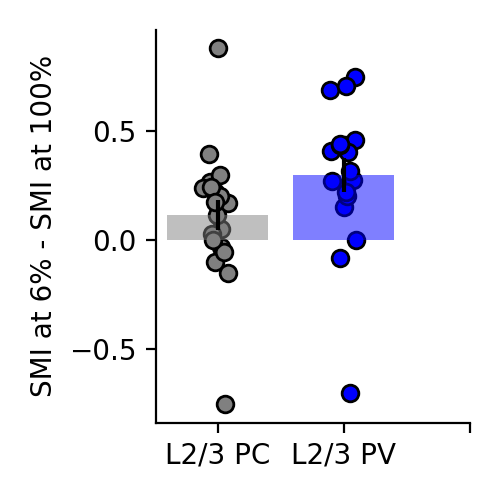

<IPython.core.display.Javascript object>


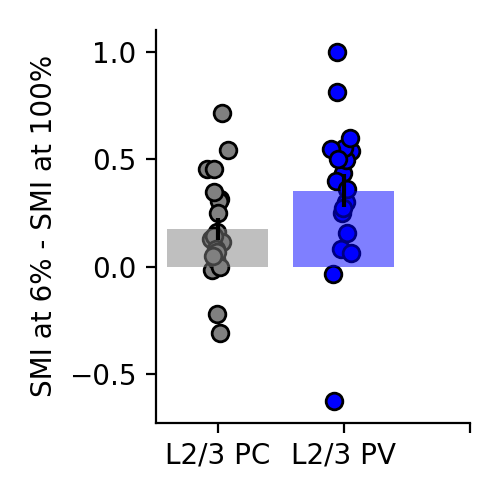

In [444]:

epsilon = 0.05
colors = [(0.5,0.5,0.5),(0,0,1)]
for irun in range(2):
    plt.figure(figsize=(2.5,2.5))
    for iitype,itype in enumerate([0,1]):
        smimi = smimis[irun][itype].copy()
        plt.bar((iitype,),np.nanmean(smimi,0),color=colors[itype],alpha=0.5)
        plt.errorbar((iitype,),np.nanmean(smimi,0),np.nanstd(smimi,0)/np.sqrt(np.sum(~np.isnan(smimi),0)),fmt='none',c='k')
        plt.scatter(iitype*np.ones_like(smimi)+epsilon*np.random.randn(smimi.shape[0]),smimi,facecolor=colors[itype],linewidth=1,edgecolor='k')
    # plt.plot((0+epsilon,1-epsilon),smimi.T,c='k',alpha=0.5)
    plt.xticks((0,1,2),['L2/3 PC','L2/3 PV'])
    plt.ylabel('SMI at 6% - SMI at 100%')
    plt.tight_layout()
# _,p = sst.wilcoxon(smimi[:,0],smimi[:,1])
# print(p)
    ut.erase_top_right()
    plt.savefig('figures/ephys_pc_pv_smimi_bars_%s.jpg'%(running_lbls[irun]),dpi=300)

In [445]:
for irun in range(2):
    print(p[irun])

[0.008967599455194583, 0.0009523796883977106]
[0.0031851432686599455, 0.000701810512606601]


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: invalid value encountered in true_divide
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


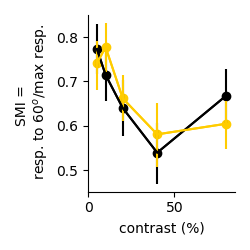

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7233720780954696


<IPython.core.display.Javascript object>


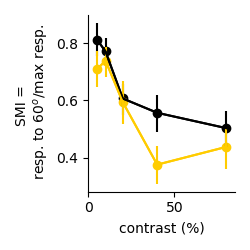

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.75517468365413


<IPython.core.display.Javascript object>


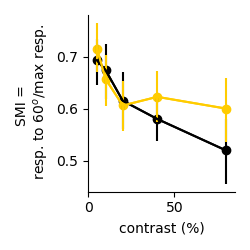

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.6667776553332279


<IPython.core.display.Javascript object>


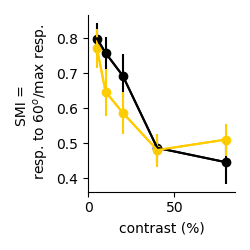

0.7545351075940296


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [594]:
halo_colors = [np.array((0,0,0)),np.array((1,0.8,0))]
smimis = [None for irun in range(2)]
p = [None for irun in range(2)]
for irun in range(2):
    smimis[irun] = [None for itype in range(2)]
    p[irun] = [None for itype in range(2)]
    for itype,data,c,lbl in zip([0,1],[rrs[irun],rfs[irun]],[c_l23,c_pv],['pc_l23','pv_l23']):
        shp = data.shape
        nexpt = shp[0]
        nlight = shp[3]
        smi_expt = data[:,-1,:,:]/np.nanmax(data[:,:,:,:],1)
        plt.figure(figsize=(2.5,2.5))
        ucontrast = [5,10,20,40,80]
#         plt.plot(ucontrast,smi_expt[:,1:,ilight].T,c=c,alpha=0.2)
        ut.plot_bootstrapped_errorbars_hillel(ucontrast,smi_expt[:,1:,:].transpose((0,2,1)),pct=(16,84),colors=halo_colors)
#         plt.legend(['5%','20%','80%'])
#         plt.xlabel('size ($^o$)')
        plt.ylabel('SMI = \n resp. to 60$^o$/max resp.')
        plt.xlabel('contrast (%)')
        
        plt.tight_layout()
        
        smimis[irun][itype] = smi_expt[:,1]-smi_expt[:,-1]
        ut.erase_top_right()
        plt.savefig('figures/ephys_vip_halo_%s_smi_by_size_%s.jpg'%(lbl,running_lbls[irun]),dpi=300)
#         _,p[irun][itype] = sst.wilcoxon(smi_expt[:,1],smi_expt[:,-1])

<IPython.core.display.Javascript object>


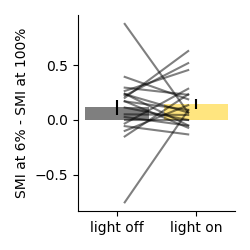

0.2958775226696384


<IPython.core.display.Javascript object>


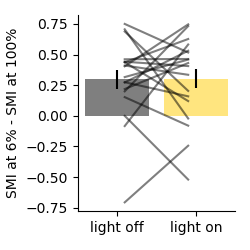

0.2735753578226747


<IPython.core.display.Javascript object>


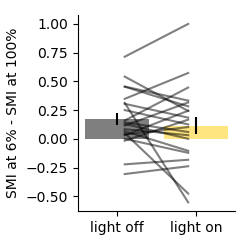

0.614271268095052


<IPython.core.display.Javascript object>


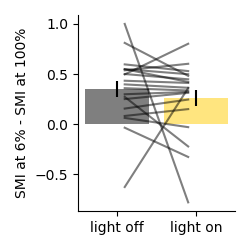

0.13054460509877688


In [595]:
halo_colors = [np.array((0,0,0)),np.array((1,0.8,0))]
itype = 0
running_lbls = ['non_running','running']
for irun in range(2):
    for itype,lbl in zip(range(2),['pc_l23','pv_l23']):
        plt.figure(figsize=(2.5,2.5))
        data = smimis[irun][itype]
        epsilon = 0.1
        colors = ['k',np.array((1,0.8,0))]
        for ilight in range(2):
            plt.bar((ilight,),np.nanmean(data,0)[ilight],color=halo_colors[ilight],alpha=0.5)
        plt.errorbar((0,1),np.nanmean(data,0),np.nanstd(data,0)/np.sqrt(np.sum(~np.isnan(data[:,0]),0)),fmt='none',c='k')
        plt.plot((0+epsilon,1-epsilon),data.T,c='k',alpha=0.5)
        plt.xticks((0,1),['light off','light on'])
        plt.ylabel('SMI at 6% - SMI at 100%')
    #     plt.ylim((0,12))
        ut.erase_top_right()
        plt.tight_layout()
        _,p = sst.wilcoxon(data[:,0],data[:,1])
        print(p)
        plt.savefig('figures/ephys_vip_halo_%s_smimi_bars_%s.jpg'%(lbl,running_lbls[irun]),dpi=300)

(21, 4, 6)
(21, 4, 6)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


<IPython.core.display.Javascript object>


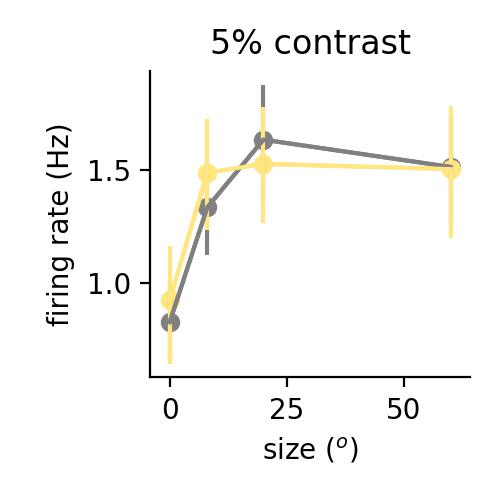

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.3916783405645412


<IPython.core.display.Javascript object>


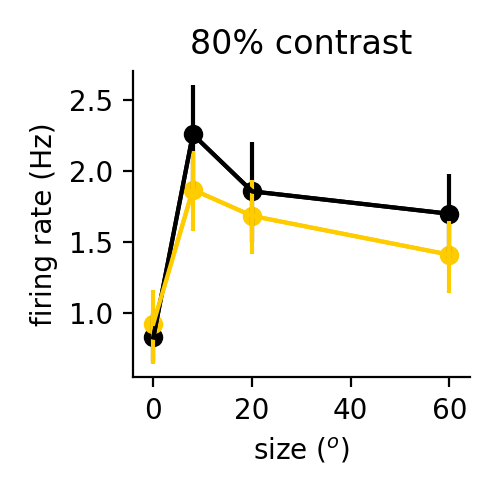

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.907243383597598
(21, 4, 6)
(21, 4, 6)


<IPython.core.display.Javascript object>


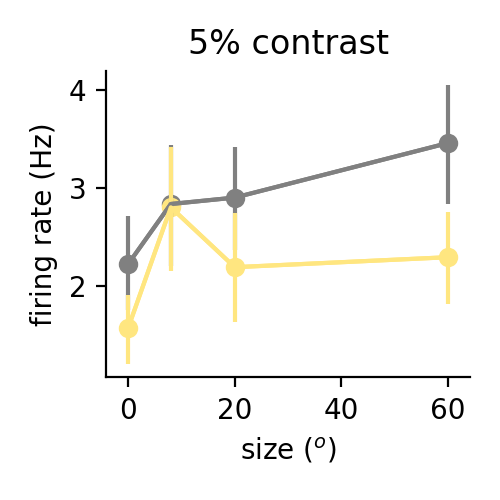

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.8581187729993958


<IPython.core.display.Javascript object>


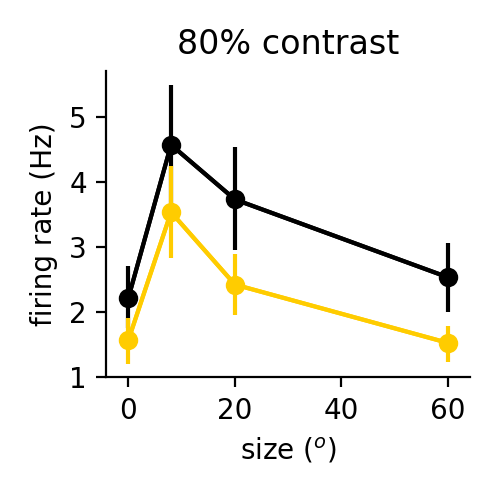

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.6477635756056808
(21, 4, 6)
(21, 4, 6)


<IPython.core.display.Javascript object>


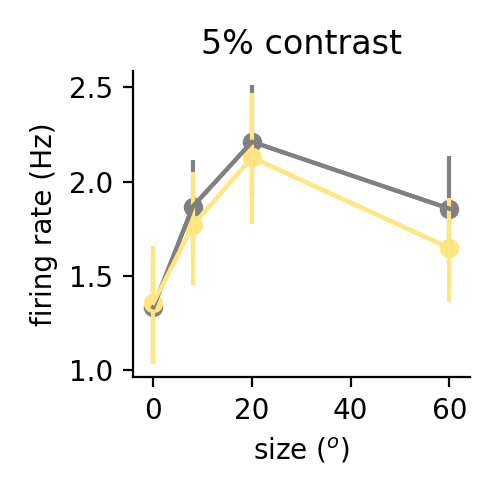

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.9082899827268245


<IPython.core.display.Javascript object>


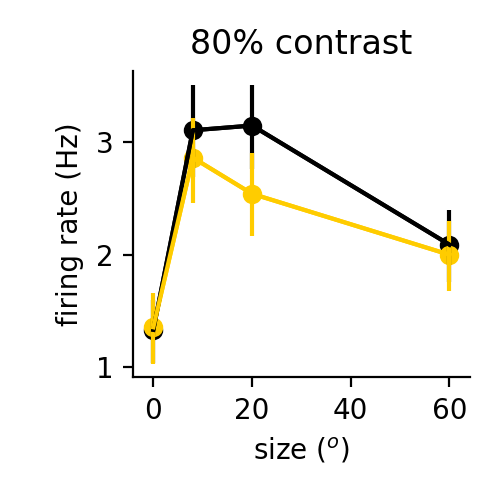

2.7831200319280374


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(21, 4, 6)
(21, 4, 6)


<IPython.core.display.Javascript object>


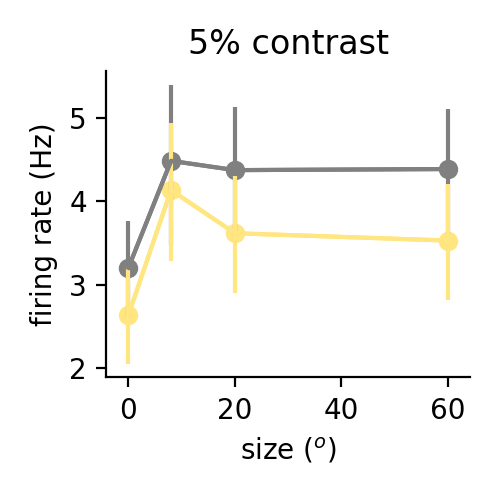

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.6720022572071014


<IPython.core.display.Javascript object>


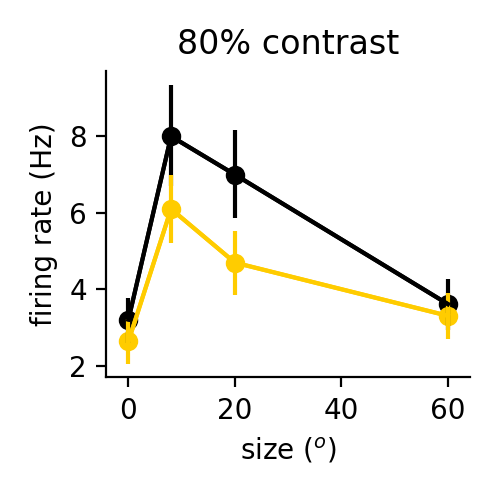

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


6.64054198158223


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [481]:
import sim_utils
# data = scallanimal.copy()
datas = [rrs,rfs]
for irun in range(2):
    for this_data,lbl in zip(datas,['pc_l23','pv_l23']):
        data = this_data[irun]
        size_tuning = np.zeros((data.shape[0],1+data.shape[1],data.shape[2],data.shape[3]))
        for ilight in range(2):
            size_tuning[:,:,:,ilight] = sim_utils.gen_size_tuning(data[:,:,:,ilight]) #[:,:,icontrast,:].transpose((0,2,1)).shape
        ephys_usize = np.array((8,20,60))
        ephys_ucontrast = np.array((0,5,10,20,40,80))
        usize0 = np.concatenate(((0,),ephys_usize))

        colors = [np.array(((0.5,0.5,0.5),(1,0.9,0.5))),np.array(((0,0,0),(1,0.8,0)))]
        for iicontrast,icontrast in enumerate([1,5]):
            plt.figure(figsize=(2.5,2.5))
            ut.plot_bootstrapped_errorbars_hillel(usize0,size_tuning[:,:,icontrast,:].transpose((0,2,1)),pct=(16,84),colors=colors[iicontrast])
            plt.xlabel('size ($^o$)')
        #     plt.ylabel('event rate (a.u.)')
            plt.ylabel('firing rate (Hz)')
        #     plt.legend(['light off','light on'])
            plt.title('%d%% contrast'%ephys_ucontrast[icontrast])
            plt.tight_layout()
            ut.erase_top_right()
            plt.savefig('figures/ephys_vip_halo_%s_size_by_contrast_%d_%s.eps'%(lbl,icontrast,running_lbls[irun]))

In [ ]:
import sim_utils
# data = scallanimal.copy()
datas = [rrs,rfs]
for irun in range(2):
    for this_data,lbl in zip(datas,['pc_l23','pv_l23']):
        data = this_data[irun]
        size_tuning = np.zeros((data.shape[0],1+data.shape[1],data.shape[2],data.shape[3]))
        for ilight in range(2):
            size_tuning[:,:,:,ilight] = sim_utils.gen_size_tuning(data[:,:,:,ilight]) #[:,:,icontrast,:].transpose((0,2,1)).shape
        ephys_usize = np.array((8,20,60))
        ephys_ucontrast = np.array((0,5,10,20,40,80))
        usize0 = np.concatenate(((0,),ephys_usize))

        colors = [np.array(((0.5,0.5,0.5),(1,0.9,0.5))),np.array(((0,0,0),(1,0.8,0)))]
        for iicontrast,icontrast in enumerate([1,5]):
            plt.figure(figsize=(2.5,2.5))
            ut.plot_bootstrapped_errorbars_hillel(usize0,size_tuning[:,:,icontrast,:].transpose((0,2,1)),pct=(16,84),colors=colors[iicontrast])
            plt.xlabel('size ($^o$)')
        #     plt.ylabel('event rate (a.u.)')
            plt.ylabel('firing rate (Hz)')
        #     plt.legend(['light off','light on'])
            plt.title('%d%% contrast'%ephys_ucontrast[icontrast])
            plt.tight_layout()
            ut.erase_top_right()
#             plt.savefig('figures/ephys_vip_halo_%s_size_by_contrast_%d_%s.eps'%(lbl,icontrast,running_lbls[irun]))

In [ ]:
plt.figure(figsize=(2.5,2.5))
data = rfs_orig[irun][:,0,:]
epsilon = 0.1
colors = ['k',np.array((1,0.8,0))]
for ilight in range(2):
    plt.bar((ilight,),np.nanmean(data,0)[ilight],color=colors[ilight],alpha=0.5)
plt.errorbar((0,1),np.nanmean(data,0),np.nanstd(data,0)/np.sqrt(np.sum(~np.isnan(data[:,0]),0)),fmt='none',c='k')
plt.plot((0+epsilon,1-epsilon),data.T,c='k',alpha=0.5)
plt.xticks((0,1),['light off','light on'])
plt.ylabel('FS firing rate, gray screen')
plt.ylim((0,12))
ut.erase_top_right()
plt.tight_layout()
_,p = sst.wilcoxon(data[:,0],data[:,1])
print(p)
# plt.savefig('figures/halo_rs_gray_screen_bars.jpg',dpi=300)

<IPython.core.display.Javascript object>


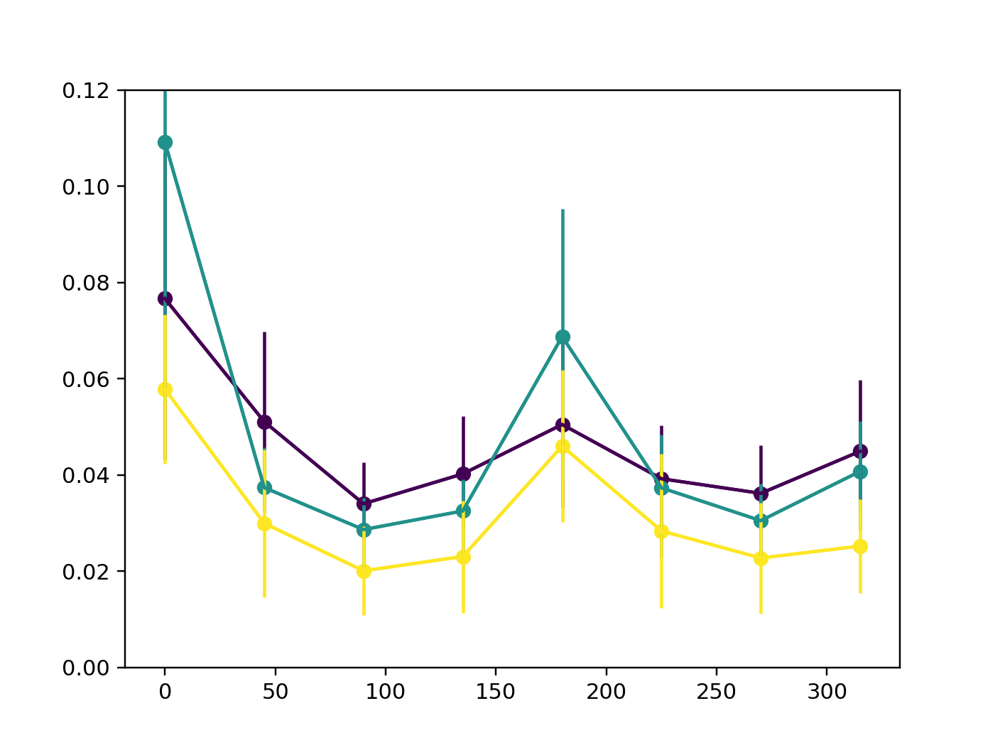

/Users/dan/Documents/code/adesnal/pyute.py:124: RuntimeWarning: Mean of empty slice
  stat = fn(resamp,axis=axis)
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.06143082139077355


(0, 0.12)

In [490]:
plt.figure()
ut.plot_bootstrapped_errorbars_hillel(np.arange(0,360,45),rsexpt[irun][itype][ialign][:,[1,3,5],-1,:])
plt.ylim((0,0.12))

In [488]:
pdb.pm()

> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/axes/_axes.py(3368)extract_err()
-> f"The lengths of the data ({len(data)}) and the "
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/axes/_axes.py(3424)errorbar()
-> lower, upper = extract_err(yerr, y)
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/__init__.py(1601)inner()
-> return func(ax, *map(sanitize_sequence, args), **kwargs)
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/pyplot.py(2560)errorbar()
-> **({"data": data} if data is not None else {}), **kwargs)
(Pdb) u
> /Users/dan/Documents/code/adesnal/pyute.py(952)plot_errorbar_hillel()
-> plt.errorbar(x,mn_tgt,yerr=errors,c=cc,linestyle=linestyle) #,fmt=None)
(Pdb) x.shape
(8,)
(Pdb) mn_tgt.shape
()
(Pdb) mn_tgt
0.08122277688530759
(Pdb) u
> /Users/dan/Documents/code/adesnal/pyute.py(906)plot_errorbars_hillel()
-> plot_errorbar_hillel(x,mn_tgt[i],lb_tgt[i],ub_tgt[i],c=colors[i],linewidth=l

<IPython.core.display.Javascript object>


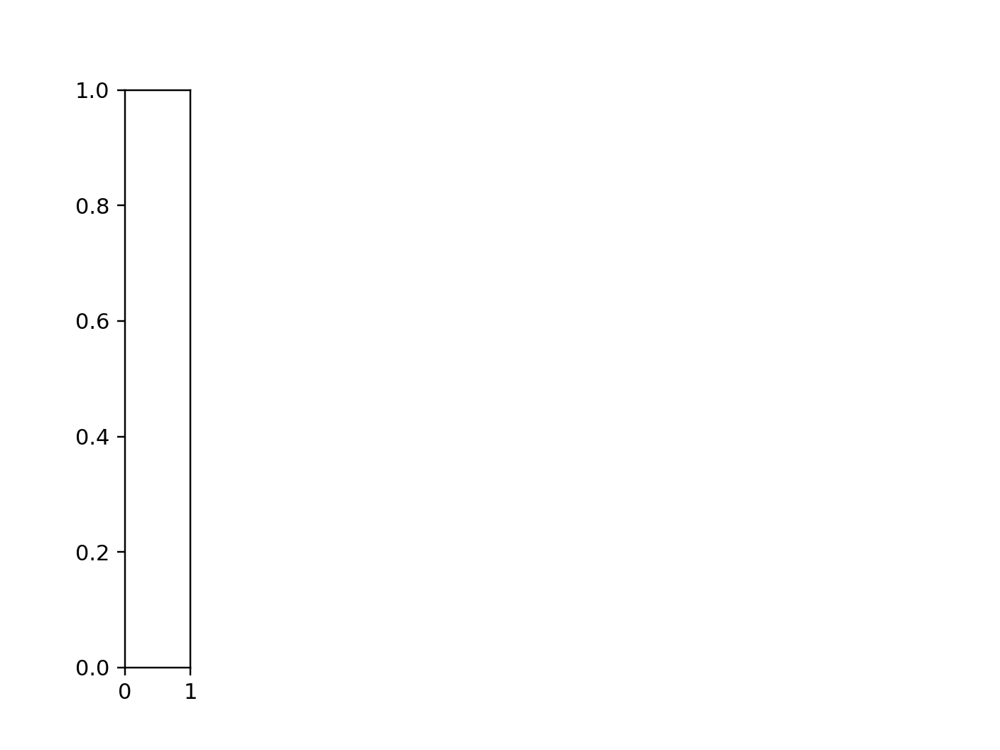

IndexError: index 900 is out of bounds for axis 0 with size 807

In [398]:
plt.figure() 
for iroi in range(10):
    plt.subplot(1,10,iroi+1)
    plt.imshow(np.nanmean(rs[0][itype][ialign][900+iroi][:,:,:],-1))
    plt.axis('off')

In [468]:
def compute_mean_sem(x):
    xmean = np.nanmean(x,0)
    n_non_nan = np.sum(~np.isnan(x),0)
    xsem = np.nanstd(x,0)/np.sqrt(n_non_nan)
    return xmean,xsem
def compute_mean_sem_zero_nonzero(x):
    xmean,xsem = compute_mean_sem(x)
    lkat = ~np.isnan(xsem[:,0])
    xmean[lkat,0] = np.nanmean(xmean[lkat,0])
    xsem[lkat,0] = np.sqrt(np.nansum(xsem[lkat,0]**2))/np.sum(lkat)
    return xmean,xsem

<IPython.core.display.Javascript object>


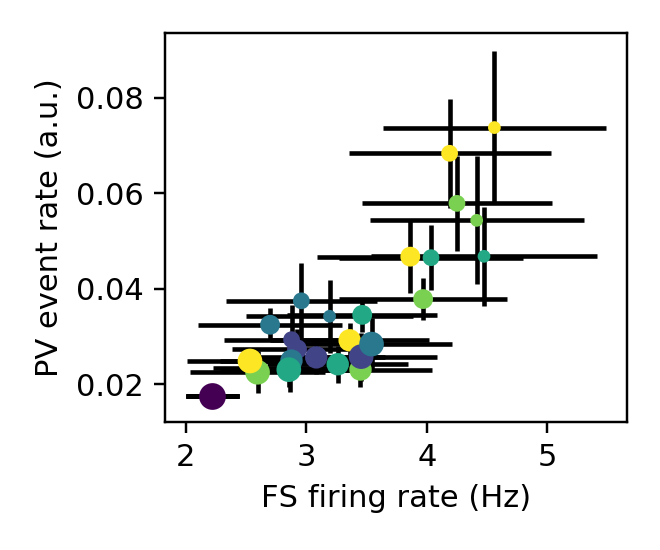

In [469]:
plt.figure(figsize=(3,2.5))
irun,itype,ialign = 0,4,0
x = rfs[irun][:,:,:,0]
xmean,xsem = compute_mean_sem_zero_nonzero(x)
y = np.nanmean(rsexpt[irun][itype][ialign],-1)
ymean,ysem = compute_mean_sem_zero_nonzero(y)
lkat = ~np.isnan(ymean) & ~np.isnan(xmean)
plt.errorbar(xmean[lkat],ymean[lkat],yerr=ysem[lkat],xerr=xsem[lkat],fmt='none',c='k',zorder=1)
sca.scatter_size_contrast(xmean[lkat].reshape((5,6)),ymean[lkat].reshape((5,6)),equality_line=False,square=False,equate_0=True)
plt.xlabel('FS firing rate (Hz)')
plt.ylabel('PV event rate (a.u.)')
plt.tight_layout()
plt.savefig('figures/fs_ca_comparison.eps')

<IPython.core.display.Javascript object>


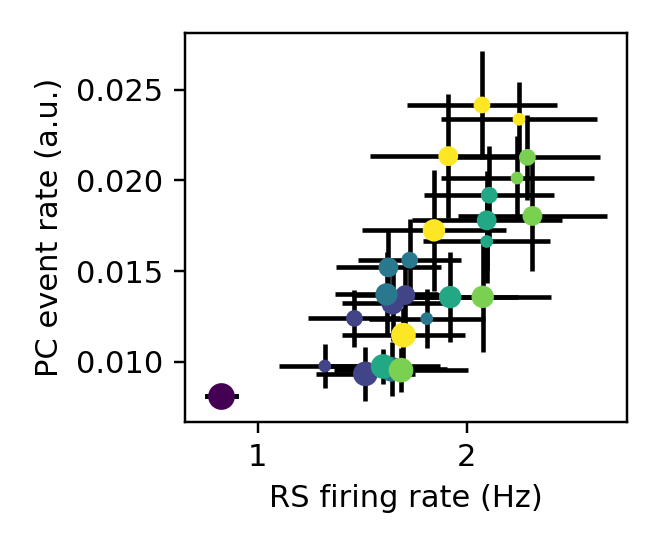

In [470]:
plt.figure(figsize=(3,2.5))
irun,itype,ialign = 0,1,0
x = rrs[irun][:,:,:,0]
xmean,xsem = compute_mean_sem_zero_nonzero(x)
y = np.nanmean(rsexpt[irun][itype][ialign],-1)
ymean,ysem = compute_mean_sem_zero_nonzero(y)
lkat = ~np.isnan(ymean) & ~np.isnan(xmean)
plt.errorbar(xmean[lkat],ymean[lkat],yerr=ysem[lkat],xerr=xsem[lkat],fmt='none',c='k',zorder=1)
sca.scatter_size_contrast(xmean[lkat].reshape((5,6)),ymean[lkat].reshape((5,6)),equality_line=False,square=False,equate_0=True)
plt.xlabel('RS firing rate (Hz)')
plt.ylabel('PC event rate (a.u.)')
plt.tight_layout()
plt.savefig('figures/rs_ca_comparison.eps')

In [461]:
lkat

array([[ True, False, False, False, False, False],
       [ True,  True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True,  True]])

In [220]:
pdb.pm()

> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/axes/_axes.py(3368)extract_err()
-> f"The lengths of the data ({len(data)}) and the "
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/axes/_axes.py(3424)errorbar()
-> lower, upper = extract_err(yerr, y)
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/__init__.py(1601)inner()
-> return func(ax, *map(sanitize_sequence, args), **kwargs)
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/pyplot.py(2560)errorbar()
-> **({"data": data} if data is not None else {}), **kwargs)
(Pdb) u
> /Users/dan/Documents/code/adesnal/pyute.py(951)plot_errorbar_hillel()
-> plt.errorbar(x,mn_tgt,yerr=errors,c=cc,linestyle=linestyle) #,fmt=None)
(Pdb) errors.shape
(2,)
(Pdb) errors
array([11.75044641, 10.74492034])
(Pdb) mn_tgt.shape
()
(Pdb) exit


In [165]:
def compute_sem(arr,axis=0):
    n_non_nan = np.sum(~np.isnan(arr),axis=axis)
    return np.nanstd(arr,axis=axis)/np.sqrt(n_non_nan)

In [14]:
c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

# c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
# c_l23 = np.array(((0.6,0.6,0.6),(0.3,0.3,0.3),(0,0,0)))
# c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
# colors = [c_l4,c_l23,None,None,c_pv]

# c_l4 = np.array(((0.6,1,0.6),(0.3,1,0.3),(0,1,0)))
# c_l23 = np.array(((0.6,0.6,0.6),(0.3,0.3,0.3),(0,0,0)))
# c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
# colors = [c_l4,c_l23,None,None,c_pv]

In [851]:
rsexpt[irun][itype][ialign].shape

(6, 6, 6, 8)

In [1187]:
import os
os.listdir()

['041.npy',
 '040.npy',
 '042.npy',
 '043.npy',
 '047.npy',
 '046.npy',
 '044.npy',
 '045.npy',
 '036.npy',
 '022.npy',
 '023.npy',
 '037.npy',
 '021.npy',
 '035.npy',
 '009.npy',
 '008.npy',
 '034.npy',
 '020.npy',
 '018.npy',
 '024.npy',
 '030.npy',
 '031.npy',
 '025.npy',
 '019.npy',
 '033.npy',
 '027.npy',
 '026.npy',
 '032.npy',
 '017.npy',
 '003.npy',
 '002.npy',
 '016.npy',
 '000.npy',
 '014.npy',
 '028.npy',
 '029.npy',
 '015.npy',
 '001.npy',
 '039.npy',
 '005.npy',
 '011.npy',
 '010.npy',
 '004.npy',
 '038.npy',
 '012.npy',
 '006.npy',
 '007.npy',
 '013.npy',
 '048.npy',
 '049.npy']

In [1192]:
npyfile = np.load('../shared_data/calnet_data/weights/weights_200715a/000.npy',allow_pickle=True)[()]

In [38]:
irun = 0
itype = 4
ialign = 0
rsexpt[irun][itype][ialign].shape

(7, 6, 6, 8)

<IPython.core.display.Javascript object>


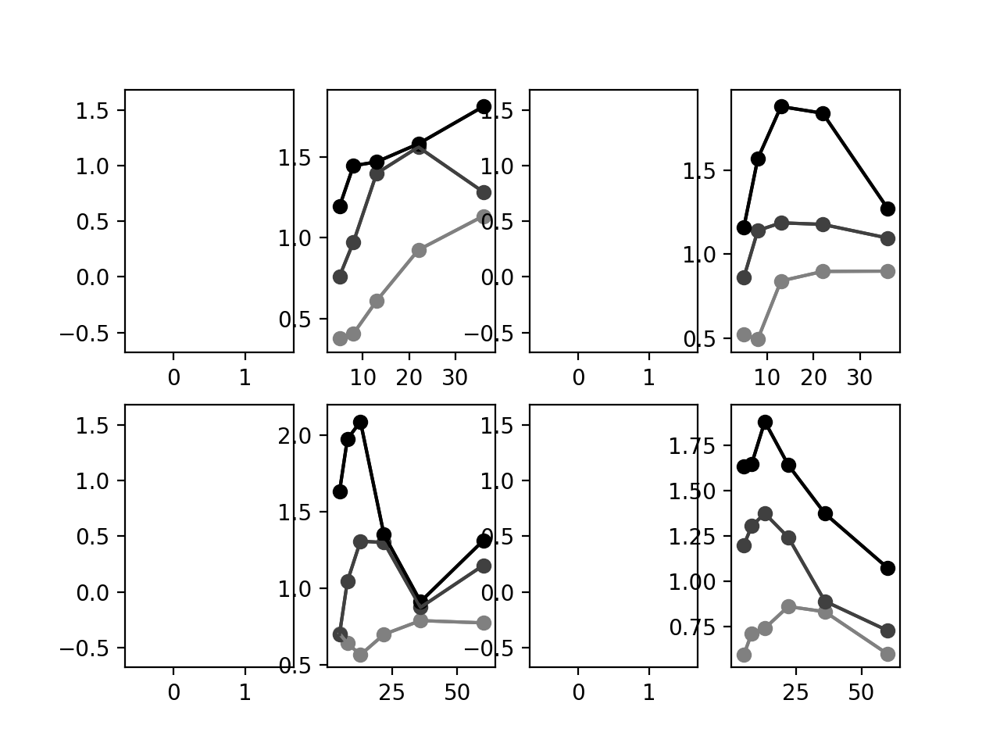

/Users/dan/Documents/code/adesnal/pyute.py:885: RuntimeWarning: Mean of empty slice
  mn_tgt = np.nanmean(arr,0)
/Users/dan/Documents/code/adesnal/pyute.py:124: RuntimeWarning: Mean of empty slice
  stat = fn(resamp,axis=axis)
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/lib/nanfunctions.py:1392: RuntimeWarning: All-NaN slice encountered
  overwrite_input, interpolation)
/Users/dan/Documents/code/adesnal/pyute.py:887: RuntimeWarning: All-NaN slice encountered
  print(np.nanmax(lb_tgt))
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if 

nan
1.8088600243137138
nan
1.8802944572312086
nan
2.090592049415938
nan


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.881111692633096


ValueError: num must be 1 <= num <= 8, not 9

In [15]:
data = np.nanmean(rsexpt[irun][itype][ialign],-1)
plt.figure()
for iexpt in range(data.shape[0]):
    plt.subplot(2,4,iexpt+1)
    ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],data[iexpt:iexpt+1,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
    
smi = data[:,-1,:]/np.max(data,axis=1)
plt.figure()
for iexpt in range(data.shape[0]):
    plt.subplot(2,4,iexpt+1)
    plt.plot(smi[iexpt])
    plt.ylim((0,1))

<IPython.core.display.Javascript object>


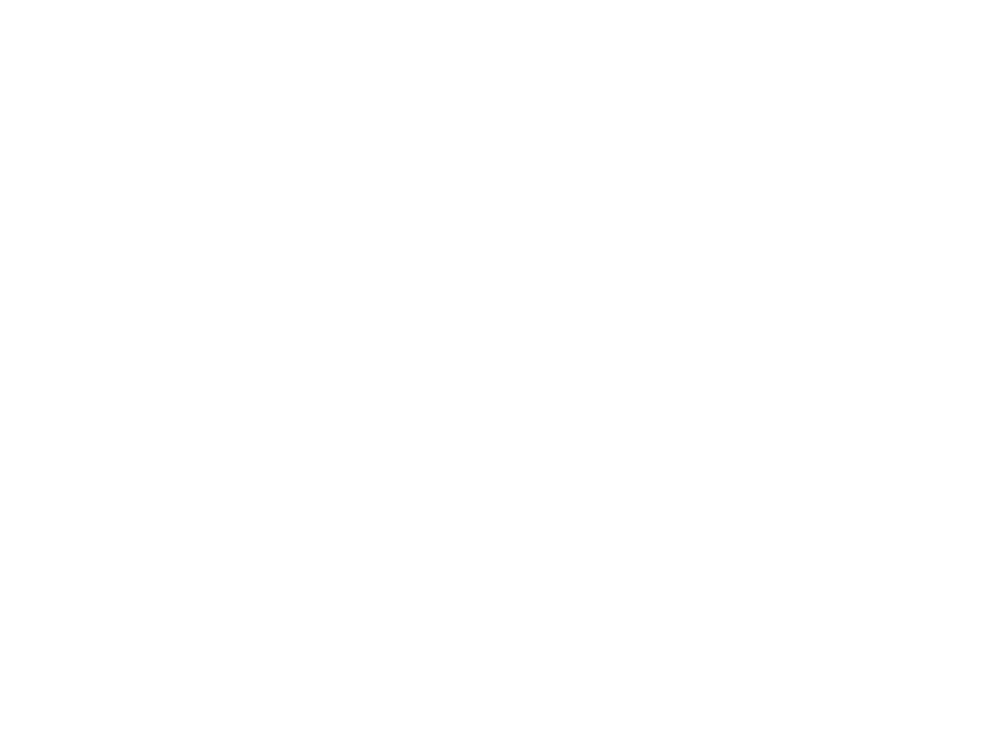

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

nan
1.8088600243137138
nan
1.8802944572312086
nan
2.090592049415938
nan


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.881111692633096
1.8446304079615419
3.0024367142472497
1.5715482959239193
1.5623946244518452


ValueError: num must be 1 <= num <= 12, not 13

In [16]:
irun = 0
itype = 1
for ialign in range(2):
    data = np.nanmean(rsexpt[irun][itype][ialign],-1)
    plt.figure()
    for iexpt in range(data.shape[0]):
        plt.subplot(3,4,iexpt+1)
        ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],data[iexpt:iexpt+1,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
    
# smi = data[:,-1,:]/np.max(data,axis=1)
# plt.figure()
# for iexpt in range(data.shape[0]):
#     plt.subplot(2,4,iexpt+1)
#     plt.plot(smi[iexpt])
#     plt.ylim((0,1))

In [116]:
np.sum(~np.isnan(rsexpt[0][2][0][:,-1,0,0]),0)

2

In [353]:
with ut.hdf5read(dsnames[2]) as ds:
    keylist = list(ds.keys())
    print(len(keylist))
    print(keylist)

10
['session_180713_M9053', 'session_180714_M9053', 'session_180802_M9053', 'session_180821_M9417', 'session_181117_M10039', 'session_181120_M10039', 'session_181121_M10039', 'session_191224_M0390', 'session_200109_M0755', 'session_200819_M0638']


[0. 0. 0. 1. 1. 0. 1. 1. 0. 1.]


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


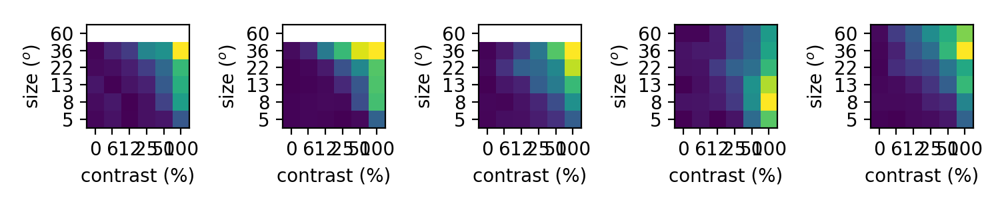

In [360]:
data = rsexpt[0][2][0]
lkat = np.zeros((data.shape[0],))
for iexpt in range(data.shape[0]):
    lkat[iexpt] = ~np.all(np.isnan(data[iexpt]))
print(lkat)
plt.figure(figsize=(7.5,1.5))
for iiexpt,iexpt in enumerate(np.where(lkat)[0]):
    plt.subplot(1,5,iiexpt+1)
    sca.show_size_contrast(np.nanmean(data,3)[iexpt],flipud=True)
plt.tight_layout()
plt.savefig('figures/all_sst_centered.eps')

[0. 0. 1. 1. 1. 1. 1. 1. 1. 1.]


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


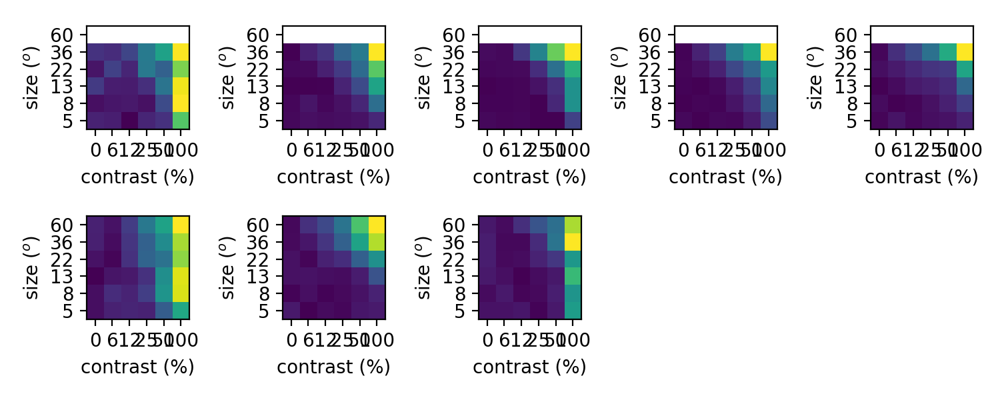

In [361]:
data = rsexpt[0][2][1]
lkat = np.zeros((data.shape[0],))
for iexpt in range(data.shape[0]):
    lkat[iexpt] = ~np.all(np.isnan(data[iexpt]))
print(lkat)
plt.figure(figsize=(7.5,3))
for iiexpt,iexpt in enumerate(np.where(lkat)[0]):
    plt.subplot(2,5,iiexpt+1)
    sca.show_size_contrast(np.nanmean(data,3)[iexpt],flipud=True)
plt.tight_layout()
plt.savefig('figures/all_sst_non_centered.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


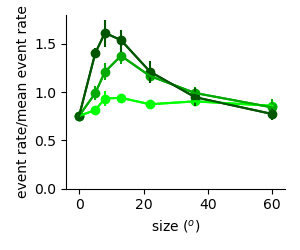

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
1.470315697980157


<IPython.core.display.Javascript object>


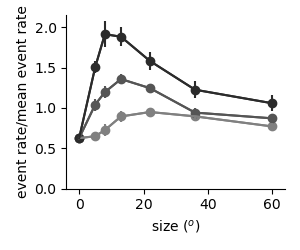

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
1.7666639321150273


<IPython.core.display.Javascript object>


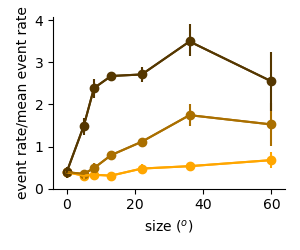

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
3.1526171786791197


<IPython.core.display.Javascript object>


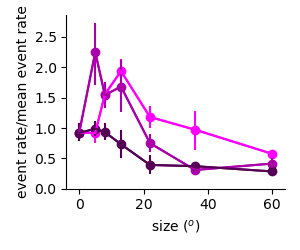

(13, 7, 6)
1.717709315469773


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


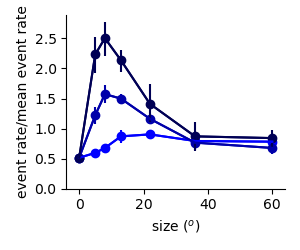

(7, 7, 6)
2.211657216333737


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


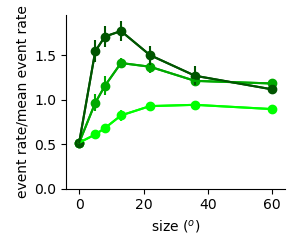

(10, 7, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.6644051921211211


<IPython.core.display.Javascript object>


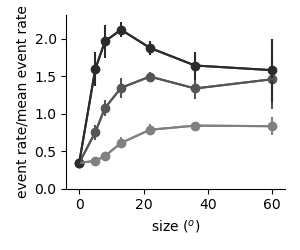

(13, 7, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.025973558549809


<IPython.core.display.Javascript object>


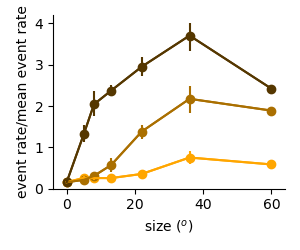

(10, 7, 6)
3.3342797535143265


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


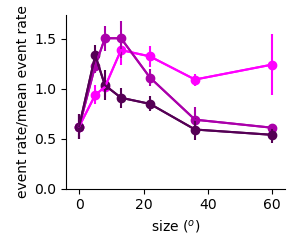

(13, 7, 6)
1.3766993352660406


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


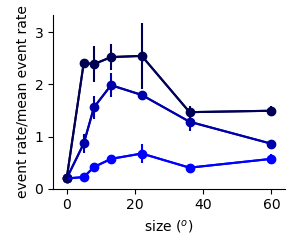

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(7, 7, 6)
2.3609207886044574


<IPython.core.display.Javascript object>


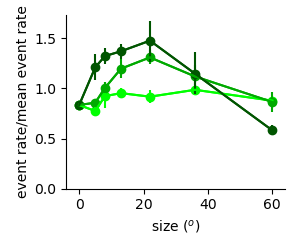

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
1.2916208724790195


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


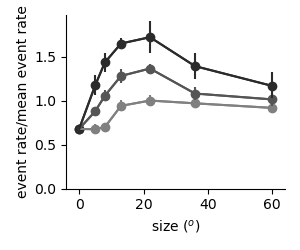

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
1.5849714983747067


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


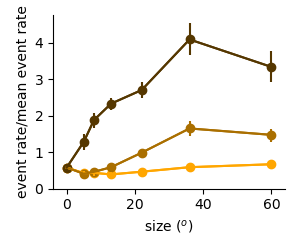

(10, 7, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.6660409579187383


<IPython.core.display.Javascript object>


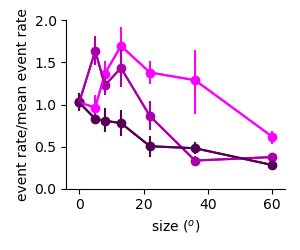

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
1.4657776991012121


<IPython.core.display.Javascript object>


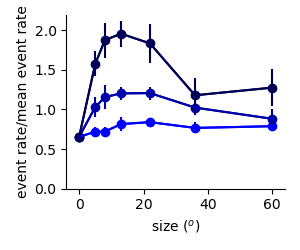

(7, 7, 6)
1.786419265508632


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


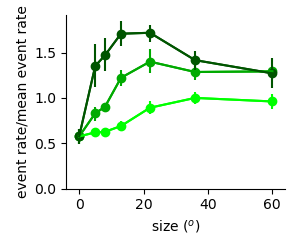

(10, 7, 6)


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.616441510079526


<IPython.core.display.Javascript object>


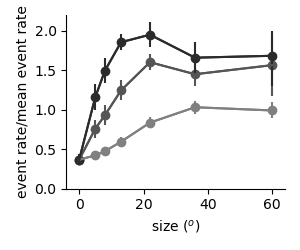

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
1.7916000204152385


<IPython.core.display.Javascript object>


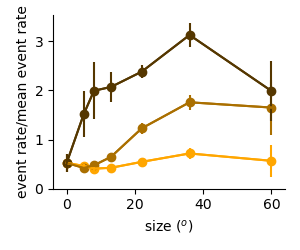

(10, 7, 6)
2.88357130999462


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


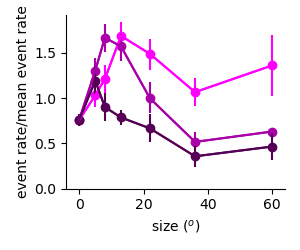

(13, 7, 6)
1.530768947163159


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


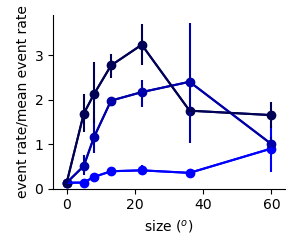

(7, 7, 6)
2.779921513138138


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [70]:
these_contrasts = [1,3,5]
this_ncontrast = len(these_contrasts)
# cfrac = np.linspace(0,1,this_ncontrast+1)
# c_l4 = cfrac[1:,np.newaxis]*np.array(((0,1,0)))
# c_sst = cfrac[1:,np.newaxis]*np.array(((1,0.65,0)))
# c_vip = cfrac[1:,np.newaxis]*np.array(((1,0,1)))
# c_pv = cfrac[1:,np.newaxis]*np.array(((0,0,1)))
# c_l23 = cfrac[1:,np.newaxis]*np.array(((0.5,0.5,0.5)))#(1-cfrac[:-1,np.newaxis])*np.array(((0.5,0.5,0.5)))
cfrac = np.linspace(1,0,this_ncontrast+1)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]

reload(ut)
for ialign in range(2):
    for irun in range(2):
        lbls = ['pc_l4','pc_l23','sst','vip','pv']
        for itype in [0,1,2,3,4]:#range(len(rsexpt)):
            plt.figure(figsize=(3,2.5))
            data = np.nanmean(rsexpt[irun][itype][ialign],-1)
            data = sim_utils.gen_size_tuning(data)
            data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
        #     for icontrast in range(6):
            #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
            ut.plot_bootstrapped_errorbars_hillel([0,5,8,13,22,36,60],data[:,:,these_contrasts].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
            plt.gca().set_ylim(bottom=0)
            #             plt.legend(['6%','25%','100%'])
            plt.xlabel('size ($^o$)')
            plt.ylabel('event rate/mean event rate')
            ut.erase_top_right()
            plt.tight_layout()
            plt.savefig('figures/%s_size_by_3_contrasts_%s_%s.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))

In [200]:
1-cfrac

array([0.66666667, 0.33333333, 0.        ])

In [198]:
c_l23

array([[0.33333333, 0.33333333, 0.33333333],
       [0.16666667, 0.16666667, 0.16666667],
       [0.        , 0.        , 0.        ]])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


<IPython.core.display.Javascript object>


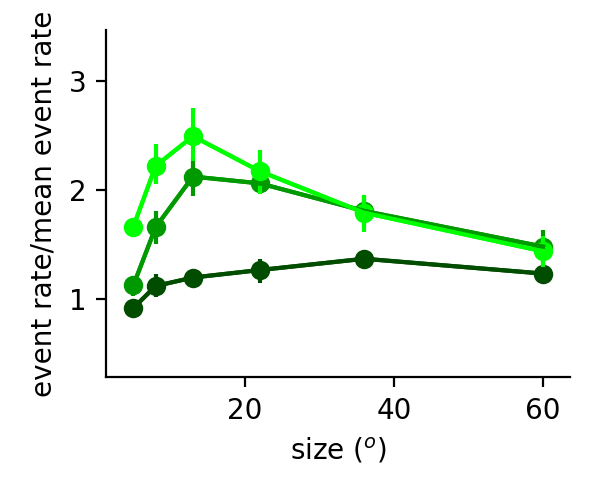

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.2289176646512


<IPython.core.display.Javascript object>


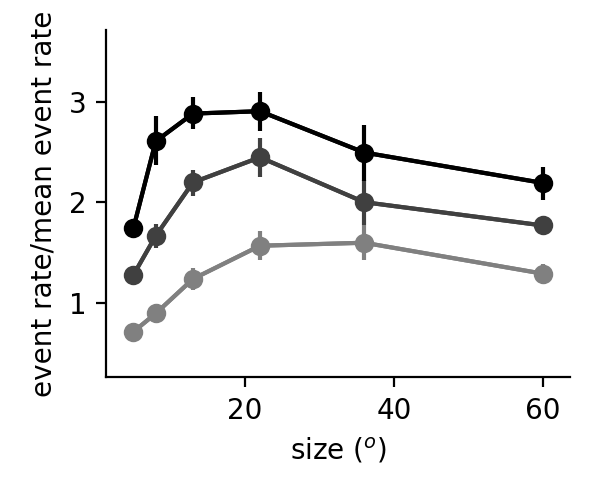

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.7204800983159796


<IPython.core.display.Javascript object>


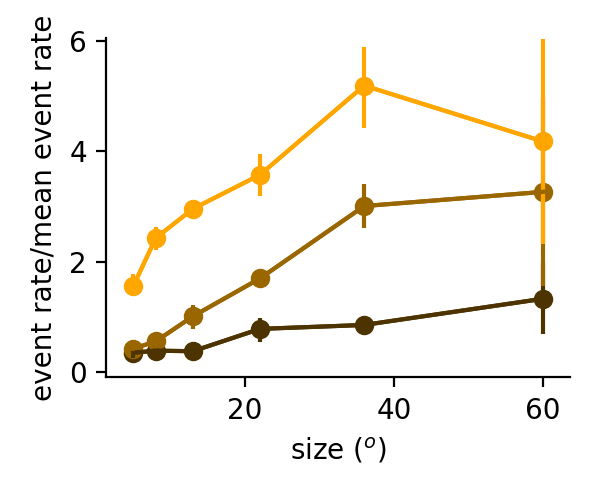

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


4.481111228771674


<IPython.core.display.Javascript object>


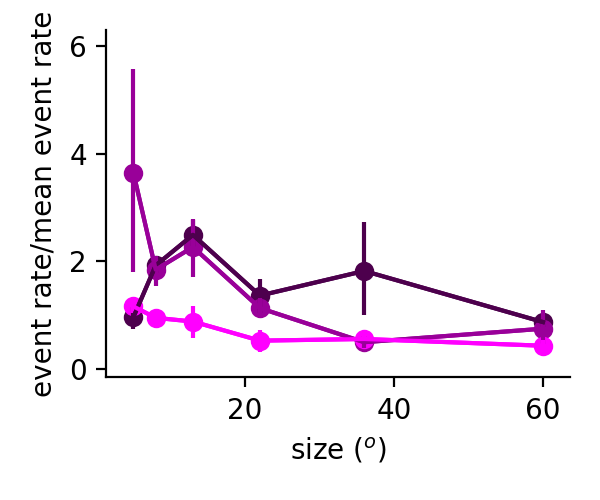

2.2218836156086925


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


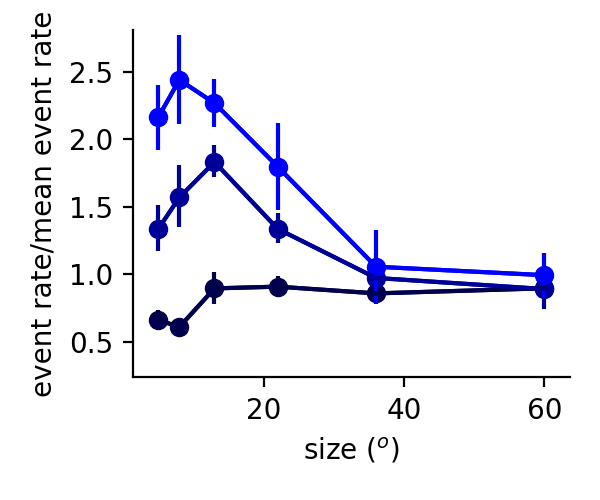

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.109148094951839


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


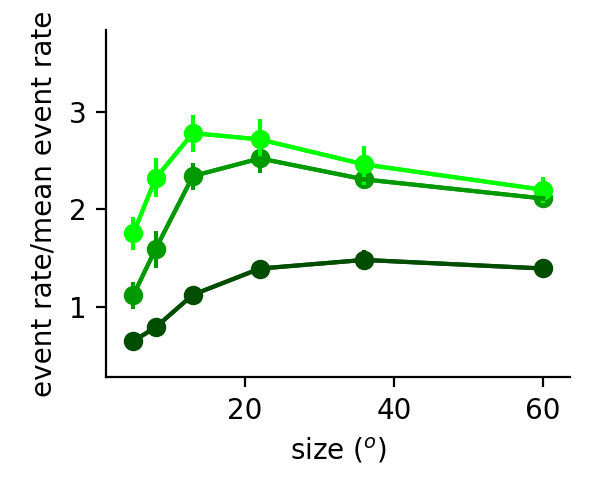

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.5940095378748866


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


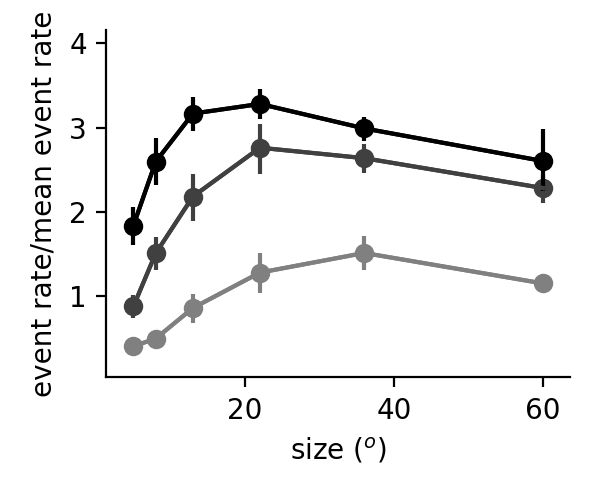

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.1011858164986794


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


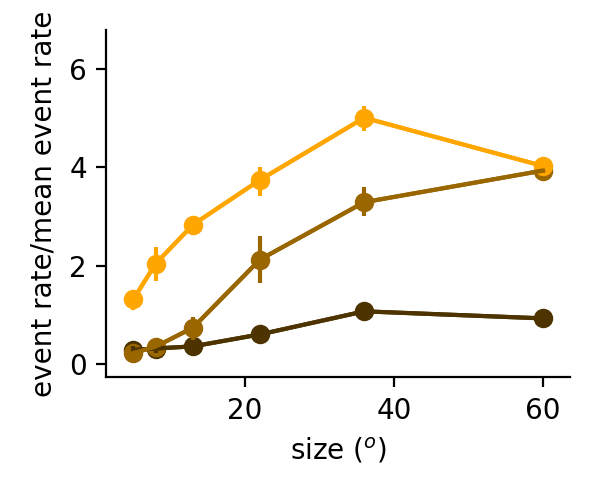

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


4.7636791860207754


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


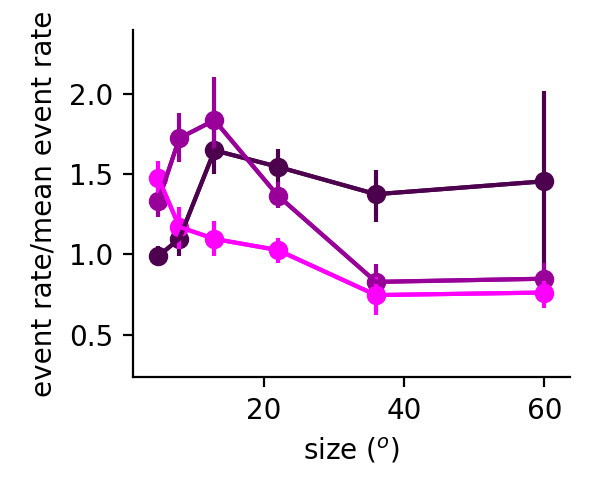

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.567002308959129


<IPython.core.display.Javascript object>


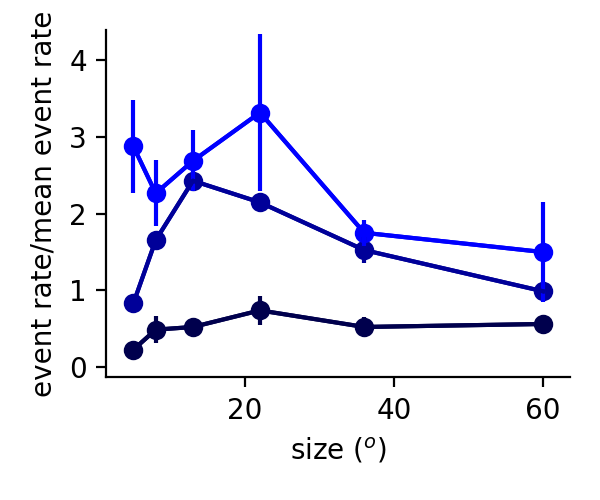

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.3120948079972594


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


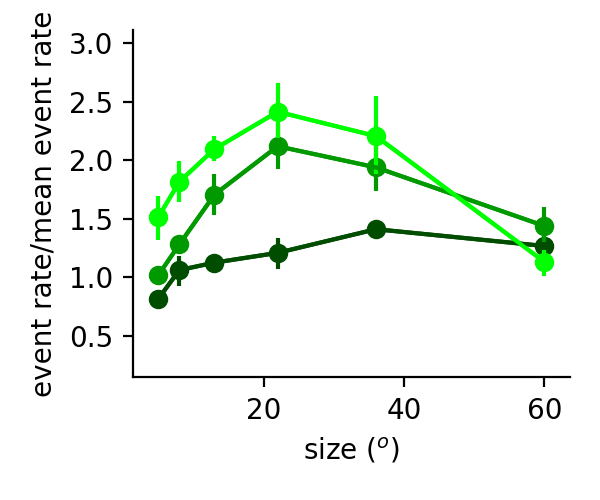

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.164336270191612


<IPython.core.display.Javascript object>


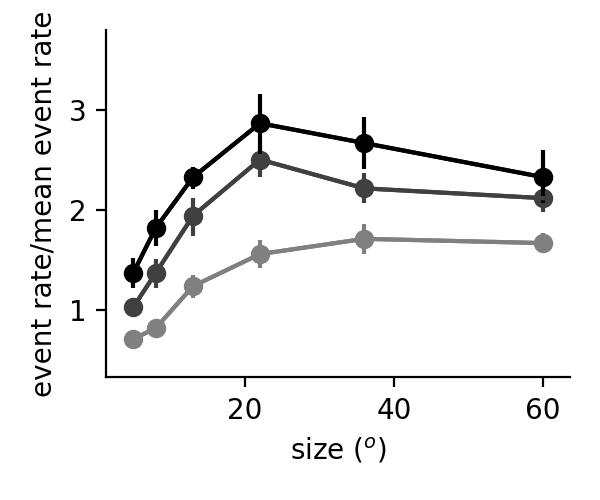

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.581742572099694


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


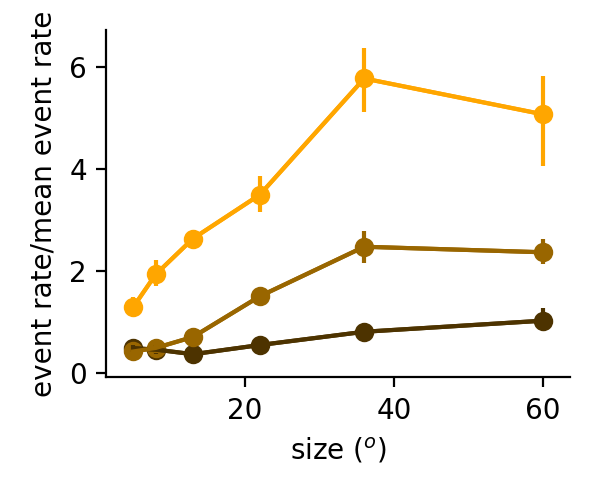

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


5.177730389062454


<IPython.core.display.Javascript object>


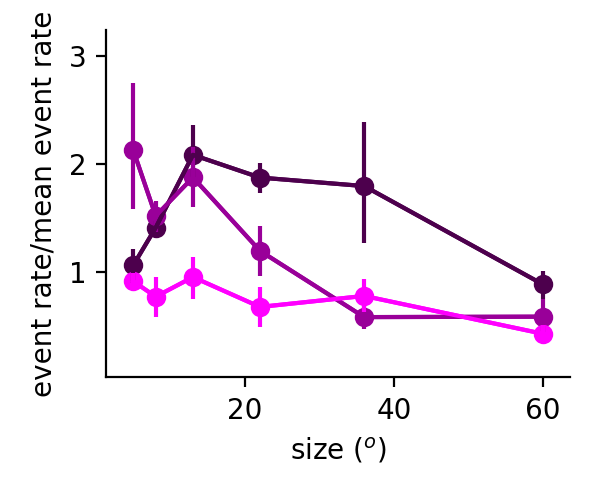

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.8040912722194853


<IPython.core.display.Javascript object>


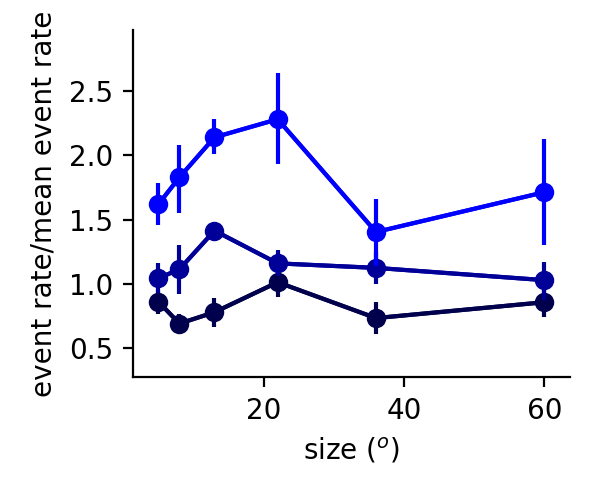

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.00068410253591


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


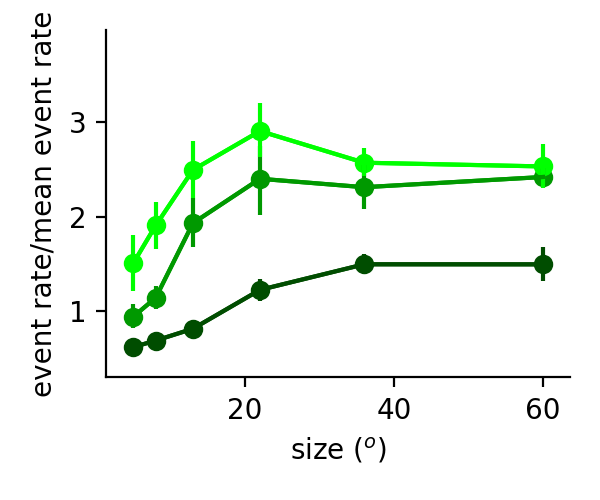

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.6043959356232698


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


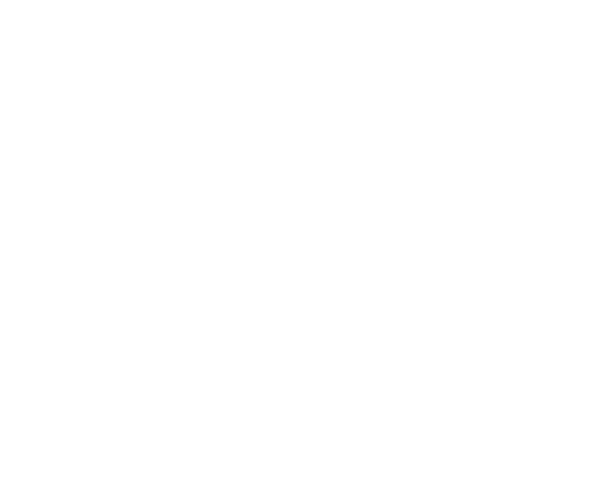

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.8977282319340874


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


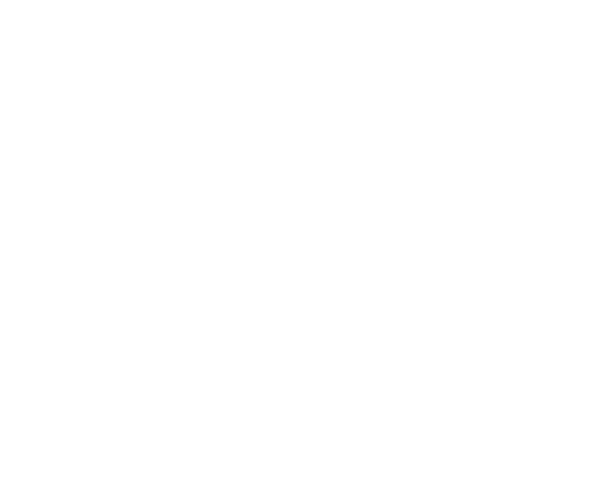

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.6735990921058708


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


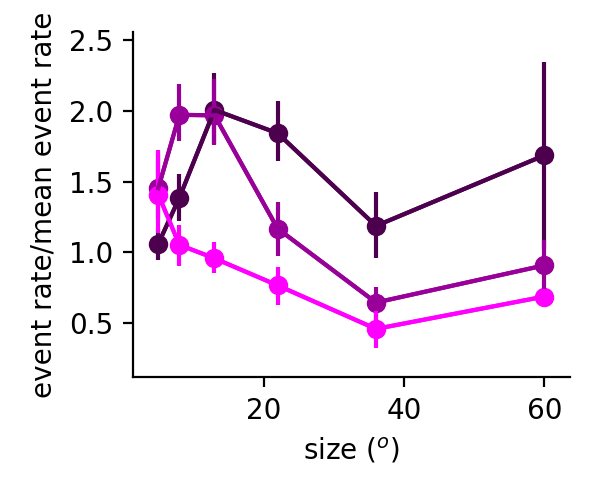

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.7535462663366284


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


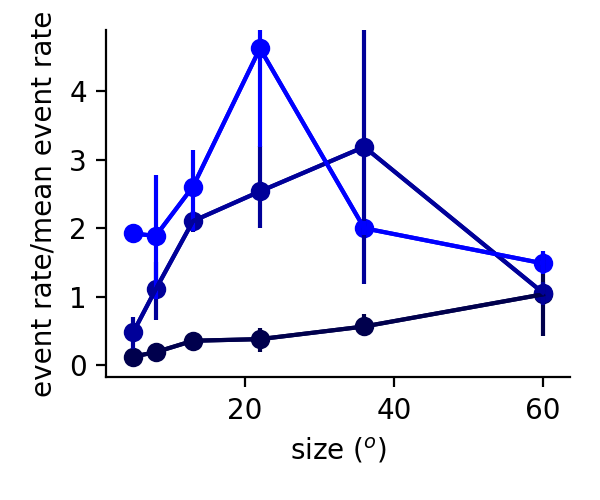

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.0229729520823296


<IPython.core.display.Javascript object>


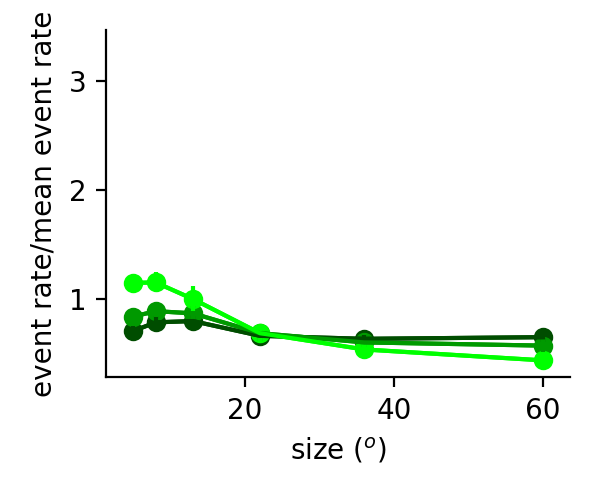

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.090264009147493


<IPython.core.display.Javascript object>


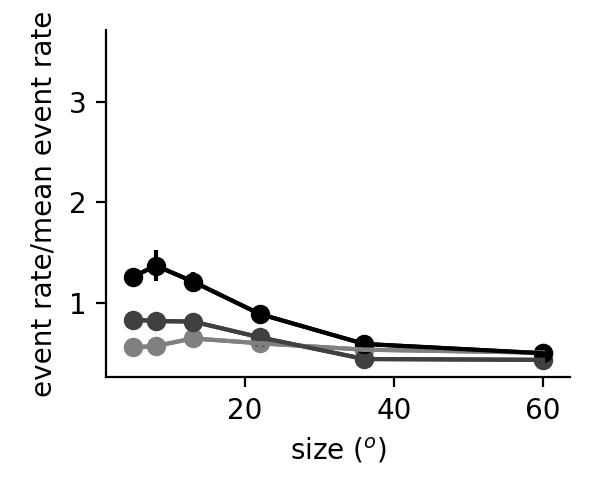

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.2221622073663598


<IPython.core.display.Javascript object>


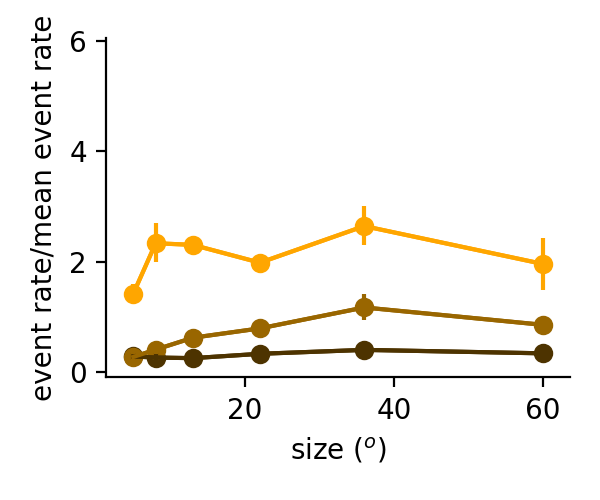

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.284465706653111


<IPython.core.display.Javascript object>


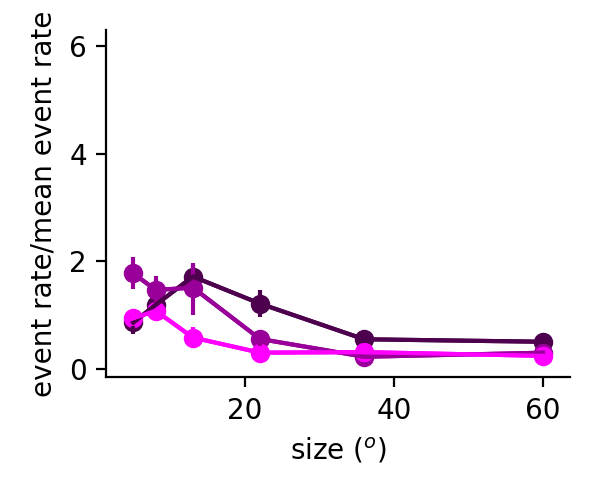

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.4918501655817225


<IPython.core.display.Javascript object>


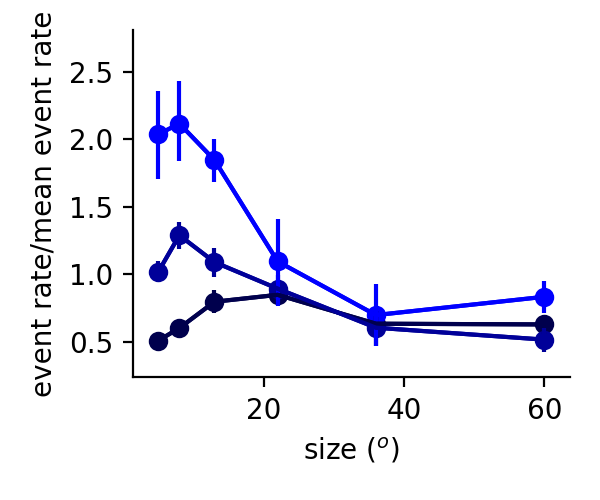

1.800594478612941


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


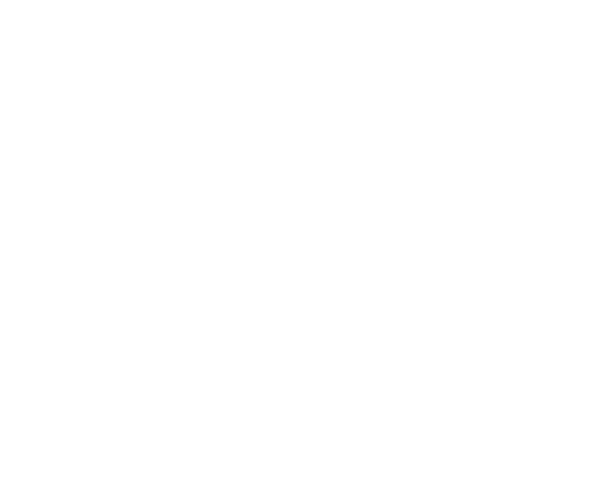

1.1112070480622747


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


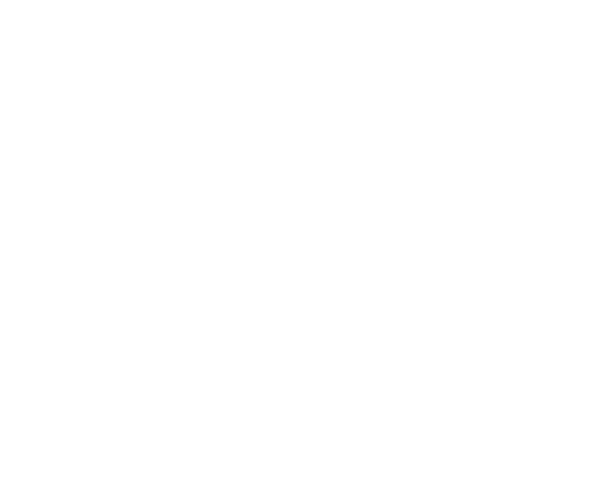

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.2903093087881359


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


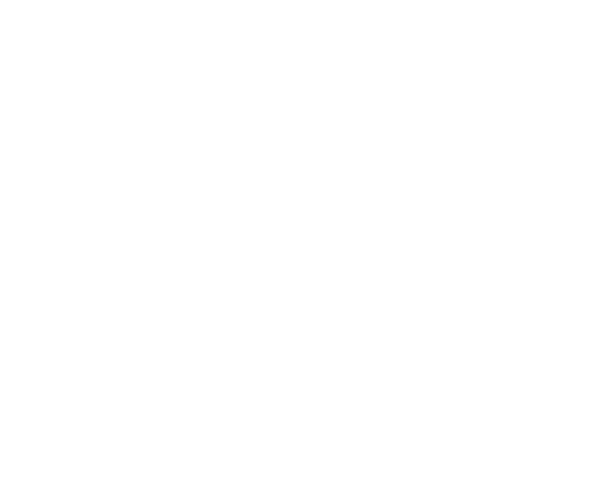

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.2603176520196055


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


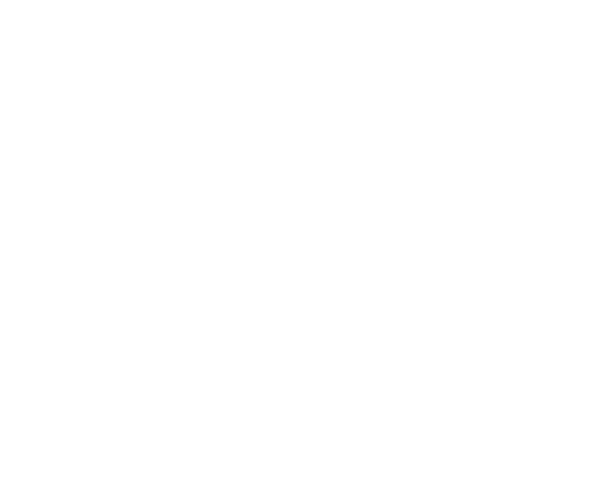

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.2565803737036603


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


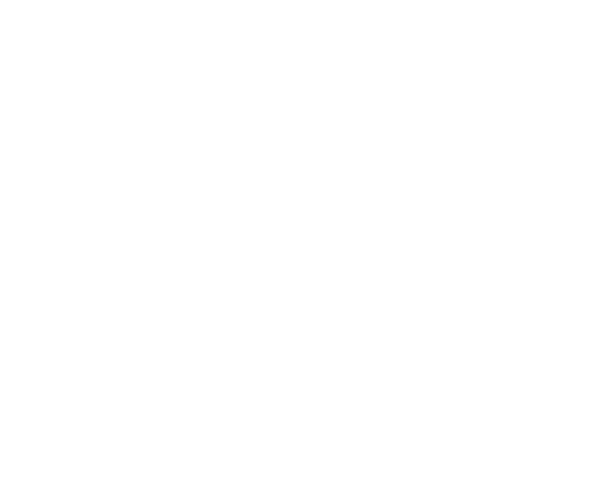

1.6616468079076983


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


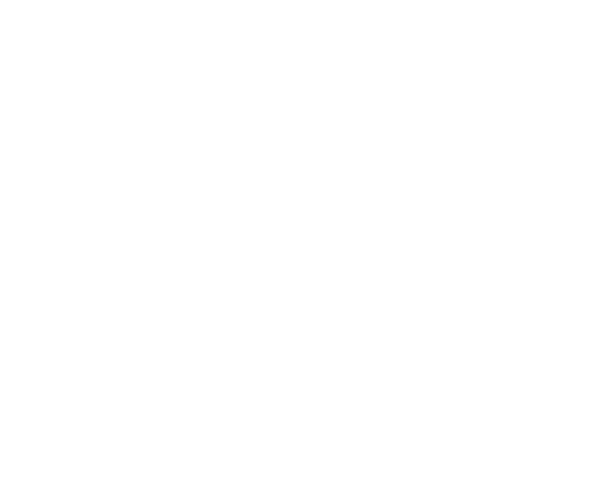

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8662539614543868


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


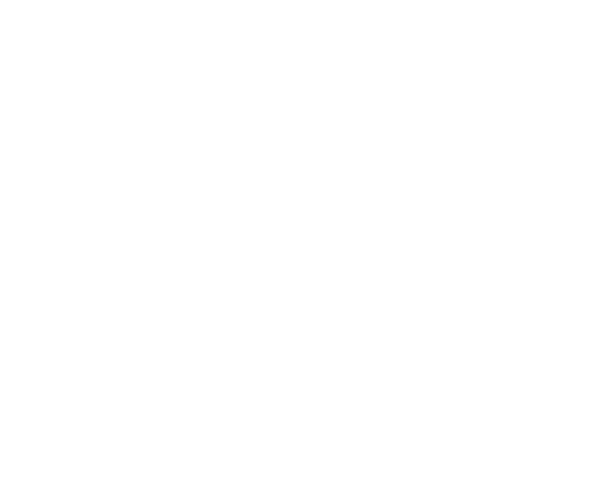

1.09791435862307


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


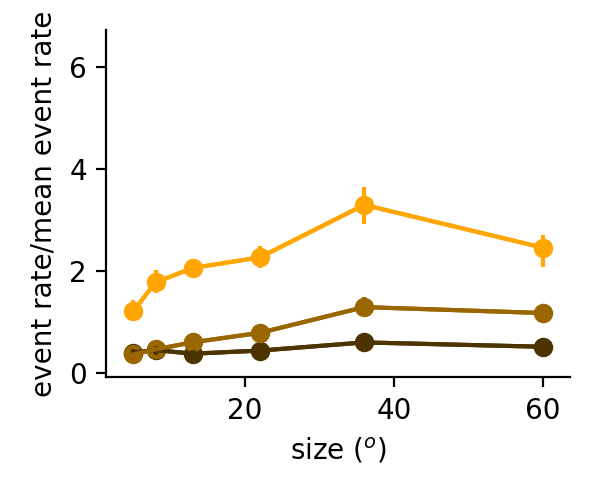

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.953502085106823


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


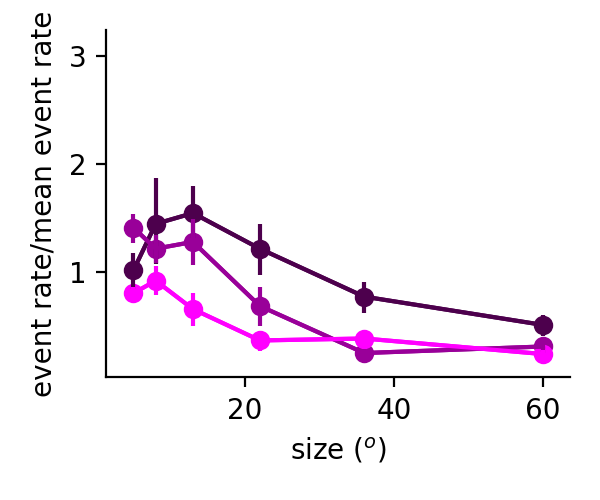

1.2907535139604676


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


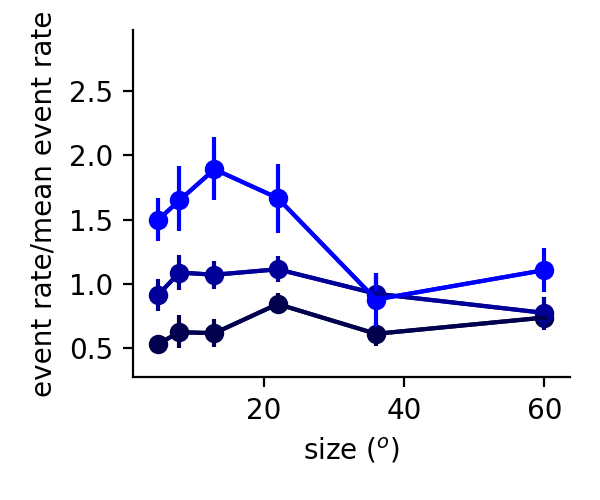

1.6411012151060023


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


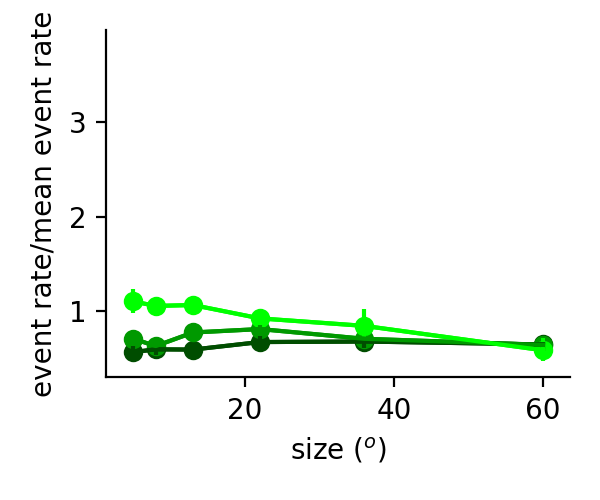

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0124824344844439


<IPython.core.display.Javascript object>


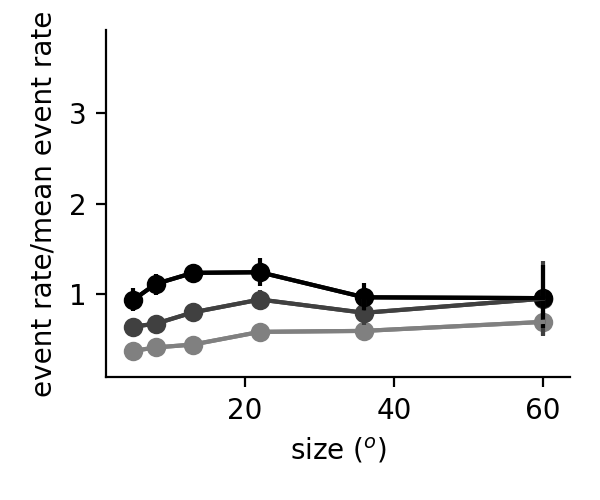

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.1697625046938567


<IPython.core.display.Javascript object>


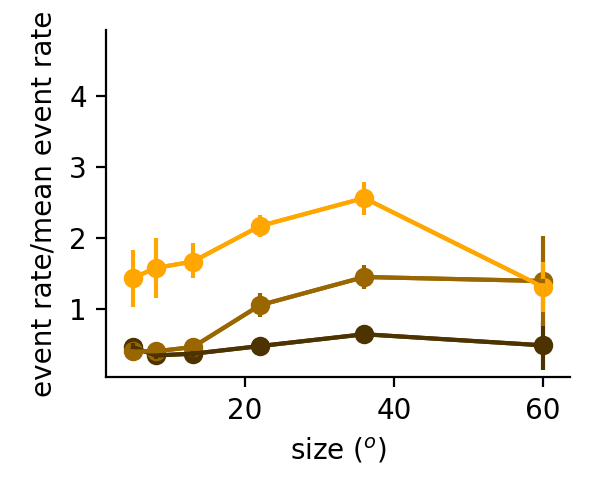

2.3372490166014135


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


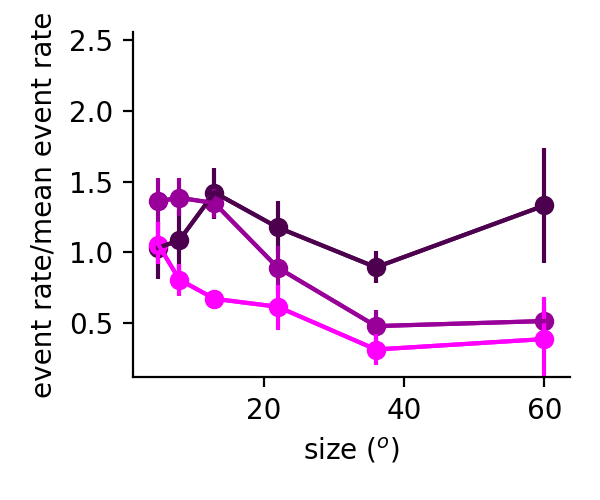

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.2522991565063568


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


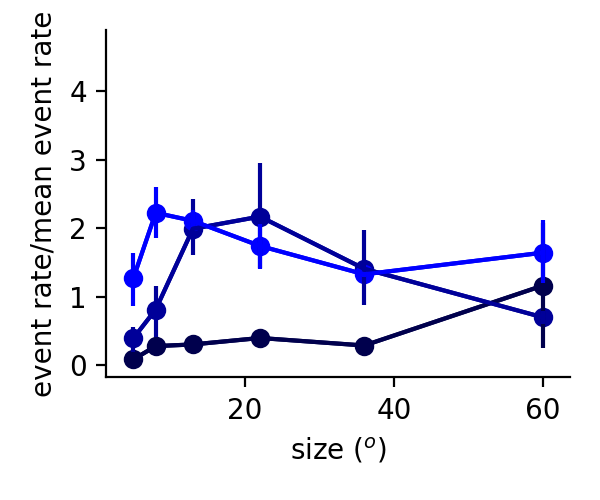

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.94642220841346


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [20]:
reload(ut)
angles = [[0,4],[2,6]]
angle_lbls = ['pref_angle','orth_angle']
for iangle in range(2):
    for ialign in range(2):
        for irun in range(2):
            lbls = ['pc_l4','pc_l23','sst','vip','pv']
            for itype in [0,1,2,3,4]:#range(len(rsexpt)):
                plt.figure(figsize=(3,2.5))
                data = rsexpt[irun][itype][ialign].copy()
                data = data/np.nanmean(np.nanmean(np.nanmean(data,-1),-1),-1)[:,np.newaxis,np.newaxis,np.newaxis]
                mean_data = np.nanmean(data,0)
                mx = np.nanmax(mean_data)
                mn = np.nanmin(mean_data)
                wiggle = 0.05*(mx-mn)
#                 data = np.nanmean(rsexpt[irun][itype][ialign][:,:,:,angles[iangle]],-1)
                data = np.nanmean(data[:,:,:,angles[iangle]],-1)

                
            #     for icontrast in range(6):
                #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
                ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],data[:,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
#                 plt.legend(['6%','25%','100%'])
                plt.xlabel('size ($^o$)')
                plt.ylabel('event rate/mean event rate')
                plt.ylim(mn-wiggle,mx+wiggle)
                ut.erase_top_right()
                plt.tight_layout()
#                 plt.savefig('figures/%s_size_by_3_contrasts_%s_%s_%s.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign],angle_lbls[iangle]))

<IPython.core.display.Javascript object>


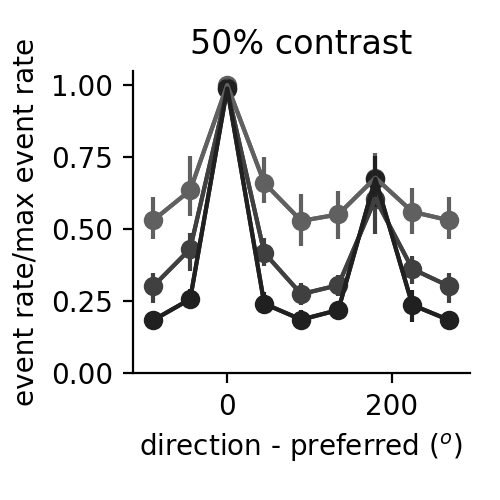

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0


In [125]:
irun,itype,ialign = 0,1,0
icontrast = 4
uangle = np.arange(0,360,45)
ydata = rsexpt[irun][itype][ialign][:,[0,2,4],icontrast]/rsexpt[irun][itype][ialign][:,[0,2,4],icontrast].max(-1)[:,:,np.newaxis]
plt.figure(figsize=(2.5,2.5))
ut.plot_bootstrapped_errorbars_hillel(np.concatenate((uangle[-2:]-360,uangle[:-1])),np.concatenate((ydata[:,:,-2:],ydata[:,:,:-1]),axis=2),colors=c_l23)
ut.erase_top_right()
plt.xlabel('direction - preferred ($^o$)')
plt.ylabel('event rate/max event rate')
plt.ylim((0,1.05))
plt.title('%d%% contrast'%ucontrast[icontrast])
plt.tight_layout()
plt.savefig('figures/pc_l23_ori_tuning_by_size.eps')

<IPython.core.display.Javascript object>


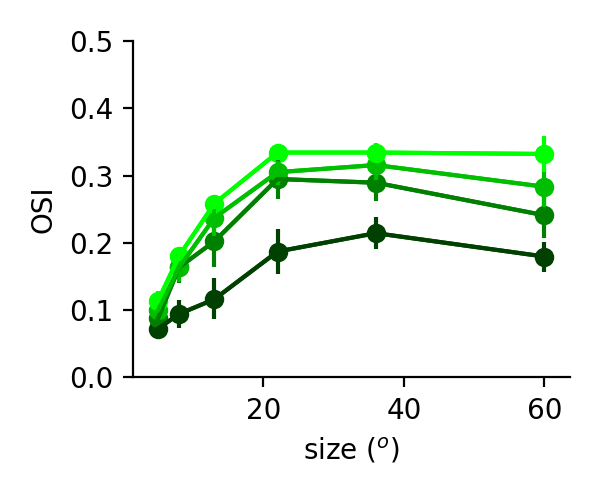

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.323836758534325


<IPython.core.display.Javascript object>


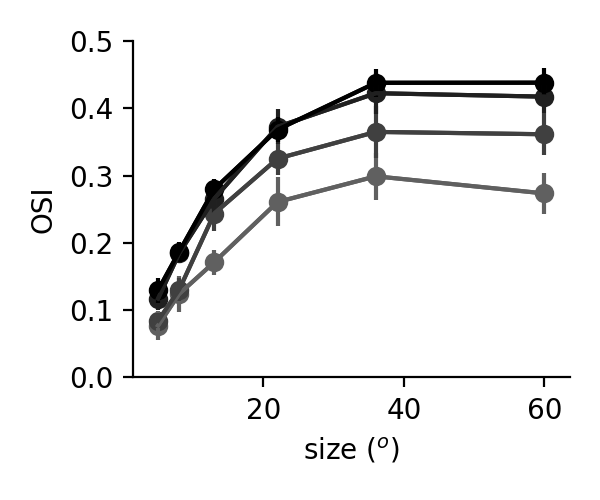

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.41709607348568134


<IPython.core.display.Javascript object>


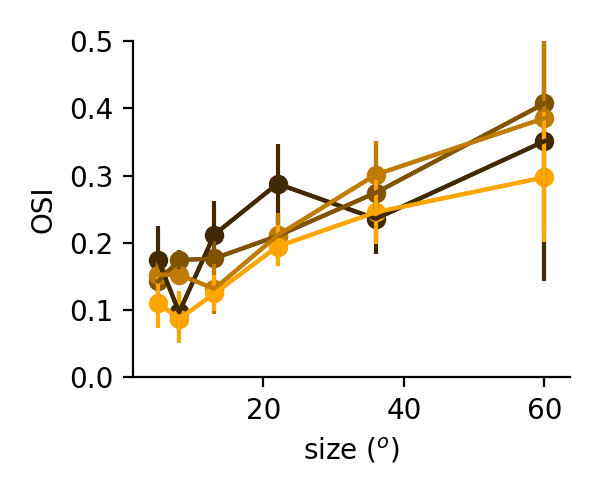

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.28202737742719375


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


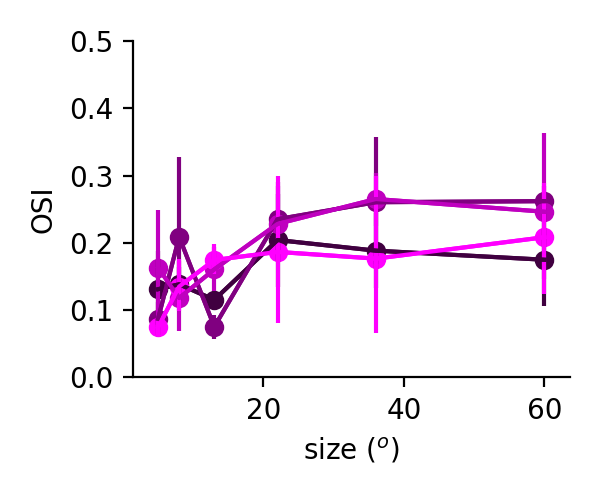

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.2393630416655591


<IPython.core.display.Javascript object>


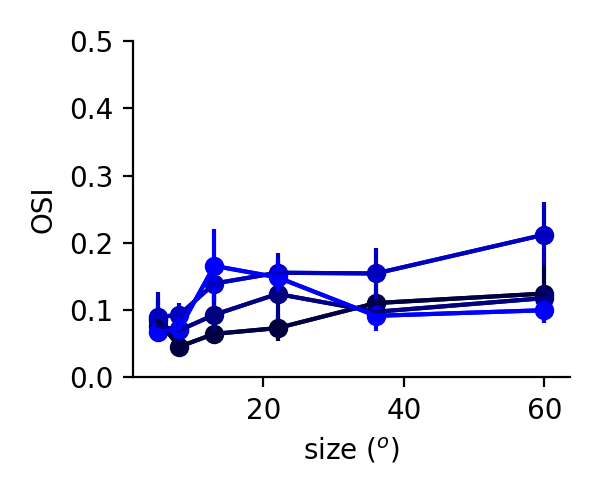

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.1641226219191694


<IPython.core.display.Javascript object>


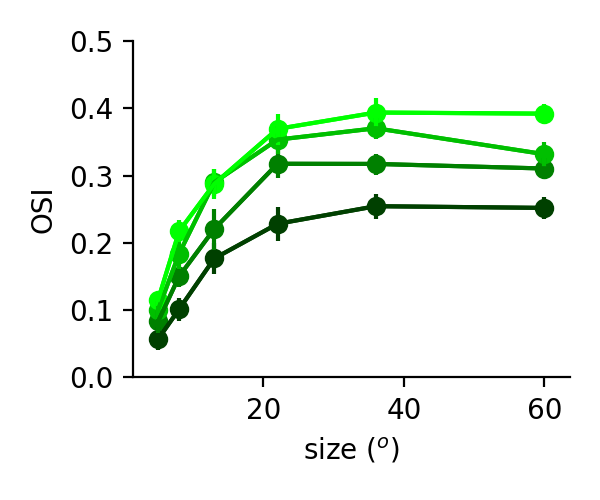

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.3774927159546558


<IPython.core.display.Javascript object>


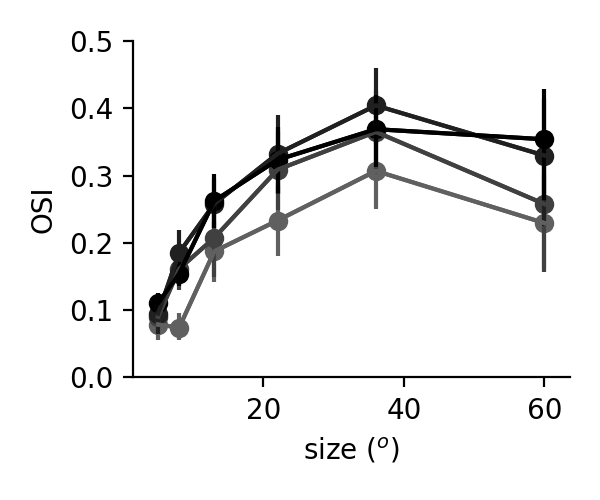

0.3481351644040535


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


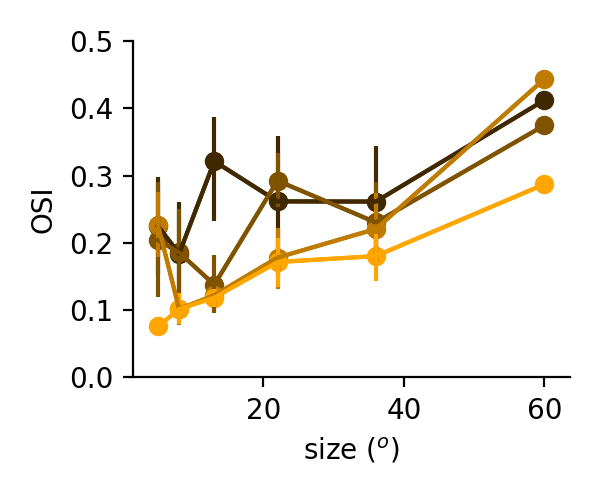

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.4435875882541817


<IPython.core.display.Javascript object>


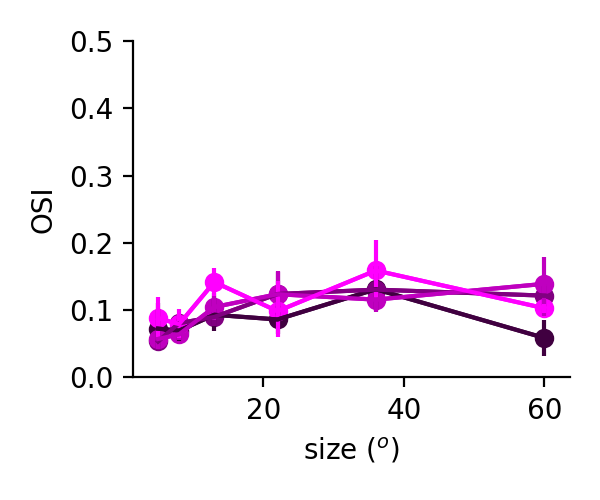

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.12106040938887137


<IPython.core.display.Javascript object>


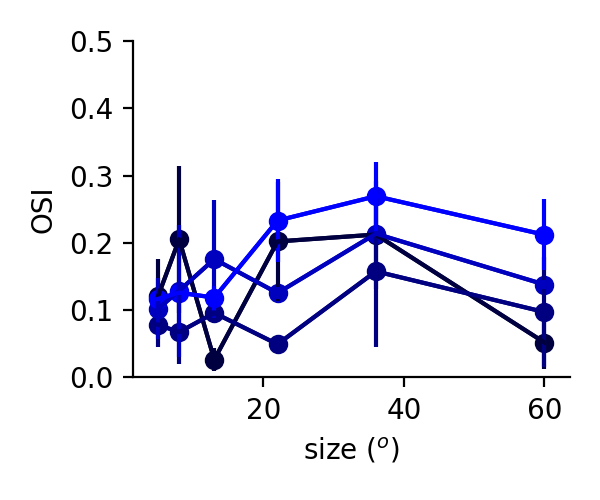

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.21781373058042278


<IPython.core.display.Javascript object>


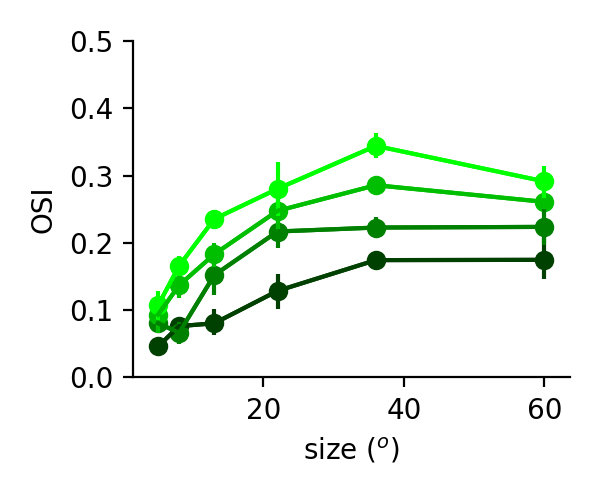

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.3243854947142472


<IPython.core.display.Javascript object>


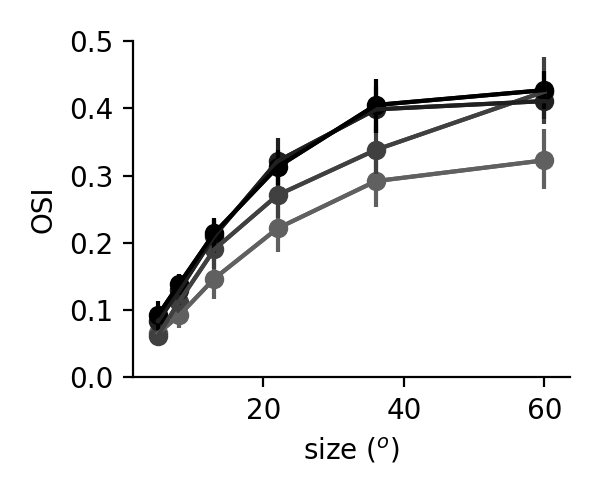

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.3984780835536724


<IPython.core.display.Javascript object>


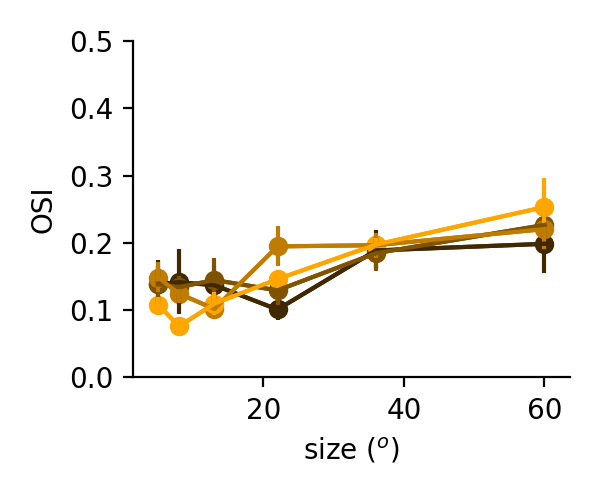

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.21015091805460964


<IPython.core.display.Javascript object>


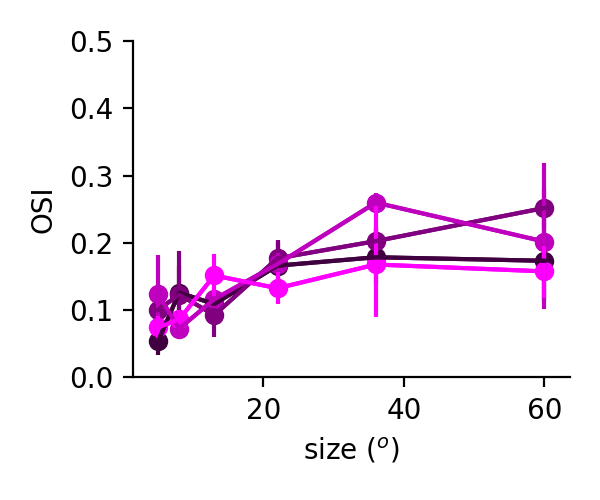

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.2463238565661597


<IPython.core.display.Javascript object>


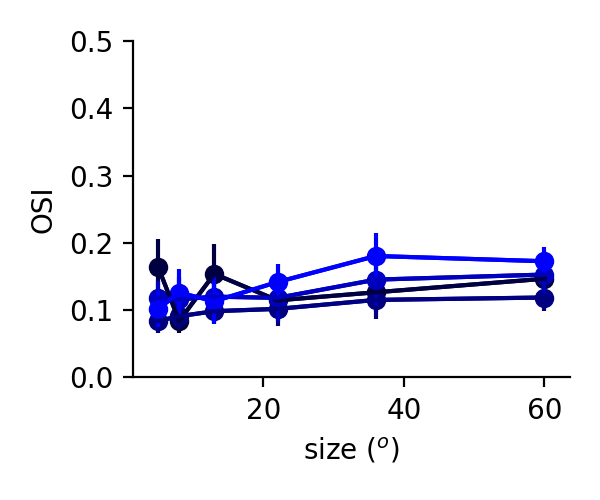

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.1508051074680214


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


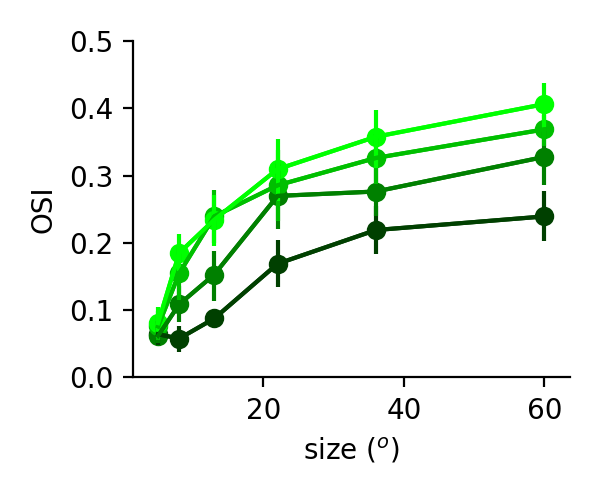

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.37488621520175164


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


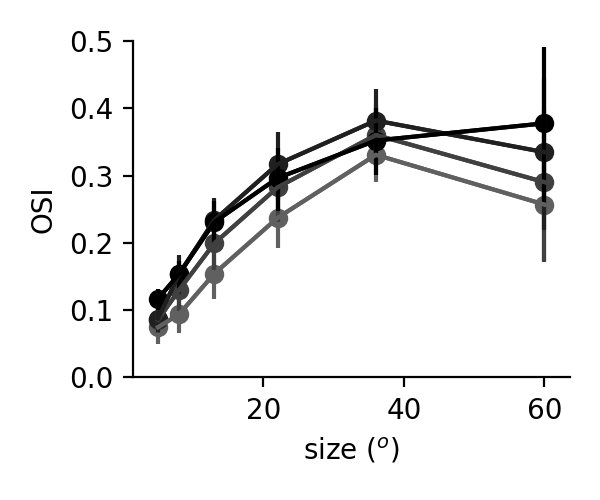

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.33449326651890904


<IPython.core.display.Javascript object>


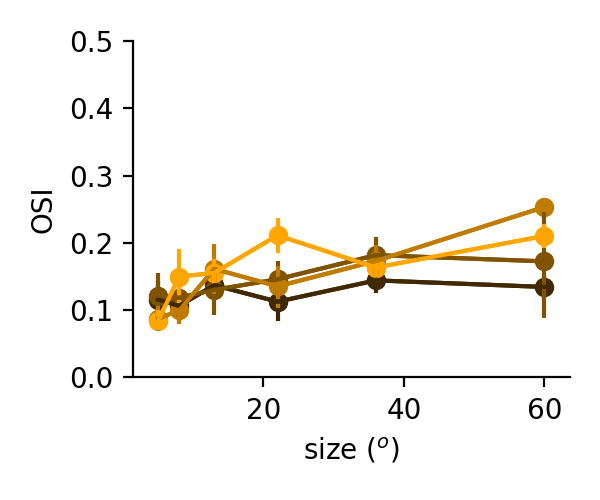

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.2457547561053433


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


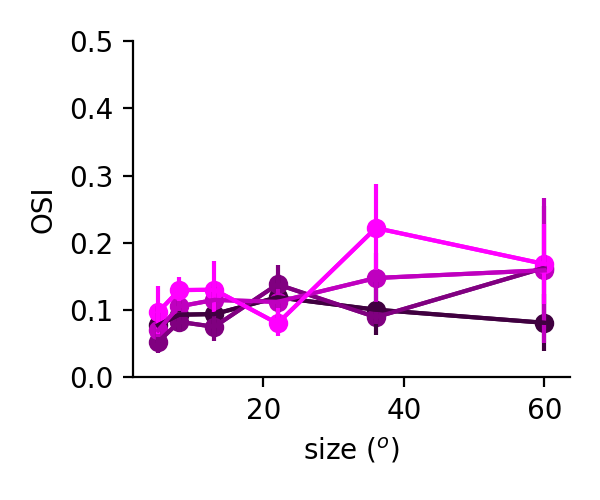

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.15641997371616775


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


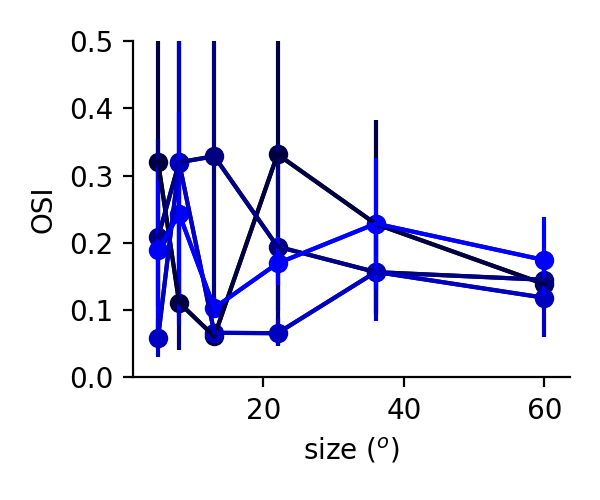

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.13252139807029834


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [126]:
#     c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
#     c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
#     c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
#     c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
#     c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
#     colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
    reload(ut)
    for ialign in range(2):
        for irun in range(2):
            lbls = ['pc_l4','pc_l23','sst','vip','pv']
            for itype in [0,1,2,3,4]:#range(len(rsexpt)):
                plt.figure(figsize=(3,2.5))
                data = rsexpt[irun][itype][ialign].copy()
                data = data/np.nanmean(np.nanmean(np.nanmean(data,-1),-1),-1)[:,np.newaxis,np.newaxis,np.newaxis]
                osi = ut.compute_osi(data[:,:,:,:,np.newaxis],np.arange(0,360,45))[:,:,:,0]
                mx = np.nanmax(osi)
                mn = np.nanmin(osi)
                wiggle = 0.05*(mx-mn)
            #     for icontrast in range(6):
                #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
                ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],osi[:,:,these_contrasts].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
#                 plt.legend(['6%','25%','100%'])
                plt.xlabel('size ($^o$)')
                plt.ylabel('OSI')
                plt.ylim((0,0.5))
                ut.erase_top_right()
                plt.tight_layout()
#                 plt.savefig('figures/%s_osi_size_by_3_contrasts_%s_%s.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))
                

<IPython.core.display.Javascript object>


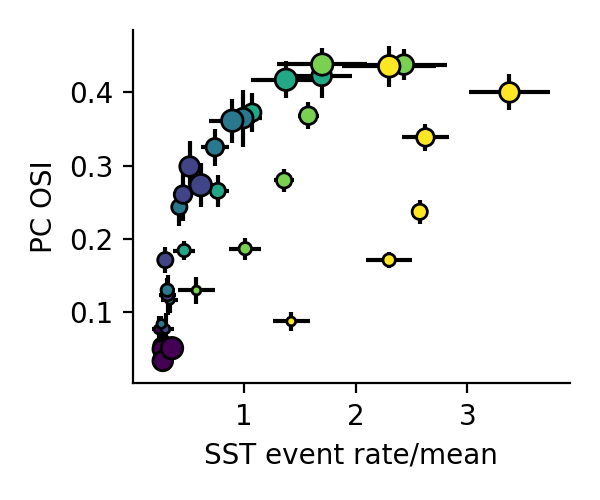

(0.6537992017453773, 1.5325270222142473e-05)


In [66]:
    c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
    c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
    c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
    c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
    c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
    colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
    reload(ut)
    for ialign in range(1): #2):
        for irun in range(1):
            lbls = ['pc_l4','pc_l23','sst','vip','pv']
            for itype in [1]:#range(len(rsexpt)):
                data = rsexpt[irun][itype][ialign].copy()
                data = data/np.nanmean(np.nanmean(np.nanmean(data,-1),-1),-1)[:,np.newaxis,np.newaxis,np.newaxis]
                osi = ut.compute_osi(data[:,:,:,:,np.newaxis],np.arange(0,360,45))[:,:,:,0]
            for itype in [2]:#range(len(rsexpt)):
                data = rsexpt[irun][itype][ialign].copy()
                data = data/np.nanmean(np.nanmean(np.nanmean(data,-1),-1),-1)[:,np.newaxis,np.newaxis,np.newaxis]
                data = np.nanmean(data,-1)
            plt.figure(figsize=(3,2.5))
            xdata = data
            ydata = osi
            sca.scatter_size_contrast_errorbar(xdata,ydata,equality_line=False,square=False)
            slope, intercept, r_value, p_value, std_err = sst.linregress(np.nanmean(xdata,0).flatten(),np.nanmean(ydata,0).flatten())
            print((r_value,p_value))
            x = np.linspace(np.nanmin(np.nanmean(xdata,0)),np.nanmax(np.nanmean(xdata,0)),10)
            y1 = (slope-std_err)*x + intercept
            y2 = (slope+std_err)*x + intercept
#             plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
            plt.xlabel('SST event rate/mean')
            plt.ylabel('PC OSI')
            ut.erase_top_right()
            plt.tight_layout()
#             plt.savefig('figures/pc_osi_vs_rsst.jpg',dpi=300)
                

<IPython.core.display.Javascript object>


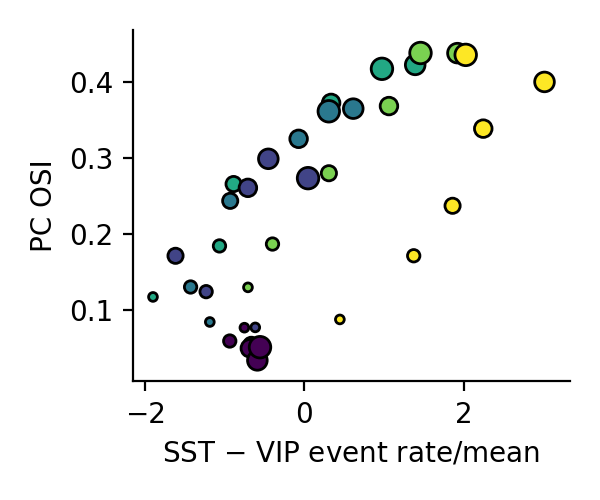

(0.7096358782113982, 1.2593765385325084e-06)


In [70]:
    c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
    c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
    c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
    c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
    c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
    colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
    reload(ut)
    for ialign in range(1): #2):
        for irun in range(1):
            lbls = ['pc_l4','pc_l23','sst','vip','pv']
            for itype in [1]:#range(len(rsexpt)):
                data = rsexpt[irun][itype][ialign].copy()
                data = data/np.nanmean(np.nanmean(np.nanmean(data,-1),-1),-1)[:,np.newaxis,np.newaxis,np.newaxis]
                osi = ut.compute_osi(data[:,:,:,:,np.newaxis],np.arange(0,360,45))[:,:,:,0]
            for itype in [2]:#range(len(rsexpt)):
                data = rsexpt[irun][itype][ialign].copy()
                data = data/np.nanmean(np.nanmean(np.nanmean(data,-1),-1),-1)[:,np.newaxis,np.newaxis,np.newaxis]
                data = np.nanmean(data,-1)
            plt.figure(figsize=(3,2.5))
            xdata = data.copy()
            for itype in [3]:#range(len(rsexpt)):
                data = rsexpt[irun][itype][ialign].copy()
                data = data/np.nanmean(np.nanmean(np.nanmean(data,-1),-1),-1)[:,np.newaxis,np.newaxis,np.newaxis]
                data = np.nanmean(data,-1)
            xdata = np.nanmean(xdata,0) - np.nanmean(data,0)
            ydata = np.nanmean(osi,0)
            sca.scatter_size_contrast(xdata,ydata,equality_line=False,square=False)
            slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),ydata.flatten())
            print((r_value,p_value))
            x = np.linspace(np.nanmin(np.nanmean(xdata,0)),np.nanmax(np.nanmean(xdata,0)),10)
            y1 = (slope-std_err)*x + intercept
            y2 = (slope+std_err)*x + intercept
#             plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
            plt.xlabel('SST $-$ VIP event rate/mean')
            plt.ylabel('PC OSI')
            ut.erase_top_right()
            plt.tight_layout()
            plt.savefig('figures/pc_osi_vs_sst_minus_vip.jpg',dpi=300)
                

In [26]:
def bar_with_dots(data,colors,tick_labels,pct=(16,84),epsilon=0.05):
    for itype in range(len(data)):
        mn = np.nanmean(data[itype],0)
        plt.bar((itype,),mn,color=colors[itype],alpha=0.5,edgecolor='k')
        lb,ub = ut.bootstrap(data[itype][~np.isnan(data[itype])],pct=pct,axis=0,fn=np.mean)
        plt.errorbar((itype,),mn[np.newaxis],yerr=np.array((mn-lb,ub-mn))[:,np.newaxis],c='k')
        plt.scatter(itype*np.ones_like(data[itype])+epsilon*np.random.randn(data[itype].shape[0]),data[itype],\
                    facecolor=colors[itype],linewidth=1,edgecolor='k')
    plt.xticks(np.arange(len(data)),tick_labels)
        


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


<IPython.core.display.Javascript object>


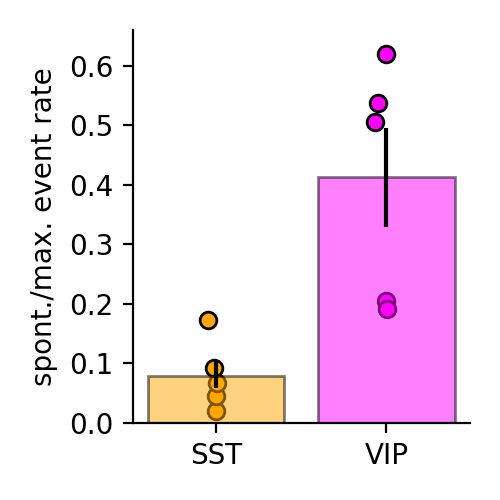

MannwhitneyuResult(statistic=0.0, pvalue=0.006092890177672406)

In [28]:
irun,ialign = 0,0
ratio = [None for itype in range(5)]
for itype in range(1,5):
    spont_resp = np.nanmean(np.nanmean(rsexpt[irun][itype][ialign],3)[:,:,0],1)
    max_resp = np.nanmax(np.nanmax(np.nanmean(rsexpt[irun][itype][ialign],3),axis=1),axis=1)
    ratio[itype] = spont_resp/max_resp

colors = [(1,0.65,0),(1,0,1)]
plt.figure(figsize=(2.5,2.5))
bar_with_dots(ratio[2:4],colors,['SST','VIP'],epsilon=0.02)
plt.ylabel('spont./max. event rate')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/spont_event_rate_vip_sst.jpg',dpi=300)
sst.mannwhitneyu(ratio[2][~np.isnan(ratio[2])],ratio[3][~np.isnan(ratio[3])])

<IPython.core.display.Javascript object>


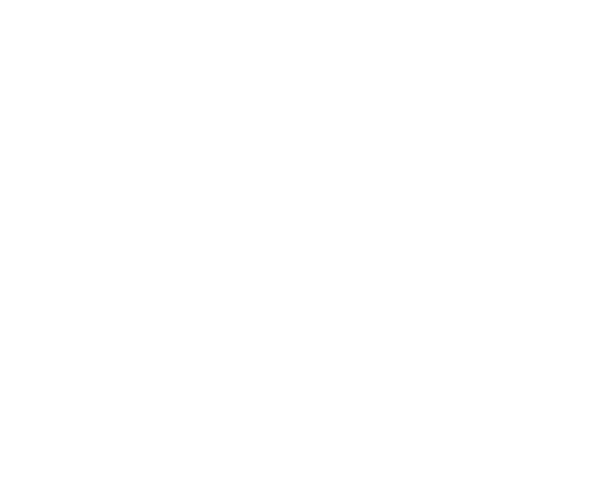

NameError: name 'compute_slope_avg' is not defined

In [23]:
c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
usize = np.array((5,8,13,22,36,60))
ucontrast = np.array((0,6,12,25,50,100))
reload(ut)
for ialign in range(2):
    for irun in range(2):
        lbls = ['pc_l4','pc_l23','sst','vip','pv']
        for itype in [0,1,2,3,4]:#range(len(rsexpt)):
            plt.figure(figsize=(3,2.5))
            starting_data = np.nanmean(rsexpt[irun][itype][ialign],-1)
            starting_data = starting_data/np.nanmean(np.nanmean(starting_data,-1),-1)[:,np.newaxis,np.newaxis]
            data = compute_slope_avg(usize,starting_data,axis=1)
        #     for icontrast in range(6):
            #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
            ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],data[:,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
            plt.gca().axhline(0,linestyle='dotted',c='k')
            plt.legend(['6%','25%','100%'])
            plt.xlabel('size ($^o$)')
            plt.ylabel('size tuning slope (mean/$^o$)')
            ut.erase_top_right()
            plt.tight_layout()
#             plt.savefig('figures/%s_size_slope_by_3_contrasts_%s_%s.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


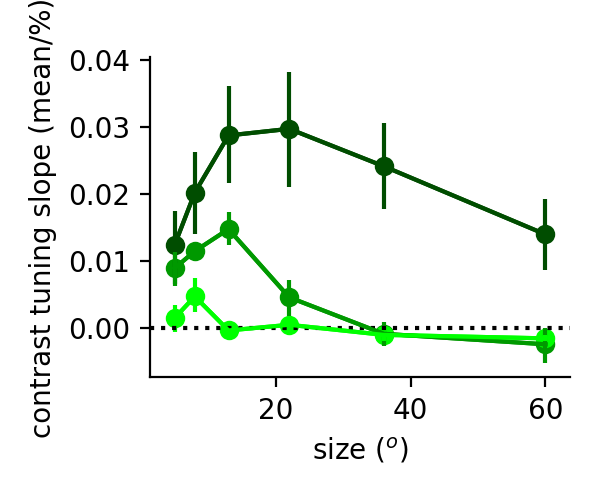

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

0.02137404229267952


<IPython.core.display.Javascript object>


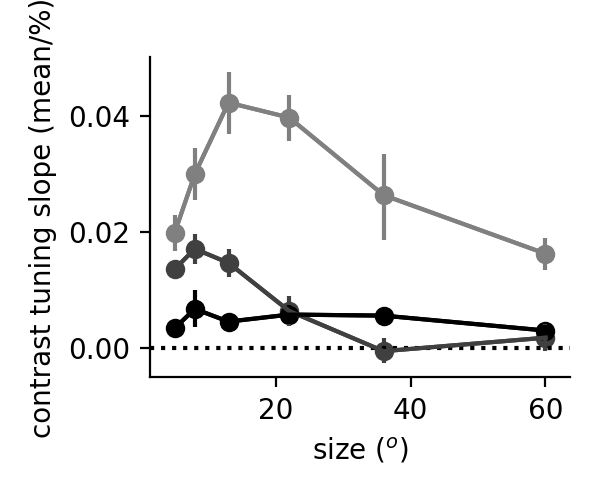

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.036967983651728424


<IPython.core.display.Javascript object>


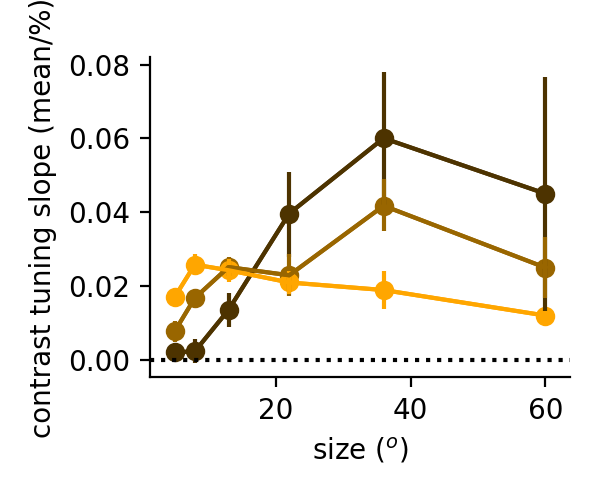

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.042081853708427916


<IPython.core.display.Javascript object>


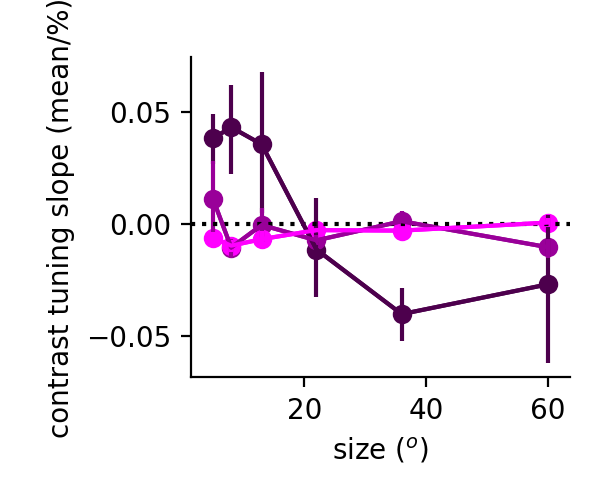

0.0274467637053609


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


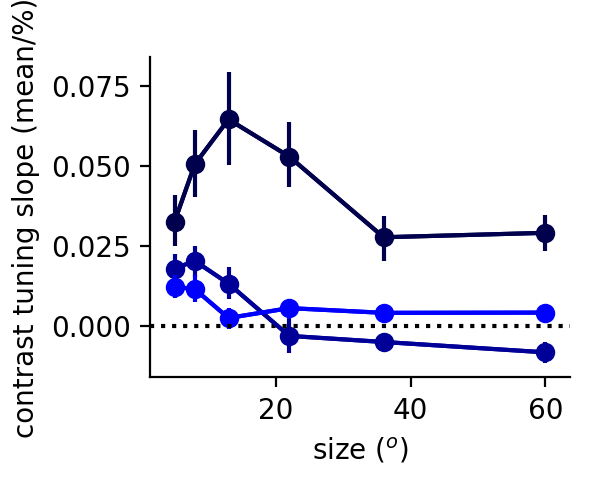

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.049626974406195


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


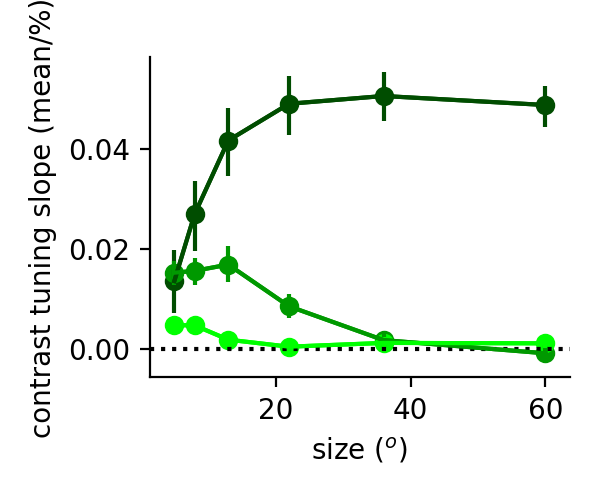

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.045774839831763545


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


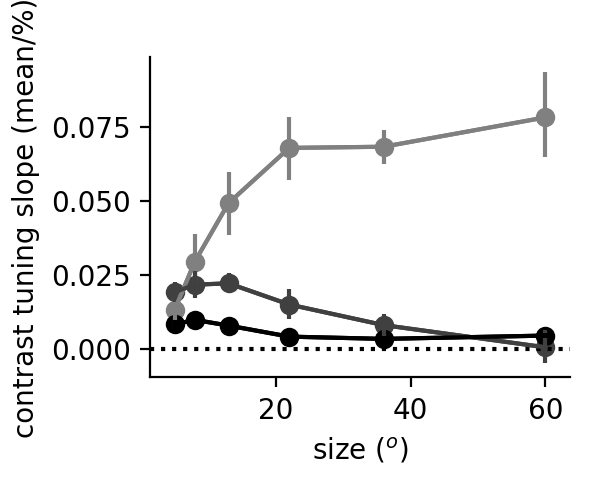

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.06295861822260407


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


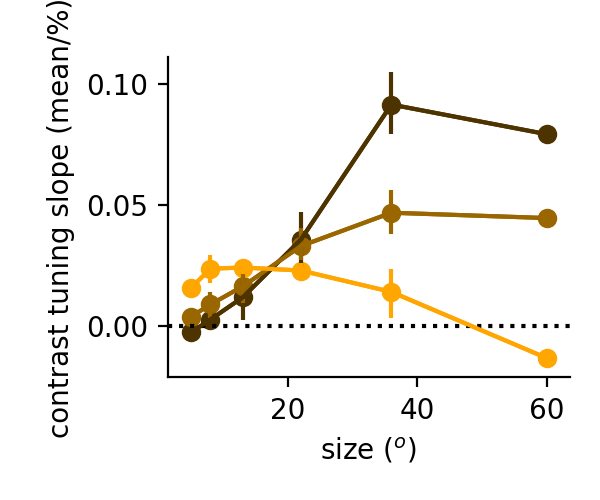

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.07937678891519784


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


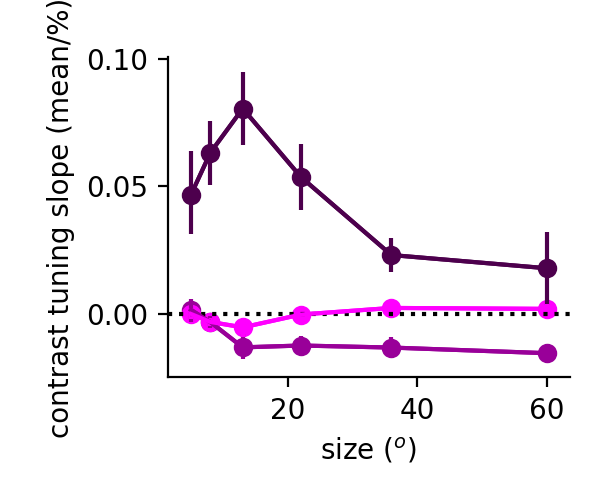

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.06607036052316374


<IPython.core.display.Javascript object>


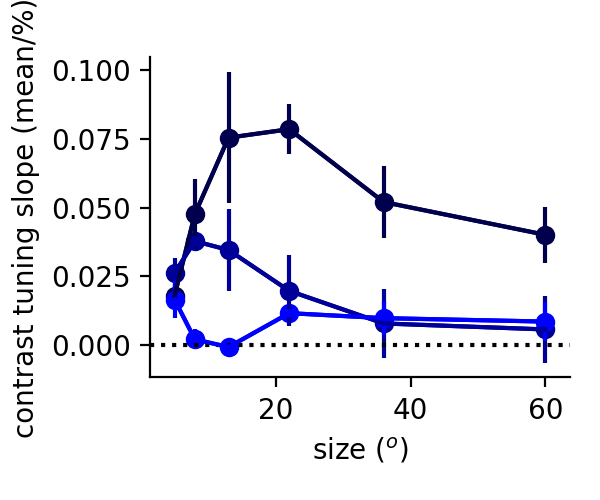

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.06933604990717049


<IPython.core.display.Javascript object>


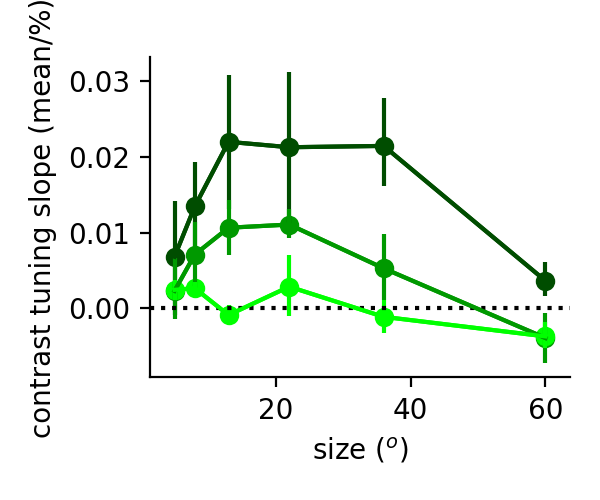

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.015077459673571568


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


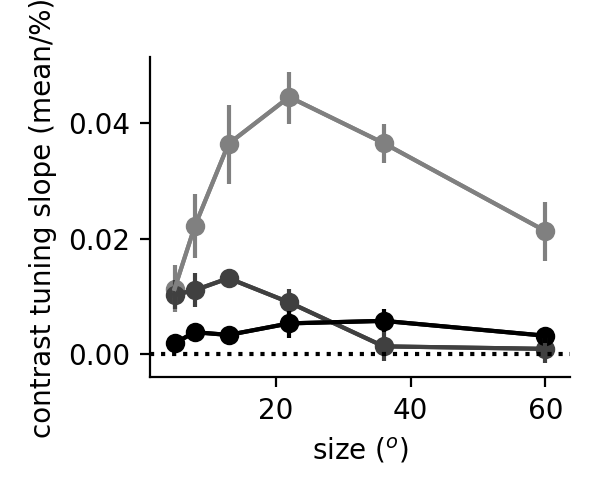

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.04019962623943072


<IPython.core.display.Javascript object>


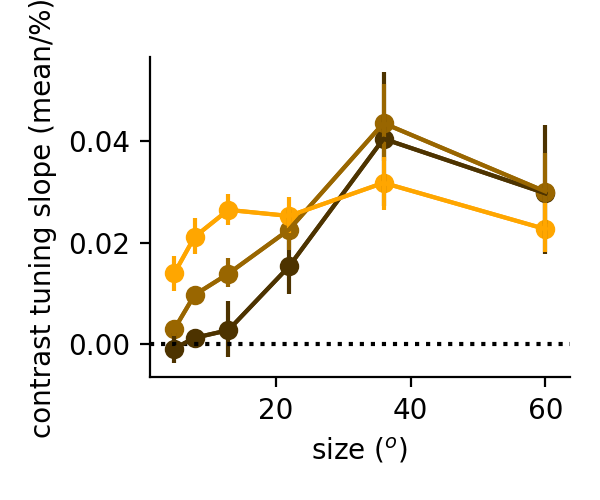

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.0359074227349174


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


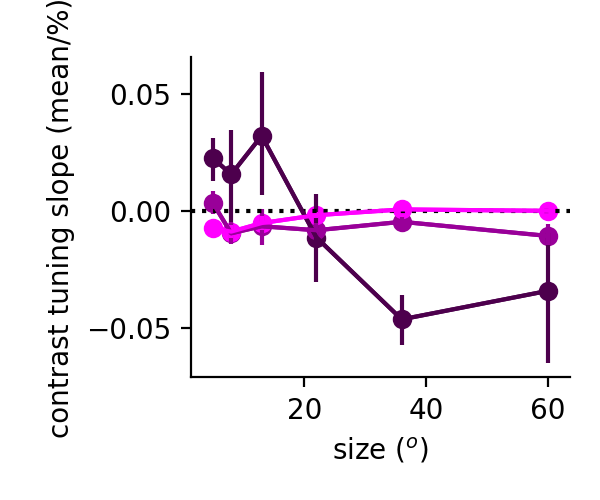

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.01395698390884199


<IPython.core.display.Javascript object>


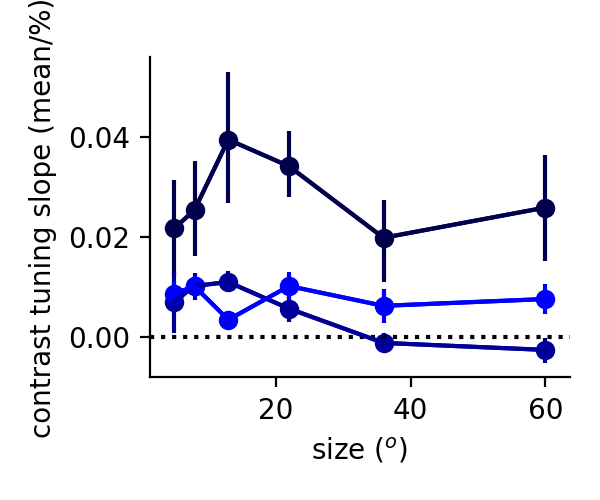

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.027074738468205767


<IPython.core.display.Javascript object>


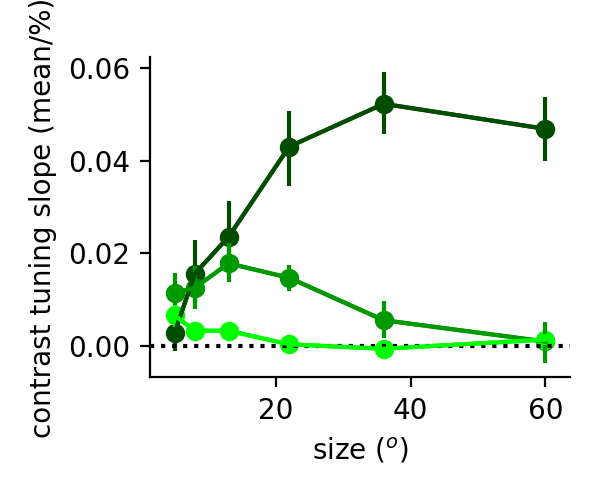

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.045353025355007


<IPython.core.display.Javascript object>


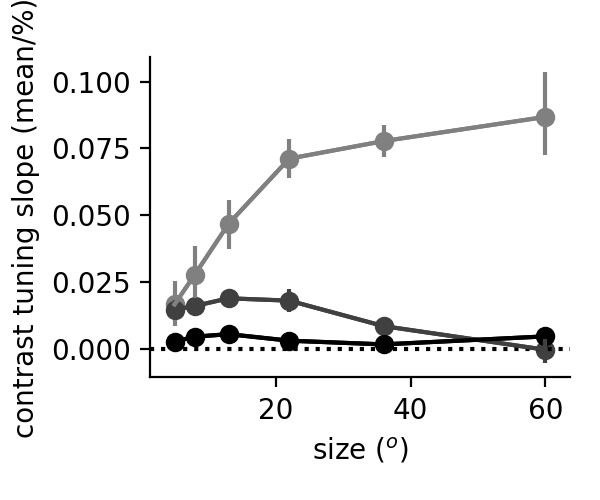

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.07158824888317436


<IPython.core.display.Javascript object>


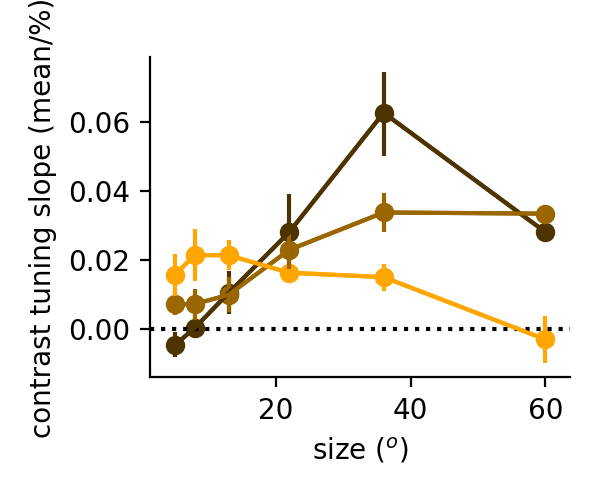

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.05071602176531768


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


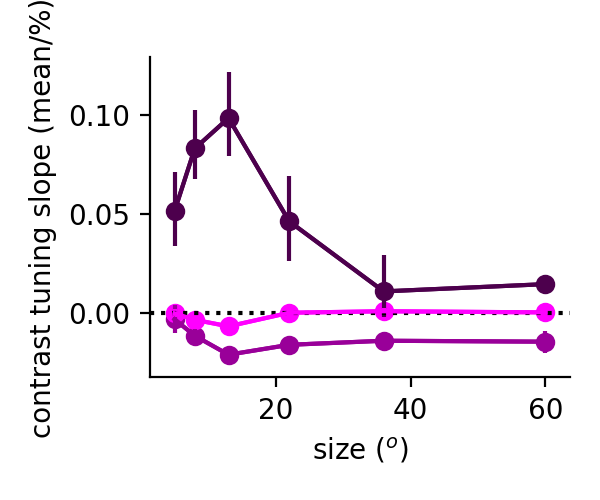

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.07506353274873172


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


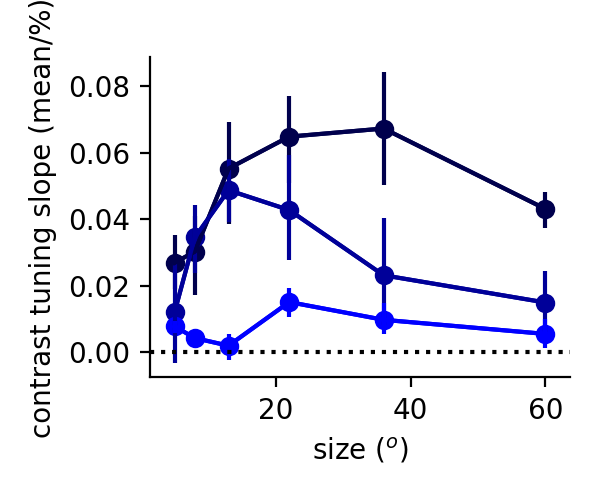

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.05271862254208851


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [38]:
ucontrast = np.array((0,6,12,25,50,100))
reload(ut)
for ialign in range(2):
    for irun in range(2):
        lbls = ['pc_l4','pc_l23','sst','vip','pv']
        for itype in [0,1,2,3,4]:#range(len(rsexpt)):
            plt.figure(figsize=(3,2.5))
            starting_data = np.nanmean(rsexpt[irun][itype][ialign],-1)
            starting_data = starting_data/np.nanmean(np.nanmean(starting_data,-1),-1)[:,np.newaxis,np.newaxis]
            data = compute_slope_avg(ucontrast,starting_data,axis=2)
        #     for icontrast in range(6):
            #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
            ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],data[:,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
            plt.gca().axhline(0,linestyle='dotted',c='k')
#             plt.legend(['6%','25%','100%'])
            plt.xlabel('size ($^o$)')
            plt.ylabel('contrast tuning slope (mean/%)')
            ut.erase_top_right()
            plt.tight_layout()
#             plt.savefig('figures/%s_contrast_slope_by_3_contrasts_%s_%s.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


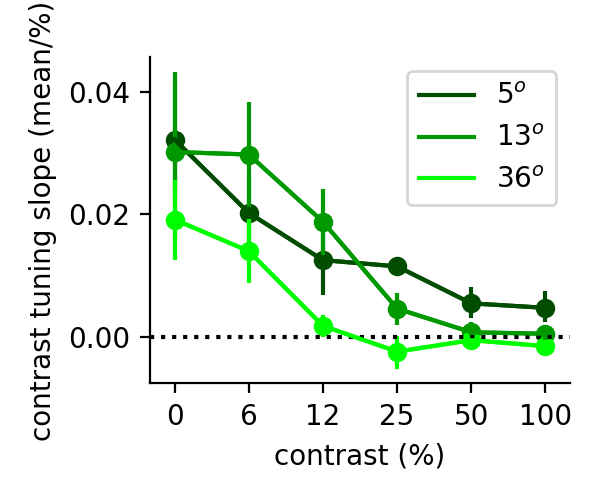

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

0.022729947658167052


<IPython.core.display.Javascript object>


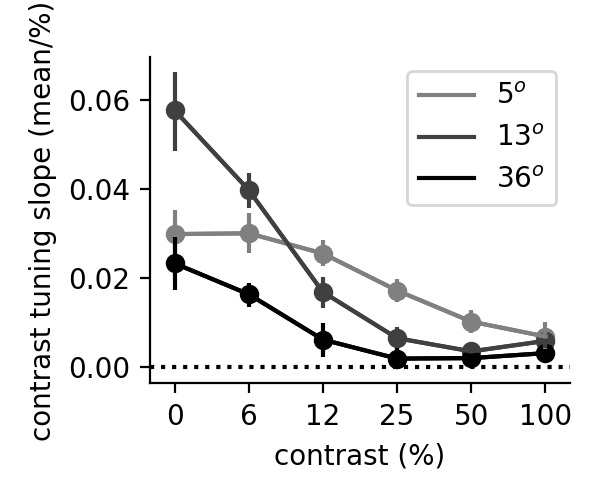

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.04901493884086597


<IPython.core.display.Javascript object>


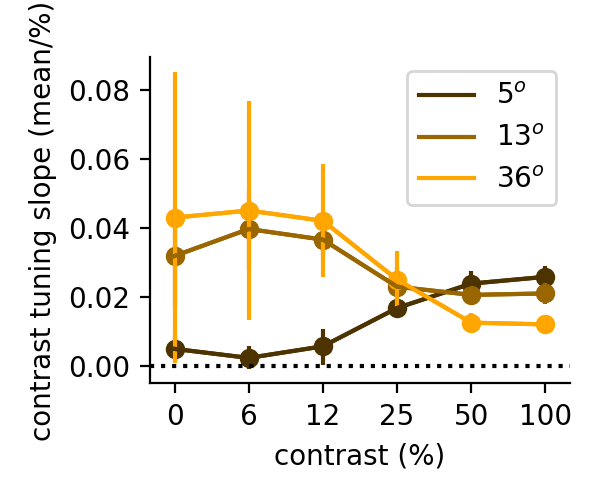

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.030972410360383684


<IPython.core.display.Javascript object>


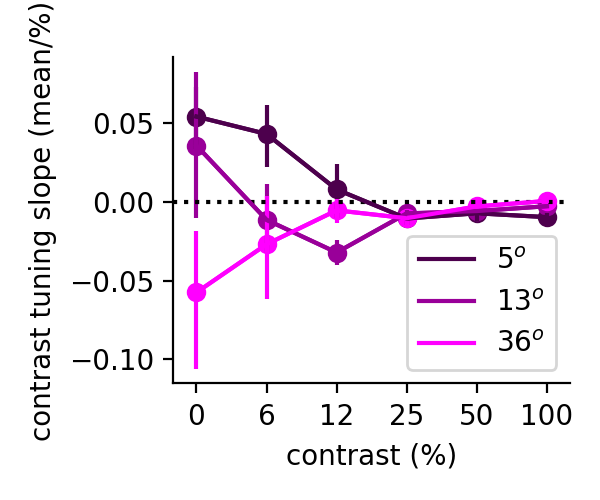

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.03516715756898095


<IPython.core.display.Javascript object>


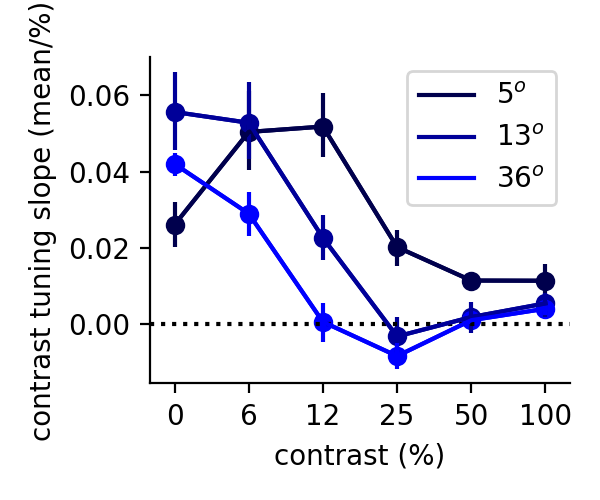

0.04521746631293257


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


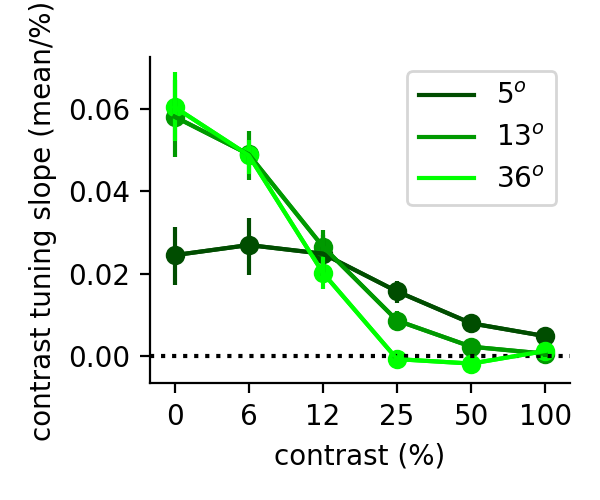

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.052046940221878155


<IPython.core.display.Javascript object>


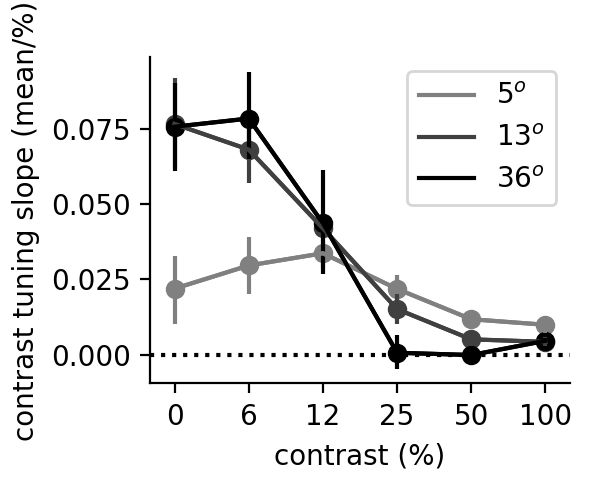

0.06295861822260407


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


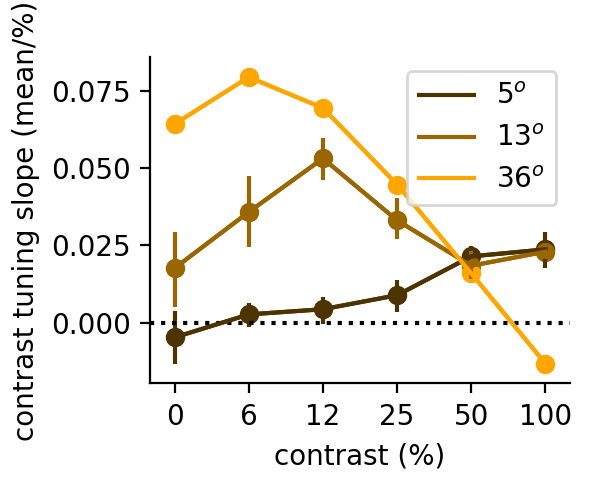

0.07937678891519784


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


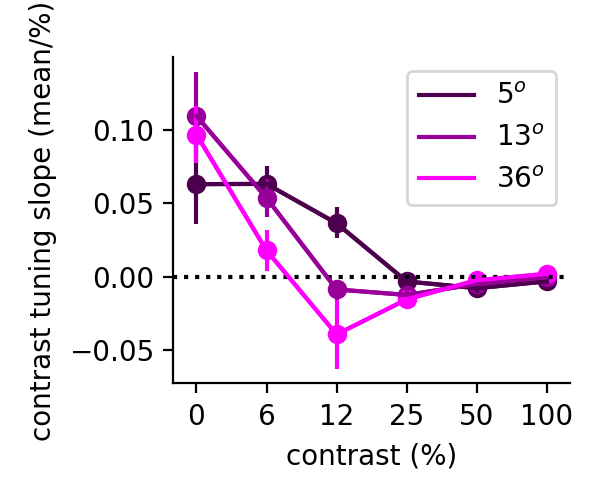

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.0795616636773202


<IPython.core.display.Javascript object>


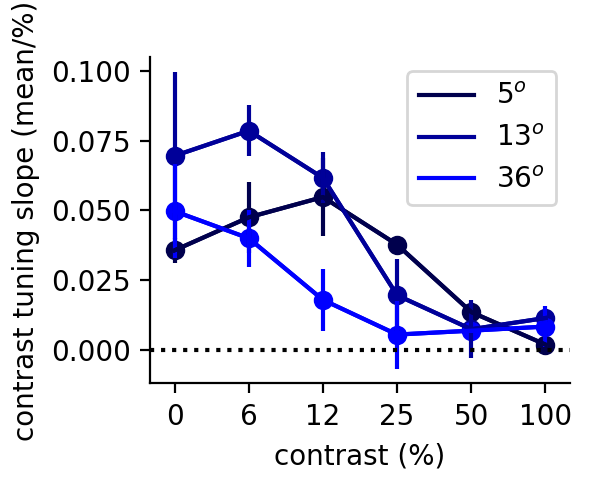

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.06933604990717049


<IPython.core.display.Javascript object>


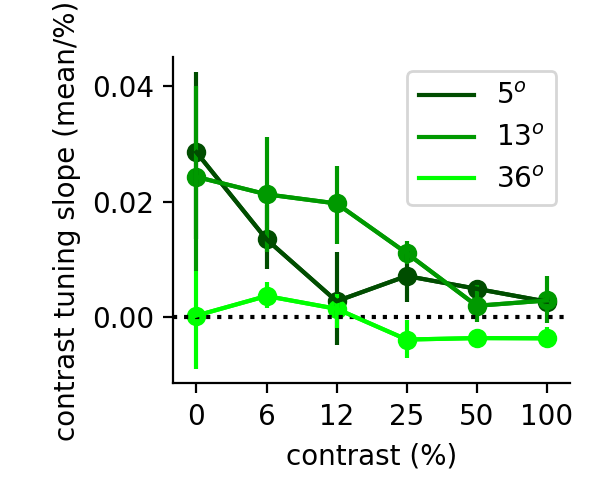

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.014647265098159177


<IPython.core.display.Javascript object>


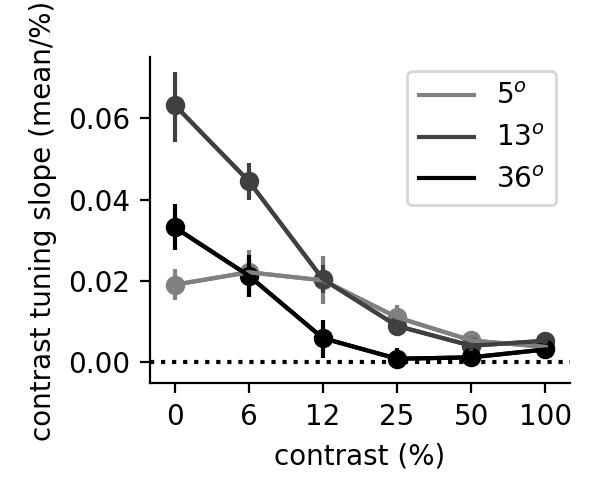

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.05517680786291638


<IPython.core.display.Javascript object>


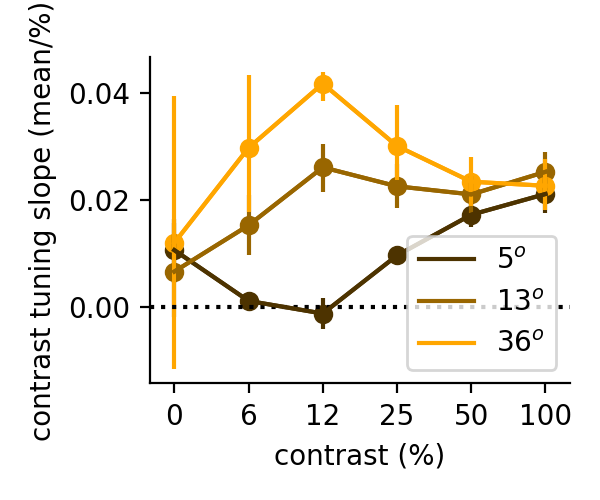

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.039608286240892916


<IPython.core.display.Javascript object>


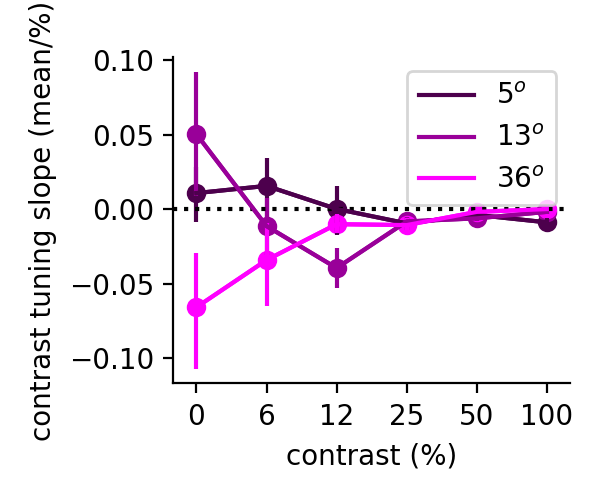

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.008658855330150365


<IPython.core.display.Javascript object>


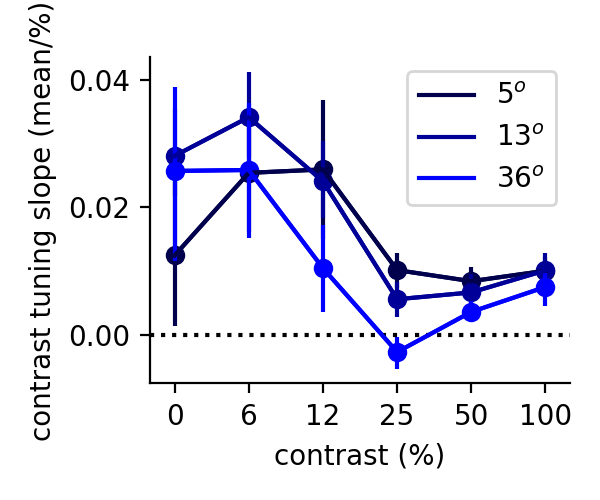

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.027074738468205767


<IPython.core.display.Javascript object>


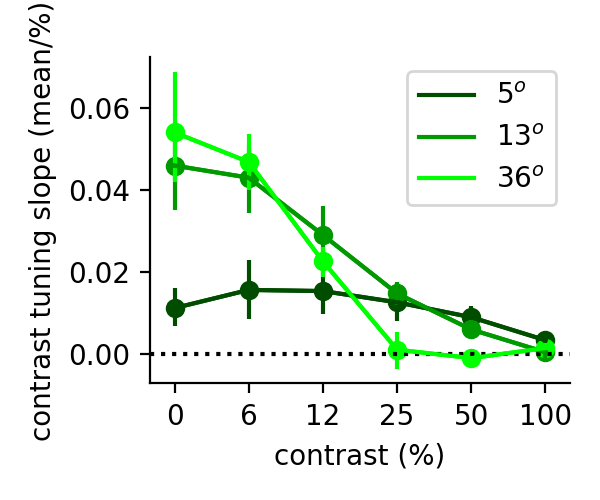

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.03988532066979944


<IPython.core.display.Javascript object>


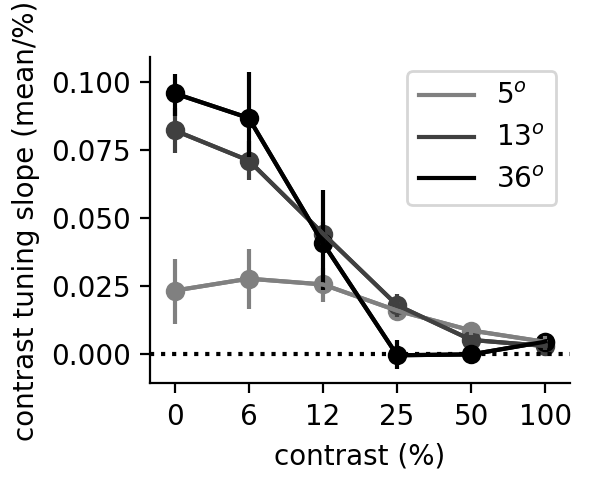

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.08887193049595904


<IPython.core.display.Javascript object>


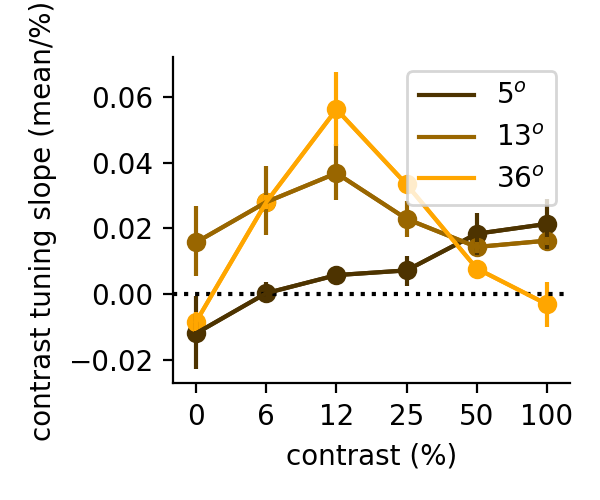

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.044905113908964664


<IPython.core.display.Javascript object>


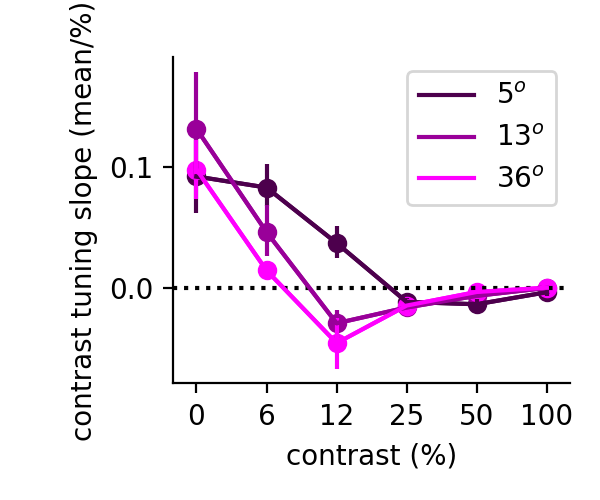

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.08477162245881012


<IPython.core.display.Javascript object>


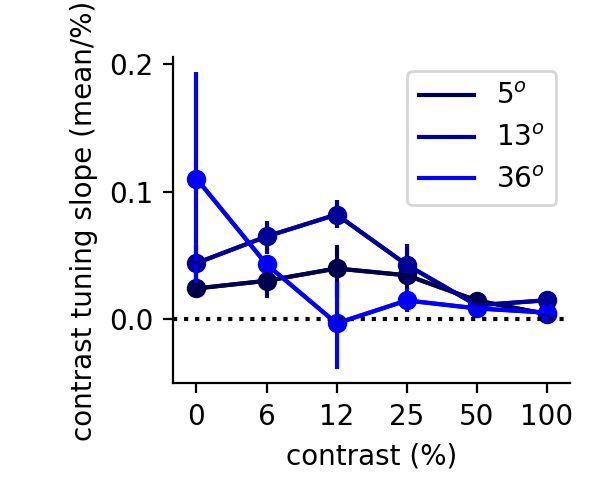

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.07070469311961676


In [40]:
ucontrast = np.array((0,6,12,25,50,100))
reload(ut)
for ialign in range(2):
    for irun in range(2):
        lbls = ['pc_l4','pc_l23','sst','vip','pv']
        for itype in [0,1,2,3,4]:#range(len(rsexpt)):
            plt.figure(figsize=(3,2.5))
            starting_data = np.nanmean(rsexpt[irun][itype][ialign],-1)
            starting_data = starting_data/np.nanmean(np.nanmean(starting_data,-1),-1)[:,np.newaxis,np.newaxis]
            data = compute_slope_avg(ucontrast,starting_data,axis=2)
        #     for icontrast in range(6):
            #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
#             ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],data[:,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
            ut.plot_bootstrapped_errorbars_hillel(np.arange(6),data[:,[1,3,5],:],pct=(16,84),colors=colors[itype])
            plt.xticks(np.arange(6),ucontrast)
            plt.gca().axhline(0,linestyle='dotted',c='k')
            plt.legend(['5$^o$','13$^o$','36$^o$'])
            plt.xlabel('contrast (%)')
            plt.ylabel('contrast tuning slope (mean/%)')
            ut.erase_top_right()
            plt.tight_layout()
#             plt.savefig('figures/%s_contrast_slope_by_3_sizes_%s_%s.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))

In [610]:
ucontrast

[5, 10, 20, 40, 80]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


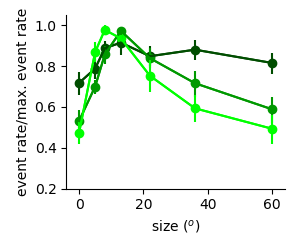

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
0.953848410786367


<IPython.core.display.Javascript object>


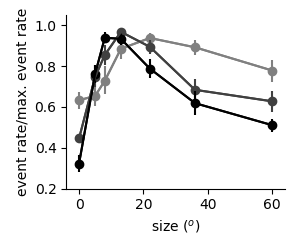

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
0.9516556168234196


<IPython.core.display.Javascript object>


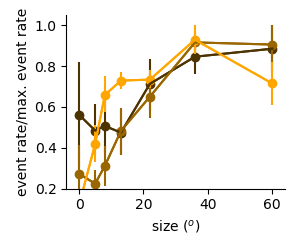

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
0.865831663245849


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


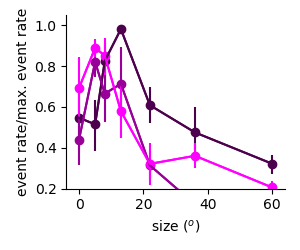

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
0.9624956896948569


<IPython.core.display.Javascript object>


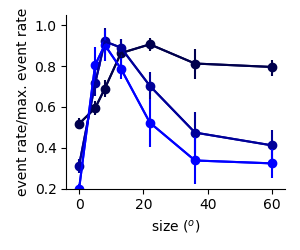

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(7, 7, 6)
0.8749793581945446


<IPython.core.display.Javascript object>


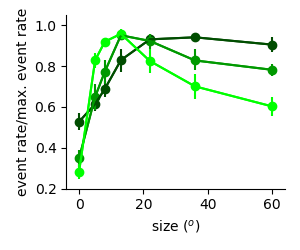

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
0.9326738766691006


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


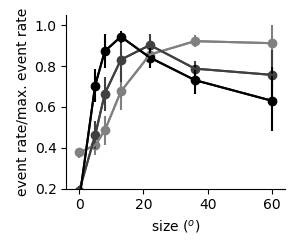

(13, 7, 6)
0.9147376906938471


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


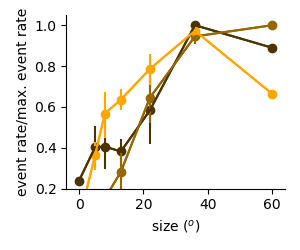

(10, 7, 6)
1.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


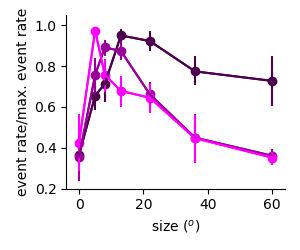

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
0.9563702504135612


<IPython.core.display.Javascript object>


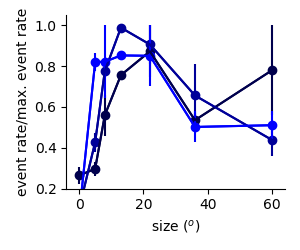

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(7, 7, 6)
0.9761964371657396


<IPython.core.display.Javascript object>


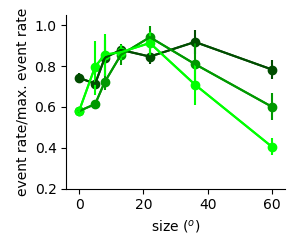

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
0.88844605035566


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


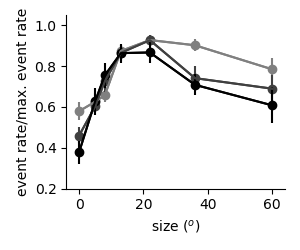

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
0.9006536535093354


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


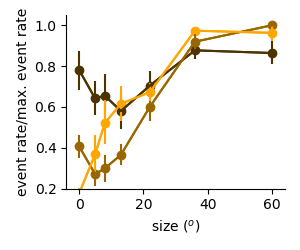

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
1.0


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


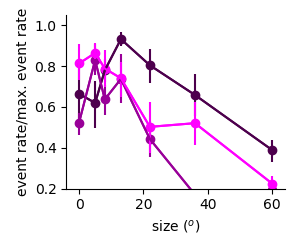

(13, 7, 6)
0.897862414740701


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


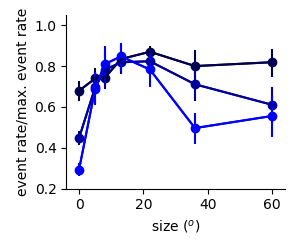

(7, 7, 6)
0.8420039759027369


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


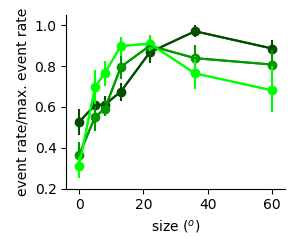

(10, 7, 6)
0.9408663577521075


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


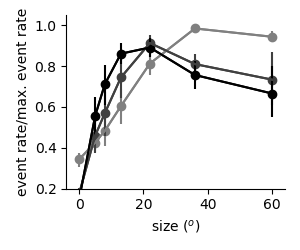

(13, 7, 6)
0.973345503847158


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


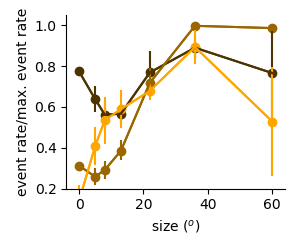

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(10, 7, 6)
0.9941718104869259


<IPython.core.display.Javascript object>


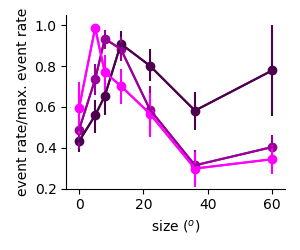

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(13, 7, 6)
0.9737153945526442


<IPython.core.display.Javascript object>


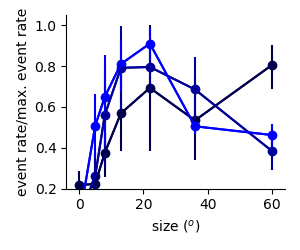

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


(7, 7, 6)
0.8329096331565449


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [207]:
c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
reload(ut)
for ialign in range(2):
    for irun in range(2):
        lbls = ['pc_l4','pc_l23','sst','vip','pv']
        for itype in [0,1,2,3,4]:#range(len(rsexpt)):
            plt.figure(figsize=(3,2.5))
            data = np.nanmean(rsexpt[irun][itype][ialign],-1)
            data = sim_utils.gen_size_tuning(data)
            data = data/np.nanmax(data,axis=1)[:,np.newaxis]
        #     for icontrast in range(6):
            #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
            ut.plot_bootstrapped_errorbars_hillel([0,5,8,13,22,36,60],data[:,:,these_contrasts].transpose((0,2,1)),pct=(16,84),colors=colors[itype])
#             plt.legend(['6%','25%','100%'])
            plt.xlabel('size ($^o$)')
            plt.ylabel('event rate/max. event rate')
            ut.erase_top_right()
            plt.ylim(0.2,1.05)
            plt.tight_layout()
            plt.savefig('figures/%s_size_by_3_contrasts_%s_%s_norm_to_max.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))

<IPython.core.display.Javascript object>


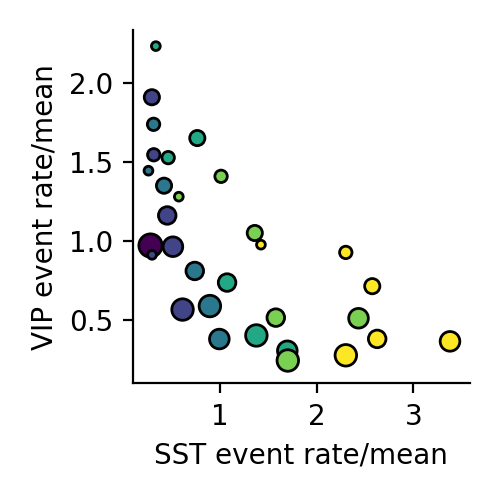

(-0.6214674205288891, 5.227444335972861e-05)


In [109]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2.5))
irun,ialign=0,0
itype1 = 2
itype2 = 3

data = np.nanmean(rsexpt[irun][itype1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = np.nanmean(data,0)
data = np.nanmean(rsexpt[irun][itype2][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
ydata = np.nanmean(data,0)

# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)
# ydata = np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
sca.scatter_size_contrast(xdata,ydata,equality_line=False,square=False,equate_0=True)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),ydata.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err)*x + intercept
y2 = (slope+std_err)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
plt.xlabel('SST event rate/mean')
plt.ylabel('VIP event rate/mean')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_scatter.jpg',dpi=300)

<IPython.core.display.Javascript object>


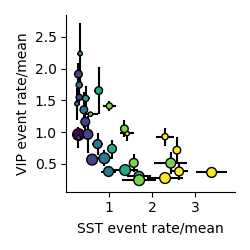

(-0.6214674205288891, 5.227444335972861e-05)


In [210]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2.5))
irun,ialign=0,0
itype1 = 2
itype2 = 3
cmax = 6

data = np.nanmean(rsexpt[irun][itype1][ialign],-1)
xdata = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
# xdata = np.nanmean(data,0)
data = np.nanmean(rsexpt[irun][itype2][ialign],-1)
ydata = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
# ydata = np.nanmean(data,0)

sca.scatter_size_contrast_errorbar(xdata[:,:,:cmax],ydata[:,:,:cmax],equality_line=False,square=False,equate_0=True)
slope, intercept, r_value, p_value, std_err = sst.linregress(np.nanmean(xdata,0).flatten(),np.nanmean(ydata,0).flatten())
print((r_value,p_value))
x = np.linspace(np.nanmin(np.nanmean(xdata,0)),np.nanmax(np.nanmean(xdata,0)),10)
y1 = (slope-std_err)*x + intercept
y2 = (slope+std_err)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
plt.xlabel('SST event rate/mean')
plt.ylabel('VIP event rate/mean')
plt.tight_layout()
ut.erase_top_right()
plt.savefig('figures/sst_vip_scatter_errorbars.jpg',dpi=300)

In [1047]:
pdb.pm()

> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/axes/_axes.py(3357)extract_err()
-> "err must be a scalar or a 1D or (2, n) array-like")
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/axes/_axes.py(3375)errorbar()
-> left, right = extract_err(xerr, x)
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/__init__.py(1601)inner()
-> return func(ax, *map(sanitize_sequence, args), **kwargs)
(Pdb) u
> /opt/anaconda3/envs/py3/lib/python3.6/site-packages/matplotlib/pyplot.py(2560)errorbar()
-> **({"data": data} if data is not None else {}), **kwargs)
(Pdb) u
> /Users/dan/Documents/code/adesnal/size_contrast_analysis.py(738)scatter_size_contrast_errorbar()
-> plt.errorbar(xmean,ymean,yerr=ysem,xerr=xsem,fmt='none',c='k',zorder=1)
(Pdb) ysem.shape
(6, 6)
(Pdb) xmean.shape
(6, 6)
(Pdb) exit


In [24]:
def compute_diff_avg(zdata,axis=0):
    zdata_diff = np.diff(zdata,axis=axis)
    zdata_diff_avg = np.zeros_like(zdata)
    slicer = [slice(None) for idim in range(len(zdata.shape))]
    for axind in [0,-1]:
        slicer[axis] = axind
        zdata_diff_avg[slicer] = zdata_diff[slicer]
    slicer1 = slicer.copy()
    slicer1[axis] = slice(1,-1)
    slicer2 = slicer.copy()
    slicer2[axis] = slice(None,-1)
    slicer3 = slicer.copy()
    slicer3[axis] = slice(1,None)
    zdata_diff_avg[slicer1] = 0.5*zdata_diff[slicer2]+0.5*zdata_diff[slicer3]
    return zdata_diff_avg

def compute_slope_avg(tdata,zdata,axis=0):
    slicer = [np.newaxis for idim in range(len(zdata.shape))]
    slicer[axis] = slice(None)
    zdata_slope = np.diff(zdata,axis=axis)/np.diff(tdata)[slicer]
    zdata_slope_avg = np.zeros_like(zdata)
    slicer = [slice(None) for idim in range(len(zdata.shape))]
    for axind in [0,-1]:
        slicer[axis] = axind
        zdata_slope_avg[slicer] = zdata_slope[slicer]
    slicer1 = slicer.copy()
    slicer1[axis] = slice(1,-1)
    slicer2 = slicer.copy()
    slicer2[axis] = slice(None,-1)
    slicer3 = slicer.copy()
    slicer3[axis] = slice(1,None)
    zdata_slope_avg[slicer1] = 0.5*zdata_slope[slicer2]+0.5*zdata_slope[slicer3]
    return zdata_slope_avg

<IPython.core.display.Javascript object>


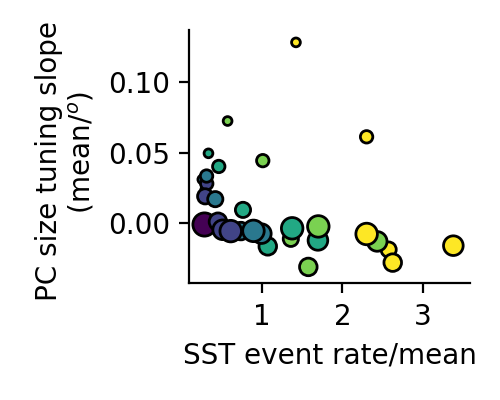

(-0.2432684380511851, 0.15280925348080185)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [49]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2))
irun,ialign=0,0
itype1 = 2
itype2 = 3
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = np.nanmean(data,0)
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = np.nanmean(data,0)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(usize,zdata,axis=0)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast(xdata,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('SST event rate/mean')
plt.ylabel('PC size tuning slope \n (mean/$^o$)')
nbins = 6

mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_pc_slope_size_tuning_scatter.jpg',dpi=300)

<IPython.core.display.Javascript object>


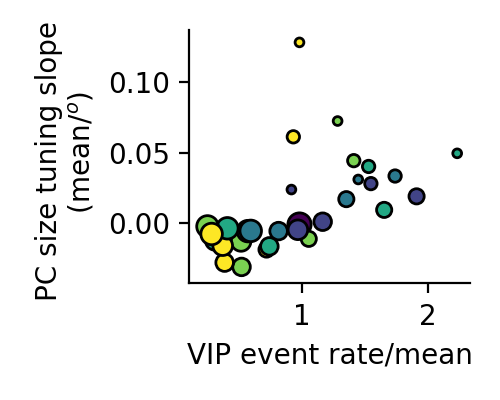

(0.5293812357527905, 0.0009003747267695372)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [604]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2))
irun,ialign=0,0
itype1 = 2
itype2 = 3
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype2][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = np.nanmean(data,0)
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = np.nanmean(data,0)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(usize,zdata,axis=0)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast(xdata,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('VIP event rate/mean')
plt.ylabel('PC size tuning slope \n (mean/$^o$)')
nbins = 6

mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/vip_pc_slope_size_tuning_scatter.jpg',dpi=300)

<IPython.core.display.Javascript object>


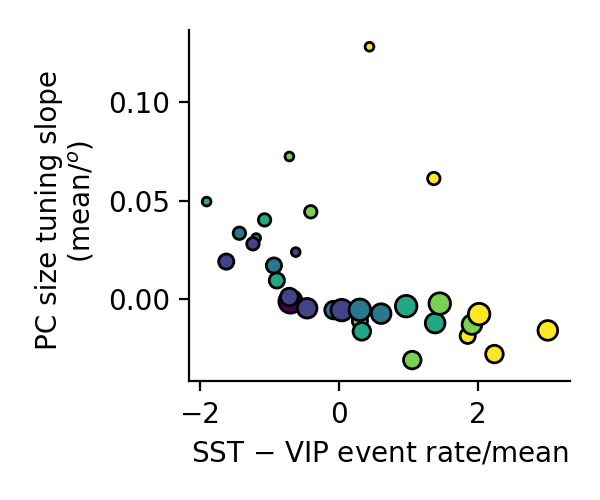

(-0.3840079327698764, 0.020767909287222785)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [61]:
plt.close('all')
reload(sca)
plt.figure(figsize=(3,2.5))
irun,ialign=0,0
itype1a = 2
itype1b = 3
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype1a][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = np.nanmean(data,0)
data = np.nanmean(rsexpt[irun][itype1b][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = xdata - np.nanmean(data,0)
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = np.nanmean(data,0)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(usize,zdata,axis=0)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast(xdata,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('SST $-$ VIP event rate/mean')
plt.ylabel('PC size tuning slope \n (mean/$^o$)')
nbins = 6

mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_minus_vip_pc_slope_size_tuning_scatter.jpg',dpi=300)

In [411]:
zdata.shape

(13, 6, 6)

<IPython.core.display.Javascript object>


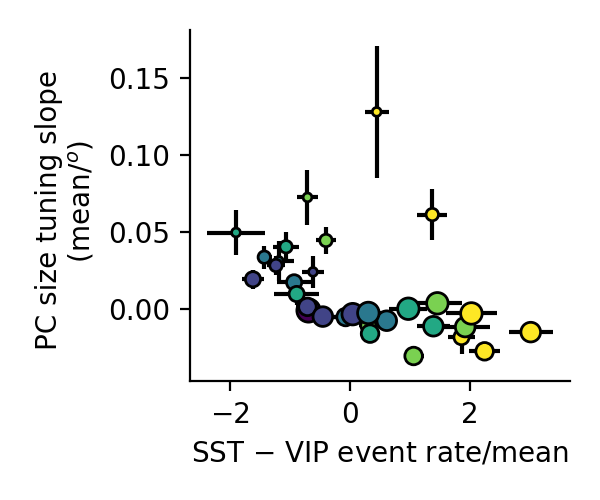

(-0.367539632754394, 0.027437180930630762)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [413]:
plt.close('all')
reload(sca)
plt.figure(figsize=(3,2.5))
irun,ialign=0,0
itype1a = 2
itype1b = 3
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype1a][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
x1data = data.copy()
data = np.nanmean(rsexpt[irun][itype1b][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
x2data = data.copy()
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = data
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(usize,zdata,axis=1)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast_diff_errorbar(x1data,x2data,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('SST $-$ VIP event rate/mean')
plt.ylabel('PC size tuning slope \n (mean/$^o$)')
nbins = 6
xdata = np.nanmean(x1data,0)-np.nanmean(x2data,0)
zdata_diff_avg = np.nanmean(zdata_diff_avg,0)
mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_minus_vip_pc_slope_size_tuning_scatter_errorbar.jpg',dpi=300)

<IPython.core.display.Javascript object>


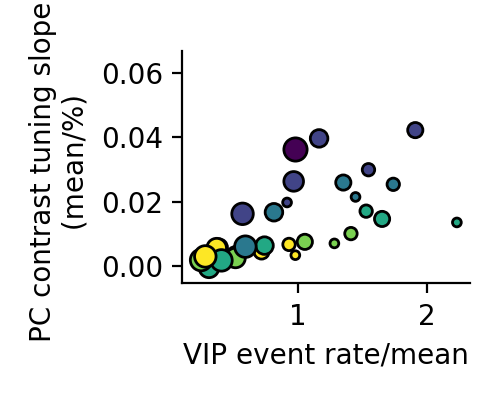

(0.4432603819683314, 0.006777420757391704)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [614]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2))
irun,ialign=0,0
itype1 = 2
itype2 = 3
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype2][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = np.nanmean(data,0)
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = np.nanmean(data,0)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(ucontrast,zdata,axis=1)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast(xdata,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('VIP event rate/mean')
plt.ylabel('PC contrast tuning slope \n (mean/%)')
nbins = 6

mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/vip_pc_slope_contrast_tuning_scatter.jpg',dpi=300)

<IPython.core.display.Javascript object>


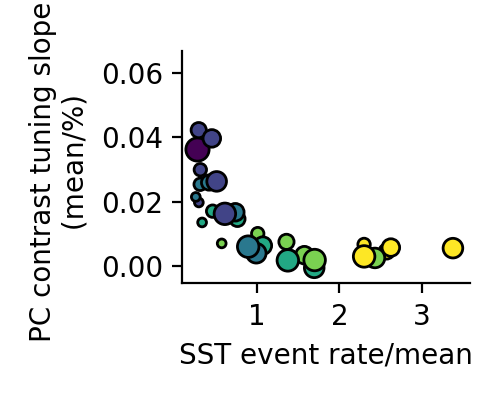

(-0.6589680212781747, 1.242642829758565e-05)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [47]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2))
irun,ialign=0,0
# itype1 = 2
itype2 = 2
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype2][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = np.nanmean(data,0)
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = np.nanmean(data,0)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(ucontrast,zdata,axis=1)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast(xdata,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('SST event rate/mean')
plt.ylabel('PC contrast tuning slope \n (mean/%)')
nbins = 6

mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_pc_slope_contrast_tuning_scatter.jpg',dpi=300)

In [479]:
lda = sklearn.discriminant_analysis.LinearDiscriminantAnalysis()
Xvip = np.nanmean(rs[0][3][0],3).reshape((-1,36))
Xpc = np.nanmean(rs[0][1][0],3).reshape((-1,36))
Xvip = Xvip[~np.isnan(Xvip.sum(1))]
Xpc = Xpc[~np.isnan(Xpc.sum(1))]
X = np.concatenate((Xpc,Xvip),axis=0)
y = np.concatenate((np.zeros((Xpc.shape[0],)),np.ones((Xvip.shape[0],))),axis=0)
lda.fit(X,y)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


LinearDiscriminantAnalysis(n_components=None, priors=None, shrinkage=None,
                           solver='svd', store_covariance=False, tol=0.0001)

<IPython.core.display.Javascript object>


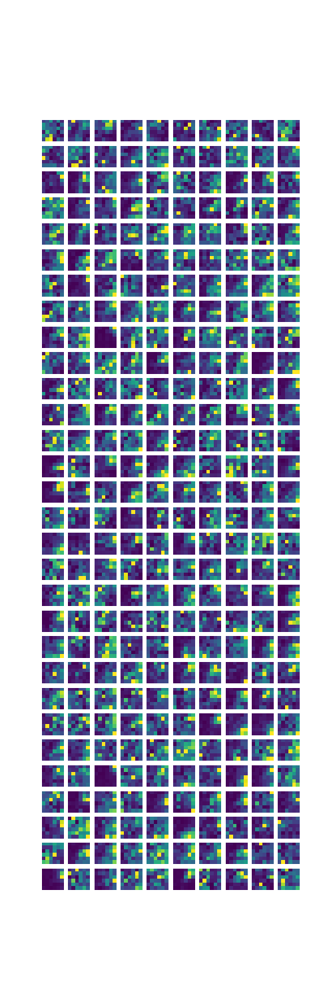

In [487]:
ut.imshow_in_rows(Xpc.reshape((-1,6,6))[:300])

<IPython.core.display.Javascript object>


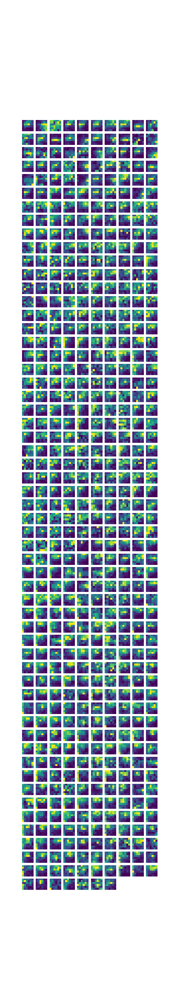

In [484]:
ut.imshow_in_rows(Xvip.reshape((-1,6,6)))

<IPython.core.display.Javascript object>


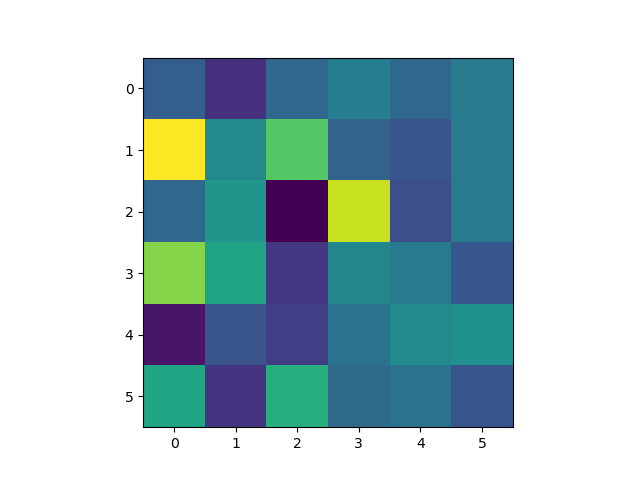

In [482]:
plt.figure()
plt.imshow(lda.coef_[0].reshape((6,6)))

<IPython.core.display.Javascript object>


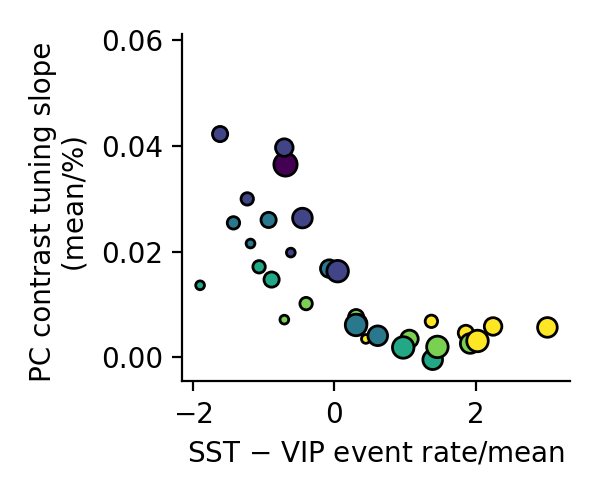

(-0.6385176484159616, 2.78533645578374e-05)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [62]:
plt.close('all')
reload(sca)
plt.figure(figsize=(3,2.5))
irun,ialign=0,0
itype1a = 2
itype1b = 3
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype1a][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = np.nanmean(data,0)
data = np.nanmean(rsexpt[irun][itype1b][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
xdata = xdata - np.nanmean(data,0)
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = np.nanmean(data,0)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(ucontrast,zdata,axis=1)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast(xdata,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('SST $-$ VIP event rate/mean')
plt.ylabel('PC contrast tuning slope \n (mean/%)')
nbins = 6

mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_minus_vip_pc_slope_contrast_tuning_scatter.jpg',dpi=300)

<IPython.core.display.Javascript object>


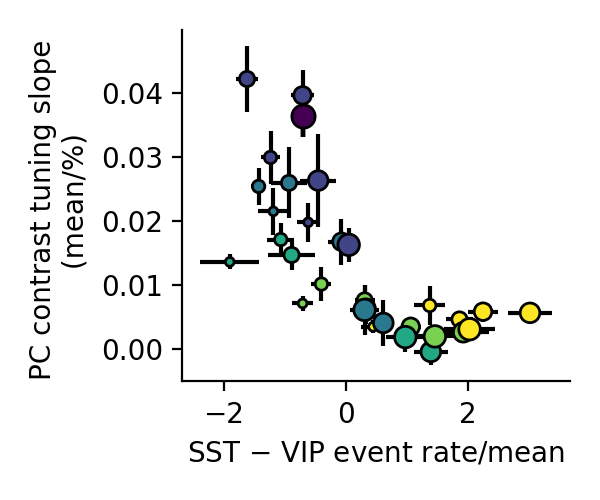

(-0.6385176484159616, 2.78533645578374e-05)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [416]:
plt.close('all')
reload(sca)
plt.figure(figsize=(3,2.5))
irun,ialign=0,0
itype1a = 2
itype1b = 3
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
data = np.nanmean(rsexpt[irun][itype1a][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
x1data = data.copy()
data = np.nanmean(rsexpt[irun][itype1b][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
x2data = data.copy()
data = np.nanmean(rsexpt[irun][1][ialign],-1)
data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
zdata = data.copy()#np.nanmean(data,0)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_slope_avg(ucontrast,zdata,axis=2)
# zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast_diff_errorbar(x1data,x2data,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# plt.ylim(-5e-3,5e-3)
plt.xlabel('SST $-$ VIP event rate/mean')
plt.ylabel('PC contrast tuning slope \n (mean/%)')
nbins = 6

xdata = np.nanmean(x1data,0)-np.nanmean(x2data,0)
zdata_diff_avg = np.nanmean(zdata_diff_avg,0)
mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
x = np.linspace(xdata.min(),xdata.max(),10)
y1 = (slope-std_err/2)*x + intercept
y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_minus_vip_pc_slope_contrast_tuning_scatter_errorbar.jpg',dpi=300)

<IPython.core.display.Javascript object>


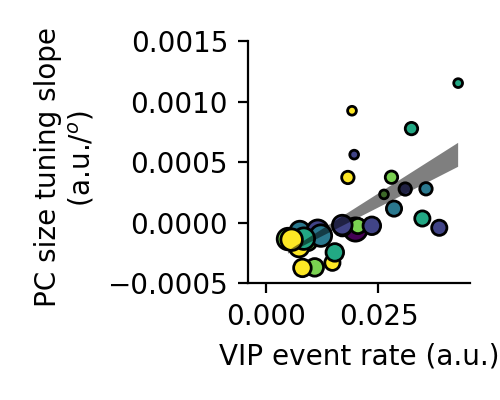

(0.6194725132404889, 5.61351795434774e-05)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:32: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will

In [62]:
# plt.close('all')
# reload(sca)
# plt.figure(figsize=(2.5,2))
# irun,ialign=0,0
# itype1 = 2
# itype2 = 3
# # xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
# xdata = np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
# zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
# zdata_diff_avg = compute_slope_avg(usize,zdata,axis=0)
# # zdata_diff_avg = compute_diff_avg(zdata,axis=0)
# # zdata_diff_avg = zdata_diff_avg/zdata
# sca.scatter_size_contrast(xdata,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
# plt.ylim(-0.5e-3,1.5e-3)
# # plt.ylim(-5e-3,5e-3)
# plt.xlabel('VIP event rate (a.u.)')
# plt.ylabel('PC size tuning slope \n (a.u./$^o$)')
# # nbins = 6

# # mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
# # count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
# # std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
# # bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
# bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
# sem = std/np.sqrt(count)
# slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
# print((r_value,p_value))
# x = np.linspace(xdata.min(),xdata.max(),10)
# y1 = (slope-std_err/2)*x + intercept
# y2 = (slope+std_err/2)*x + intercept
# plt.fill_between(x,y1,y2,facecolor='k',alpha=0.5)
# erase_top_right()
# # plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
# plt.tight_layout()
# plt.savefig('figures/vip_pc_slope_size_tuning_scatter.jpg',dpi=300)

<IPython.core.display.Javascript object>


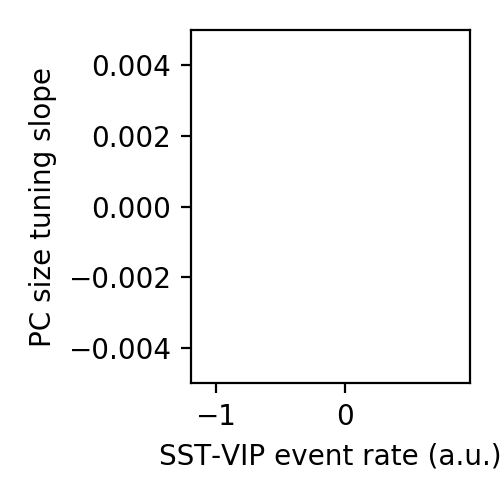

(-0.6371304412510735, 2.9358773328099158e-05)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  import sys
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:14: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  


In [34]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2.5))
irun,ialign=0,0
itype1 = 2
itype2 = 3
xdata = np.nanmean(np.nanmean(rsexpt[irun][itype1][ialign],0),-1)#-np.nanmean(np.nanmean(rsexpt[irun][itype2][ialign],0),-1)
zdata = np.nanmean(np.nanmean(rsexpt[irun][0][ialign],0),-1)
zdata_diff_avg = compute_diff_avg(zdata)
xdata_diff_avg = compute_diff_avg(xdata)
# zdata_diff_avg = zdata_diff_avg/zdata
sca.scatter_size_contrast(xdata_diff_avg,zdata_diff_avg,equality_line=False,square=False,equate_0=True)
plt.ylim(-5e-3,5e-3)
plt.xlabel('SST-VIP event rate (a.u.)')
plt.ylabel('PC size tuning slope')
nbins = 6

mean,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='mean')
count,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='count')
std,bin_edges,bin_inds = sst.binned_statistic(xdata.flatten(),zdata_diff_avg.flatten(),bins=nbins,statistic='std')
# bin_inds = np.digitize(xdata-ydata,np.linspace(xdata.min(),xdata.max(),10))
bin_ctrs = 0.5*(bin_edges[:-1]+bin_edges[1:])
sem = std/np.sqrt(count)
slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(),zdata_diff_avg.flatten())
print((r_value,p_value))
# plt.fill_between(bin_ctrs,mean-sem/2,mean+sem/2,facecolor='k',alpha=0.5)
plt.tight_layout()
# plt.savefig('figures/sst_vip_pc_size_tuning_scatter.eps')

In [1041]:
r_value

-0.5897309153745138

<IPython.core.display.Javascript object>


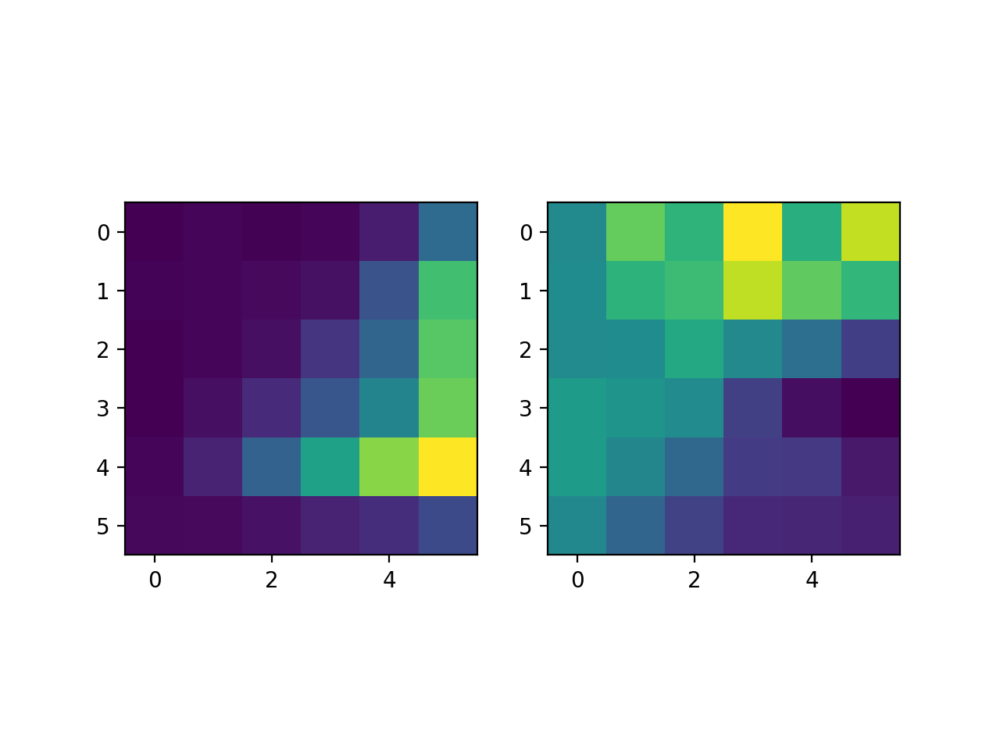

In [1000]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(xdata)
plt.subplot(1,2,2)
plt.imshow(zdata_diff_avg)

<IPython.core.display.Javascript object>


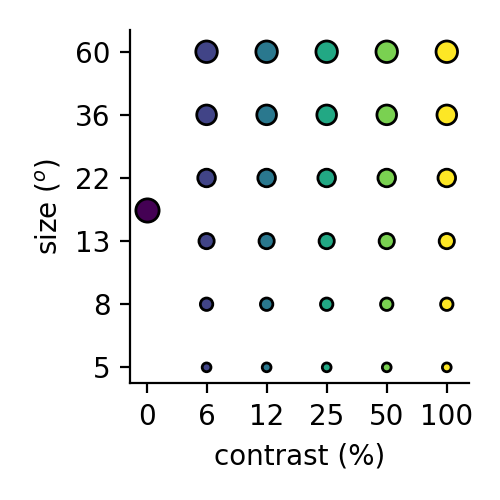

In [57]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2.5))
irun,ialign=0,0
itype1 = 2
itype2 = 3
xdata,ydata = np.meshgrid(np.arange(6),np.arange(6))
sca.scatter_size_contrast(xdata,ydata,equality_line=False,square=False,equate_0=True)
plt.yticks(np.arange(6),[5,8,13,22,36,60])
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xlabel('contrast (%)')
plt.ylabel('size ($^o$)')
# plt.xlabel('SST event rate (a.u.)')
# plt.ylabel('VIP event rate (a.u.)')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/scatter_size_contrast_legend_equate_0.eps')

<IPython.core.display.Javascript object>


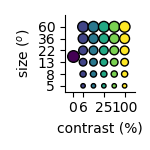

In [209]:
plt.close('all')
reload(sca)
plt.figure(figsize=(1.5,1.5))
irun,ialign=0,0
itype1 = 2
itype2 = 3
xdata,ydata = np.meshgrid(np.arange(6),np.arange(6))
sca.scatter_size_contrast(xdata[:,:cmax],ydata[:,:cmax],equality_line=False,square=False,equate_0=True)
plt.yticks(np.arange(6),[5,8,13,22,36,60])
# plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xticks([0,1,3,5],[0,6,25,100])
# plt.xticks([0,2,4],[0,12,50])
plt.xlim(-0.75,6)
plt.ylim(-0.5,6)
plt.xlabel('contrast (%)')
plt.ylabel('size ($^o$)')
# plt.xlabel('SST event rate (a.u.)')
# plt.ylabel('VIP event rate (a.u.)')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/scatter_size_contrast_legend_equate_0_small.eps')

<IPython.core.display.Javascript object>


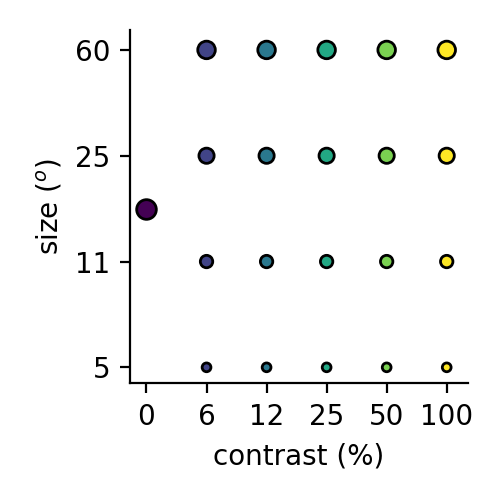

In [90]:
plt.close('all')
reload(sca)
plt.figure(figsize=(2.5,2.5))
irun,ialign=0,0
itype1 = 2
itype2 = 3
xdata,ydata = np.meshgrid(np.arange(6),np.arange(4))
sca.scatter_size_contrast(xdata,ydata,equality_line=False,square=False,equate_0=True)
plt.yticks(np.arange(4),[5,11,25,60])
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xlabel('contrast (%)')
plt.ylabel('size ($^o$)')
# plt.xlabel('SST event rate (a.u.)')
# plt.ylabel('VIP event rate (a.u.)')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/scatter_size_contrast_legend_4_sizes_equate_0.eps')

<IPython.core.display.Javascript object>


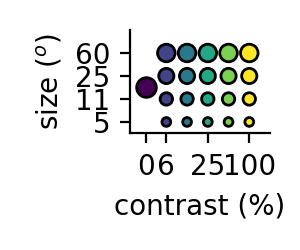

In [421]:
plt.close('all')
reload(sca)
plt.figure(figsize=(1.5,1.25))
irun,ialign=0,0
itype1 = 2
itype2 = 3
xdata,ydata = np.meshgrid(np.arange(6),np.arange(4))
sca.scatter_size_contrast(xdata,ydata,equality_line=False,square=False,equate_0=True)
plt.yticks(np.arange(4),[5,11,25,60])
# plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xticks([0,1,3,5],[0,6,25,100])
plt.xlabel('contrast (%)')
plt.ylabel('size ($^o$)')
# plt.xlabel('SST event rate (a.u.)')
# plt.ylabel('VIP event rate (a.u.)')
plt.xlim(-0.75,6)
plt.ylim(-0.5,4)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/scatter_size_contrast_legend_4_sizes_equate_0_small.eps')

<IPython.core.display.Javascript object>


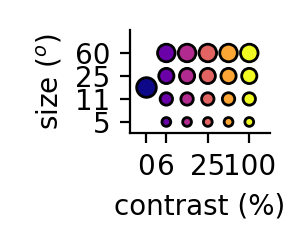

In [420]:
plt.close('all')
reload(sca)
plt.figure(figsize=(1.5,1.25))
irun,ialign=0,0
itype1 = 2
itype2 = 3
xdata,ydata = np.meshgrid(np.arange(6),np.arange(4))
sca.scatter_size_contrast(xdata,ydata,equality_line=False,square=False,equate_0=True,colormap=plt.cm.plasma)
plt.yticks(np.arange(4),[5,11,25,60])
# plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xticks([0,1,3,5],[0,6,25,100])
plt.xlabel('contrast (%)')
plt.ylabel('size ($^o$)')
# plt.xlabel('SST event rate (a.u.)')
# plt.ylabel('VIP event rate (a.u.)')
plt.xlim(-0.75,6)
plt.ylim(-0.5,4)
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/scatter_size_contrast_legend_4_sizes_equate_0_small_plasma.eps')

In [226]:
rs[0][1][0].shape

(8870, 6, 6, 8)

In [288]:
irun,ialign = 0,0
itype = 1
pref_size = np.argmax(np.nanmean(np.nanmean(rs[irun][itype][ialign],3),2),axis=1)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


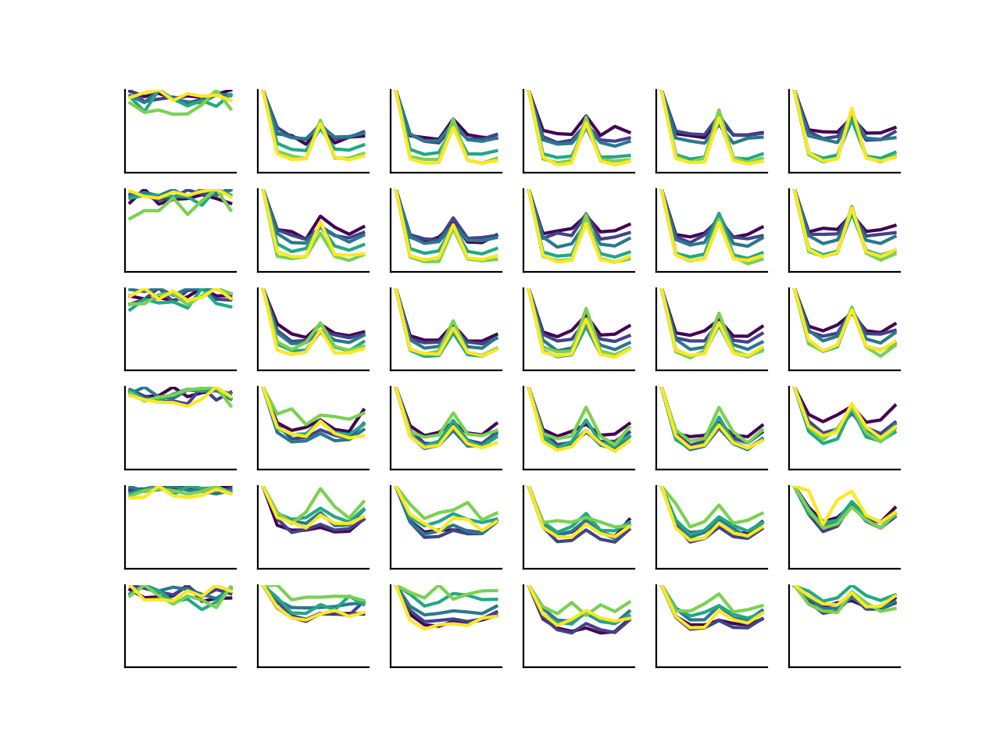

/Users/dan/Documents/code/adesnal/pyute.py:1905: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  def circ_align_to_pref(data,axis=1):
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # This is added back by InteractiveShellApp.init_path()


In [338]:
nsize,ncontrast = 6,6
plt.figure()
this_colormap = plt.cm.viridis(np.linspace(0,1,nsize))
for this_pref_size in np.arange(nsize):
    this_data = rs[irun][itype][ialign][pref_size==this_pref_size]
    data = np.nanmean(this_data[:,:,:,:],0)
    for isize in range(nsize):
        for icontrast in range(ncontrast):
            plt.subplot(nsize,ncontrast,(nsize-1-isize)*nsize+icontrast+1)
            plt.plot(data[isize,icontrast,:]/data[isize,icontrast,:].max(),c=this_colormap[this_pref_size])
            plt.ylim(0,1)
            plt.xticks(())
            plt.yticks(())
            ut.erase_top_right()
#             plt.axhline(0.5,c='k',linestyle='dashed')
#             plt.plot(data[isize,icontrast,:])#/data[isize,icontrast,:].max())
#             plt.ylim(0,data.max())
# plt.savefig('figures/ori_tuning_by_size_contrast_prefsize_norm.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


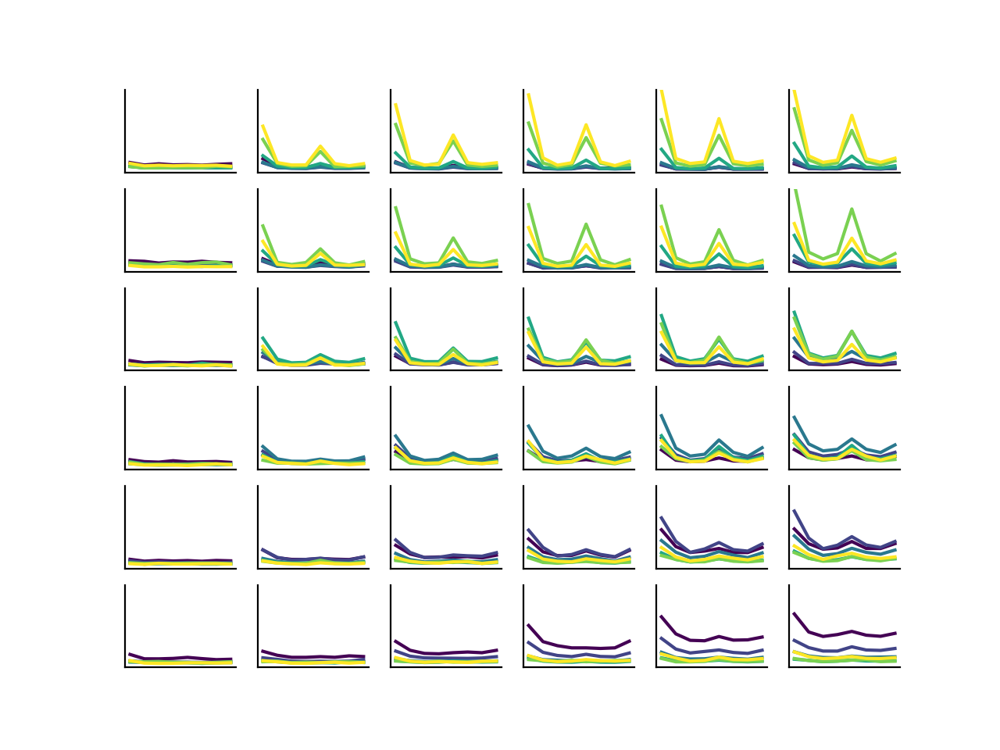

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


In [336]:
nsize,ncontrast = 6,6
plt.figure()
this_colormap = plt.cm.viridis(np.linspace(0,1,nsize))
for this_pref_size in np.arange(nsize):
    data = np.nanmean(rs[irun][itype][ialign][pref_size==this_pref_size,:,:,:],0)
    for isize in range(nsize):
        for icontrast in range(ncontrast):
            plt.subplot(nsize,ncontrast,(nsize-1-isize)*nsize+icontrast+1)
#             plt.plot(data[isize,icontrast,:]/data[isize,icontrast,:].max(),c=this_colormap[this_pref_size])
#             plt.ylim(0,1)
#             plt.axhline(0.5,c='k',linestyle='dashed')
            plt.plot(data[isize,icontrast,:],c=this_colormap[this_pref_size])#/data[isize,icontrast,:].max())
            plt.ylim(0,data.max())
            plt.xticks(())
            plt.yticks(())
            ut.erase_top_right()
plt.savefig('figures/ori_tuning_by_size_contrast_prefsize.eps')

In [442]:
np.nanmean(np.nanmean(np.nanmean(rs[0][1][0],1),1),1)

array([0.12772507, 0.48799442, 0.59359898, ..., 0.55477791, 0.43863981,
       0.40570704])

In [417]:
def von_mises_function(x,kappa,mu,ht):
    # x: directions in radians
    # kappa: tuning sharpness parameter
    # mu: preferred direction in radians
    # ht: height of non-preferred direction peak relative to preferred
    return (np.exp(kappa*np.cos(x-mu)) + ht*np.exp(kappa*np.cos(x-mu-np.pi)))/(np.exp(kappa) + ht*np.exp(-kappa))
def sym_von_mises_function(x,kappa,amplitude,offset=0):
    # constraining ht = 1 above
    # multiplies output of von_mises_function() by amplitude
    return amplitude*von_mises_function(x,kappa,0,1)+offset
def svm_fn(*args):#kappa,amplitude):
    # wrapper function, using fixed uangle in degrees
    return sym_von_mises_function(np.deg2rad(uangle),*args)#kappa,amplitude)
def svm_cost(x,data):
    # computes cost given parameters (kappa, amplitude[, optionally offset])
    return np.nansum((data-svm_fn(*x))**2)
def svm_cost_l1(x,data,lam=1):
    # computes cost given (kappa, amplitude[, optionally offset]), with an L1 penalty on kappa (exponential distribution prior on kappa)
    return np.nansum((data-svm_fn(*x))**2) + lam*x[0]
def optimize_kappa(data,x0=None,cost_fn=svm_cost,args=()):
    # given data, optimize (kappa, amplitude) inputs to svm_fn(), and return kappa
    if x0 is None:
        x0 = np.array((1,np.nanmax(data)))
    result = sop.minimize(cost_fn,x0,args=(data,)+args,bounds=[(0,np.inf),(0,np.inf)])
    kappa = result.x[0]
    return kappa
def optimize_kappa_offset(data,x0=None,cost_fn=svm_cost,args=()):
    # given data, optimize (kappa, amplitude) inputs to svm_fn(), and return kappa
    if x0 is None:
        x0 = np.array((1,np.nanmax(data),0))
    result = sop.minimize(cost_fn,x0,args=(data,)+args,bounds=[(0,np.inf),(0,np.inf),(-np.inf,np.inf)])
    kappa = result.x[0]
    return kappa
def kappa_s0_fn(s0,k0,sizes):
    return k0**2/(1/s0**2 + 1/sizes**2)
def kappa_s0_cost(x,data,k0,sizes):
    return np.nansum((data-kappa_s0_fn(x,k0,sizes))**2)
def optimize_s0(data,k0=k0,sizes=usize,x0=np.array((10,)),cost_fn=kappa_s0_cost,args=()):
    result = sop.minimize(kappa_s0_cost,x0,args=(data,k0,sizes)+args,bounds=[(0,np.inf)])
    s0 = result.x
    return s0


In [423]:
l1_lambda = 3e-2

In [433]:
import von_mises_analysis as vma

In [437]:
pref_size.shape

(8870,)

<IPython.core.display.Javascript object>


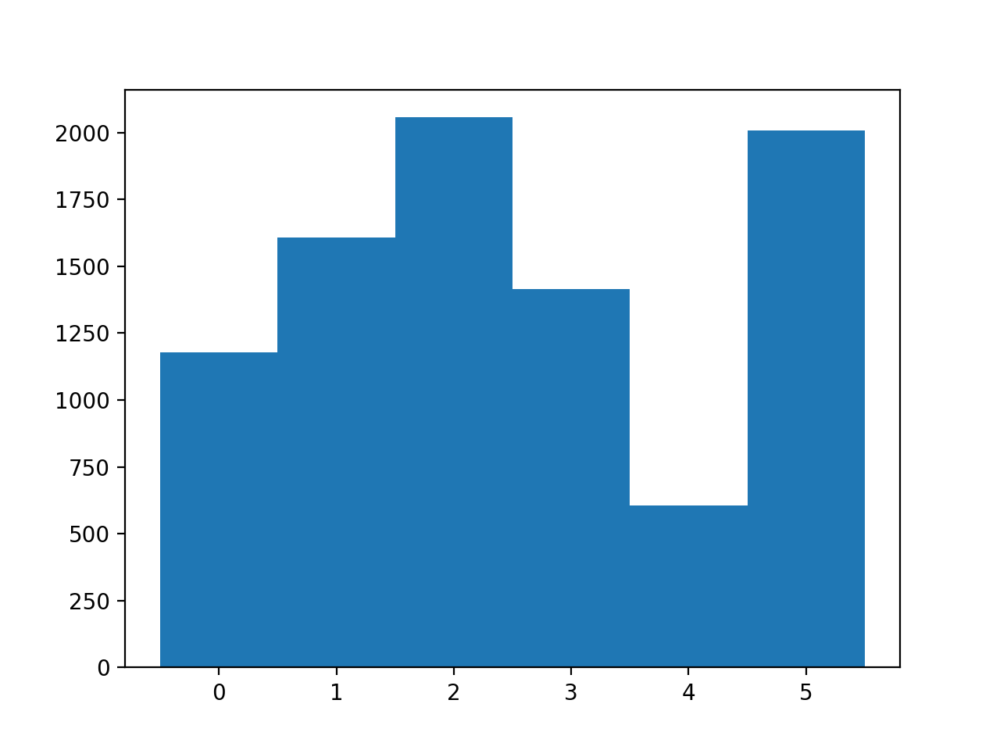

(array([1179., 1607., 2056., 1415.,  606., 2007.]),
 array([-0.5,  0.5,  1.5,  2.5,  3.5,  4.5,  5.5]),
 <a list of 6 Patch objects>)

In [439]:
plt.figure()
plt.hist(pref_size,bins=np.arange(7)-0.5)

In [434]:
kappa = np.zeros((nsize,nsize,ncontrast))
kappa_offset = np.zeros((nsize,nsize,ncontrast))
for this_pref_size in range(nsize):
    data = rs[irun][itype][ialign][pref_size==this_pref_size,:,:,:]
    pref_angle = np.argmax(np.nanmean(np.nanmean(data[:,:,1:5,:],1),1),axis=-1)
    data = ut.circ_align_to_entry(data,pref_angle,axis=3)
    data = np.nanmean(data,0)
    for isize in range(nsize):
        for icontrasdt in range(ncontrast):
#             result = sop.minimize(svm_cost,np.array((1,1)),args=(data[isize,icontrast],),bounds=[(0,np.inf),(0,np.inf)])
#             kappa[this_pref_size,isize,icontrast] = result.x[0]
            kappa[this_pref_size,isize,icontrast] = vma.optimize_kappa(data[isize,icontrast],cost_fn=svm_cost_l1,args=(l1_lambda,))#,x0=(1,1))
#             kappa[this_pref_size,isize,icontrast] = optimize_kappa(data,cost_fn=svm_cost,x0=(1,1))
            kappa_offset[this_pref_size,isize,icontrast] = vma.optimize_kappa_offset(data[isize,icontrast],cost_fn=svm_cost_l1,args=(0.3*l1_lambda,))#,x0=(1,1))
    

In [ ]:
# kappa = 

<IPython.core.display.Javascript object>


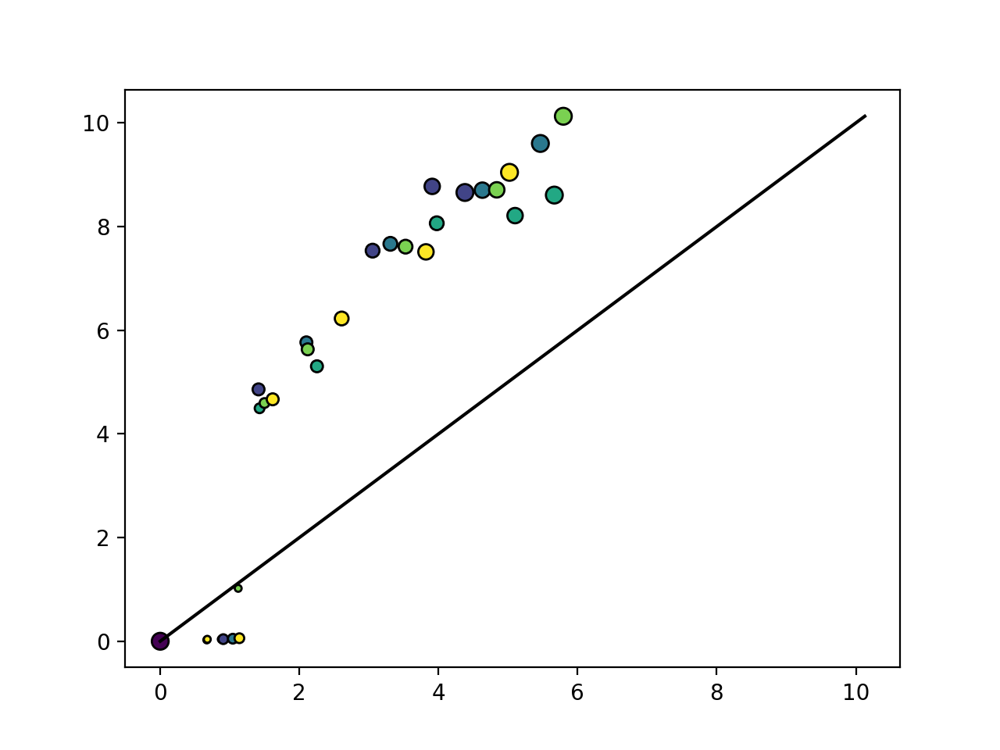

In [431]:
plt.figure()
sca.scatter_size_contrast(kappa[-1],kappa_offset[-1])

<IPython.core.display.Javascript object>


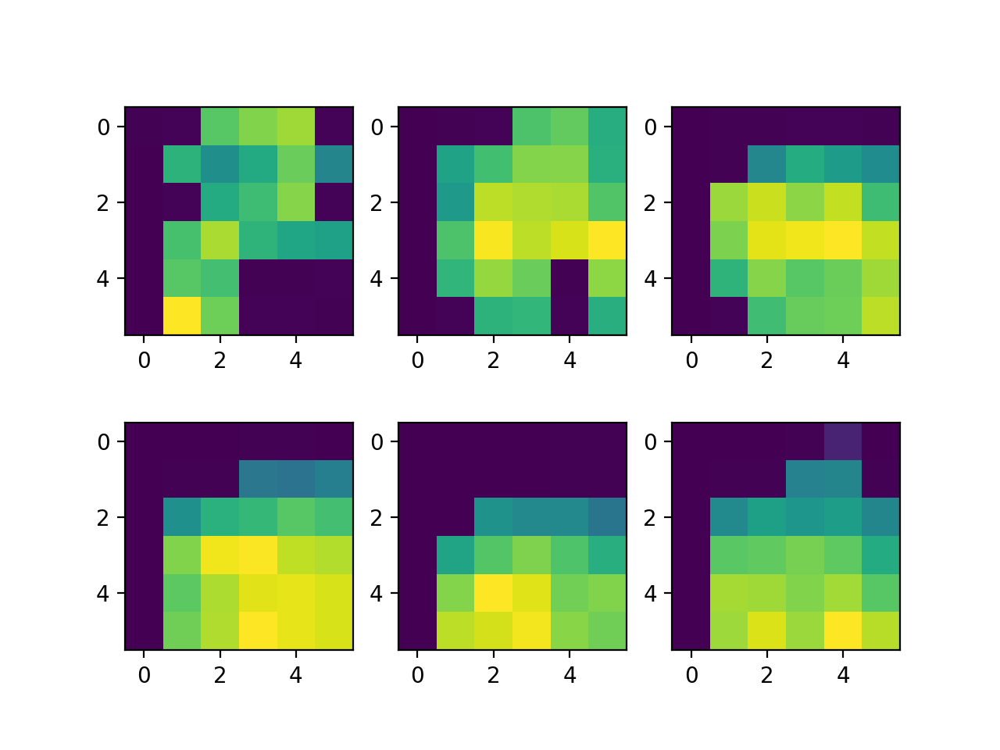

In [429]:
plt.figure()
for isize in range(nsize):
    plt.subplot(2,3,isize+1)
    plt.imshow(kappa_offset[isize])

In [343]:
k0 = 0.08
s0 = 20
a = 2

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


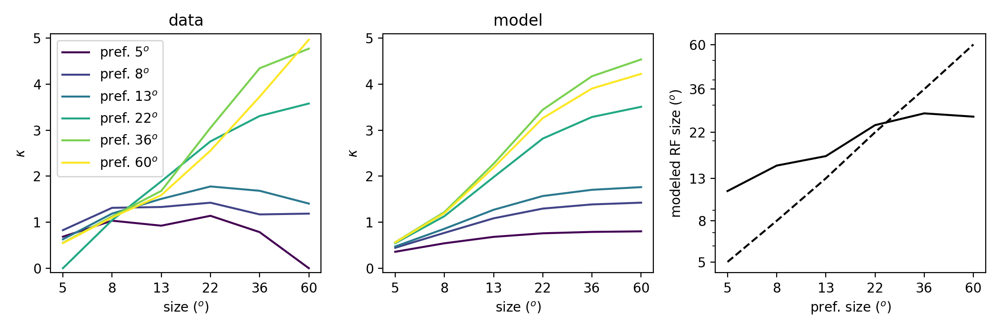

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  # This is added back by InteractiveShellApp.init_path()
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:14: MatplotlibDeprecationWarning: Adding an axes us

In [369]:
s0s = np.zeros((nsize,))
plt.figure(figsize=(10.5,3.5))
ylim = (-0.1,5.1)
for isize in range(nsize):
    plt.subplot(1,3,1)
    plt.plot(kappa[isize,:,-1],c=this_colormap[isize],label='pref. %d$^o$'%usize[isize])
#     s0 = usize[isize]/2
    s0s[isize] = optimize_s0(kappa[isize,:,-1],k0=k0,sizes=a*usize)
    modeled_kappa = k0**2/(1/s0s[isize]**2 + 1/(a*usize)**2)
    plt.ylim(ylim)
    plt.subplot(1,3,2)
    plt.plot(modeled_kappa,c=this_colormap[isize])
for iplot in range(2):
    plt.subplot(1,3,iplot+1)
    plt.ylim(ylim)
    plt.xlabel('size ($^o$)')
    plt.ylabel('$\kappa$')
    plt.xticks(np.arange(6),usize)
plt.subplot(1,3,1)
plt.title('data')
plt.legend()
plt.subplot(1,3,2)
plt.title('model')
plt.subplot(1,3,3)
plt.semilogy(s0s,c='k')
plt.semilogy(usize,c='k',linestyle='dashed')
plt.xticks(np.arange(6),usize)
plt.yticks([])
plt.yticks(usize,usize)
plt.xlabel('pref. size ($^o$)')
plt.ylabel('modeled RF size ($^o$)')
plt.tight_layout()
plt.savefig('figures/kappa_by_size_and_pref_size.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


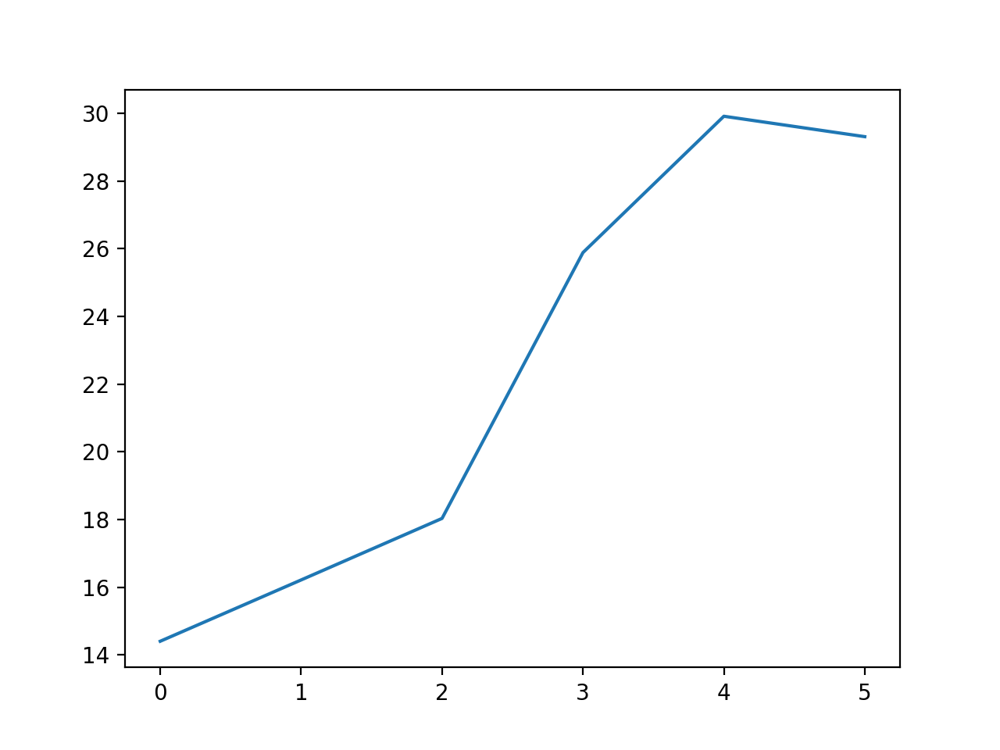

In [334]:
plt.figure()
plt.plot(s0s)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


<IPython.core.display.Javascript object>


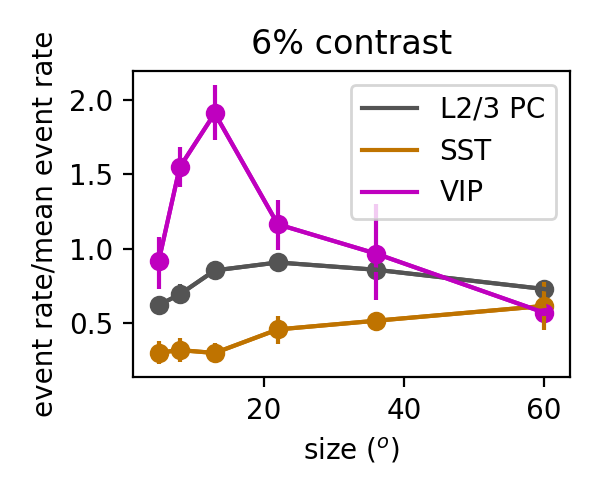

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8556032188083442
0.4673970447440056
1.7191994499278378


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


<IPython.core.display.Javascript object>


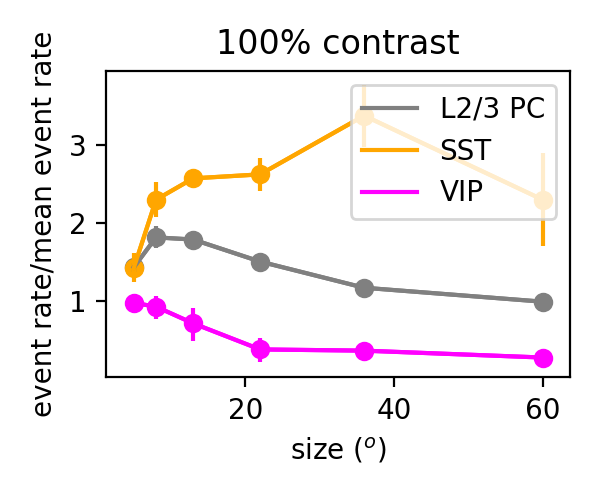

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.691752841545223
2.979658301710941
0.8676837149987611


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


In [281]:
reload(ut)
ialign = 0
irun = 0

lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = [np.array((0.33,0.33,0.33)),np.array((0.5,0.5,0.5))]
c_sst = [np.array((0.75,0.45,0)),np.array((1,0.65,0))]
c_vip = [np.array((0.75,0,0.75)),np.array((1,0,1))]
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
ucontrast = [0,6,12,25,50,100]

for iicontrast,icontrast in enumerate([1,5]):
    plt.figure(figsize=(3,2.5))
    for itype in [1,2,3]:#range(len(rsexpt)):
        data = np.nanmean(rsexpt[irun][itype][ialign],-1)
        data = data/np.nanmean(np.nanmean(data,1),1)[:,np.newaxis,np.newaxis]
    #     for icontrast in range(6):
        #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
        ut.plot_bootstrapped_errorbars_hillel([5,8,13,22,36,60],data[:,:,icontrast:icontrast+1].transpose((0,2,1)),pct=(16,84),colors=colors[itype][iicontrast][np.newaxis])
#         plt.legend(['6%','25%','100%'])
        plt.xlabel('size ($^o$)')
        plt.ylabel('event rate/mean event rate')
        plt.title('%d%% contrast'%ucontrast[icontrast])
        plt.legend(['L2/3 PC','SST','VIP'])
        plt.tight_layout()
    plt.savefig('figures/pc_sst_vip_size_by_contrast_%d.eps'%icontrast)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


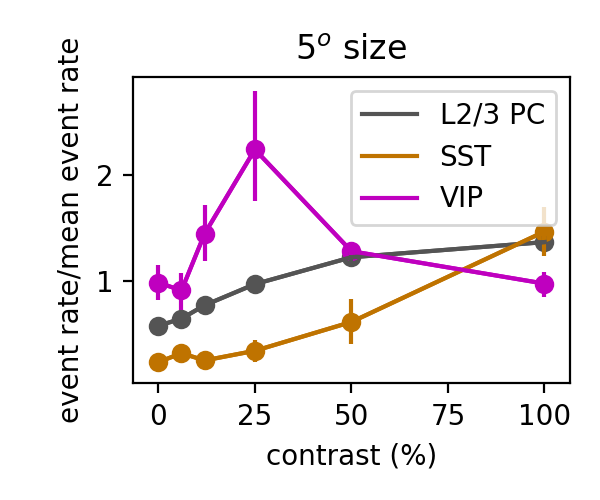

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support tr

1.3127762234023148
1.2334973124168367
1.6844219196465129


<IPython.core.display.Javascript object>


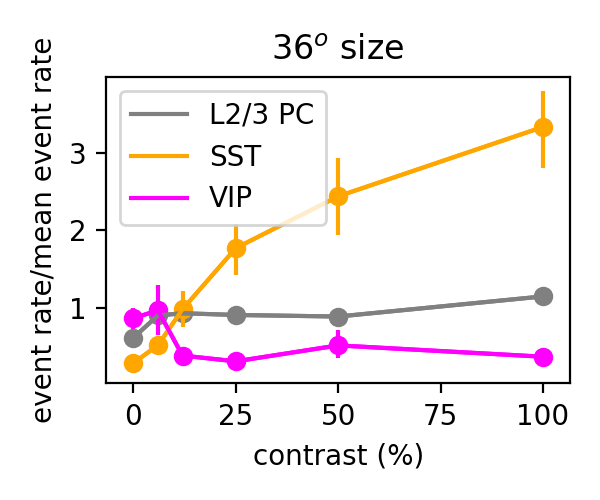

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.047382634369707
2.8666918844884073
0.7305596198174553


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


In [50]:
reload(ut)
ialign = 0
irun = 0

lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = [np.array((0.33,0.33,0.33)),np.array((0.5,0.5,0.5))]
c_sst = [np.array((0.75,0.45,0)),np.array((1,0.65,0))]
c_vip = [np.array((0.75,0,0.75)),np.array((1,0,1))]
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
usize = [5,8,13,22,36,60]

for iisize,isize in enumerate([0,4]):
    plt.figure(figsize=(3,2.5))
    these_types = [1,2,3]
    for itype in these_types:#range(len(rsexpt)):
        data = np.nanmean(rsexpt[irun][itype][ialign],-1)
        data = data/np.nanmean(np.nanmean(data,1),1)[:,np.newaxis,np.newaxis]
    #     for icontrast in range(6):
        #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
        ut.plot_bootstrapped_errorbars_hillel([0,6,12,25,50,100],data[:,isize:isize+1,:],pct=(16,84),colors=colors[itype][iisize][np.newaxis])
#         plt.legend(['6%','25%','100%'])
        plt.xlabel('contrast (%)')
        plt.ylabel('event rate/mean event rate')
    plt.legend(['L2/3 PC','SST','VIP'])
    plt.title('%d$^o$ size'%usize[isize])
    plt.tight_layout()
    plt.savefig('figures/pc_sst_vip_contrast_by_size_%d.eps'%isize)

In [29]:
alignment_lbls = ['aligned','misaligned']

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


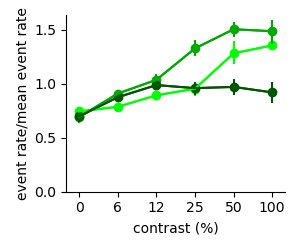

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.430892171344357


<IPython.core.display.Javascript object>


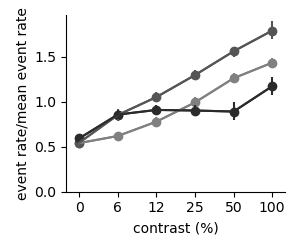

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.691752841545223


<IPython.core.display.Javascript object>


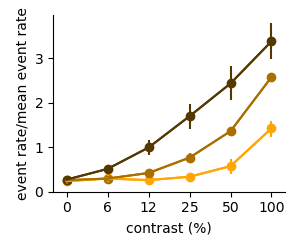

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.979658301710941


<IPython.core.display.Javascript object>


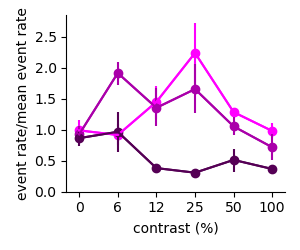

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.7191994499278378


<IPython.core.display.Javascript object>


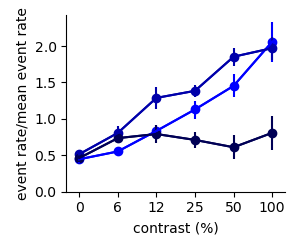

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.8028503725312983


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


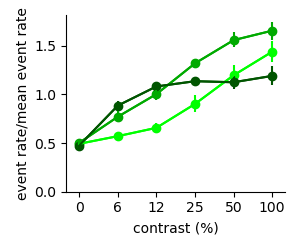

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.55580309073696


<IPython.core.display.Javascript object>


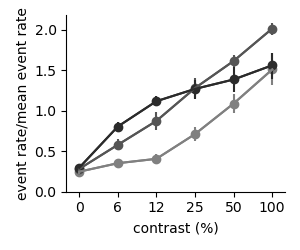

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.937739903495014


<IPython.core.display.Javascript object>


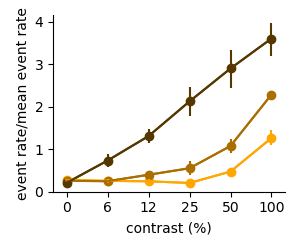

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.199106524770949


<IPython.core.display.Javascript object>


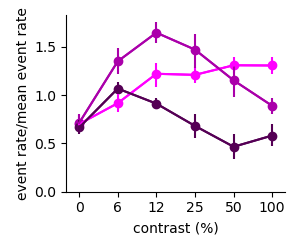

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.5427631344096726


<IPython.core.display.Javascript object>


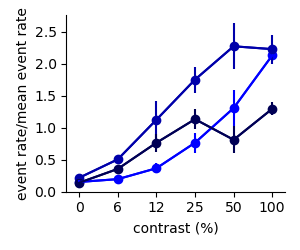

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.0806166314456918


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


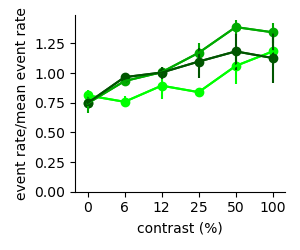

1.3192366107396065


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


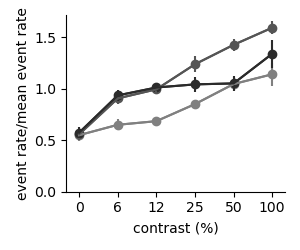

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.533427242420915


<IPython.core.display.Javascript object>


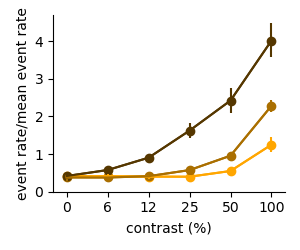

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


3.576011335460456


<IPython.core.display.Javascript object>


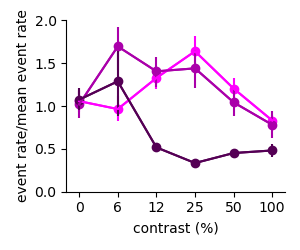

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.4689833854838672


<IPython.core.display.Javascript object>


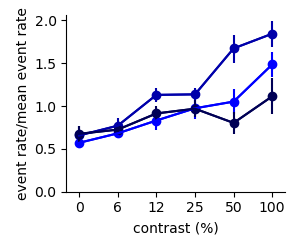

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.6892423182758625


<IPython.core.display.Javascript object>


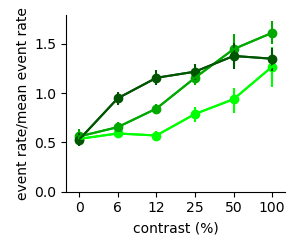

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.4990883509232413


<IPython.core.display.Javascript object>


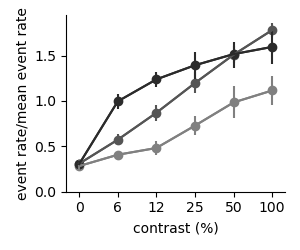

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.700285531515513


<IPython.core.display.Javascript object>


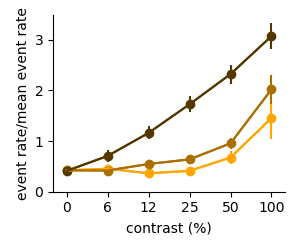

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.812737047981398


<IPython.core.display.Javascript object>


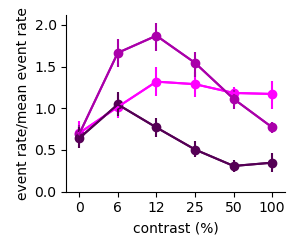

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.680775151117941


<IPython.core.display.Javascript object>


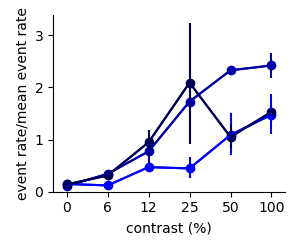

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


2.2368657782517265


In [71]:
# c_l4 = np.array(((0,0.3,0),(0,0.6,0),(0,1,0)))
# c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
# c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
# c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
# colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
cfrac = np.linspace(1,0,this_ncontrast+1)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
cmax = 6

ucontrast = np.array([0,6,12,25,50,100])

reload(ut)
ialign = 0
irun = 0
lbls = ['pc_l4','pc_l23','sst','vip','pv']
for ialign in range(2):
    for irun in range(2):
        for itype in [0,1,2,3,4]:#range(len(rsexpt)):
            plt.figure(figsize=(3,2.5))
            data = np.nanmean(rsexpt[irun][itype][ialign],-1)
            data = data/np.nanmean(np.nanmean(data,-1),-1)[:,np.newaxis,np.newaxis]
#             data = data/np.nanmean(np.n)
#             data = data/np.nanmax(data,axis=1)[:,np.newaxis]
        #     for icontrast in range(6):
            #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
            ut.plot_bootstrapped_errorbars_hillel(np.arange(cmax),data[:,[0,2,4],:cmax],pct=(16,84),colors=colors[itype])
            plt.gca().set_ylim(bottom=0)
            plt.xticks(np.arange(cmax),ucontrast[:cmax])
            #             plt.legend(['5$^o$','13$^o$','36$^o$'])
            plt.xlabel('contrast (%)')
            plt.ylabel('event rate/mean event rate')
            ut.erase_top_right()
            plt.tight_layout()
            plt.savefig('figures/%s_contrast_by_3_sizes_%s_%s.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


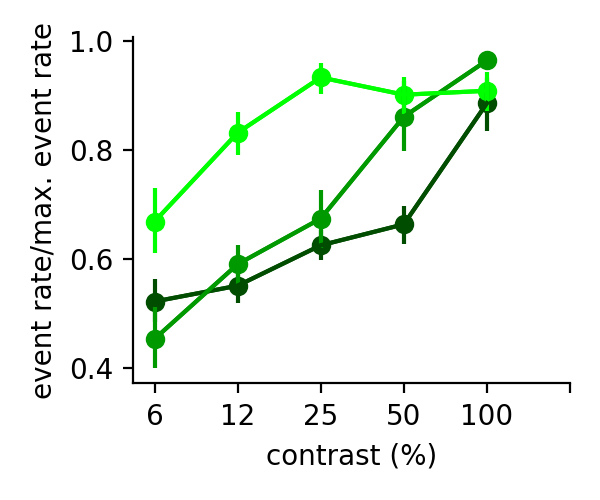

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9504320574705508


<IPython.core.display.Javascript object>


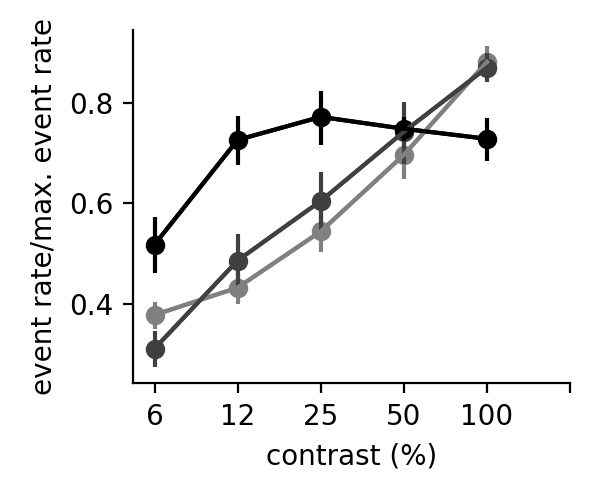

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8486890505803254


<IPython.core.display.Javascript object>


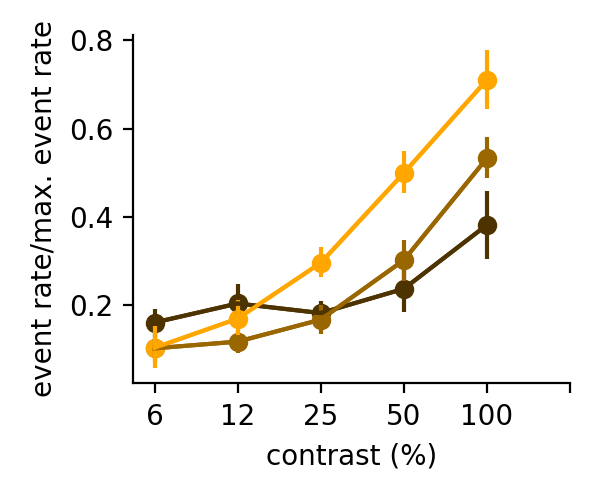

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.643895030745019


<IPython.core.display.Javascript object>


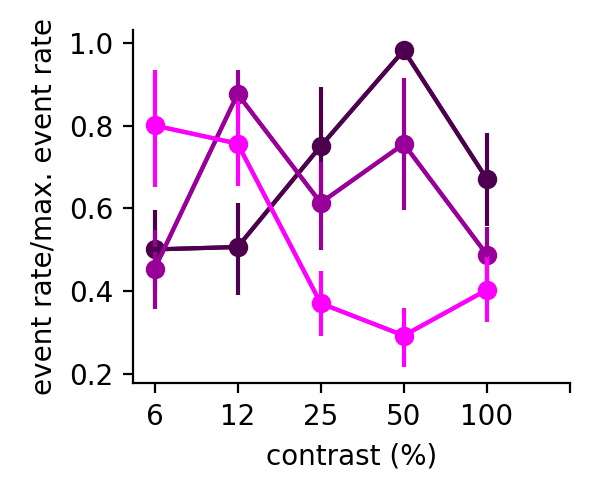

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9722795208755871


<IPython.core.display.Javascript object>


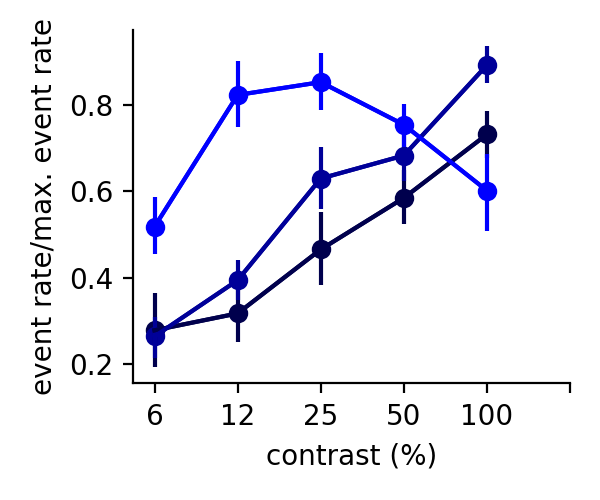

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8475219744522625


<IPython.core.display.Javascript object>


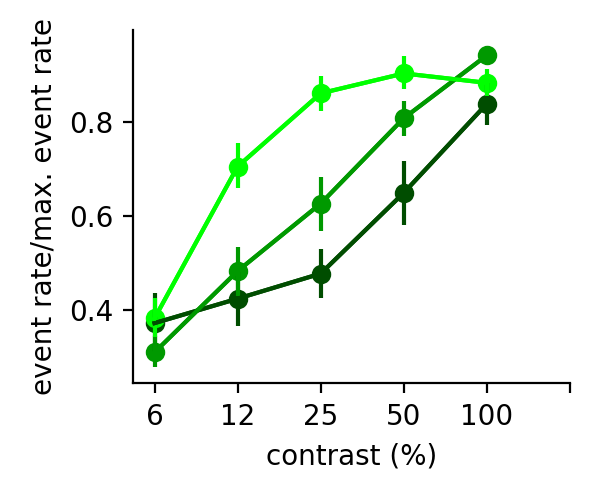

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9213005510026663


<IPython.core.display.Javascript object>


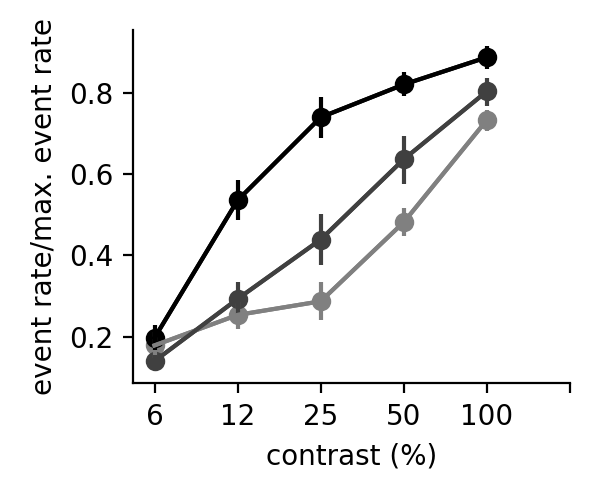

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8594340745644782


<IPython.core.display.Javascript object>


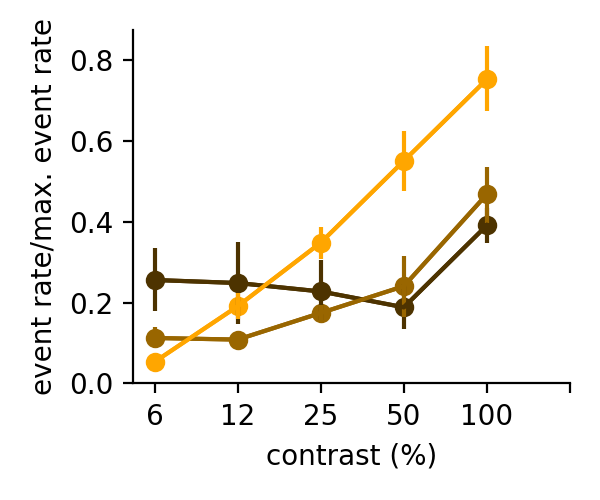

0.6713631041786899


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


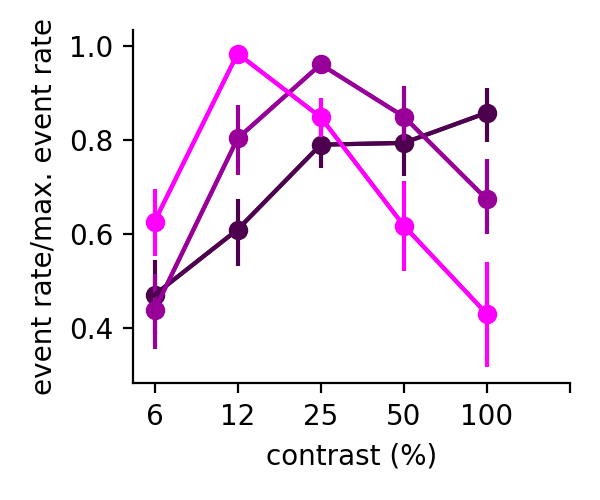

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9683533808852547


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


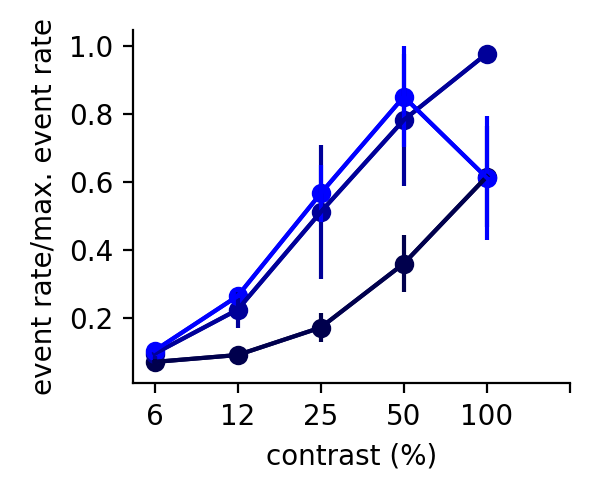

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9561460756543003


<IPython.core.display.Javascript object>


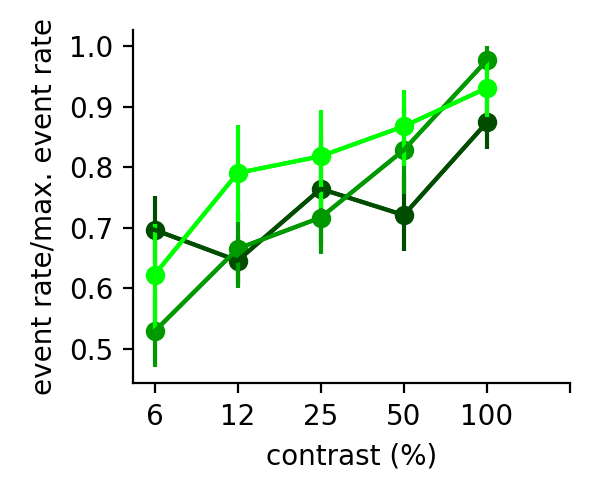

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9530513828431644


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


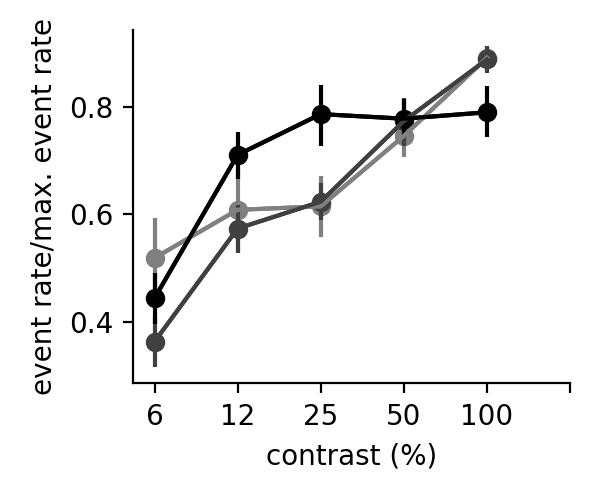

0.8693601768842287


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


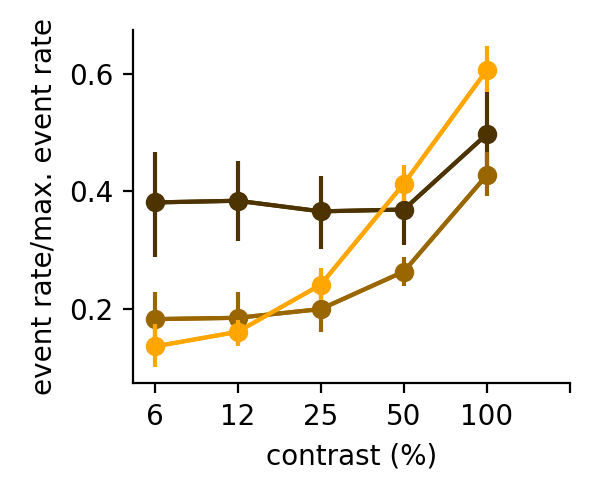

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.5661659910625458


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


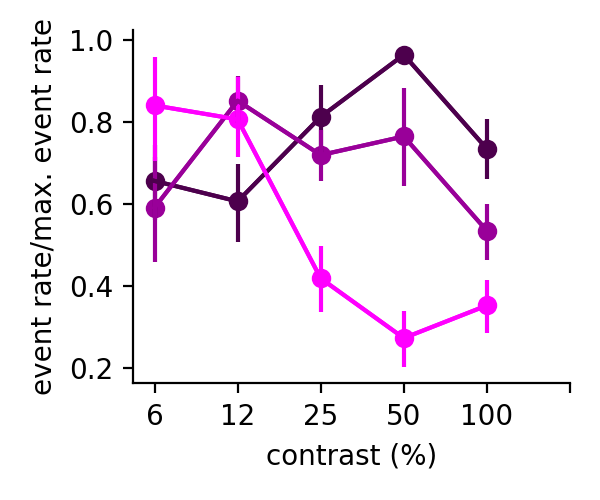

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9435377394091444


<IPython.core.display.Javascript object>


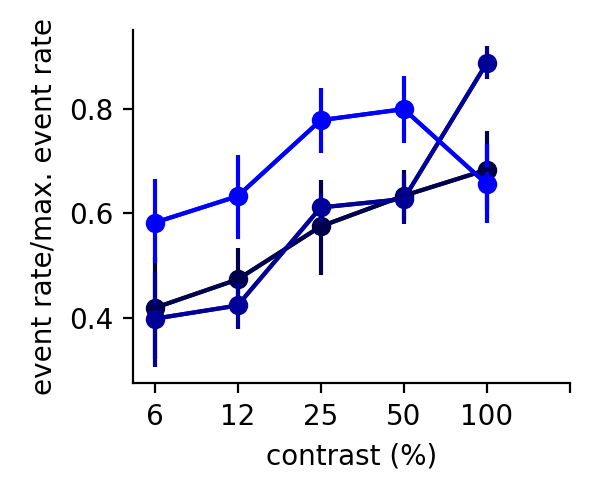

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.856692236173751


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


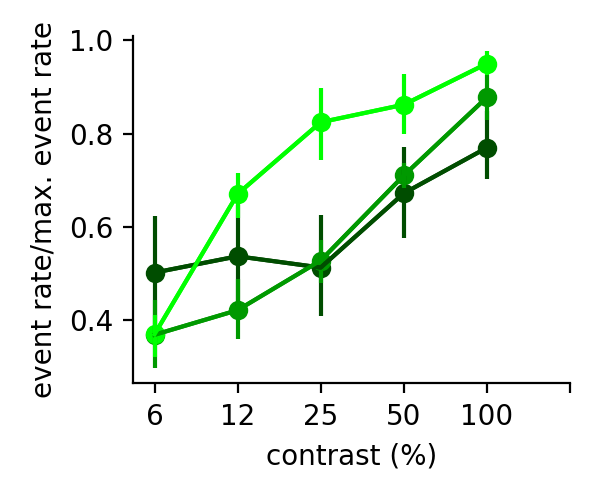

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9242101054146821


<IPython.core.display.Javascript object>


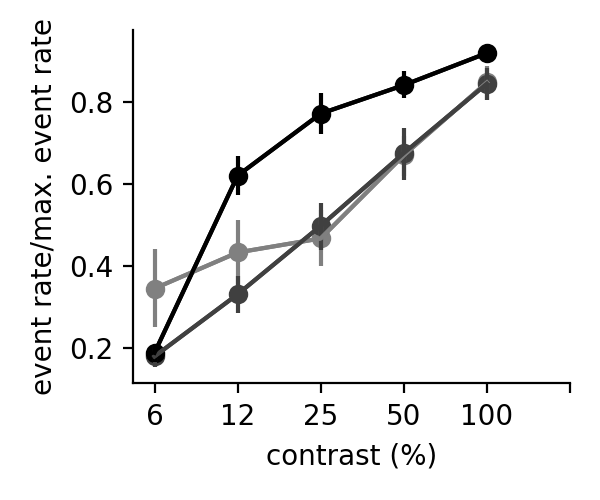

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9023823383079033


<IPython.core.display.Javascript object>


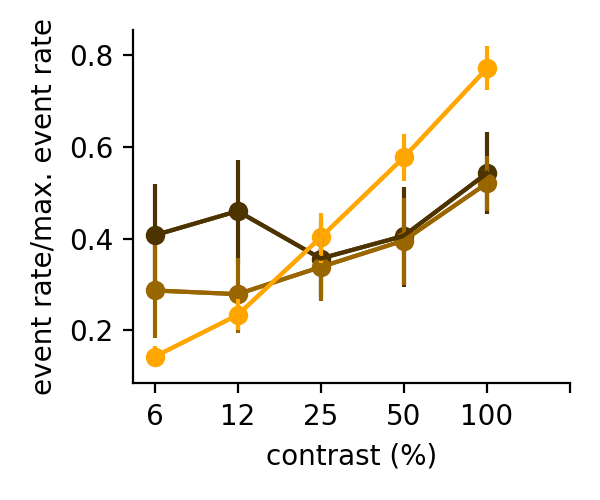

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7221084676440086


<IPython.core.display.Javascript object>


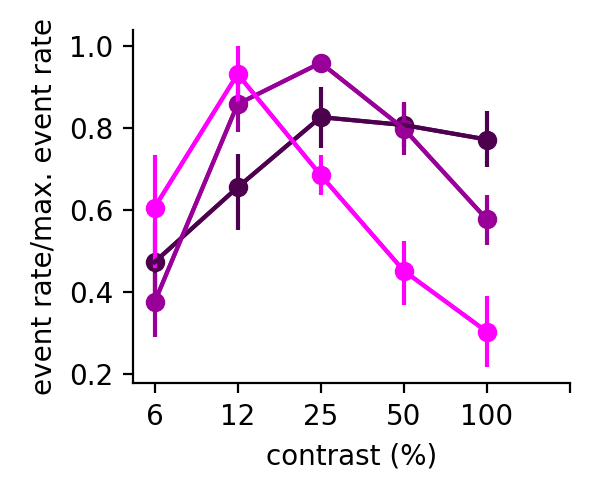

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.936608306101881


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


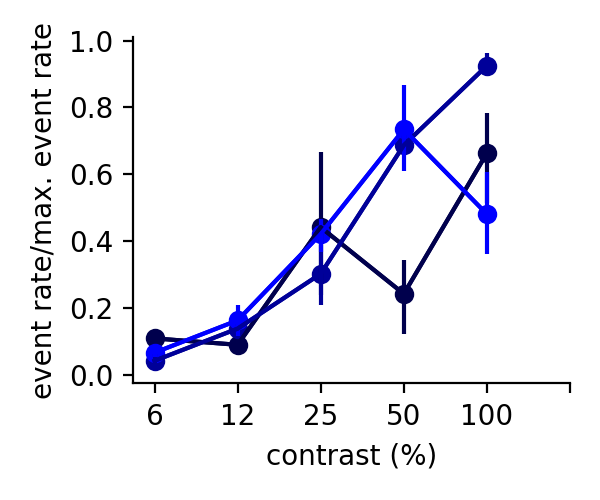

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8875746638697519


In [141]:
reload(ut)
ialign = 0
irun = 0
lbls = ['pc_l4','pc_l23','sst','vip','pv']
for ialign in range(2):
    for irun in range(2):
        for itype in [0,1,2,3,4]:#range(len(rsexpt)):
            plt.figure(figsize=(3,2.5))
            data = np.nanmean(rsexpt[irun][itype][ialign],-1)
            data = data/np.nanmax(data,axis=2)[:,:,np.newaxis]
        #     for icontrast in range(6):
            #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
            ut.plot_bootstrapped_errorbars_hillel(np.arange(cmax),data[:,[0,2,4],:cmax],pct=(16,84),colors=colors[itype])
            plt.xticks(np.arange(6),ucontrast[:cmax])
            #             plt.legend(['5$^o$','13$^o$','36$^o$'])
            plt.xlabel('contrast (%)')
            plt.ylabel('event rate/max. event rate')
            ut.erase_top_right()
            plt.tight_layout()
            plt.savefig('figures/%s_contrast_by_3_sizes_%s_%s_norm_to_max.eps'%(lbls[itype],running_lbls[irun],alignment_lbls[ialign]))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: invalid value encountered in true_divide
  # Remove the CWD from sys.path while we load stuff.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


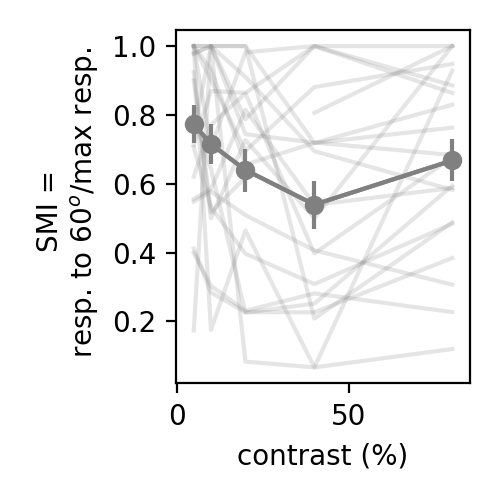

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially

0.7164073455115809


<IPython.core.display.Javascript object>


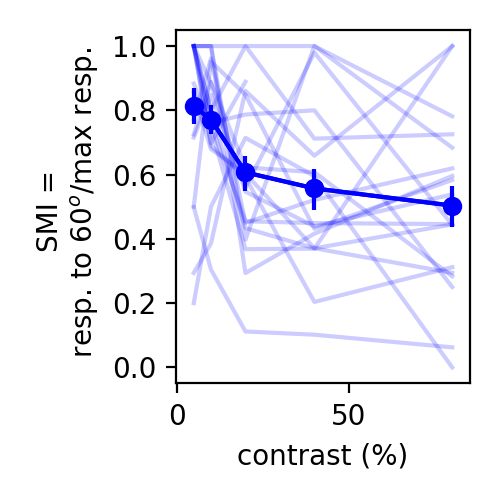

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.75517468365413


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

<IPython.core.display.Javascript object>


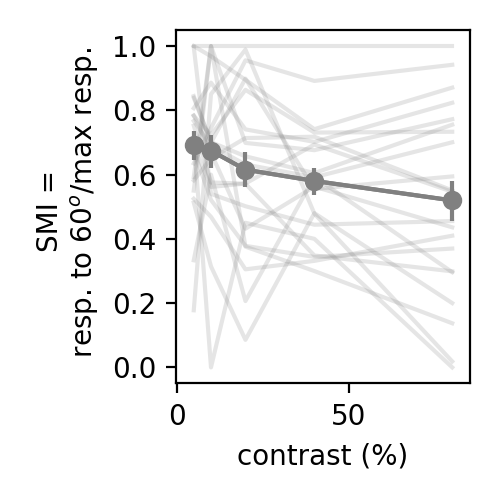

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.651380668372353


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

<IPython.core.display.Javascript object>


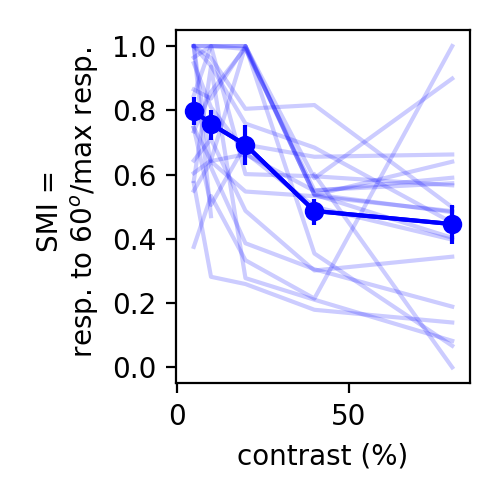

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.7545351075940296


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript back

In [947]:
# smimis = [None for irun in range(2)]
# p = [None for irun in range(2)]
# for irun in range(2):
#     smimis[irun] = [None for itype in range(2)]
#     p[irun] = [None for itype in range(2)]
#     for itype,data,c,lbl in zip([0,1],[rrs[irun],rfs[irun]],[c_l23,c_pv],['pc_l23','pv_l23']):
#         shp = data.shape
#         nexpt = shp[0]
#         nlight = shp[3]
#         smi_expt = data[:,-1,:,0]/np.nanmax(data[:,:,:,0],1)
#         plt.figure(figsize=(2.5,2.5))
#         ucontrast = [5,10,20,40,80]
#         plt.plot(ucontrast,smi_expt[:,1:].T,c=c,alpha=0.2)
#         ut.plot_bootstrapped_errorbars_hillel(ucontrast,smi_expt[:,np.newaxis,1:],colors=c[np.newaxis],pct=(16,84))
# #         plt.legend(['5%','20%','80%'])
# #         plt.xlabel('size ($^o$)')
#         plt.ylabel('SMI = \n resp. to 60$^o$/max resp.')
#         plt.xlabel('contrast (%)')
        
#         plt.tight_layout()
        
#         smimis[irun][itype] = smi_expt[:,1]-smi_expt[:,-1]
#         plt.savefig('figures/ephys_%s_c50_by_size_%s.eps'%(lbl,running_lbls[irun]))
#         _,p[irun][itype] = sst.wilcoxon(smi_expt[:,1],smi_expt[:,-1])

<IPython.core.display.Javascript object>


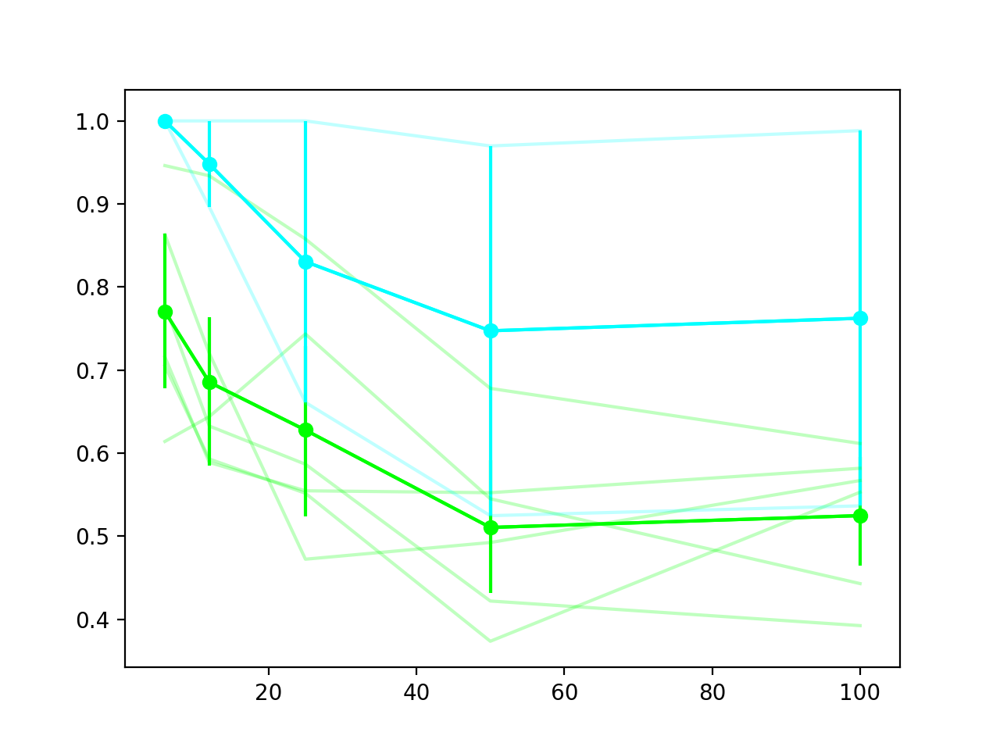

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.6762953043307107
1.0


In [1126]:
itype = 1
ialign = 0
plt.figure()
smi_expt = [None for irun in range(2)]
for irun in range(2):
    color = np.array((0,1,irun))
    data = np.nanmean(rsexpt[irun][itype][ialign],-1)
    smi_expt[irun] = data[:,-1,:]/np.nanmax(data[:,:,:],1)
    plt.plot(ucontrast[1:],smi_expt[irun][:,1:].T,c=color,alpha=0.25)
    ut.plot_bootstrapped_errorbars_hillel(ucontrast[1:],smi_expt[irun][:,np.newaxis,1:],colors=color[np.newaxis])


In [1127]:
smi_expt = np.concatenate([smi_run[np.newaxis] for smi_run in smi_expt],axis=0)

ValueError: all the input array dimensions for the concatenation axis must match exactly, but along dimension 1, the array at index 0 has size 12 and the array at index 1 has size 10

<IPython.core.display.Javascript object>


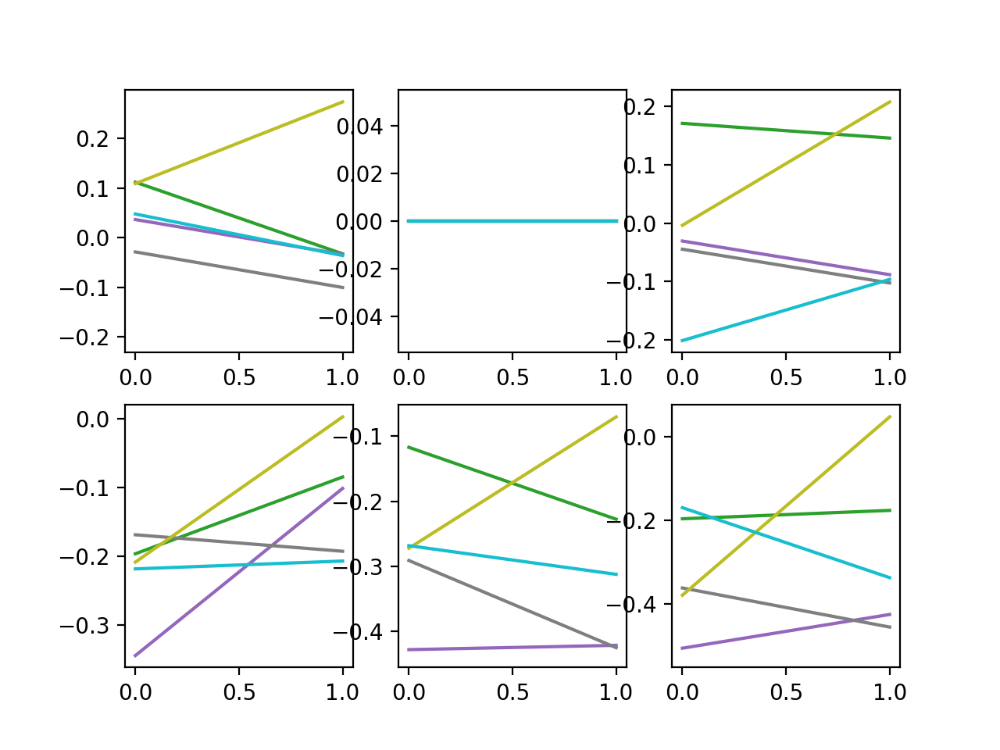

In [1123]:
plt.figure()
for icontrast in range(6):
    plt.subplot(2,3,icontrast+1)
    plt.plot(smi_expt[:,:,icontrast]-smi_expt[:,:,1])

<IPython.core.display.Javascript object>


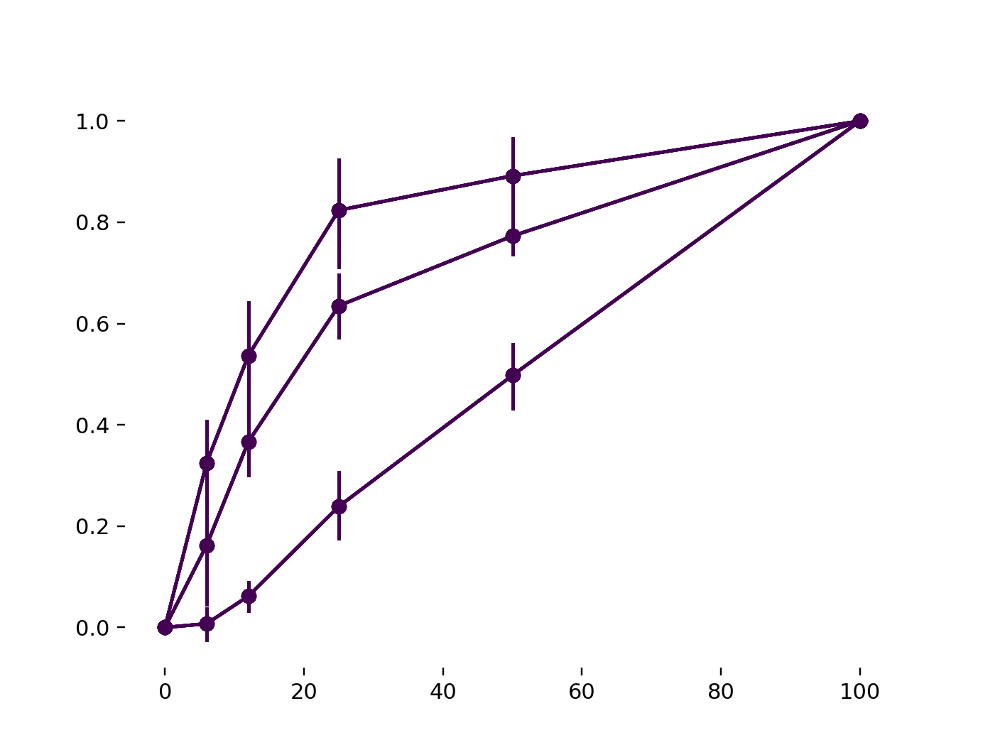

In [173]:
reload(ut)
ialign = 0
plt.figure()
for itype in [1,2,4]:
#     plt.figure()
    data = np.nanmean(rsexpt[itype][ialign],-1)
    data = data = (data-data[:,:,0][:,:,np.newaxis])/(data[:,:,-1][:,:,np.newaxis]-data[:,:,0][:,:,np.newaxis])
    for icontrast in range(6):
    #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
        ut.plot_bootstrapped_errorbars_hillel([0,6,12,25,50,100],data[:,2:3,:],pct=(16,84))

In [36]:
np.save('rs_ori_no_pval_criterion_200204.npy',rs,allow_pickle=True)

In [13]:
# rsdict = np.load('../opto1p/rsdict_ca_200128.npy',allow_pickle=True)[()]


In [15]:
# rs = rsdict['rsdict']['size_contrast_0'].copy() #['size_contrast_0']

In [30]:
# reload(utils)
# rs_fg = utils.gen_rs_modal_uparam(dsnames=dsnames,selection=selection,running=False,modal_uparam=modal_uparam_fg,expttype='figure_ground_0',pval_cutoff=1.1)

In [32]:
# rs = np.load('rs_no_pval_criterion_200118.npy',allow_pickle=True)[()] #,{'rs':rs,'rs_fg':rs_fg})

In [30]:
# rs = np.load('rs_ori_no_pval_criterion_200204.npy',allow_pickle=True)

In [184]:
ndir = 8

In [185]:
angles = np.arange(ndir)/ndir*2*np.pi
def von_mises_denoise(tuning_curves):
    vm_bounds = ((0,0,0,-np.pi/8),(np.inf,np.inf,1,np.pi/8))
    nparams = 4
    nrois = tuning_curves.shape[0]
    popt = np.zeros((nrois,nsize,ncontrast,nparams))
    tuning_von_mises = np.zeros_like(tuning_curves)
    for iroi in range(nrois):
        for isize in range(nsize):
            for icontrast in range(ncontrast):
                if icontrast==0:
                    fit_fn = von_mises_fn
                else:
                    fit_fn = flat_fn
                try:
#                 for zzz in (1,):
                    data = tuning_curves[iroi,isize,icontrast].copy()
                    angles_to_use = angles[~np.isnan(data)]
                    if angles_to_use.size:
                        popt[iroi,isize,icontrast],_ = sop.curve_fit(von_mises_fn,angles_to_use,data,bounds=vm_bounds)
                        tuning_von_mises[iroi,isize,icontrast] = von_mises_fn(angles,*popt[iroi,isize,icontrast])
                    else:
                        tuning_von_mises[iroi,isize,icontrast] = tuning_curves[iroi,isize,icontrast]
                except:
                    print('could not do (%d,%d,%d)'%(iroi,isize,icontrast))
                    tuning_von_mises[iroi,isize,icontrast] = tuning_curves[iroi,isize,icontrast]
    return tuning_von_mises

In [186]:
def von_mises_fn(x,A,kappa,b,mu):
    return A*(np.exp(kappa*np.cos(x-mu))+b*np.exp(kappa*np.cos(x-np.pi-mu)))/ssp.iv(0,kappa)/2/np.pi/(1+b)
def flat_fn(x,A,kappa,b,mu):
    return A*np.ones_like(x)

In [190]:
irun = 0
this_rs = rs[irun]
rs_denoise = [None for this_r in this_rs]
for ir in range(len(this_rs)):
    print(ir)
    rs_denoise[ir] = [None for iS in range(len(this_rs[ir]))]
    if not this_rs[ir] is None:
        for iS in range(len(this_rs[ir])):
            rs_denoise[ir][iS] = von_mises_denoise(this_rs[ir][iS])

0
1
2
3
could not do (4,4,1)
4


In [204]:
rs[0][4][0].shape

(7, 6, 6, 8)

In [187]:
# rs_denoise = [None for this_r in rs]
# for ir in range(len(rs)):
#     print(ir)
#     rs_denoise[ir] = [None for iS in range(len(rs[ir]))]
#     if not rs[ir] is None:
#         for iS in range(len(rs[ir])):
#             rs_denoise[ir][iS] = von_mises_denoise(rs[ir][iS])

0


AttributeError: 'list' object has no attribute 'shape'

<IPython.core.display.Javascript object>


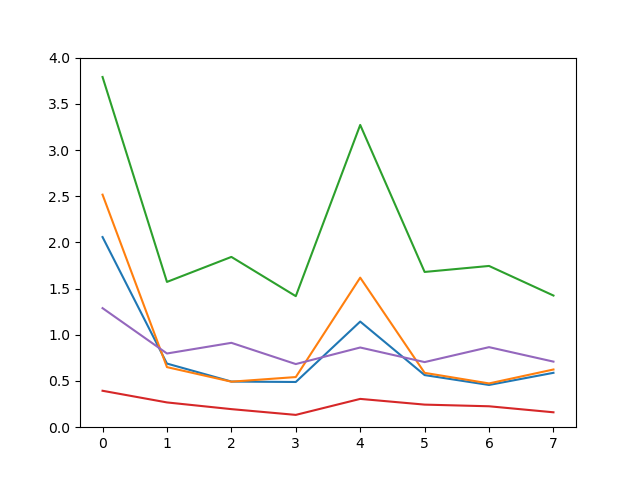

(0, 4)

In [3]:
npyfile = np.load('rs_200828.npy',allow_pickle=True)[()]
plt.figure()
for itype in range(5):
#     plt.plot(np.nanmean(np.nanmean(np.nanmean(npyfile['rs'][itype][0],0),0),0))
    plt.plot(np.nanmean(npyfile['rs'][itype][0],0)[-1,-1])
plt.ylim((0,4))

In [46]:
np.save('rs_vm_denoise_200605.npy',{'rs':rs,'rs_denoise':rs_denoise},allow_pickle=True)

In [340]:
npyfile1 = np.load('rs_vm_denoise_200605.npy',allow_pickle=True)[()]#,{'rs':rs,'rs_denoise':rs_denoise},allow_pickle=True)
# rs = npyfile['rs']
# rs_denoise = npyfile['rs_denoise']

In [341]:
npyfile2 = np.load('rs_200828.npy',allow_pickle=True)[()]#,{'rs':rs,'rs_denoise':rs_denoise},allow_pickle=True)

In [347]:
for itype in range(5):
    print(npyfile1['rs'][itype][0].shape)
    print(npyfile2['rs'][itype][0].shape)

(7599, 6, 6, 8)
(7599, 6, 6, 8)
(6220, 6, 6, 8)
(8870, 6, 6, 8)
(294, 6, 6, 8)
(348, 6, 6, 8)
(771, 6, 6, 8)
(807, 6, 6, 8)
(143, 6, 6, 8)
(204, 6, 6, 8)


(807, 6, 6, 8)

In [309]:
npyfile = np.load('/Users/dan/Documents/code/adesnal/XXYYhat.npy',allow_pickle=True)[()]

In [310]:
npyfile.keys()

dict_keys(['YYhat', 'XXhat', 'rs', 'Rs', 'Rso', 'Ypc_list', 'Xpc_list'])

In [311]:
npyfile['rs'][1][0].shape

(8870, 6, 6, 8)

In [314]:
npyfile['rs'][1][0].shape

(8870, 6, 6, 8)

In [318]:
npyfile['Rs'][1][0].shape

(8870, 288)

In [321]:
def sum_to_1(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nansum(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

In [334]:
Rstemp = sum_to_1(npyfile['rs'][1][0])
r = npyfile['rs'][1][0]
R = r.reshape((r.shape[0],-1))
sm = np.nansum(R[:,~np.isnan(R.sum(0))],axis=1)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: divide by zero encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in true_divide
  This is separate from the ipykernel package so we can avoid doing imports until


In [338]:
~np.isnan(R.sum(0))

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,  True,  True,  True,
        True,  True,  True,  True,  True, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False,

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


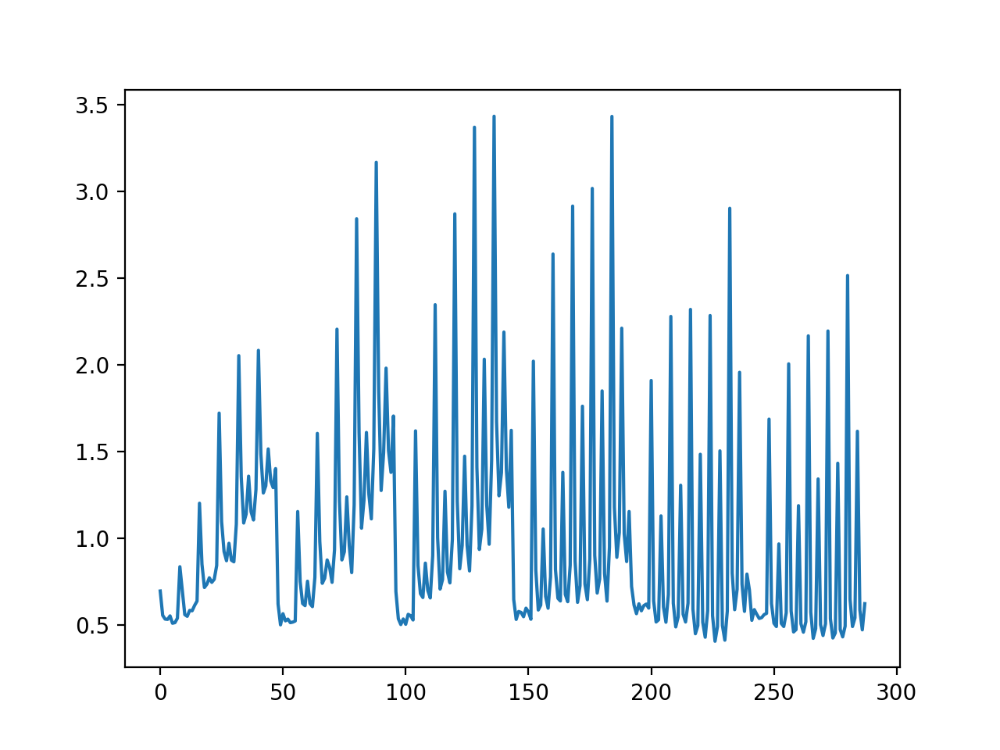

In [336]:
plt.figure()
plt.plot(np.nanmean(R,0))

In [327]:
npyfile['rs'][1][0].shape

(8870, 6, 6, 8)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


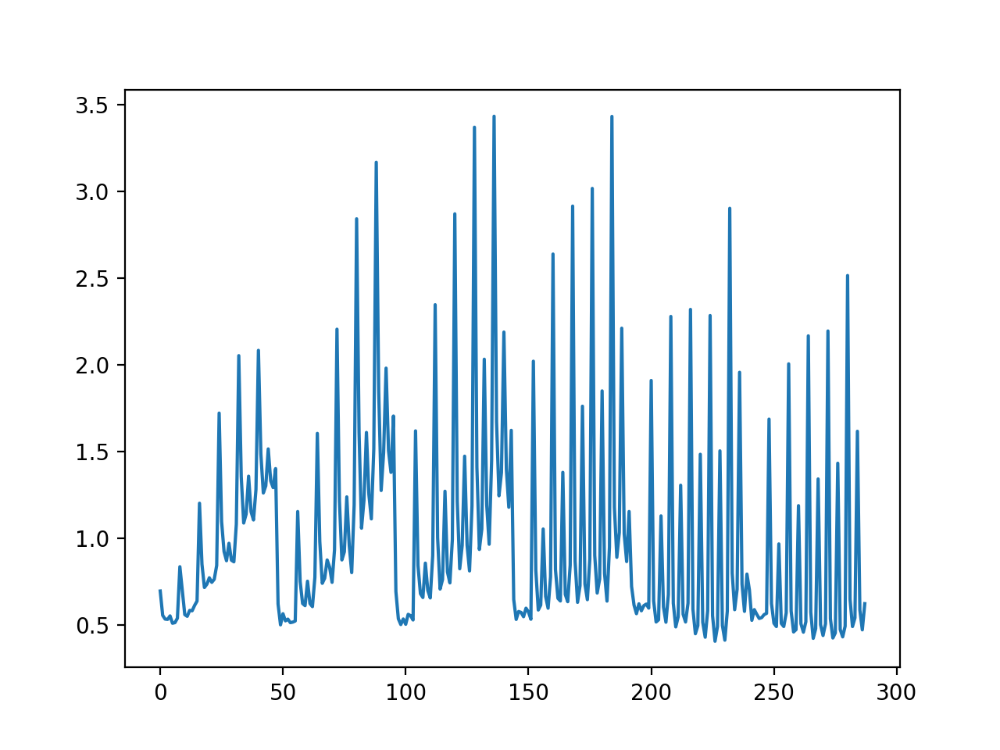

In [328]:
plt.figure()
plt.plot(np.nanmean(npyfile['rs'][1][0],0).flatten())

In [320]:
np.nanmean(npyfile['rs'][1][0],0)

array([       inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf, 0.18317497,
       0.1264855 , 0.11430221, 0.11184181, 0.12197771, 0.10781453,
       0.10969436, 0.12470892,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        inf,
              inf,        inf,        inf,        inf,        

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


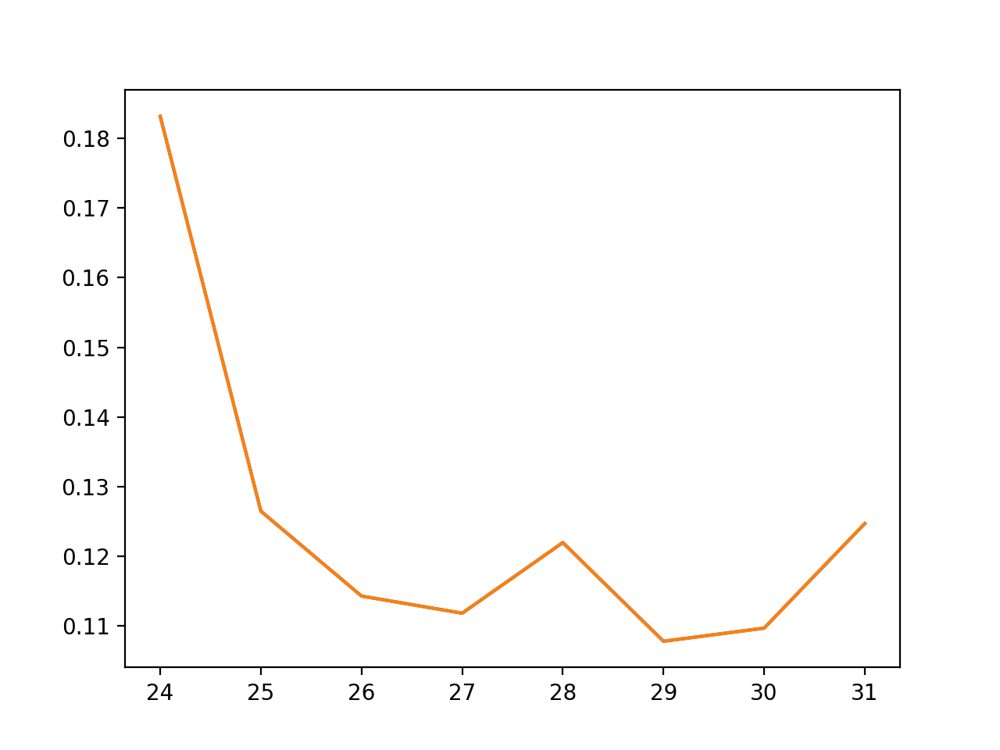

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/numpy/core/fromnumeric.py:90: RuntimeWarning: invalid value encountered in reduce
  return ufunc.reduce(obj, axis, dtype, out, **passkwargs)


In [319]:
plt.figure()
plt.plot(np.nanmean(npyfile['Rs'][1][0],0))
# plt.plot(np.nanmean(npyfile['rs'][1][0],0).flatten())

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


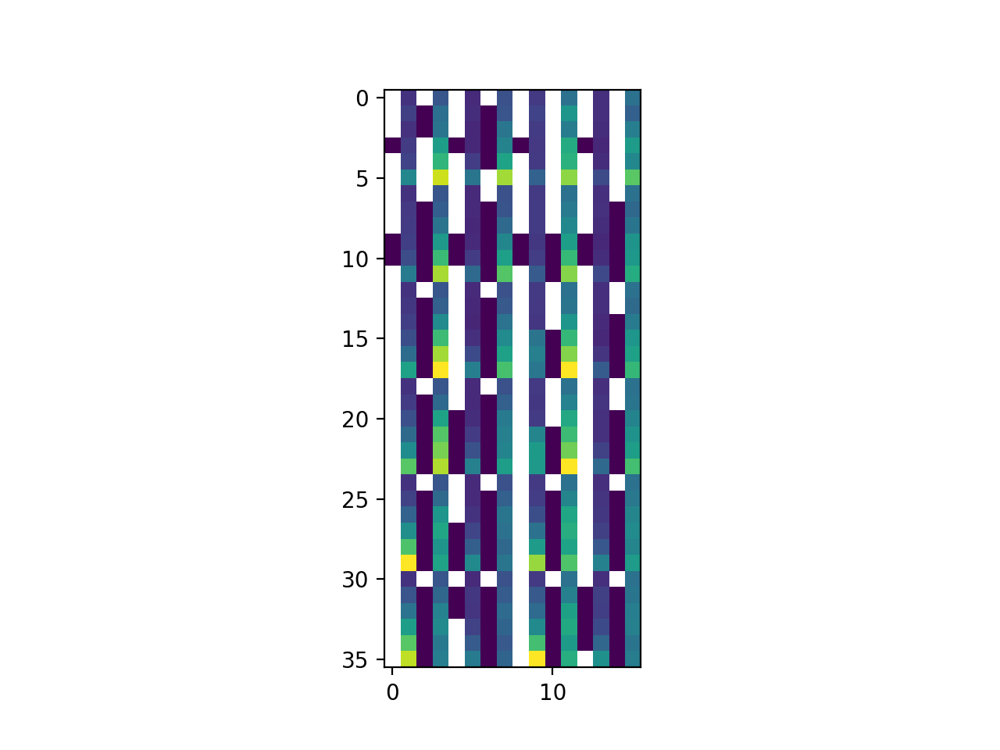

In [296]:
plt.figure()
plt.imshow(npyfile['YYhat'])

In [287]:
npyfile['Ypc_list'][0][0][0]

[(309.98992193787313,
  array([-0.00343268, -0.00832645, -0.026418  , -0.06290365, -0.0819909 ,
         -0.083286  , -0.00343268, -0.00979735, -0.02953743, -0.06191439,
         -0.09744259, -0.11176189, -0.00343268, -0.01974729, -0.06114367,
         -0.11152962, -0.16895697, -0.19086215, -0.00343268, -0.04071966,
         -0.12034316, -0.19981386, -0.26632169, -0.28970011, -0.00343268,
         -0.0613479 , -0.17084521, -0.26191368, -0.31506038, -0.35096541,
         -0.00343268, -0.06741059, -0.18217164, -0.26834004, -0.3177482 ,
         -0.35721927])),
 (238.63346432573113,
  array([-0.00600984, -0.03451351, -0.10628504, -0.25065929, -0.35333746,
         -0.36999862, -0.00600984, -0.02838594, -0.09270619, -0.20022854,
         -0.31815314, -0.37337929, -0.00600984, -0.0338986 , -0.09742144,
         -0.1727782 , -0.25157819, -0.29210311, -0.00600984, -0.01310518,
         -0.02439971, -0.03270625, -0.04769696, -0.0659311 , -0.00600984,
          0.01611297,  0.06355225,  0.10733

In [283]:
npyfile['YYhat'].max(0)

array([1.        , 1.        , 1.        , 1.        , 0.47599734,
       0.48830661, 0.74651386, 0.88440312, 1.        , 1.        ,
       1.        , 1.        , 0.4756902 , 0.5379967 , 0.72910494,
       0.76542587])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


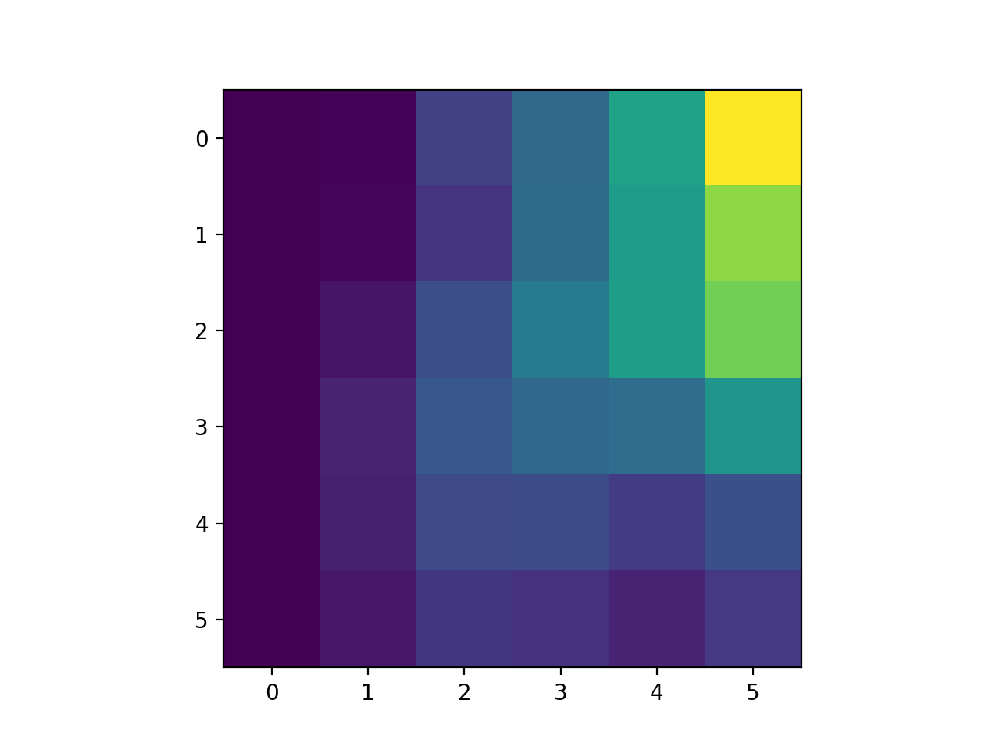

In [276]:
plt.figure()
plt.imshow(npyfile['YYhat'][:,7].reshape((6,6)))

In [60]:
nsize,ncontrast,ndir = 5,6,8
ori_dirs = [[0,4],[2,6]] #[[0,4],[1,3,5,7],[2,6]]
nT = len(ori_dirs)
nS = len(rs_denoise[0])

def sum_to_1(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nansum(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

def norm_to_mean(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nanmean(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

Rs = [[None,None] for i in range(len(rs))]
Rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]
rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]

for iR,r in enumerate(rs_denoise):
    print(iR)
    for ialign in range(nS):
        Rs[iR][ialign] = sum_to_1(r[ialign][:,:nsize,:])
#         Rs[iR][ialign] = von_mises_denoise(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir)))



for iR,r in enumerate(rs):
    for ialign in range(nS):
        for iori in range(nT):
            Rso[iR][ialign][iori] = np.nanmean(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir))[:,:,:,ori_dirs[iori]],-1)
            Rso[iR][ialign][iori] = Rso[iR][ialign][iori].reshape(Rso[iR][ialign][iori].shape[0],-1)

0
1
2
3
4


In [61]:
len(Rso[0][0])

2

In [62]:
import sklearn.neighbors as skn
def interp_k_nearest_neighbors(arr,svd_reduced=None,k=5):
    if svd_reduced is None:
        svd_reduced = arr[:,~np.isnan(arr.sum(0))]
    nn = skn.NearestNeighbors(n_neighbors=k).fit(svd_reduced)
    if not svd_reduced is None and (svd_reduced.shape[1]>0):
        to_interpolate = np.isnan(arr.sum(1))
        for irow,row in enumerate(arr):
            if to_interpolate[irow]:
                lkat = ~np.isnan(row)
        arr_norm = arr[:,lkat]/arr[:,lkat].sum(1)[:,np.newaxis]

In [18]:
icelltype = 0
ialign = 0
to_show = Rs[icelltype][ialign].reshape((-1,nsize,ncontrast,8))

In [19]:
np.argmax(to_show.max(1).max(1).max(1))

1319

In [23]:
rs_denoise[0][0].shape

(7599, 6, 6, 8)

<IPython.core.display.Javascript object>


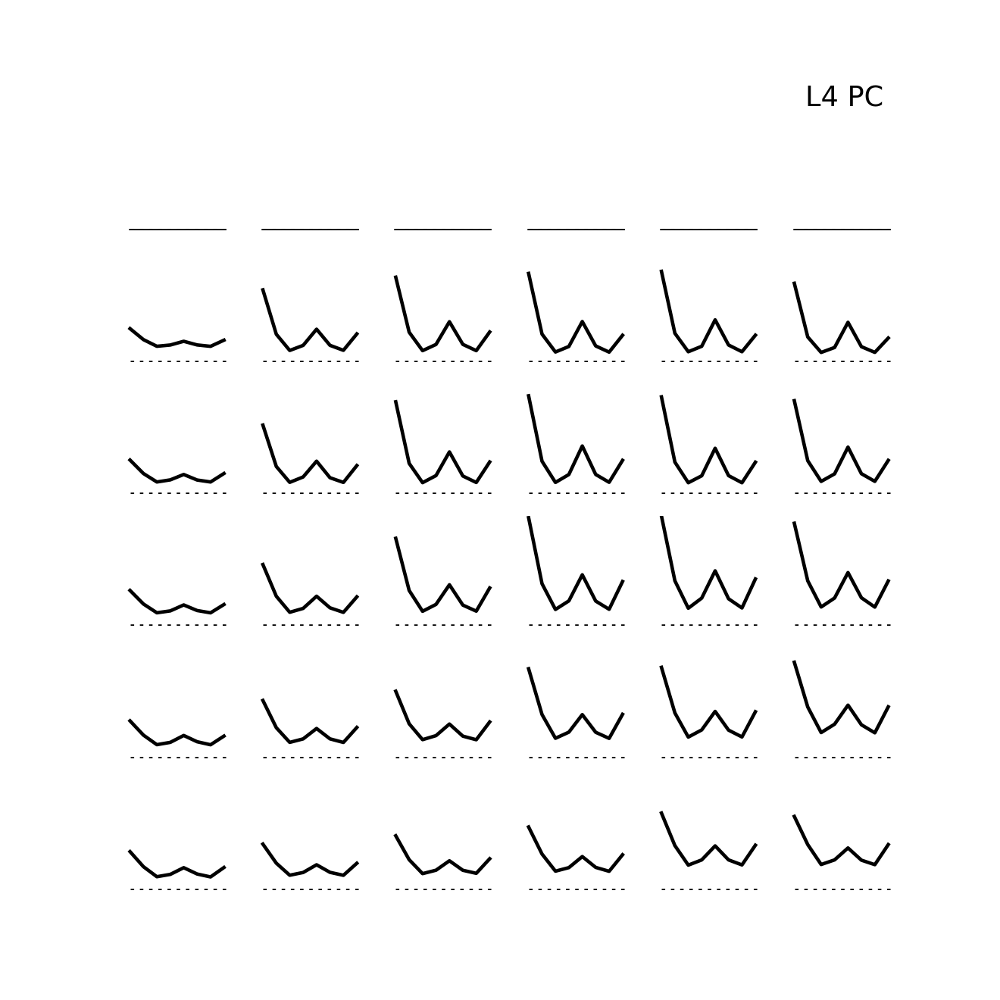

<IPython.core.display.Javascript object>


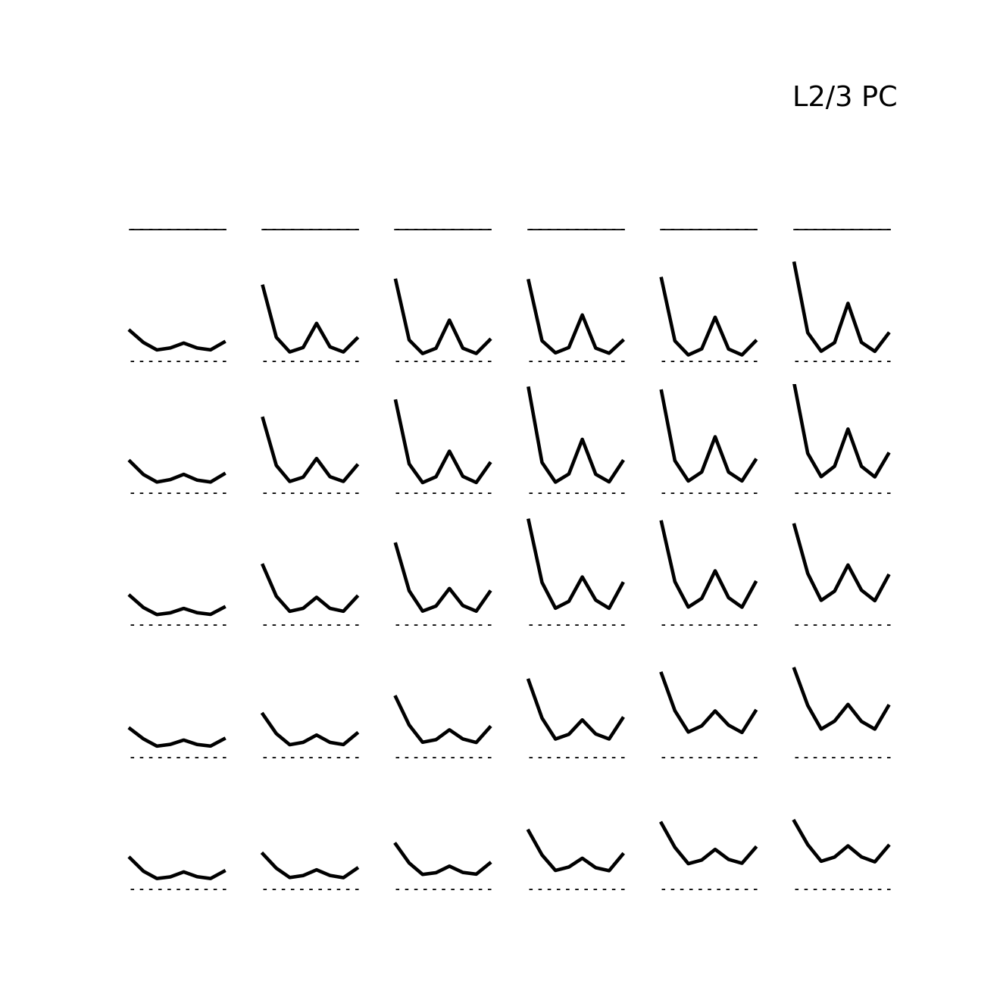

<IPython.core.display.Javascript object>


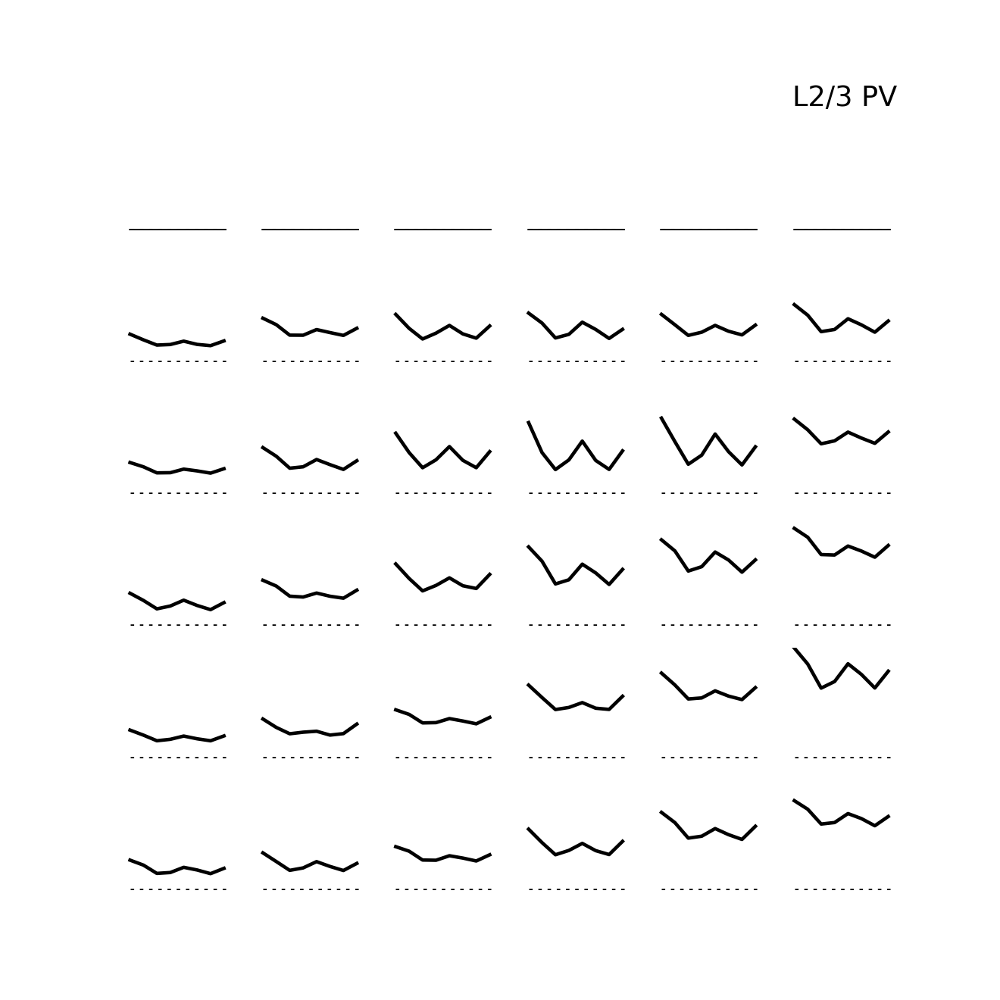

<IPython.core.display.Javascript object>


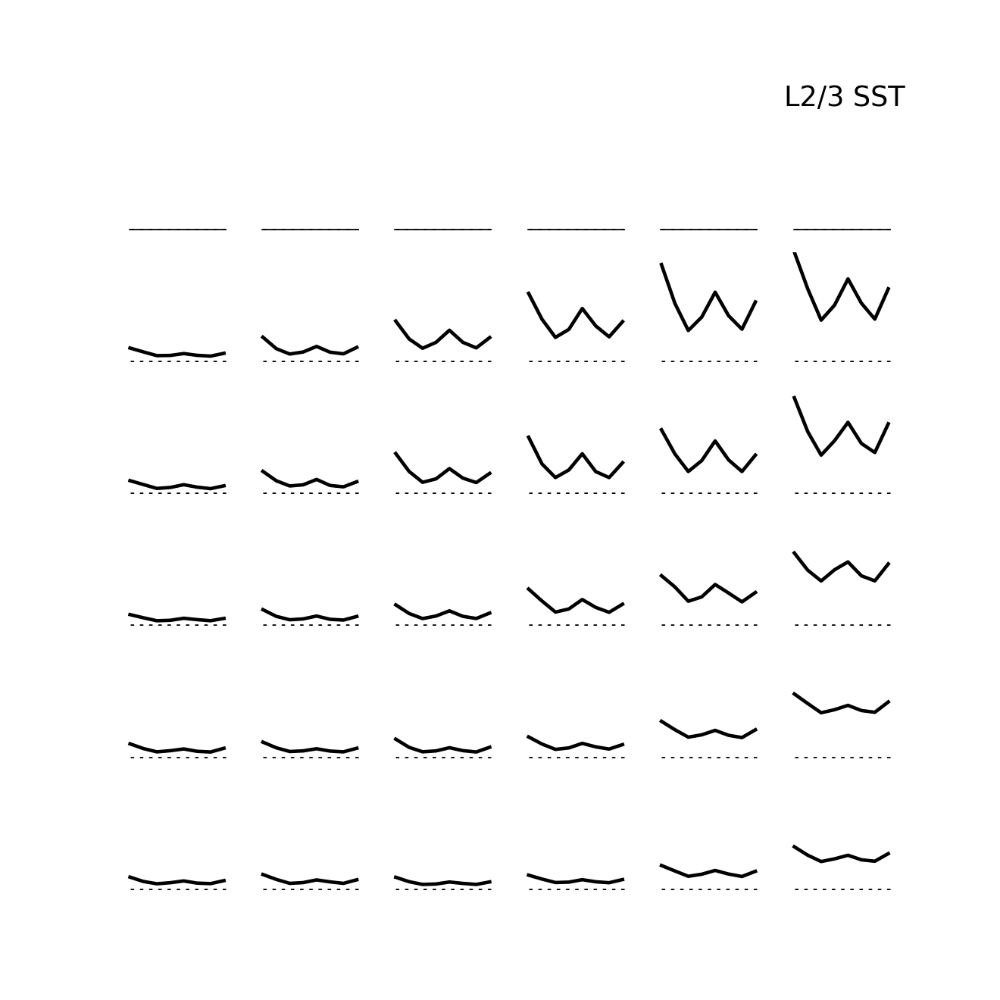

<IPython.core.display.Javascript object>


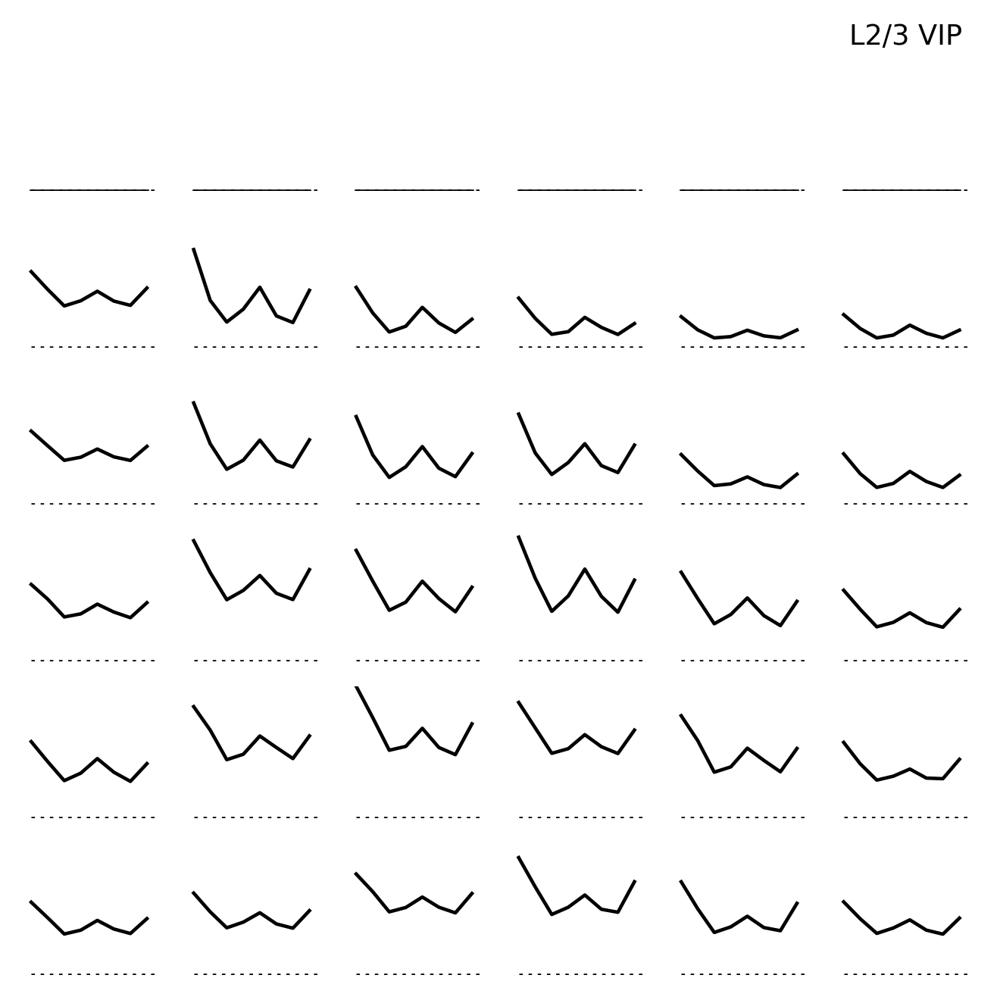

<IPython.core.display.Javascript object>


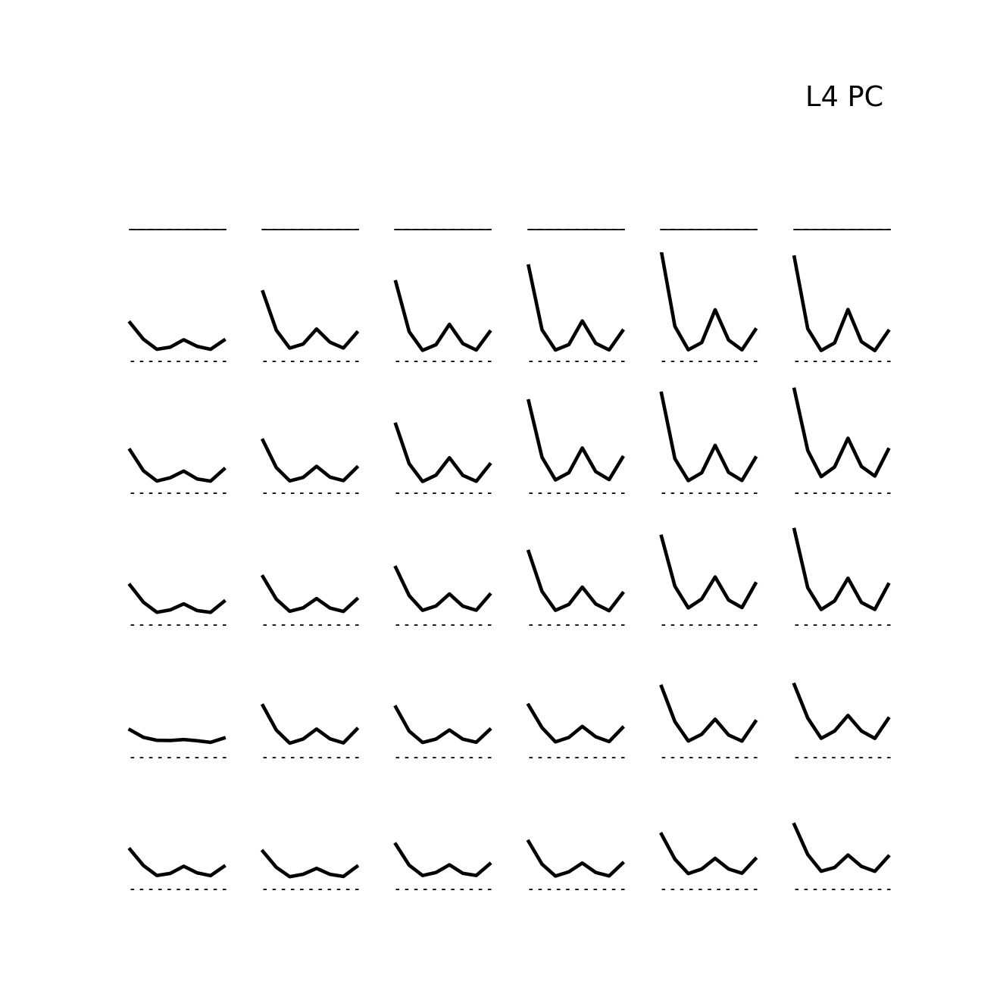

<IPython.core.display.Javascript object>


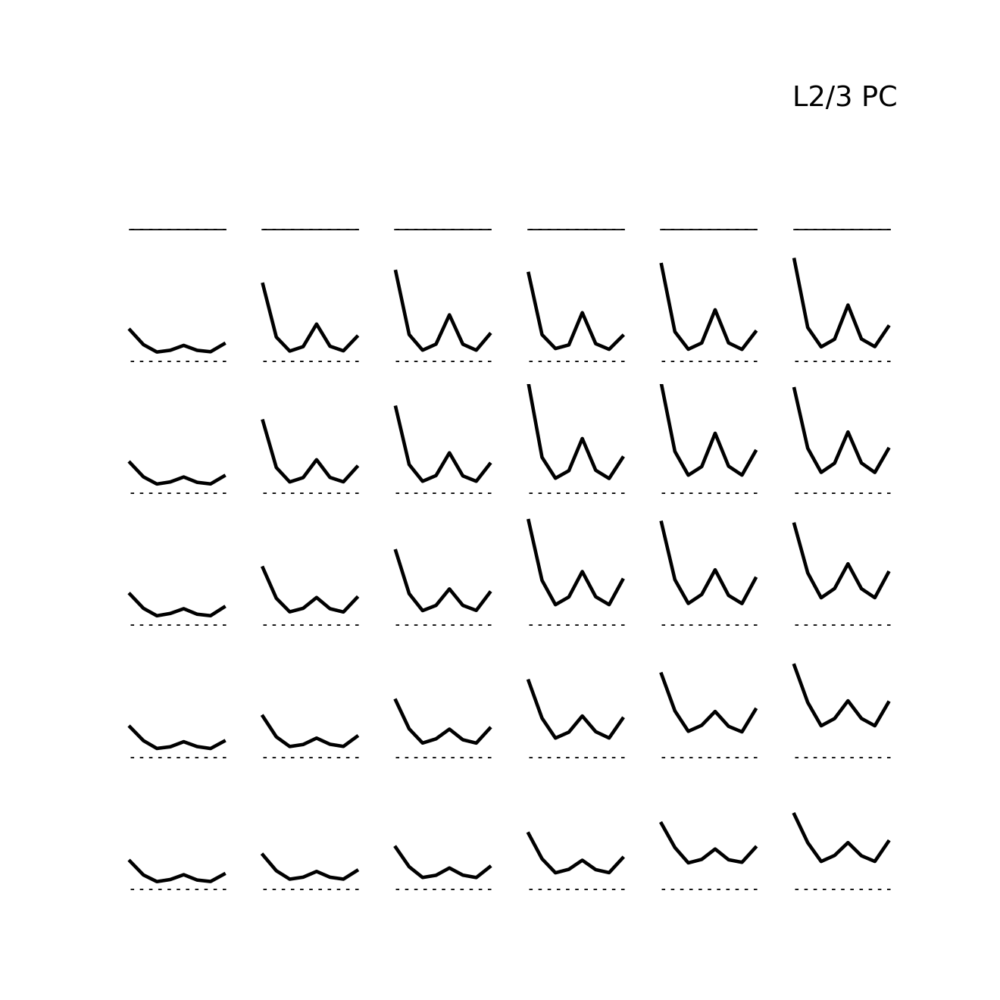

<IPython.core.display.Javascript object>


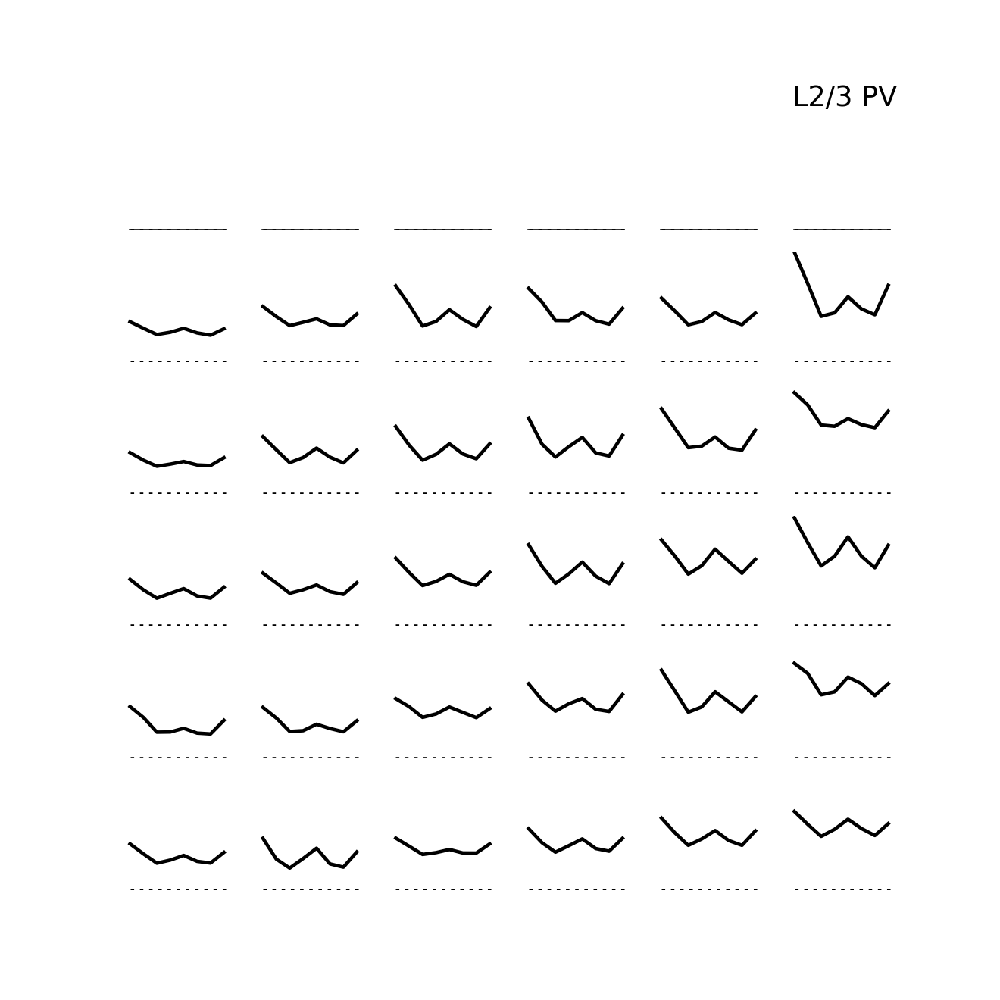

<IPython.core.display.Javascript object>


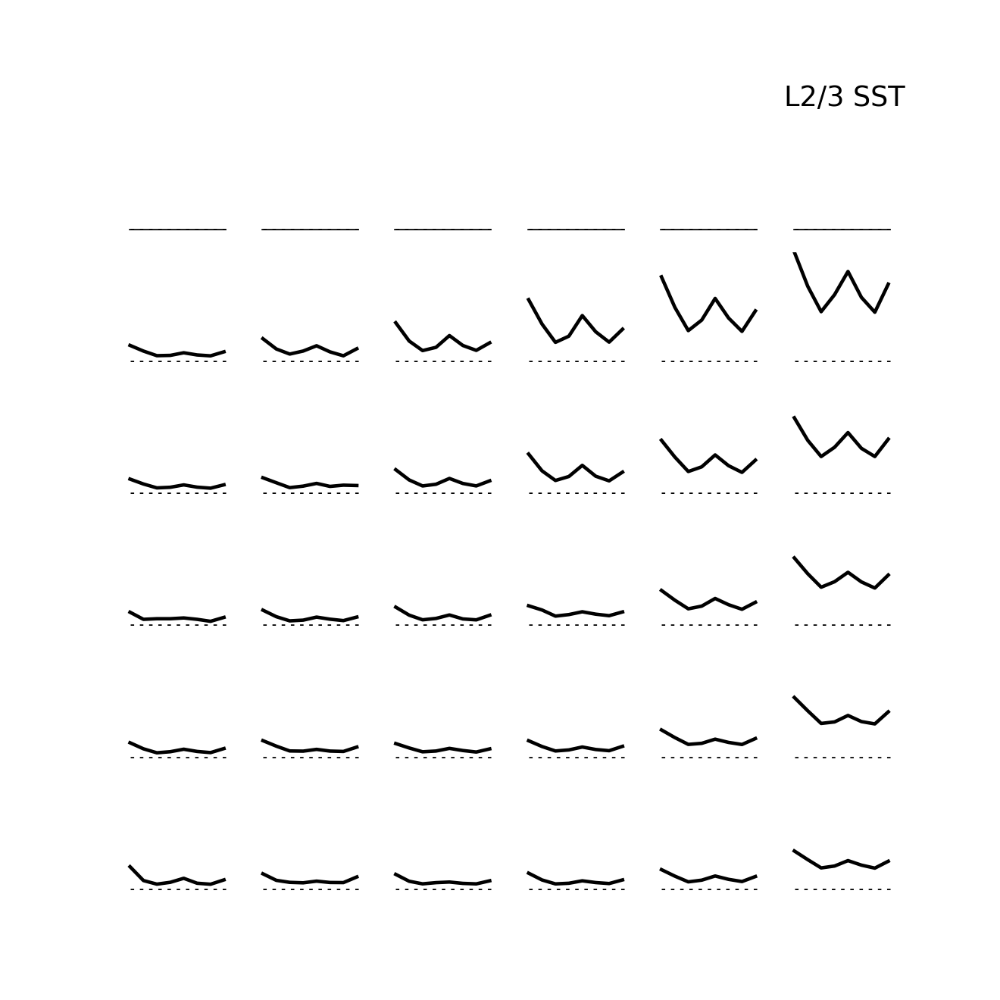

<IPython.core.display.Javascript object>


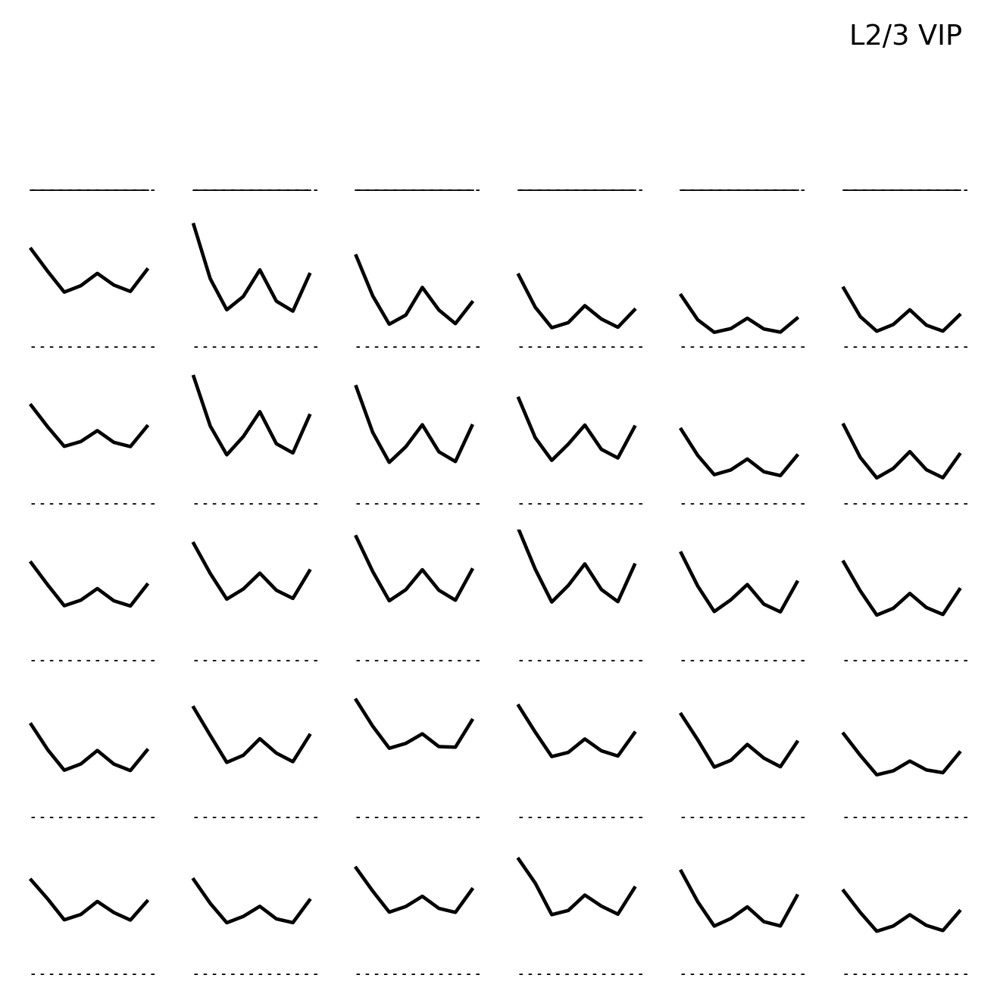

In [48]:
import opto_utils
reload(opto_utils)
ucontrast = [str(c) for c in np.array((0,6,12,25,50,100))]
usize = [str(s) for s in (5,8,13,22,36,60)]
nsize,ncontrast = 6,6
celltypes = ['L4 PC', 'L2/3 PC', 'L2/3 SST', 'L2/3 VIP', 'L2/3 PV']
ntypes = len(celltypes)
# aligntypes = ['RF distance <10$^o$']
saveas = ['figures/five_cell_types_aligned_2d.jpg','figures/five_cell_types_misaligned_2d.jpg']
mag = 3
for ialign in range(2):
#     plt.figure(figsize=(4*mag,mag))
    for iicelltype,icelltype in enumerate([0,1,4,2,3]):
#         plt.subplot(1,ntypes,iicelltype+1)
        if not rs[icelltype][ialign] is None:
            to_show = rs_denoise[icelltype][ialign].reshape((-1,nsize,ncontrast,8))
            opto_utils.plot_size_contrast_ori_light(to_show)
#             sca.show_size_contrast(to_show,flipud=True,usize=[5,8,13,22,36,60],vmin=0,vmax=np.nanmax(to_show))
        plt.title(celltypes[icelltype])
    plt.tight_layout()
#     plt.savefig(saveas[ialign],dpi=300)

In [17]:
# mag = 2.5
# colors = ['g','k','C1','m','b']
# plt.figure(figsize=(mag*len(usize),mag))
# for icelltype in [1,4]:
#     mn,lb,ub = ut.bootstrap(Rs[icelltype][0].reshape((-1,len(usize),len(ucontrast))),fn=np.nanmean,axis=0,pct=(50,2.5,97.5))
#     for isize in range(len(usize)):
#         plt.subplot(1,len(usize),isize+1)
#         plt.errorbar([int(u) for u in ucontrast],mn[isize],yerr=(mn[isize]-lb[isize],ub[isize]-mn[isize]),c=colors[icelltype])
#         plt.ylim(0,0.06)
#         plt.tight_layout()
#         plt.title(usize[isize]+'$^o$ size')
#     plt.subplot(1,len(usize),1)
#     plt.xlabel('contrast (%)')
#     plt.ylabel('activity (a.u.)')
#     plt.legend(['L2/3 PC','L2/3 PV'])
# # plt.savefig('figures/pc_pv_contrast_tuning.jpg',dpi=300)

In [17]:
# mag = 2.5
# colors = ['g','k','C1','m','b']
# plt.figure(figsize=(mag*len(usize),mag))
# for icelltype in [2,3]:
#     mn,lb,ub = ut.bootstrap(Rs[icelltype][0].reshape((-1,len(usize),len(ucontrast))),fn=np.nanmean,axis=0,pct=(50,2.5,97.5))
#     for isize in range(len(usize)):
#         plt.subplot(1,len(usize),isize+1)
#         plt.errorbar([int(u) for u in ucontrast],mn[isize],yerr=(mn[isize]-lb[isize],ub[isize]-mn[isize]),c=colors[icelltype])
#         plt.ylim(0,0.1)
#         plt.tight_layout()
#         plt.title(usize[isize]+'$^o$ size')
#     plt.subplot(1,len(usize),1)
#     plt.xlabel('contrast (%)')
#     plt.ylabel('activity (a.u.)')
#     plt.legend(['L2/3 SST','L2/3 VIP'])
# plt.savefig('figures/vip_sst_contrast_tuning.jpg',dpi=300)

In [18]:
# mag = 2.5
# colors = ['g','k','C1','m','b']
# plt.figure(figsize=(mag*len(usize),mag))
# for icelltype in [1,2]:
#     mn,lb,ub = ut.bootstrap(Rs[icelltype][0].reshape((-1,len(usize),len(ucontrast))),fn=np.nanmean,axis=0,pct=(50,2.5,97.5))
#     for isize in range(len(usize)):
#         plt.subplot(1,len(usize),isize+1)
#         plt.errorbar([int(u) for u in ucontrast],mn[isize],yerr=(mn[isize]-lb[isize],ub[isize]-mn[isize]),c=colors[icelltype])
#         plt.ylim(0,0.1)
#         plt.tight_layout()
#         plt.title(usize[isize]+'$^o$ size')
#     plt.subplot(1,len(usize),1)
#     plt.xlabel('contrast (%)')
#     plt.ylabel('activity (a.u.)')
#     plt.legend(['L2/3 SST','L2/3 VIP'])
# # plt.savefig('figures/pc_sst_contrast_tuning.jpg',dpi=300)

In [19]:
plt.close('all')

In [20]:
# import numpy as np
# import matplotlib.pyplot as plt
# import matplotlib.colors as mcolors
# # This import registers the 3D projection, but is otherwise unused.
# from mpl_toolkits.mplot3d import Axes3D  # noqa: F401 unused import


# # setup the figure and axes
# mag = 3
# _x = np.arange(6)
# _y = np.arange(6)
# _xx, _yy = np.meshgrid(_x, _y)
# x, y = _xx.ravel(), _yy.ravel()
# saveas = ['figures/five_cell_types_aligned_3d.jpg','figures/five_cell_types_misaligned_3d.jpg']
# for ialign in range(2):
#     fig = plt.figure(figsize=(5*mag, mag))
#     for icelltype in range(5):
#         ax1 = fig.add_subplot(150+icelltype+1, projection='3d')
#         # ax2 = fig.add_subplot(122, projection='3d')

#         top = np.nanmean(Rs[icelltype][ialign],0) #x + y
#         bottom = np.zeros_like(top)
#         width = depth = 1
#         norm = mcolors.Normalize(0, top.max())
#         colors = plt.cm.viridis(norm(top.tolist()))
#         ax1.bar3d(x, y, bottom, width, depth, top, shade=True,color=colors)
#         ax1.view_init(45,225)
#         ax1.set_title(celltypes[icelltype])
#         plt.xlabel('contrast (%)')
#         plt.xticks(np.arange(6),[0,6,12,25,50,100])
#         plt.ylabel('size ($^o$)')
#         plt.yticks(np.arange(6),[5,8,13,22,36,60])


#         # ax2.bar3d(x, y, bottom, width, depth, top, shade=False)
#         # ax2.set_title('Not Shaded')
#     plt.show()
#     plt.tight_layout()
# #     plt.savefig(saveas[ialign],dpi=300)

In [51]:
# reload(sca)
# labels = ['L4 PC','L2/3 PC','L2/3 SST','L2/3 VIP','L2/3 PV']
# def plot_weak_strong(ix,iy,ialign):
#     strong = np.zeros((6,6),dtype='bool')
#     for i in range(6):
#         strong[i] = np.arange(6)>=6-i
#     strong = strong.flatten()
#     ptx = np.nanmean(Rs[ix][ialign],0)
#     pty = np.nanmean(Rs[iy][ialign],0)
#     for these in [~strong,strong]:
#         plt.scatter(ptx[these],pty[these])
#     plt.axis('equal')
#     plt.xlabel('%s activity (a.u.)' %labels[ix])
#     plt.ylabel('%s activity (a.u.)' %labels[iy])
# def scatter_size_contrast_(ix,iy,ialign):
#     ptx = np.nanmean(Rs[ix][ialign],0)
#     pty = np.nanmean(Rs[iy][ialign],0)
#     sca.scatter_size_contrast(np.nanmean(Rs[ix][ialign],0),np.nanmean(Rs[iy][ialign],0),nsize=6,ncontrast=6,equality_line=False,square=False,equate_0=True)
#     plt.xlabel('%s activity (a.u.)' %labels[ix])
#     plt.ylabel('%s activity (a.u.)' %labels[iy])
# mag = 3
# plt.figure(figsize=(mag*3,mag))
# plt.subplot(1,3,1)
# ix = 1
# iy = 2
# ialign = 0
# scatter_size_contrast_(ix,iy,ialign)
# # plot_weak_strong(ix,iy,ialign)
# plt.subplot(1,3,2)
# ix = 1
# iy = 3
# ialign = 0
# scatter_size_contrast_(ix,iy,ialign)
# # plot_weak_strong(ix,iy,ialign)
# plt.subplot(1,3,3)
# ix = 2
# iy = 3
# ialign = 0
# scatter_size_contrast_(ix,iy,ialign)
# plt.tight_layout()
# plt.savefig('figures/pc_sst_vip_projections_colorful_scatter.jpg',dpi=300)

In [374]:
def plot_size_tuning_by_contrast(arr,cs):
    usize = np.array((0,8,13,22,36))
    to_plot = arr.mean(0)
    arr_sz = gen_size_tuning(arr)
    arr_sz = arr_sz/arr_sz.max(1).max(1).max(1)[:,np.newaxis,np.newaxis,np.newaxis]
    lb,ub = ut.bootstrap(arr_sz,np.mean,pct=(2.5,97.5))
    colors = ['k','r']
    lbls = ['light off','light on']
    to_plot = arr_sz.mean(0)
    for ic,c in enumerate(cs):
        plt.subplot(1,len(cs),ic+1)
        for il in range(2):
            ut.plot_bootstrapped_errorbars_hillel(usize,arr_sz[:,:,c:c+1,il].transpose((0,2,1)),markersize=5,colors=colors[il])
        plt.ylim(to_plot.min()-0.1,to_plot.max()+0.1)
        plt.xlabel('size ($^o$)')
    plt.legend(lbls)
    plt.subplot(1,len(cs),1)
    plt.ylabel('event rate / max event rate')
#     plt.tight_layout()

def gen_size_tuning(sc):
    gray = np.tile(sc[:,0].mean(0)[np.newaxis,np.newaxis],(1,sc.shape[1]))
    to_plot = np.concatenate((gray,sc),axis=0)
    return to_plot

In [64]:
# r_to_plot = [None for i in range(3)]
# ialign = 0
# r_to_plot[0] = rs[1][ialign].mean(0)
# r_to_plot[1] = rs[2][ialign].mean(0)
# r_to_plot[2] = rs[3][ialign].mean(0)
# colors = plt.cm.viridis(np.linspace(0,1,6))

# fig = plt.figure(figsize=(8,4))
# ax = fig.add_subplot(1,2,1,projection='3d')
# for i in range(5):
#     ax.plot(r_to_plot[0][i],r_to_plot[1][i],r_to_plot[2][i],c='k')
#     ax.scatter(r_to_plot[0][i],r_to_plot[1][i],r_to_plot[2][i],c=colors,s=15*i+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
# plt.xlabel('PC')
# plt.ylabel('SST')
# ax.set_zlabel('VIP')
# ax = fig.add_subplot(1,2,2,projection='3d')
# for i in range(6):
#     ax.plot(r_to_plot[0][:,i],r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i])
#     ax.scatter(r_to_plot[0][:,i],r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i],s=15*np.arange(5)+15)
# plt.xlabel('PC')
# plt.ylabel('SST')
# ax.set_zlabel('VIP')
# #plt.tight_layout()
# # plt.savefig('figures/wire_plots_size_contrast.pdf')

In [65]:
# maxdim = 4
# for iroi in range(5):
#     plt.figure(figsize=(maxdim+1,1))
#     plt.subplot(1,maxdim+2,1)
#     plt.imshow(rss[iroi].reshape((nsize,ncontrast)))
#     plt.axis('off')
#     for imaxdim in range(maxdim+1):
#         plt.subplot(1,maxdim+2,imaxdim+2)
#         extra_var = np.array([(u[iroi,idim]*s[idim]*v[idim,:]).reshape((nsize,ncontrast)) for idim in range(imaxdim)])
#         plt.imshow(rss.mean(0).reshape((nsize,ncontrast))+extra_var.sum(0))
#         plt.axis('off')

In [55]:
# plt.figure(figsize=(5,6))
# icelltype = 0
# ialign = 0
# plt.imshow(rs[icelltype][ialign].mean(0))
# rss = Rs[icelltype][ialign].reshape(Rs[icelltype][ialign].shape[0],-1)
# u,s,v = np.linalg.svd(rss-rss.mean(0)[np.newaxis])
# for idim in range(30):
#     plt.subplot(6,5,idim+1)
#     plt.imshow(v[idim].reshape((5,6)))
#     plt.title('%.2f'%s[idim])
# plt.tight_layout()

In [ ]:
# r_to_plot = [None for i in range(3)]
# ialign = 0
# r_to_plot[0] = rs[1][ialign].mean(0)
# r_to_plot[1] = rs[2][ialign].mean(0)
# r_to_plot[2] = rs[3][ialign].mean(0)
# colors = plt.cm.viridis(np.linspace(0,1,6))

# fig = plt.figure(figsize=(6,3))
# ax = fig.add_subplot(1,2,1)#,projection='3d')
# for i in range(5):
#     ax.plot(r_to_plot[0][i],r_to_plot[1][i],c='k')#,r_to_plot[2][i],c='k')
#     ax.scatter(r_to_plot[0][i],r_to_plot[1][i],c=colors,s=15*i+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
# plt.xlabel('PC')
# plt.ylabel('SST')
# ax = fig.add_subplot(1,2,2)#,projection='3d')
# for i in range(6):
#     ax.plot(r_to_plot[0][:,i],r_to_plot[1][:,i],c=colors[i])#,r_to_plot[2][i],c='k')
#     ax.scatter(r_to_plot[0][:,i],r_to_plot[1][:,i],c=colors[i],s=15*np.arange(5)+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
# plt.xlabel('PC')
# plt.ylabel('SST')
# plt.tight_layout()
# #ax.set_zlabel('VIP')

# fig = plt.figure(figsize=(6,3))
# ax = fig.add_subplot(1,2,1)#,projection='3d')
# for i in range(5):
#     ax.plot(r_to_plot[1][i],r_to_plot[2][i],c='k')#,r_to_plot[2][i],c='k')
#     ax.scatter(r_to_plot[1][i],r_to_plot[2][i],c=colors,s=15*i+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
# plt.xlabel('SST')
# plt.ylabel('VIP')
# ax = fig.add_subplot(1,2,2)#,projection='3d')
# for i in range(6):
#     ax.plot(r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i])#,r_to_plot[2][i],c='k')
#     ax.scatter(r_to_plot[1][:,i],r_to_plot[2][:,i],c=colors[i],s=15*np.arange(5)+15)#,r_to_plot[2][i],c=colors,s=15*i+10)
# plt.xlabel('SST')
# plt.ylabel('VIP')
# plt.tight_layout()

In [66]:
def set_bound(bd,code,val=0):
    # set bounds to 0 where 0s occur in 'code'
    for iitem in range(len(bd)):
        bd[iitem][code[iitem]] = val

In [67]:
nN = 30
nS = 2
nP = 2
nT = 2
nQ = 4

# code for bounds: 0 , constrained to 0
# +/-1 , constrained to +/-1
# 1.5, constrained to [0,1]
# 2 , constrained to [0,inf)
# -2 , constrained to (-inf,0]
# 3 , unconstrained

Wmx_bounds = 3*np.ones((nP,nQ),dtype=int)
Wmx_bounds[0,1] = 0 # SSTs don't receive L4 input

Wsx_bounds = 3*np.ones(Wmx_bounds.shape) #Wmx_bounds.copy()*0 #np.zeros_like(Wmx_bounds)
Wsx_bounds[0,1] = 0

Wmy_bounds = 3*np.ones((nQ,nQ),dtype=int)
Wmy_bounds[0,:] = 2 # PCs are excitatory
Wmy_bounds[1:,:] = -2 # all the cell types except PCs are inhibitory
Wmy_bounds[1,1] = 0 # SSTs don't inhibit themselves
# Wmy_bounds[3,1] = 0 # PVs are allowed to inhibit SSTs, consistent with Hillel's unpublished results, but not consistent with Pfeffer et al.
Wmy_bounds[2,0] = 0 # VIPs don't inhibit L2/3 PCs. According to Pfeffer et al., only L5 PCs were found to get VIP inhibition

Wsy_bounds = 3*np.ones(Wmy_bounds.shape) #Wmy_bounds.copy()*0 #np.zeros_like(Wmy_bounds)
Wsy_bounds[1,1] = 0
Wsy_bounds[3,1] = 0 

def tile_nS_nT_nN(kernel):
    row = np.concatenate([kernel for idim in range(nS*nT)],axis=0)[np.newaxis,:]
    tiled = np.concatenate([row for irow in range(nN)],axis=0)
    return tiled

s02_bounds = np.ones((nQ,))

k_bounds = 1.5*np.ones((nQ,))

kappa_bounds = 2*np.ones((1,))

T_bounds = 1.5*np.ones((nQ,))

X_bounds = tile_nS_nT_nN(np.array([2,1]))
# X_bounds = np.array([np.array([2,1,2,1])]*nN)

Xp_bounds = tile_nS_nT_nN(np.array([3,1]))
# Xp_bounds = np.array([np.array([3,1,3,1])]*nN)

# Y_bounds = tile_nS_nT_nN(2*np.ones((nQ,)))
# # Y_bounds = 2*np.ones((nN,nT*nS*nQ))

Eta_bounds = tile_nS_nT_nN(3*np.ones((nQ,)))
# Eta_bounds = 3*np.ones((nN,nT*nS*nQ))

Xi_bounds = tile_nS_nT_nN(3*np.ones((nQ,)))
# Xi_bounds = 3*np.ones((nN,nT*nS*nQ))


In [68]:
nT*nS*nQ

16

In [69]:
nT

2

In [70]:
# shapes = [(nP,nQ),(nQ,nQ),(nP,nQ),(nQ,nQ),(nQ,),(nQ,),(1,),(nN,nS*nP),(nN,nS*nQ),(nN,nS*nQ),(nN,nS*nQ)]
shapes = [(nP,nQ),(nQ,nQ),(nP,nQ),(nQ,nQ),(nQ,),(nQ,),(1,),(nQ,),(nN,nT*nS*nP),(nN,nT*nS*nP),(nN,nT*nS*nQ),(nN,nT*nS*nQ)]
#         Wmx,    Wmy,    Wsx,    Wsy,    s02,  k,    kappa,T,   XX,            XXp,          Eta,          Xi

lb = [-np.inf*np.ones(shp) for shp in shapes]
ub = [np.inf*np.ones(shp) for shp in shapes]
bdlist = [Wmx_bounds,Wmy_bounds,Wsx_bounds,Wsy_bounds,s02_bounds,k_bounds,kappa_bounds,T_bounds,X_bounds,Xp_bounds,Eta_bounds,Xi_bounds]

set_bound(lb,[bd==0 for bd in bdlist],val=0)
set_bound(ub,[bd==0 for bd in bdlist],val=0)

set_bound(lb,[bd==2 for bd in bdlist],val=0)

set_bound(ub,[bd==-2 for bd in bdlist],val=0)

set_bound(lb,[bd==1 for bd in bdlist],val=1)
set_bound(ub,[bd==1 for bd in bdlist],val=1)

set_bound(lb,[bd==1.5 for bd in bdlist],val=0)
set_bound(ub,[bd==1.5 for bd in bdlist],val=1)

set_bound(lb,[bd==-1 for bd in bdlist],val=-1)
set_bound(ub,[bd==-1 for bd in bdlist],val=-1)

# for bd in [lb,ub]:
#     for ind in [2,3]:
#         bd[ind][:,1] = 0

# temporary for no variation expt.
# lb[2] = np.zeros_like(lb[2])
# lb[3] = np.zeros_like(lb[3])
# lb[4] = np.ones_like(lb[4])
# lb[5] = np.zeros_like(lb[5])
# ub[2] = np.zeros_like(ub[2])
# ub[3] = np.zeros_like(ub[3])
# ub[4] = np.ones_like(ub[4])
# ub[5] = np.ones_like(ub[5])
# temporary for no variation expt.
lb = np.concatenate([a.flatten() for a in lb])
ub = np.concatenate([b.flatten() for b in ub])
bounds = [(a,b) for a,b in zip(lb,ub)]

In [71]:
ncelltypes = len(Rs)

In [72]:
icelltype

0

In [73]:
for icelltype in range(len(Rs)):
    for ialign in range(len(Rs[icelltype])):
        print(Rs[icelltype][ialign].shape)

(7599, 240)
(2355, 240)
(6220, 240)
(7050, 240)
(294, 240)
(682, 240)
(771, 240)
(714, 240)
(143, 240)
(129, 240)


In [74]:
T_bounds

array([1.5, 1.5, 1.5, 1.5])

In [75]:
icelltype = 0
iS = 0
iT = 0
rss = Rso[icelltype][iS][iT].copy()
u,s,v = np.linalg.svd(rss-np.mean(rss,0)[np.newaxis])

In [76]:
Yhat[0][2]

NameError: name 'Yhat' is not defined

In [77]:
Rso[0][iS][iT].shape

(7599, 30)

In [78]:
nS = 2
ndims = 5
Yhat = [[None for iT in range(nT)] for iS in range(nS)]
Xhat = [[None for iT in range(nT)] for iS in range(nS)]
Ypc_list = [[None for iT in range(nT)] for iS in range(nS)]
Xpc_list = [[None for iT in range(nT)] for iS in range(nS)]
for iS in range(nS):
    mx = np.zeros((ncelltypes,))
    yy = [None for icelltype in range(ncelltypes)]
    for icelltype in range(ncelltypes):
        yy[icelltype] = np.nanmean(Rso[icelltype][iS][0],0)
        mx[icelltype] = np.nanmax(yy[icelltype])
    for iT in range(nT):
        y = [np.nanmean(Rso[icelltype][iS][iT],axis=0)[:,np.newaxis]/mx[icelltype] for icelltype in range(1,ncelltypes)]
        Ypc_list[iS][iT] = [None for icelltype in range(1,ncelltypes)]
        for icelltype in range(1,ncelltypes):
            rss = Rso[icelltype][iS][iT].copy() #.reshape(Rs[icelltype][ialign].shape[0],-1)
    #         print(rss.max())
    #         rss[rss<0] = 0
    #         rss = rss[np.random.randn(rss.shape[0])>0]
            try:
                u,s,v = np.linalg.svd(rss-np.mean(rss,0)[np.newaxis])
                Ypc_list[iS][iT][icelltype-1] = [(s[idim],v[idim]) for idim in range(ndims)]
#                 print('yep on Y')
#                 print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
            except:
#                 print('nope on Y')
                print(np.mean(np.isnan(rss)))
                print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
        Yhat[iS][iT] = np.concatenate(y,axis=1)
#         x = sim_utils.columnize(Rso[0][iS][iT])[:,np.newaxis]
        icelltype = 0
        x = np.nanmean(Rso[icelltype][iS][iT],0)[:,np.newaxis]/mx[icelltype]
        Xhat[iS][iT] = np.concatenate((x,np.ones_like(x)),axis=1)
        icelltype = 0
        rss = Rso[icelltype][iS][iT].copy()
#         try:
        u,s,v = np.linalg.svd(rss-rss.mean(0)[np.newaxis])
        Xpc_list[iS][iT] = [None for iinput in range(2)]
        Xpc_list[iS][iT][0] = [(s[idim],v[idim]) for idim in range(ndims)]
        Xpc_list[iS][iT][1] = [(0,np.zeros((Xhat[0][0].shape[0],))) for idim in range(ndims)]
#         except:
#             print('nope on X')
#             print(np.mean(np.isnan(rss)))
#             print(np.min(np.sum(Rso[icelltype][iS][iT],axis=1)))
nN,nP = Xhat[0][0].shape
nQ = Yhat[0][0].shape[1]

In [79]:
Rso[icelltype][iS][iT]

array([[1.97319873e-03, 8.14952014e-04, 1.30540835e-03, ...,
        2.65508994e-03, 7.85629208e-04, 7.59877377e-04],
       [8.93095094e-03, 1.78278013e-03, 3.52699872e-03, ...,
        1.30663476e-03, 6.20253700e-03, 2.99983015e-03],
       [2.79663774e-03, 2.35716116e-04, 2.99206238e-04, ...,
        7.47873662e-03, 5.93262645e-03, 3.70436572e-03],
       ...,
       [2.09661509e-03, 1.36598421e-04, 7.00088949e-03, ...,
        1.97577722e-03, 4.44571842e-04, 1.05233814e-08],
       [2.73404043e-03, 5.83338920e-03, 3.33570241e-03, ...,
        1.51731118e-04, 3.59358683e-03, 8.08632817e-04],
       [1.08031196e-03, 1.19218546e-09, 2.83416946e-03, ...,
        1.42731463e-03, 6.97300598e-04, 4.43311242e-04]])

In [175]:
def compute_f_(Eta,Xi,s02):
    return sim_utils.f_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))
def compute_fprime_m_(Eta,Xi,s02):
    return sim_utils.fprime_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))*Xi
def compute_fprime_s_(Eta,Xi,s02):
    s2 = Xi**2+np.concatenate((s02,s02),axis=0)
    return sim_utils.fprime_s_miller_troyer(Eta,s2)*(Xi/s2)
def sorted_r_eigs(w):
    drW,prW = np.linalg.eig(w)
    srtinds = np.argsort(drW)
    return drW[srtinds],prW[:,srtinds]

In [81]:
#         0.Wmx,  1.Wmy,  2.Wsx,  3.Wsy,  4.s02,5.K,  6.kappa,7.T,8.XX,        9.XXp,        10.Eta,       11.Xi

shapes = [(nP,nQ),(nQ,nQ),(nP,nQ),(nQ,nQ),(nQ,),(nQ,),(1,),(nQ,),(nN,nT*nS*nP),(nN,nT*nS*nP),(nN,nT*nS*nQ),(nN,nT*nS*nQ)]


In [82]:
import calnet.fitting_spatial_feature
import sim_utils

In [125]:
len(Yhat[0])

2

In [126]:
from importlib import reload
reload(sim_utils)
reload(calnet.fitting_spatial_feature)
# W0list = [np.ones(shp) for shp in shapes]
wt_dict = {}
wt_dict['X'] = int(1e2)
wt_dict['Y'] = int(1e2)
wt_dict['Eta'] = 10 # 10
wt_dict['Xi'] = 10
wt_dict['stims'] = np.ones((30,1)) #(np.arange(30)/30)[:,np.newaxis]**1 #
wt_dict['barrier'] = 0. #30.0 #0.1
ntries = 1
nhyper = 1
dt = 1e-1
niter = int(np.round(50/dt)) #int(1e4)
perturbation_size = 5e-2
# learning_rate = 1e-4 # 1e-5 #np.linspace(3e-4,1e-3,niter+1) # 1e-5
l2_penalty = 0.1
Wt = [[None for itry in range(ntries)] for ihyper in range(nhyper)]
loss = np.zeros((nhyper,ntries))
is_neg = np.array([b[1] for b in bounds])==0
counter = 0
negatize = [np.zeros(shp,dtype='bool') for shp in shapes]
for ishp,shp in enumerate(shapes):
    nel = np.prod(shp)
    negatize[ishp][:][is_neg[counter:counter+nel].reshape(shp)] = True
    counter = counter + nel
for ihyper in range(nhyper):
    for itry in range(ntries):
        print((ihyper,itry))
        W0list = [0.01*(ihyper+1)*np.random.rand(*shp) for shp in shapes]
        counter = 0
        for ishp,shp in enumerate(shapes):
            W0list[ishp][negatize[ishp]] = -W0list[ishp][negatize[ishp]]
        W0list[5] = np.ones(shapes[5]) # K
        W0list[6] = np.ones(shapes[6]) # kappa
        W0list[7] = np.ones(shapes[7]) # T
        W0list[8] = np.concatenate(Xhat,axis=1) #XX
        W0list[9] = np.zeros_like(W0list[8]) #XXp
        W0list[10] = np.zeros(shapes[10]) #Eta
        W0list[11] = np.zeros(shapes[11]) #Xi
        #[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi]
#         W0list = Wstar_dict['as_list'].copy()
#         W0list[1] = W0list[1] + 0.05*np.random.randn(*W0list[1].shape)
#         W0list[1][1,0] = -1.5
#         W0list[1][3,0] = -1.5
#         W0list[1][0,0] = 1.5
        # wt_dict['Xi'] = 10
        # wt_dict['Eta'] = 10
        Wt[ihyper][itry],loss[ihyper][itry],gr,hess,result = calnet.fitting_spatial_feature.fit_W_sim(Xhat,Xpc_list,\
            Yhat,Ypc_list,pop_rate_fn=sim_utils.f_miller_troyer,pop_deriv_fn=sim_utils.fprime_miller_troyer,\
            neuron_rate_fn=sim_utils.evaluate_f_mt,W0list=W0list.copy(),bounds=bounds,niter=niter,wt_dict=wt_dict,\
            l2_penalty=l2_penalty,compute_hessian=True,dt=dt,perturbation_size=perturbation_size)
#         Wt[ihyper][itry] = [w[-1] for w in Wt_temp]
#         loss[ihyper,itry] = loss_temp[-1]

(0, 0)
cost: 3371.451266815753
cost: Autograd ArrayBox with value 3371.4512668157454
cost: 59147.71640265849
cost: Autograd ArrayBox with value 59147.716402658465
cost: 3330.111055486994
cost: Autograd ArrayBox with value 3330.1110554870015
cost: 3367.527941997471
cost: Autograd ArrayBox with value 3367.5279419974645
cost: 3322.0954993967807
cost: Autograd ArrayBox with value 3322.0954993967816
cost: 3317.821315510275
cost: Autograd ArrayBox with value 3317.8213155102726
cost: 3302.1533886240277
cost: Autograd ArrayBox with value 3302.1533886240295
cost: 3288.971301423867
cost: Autograd ArrayBox with value 3288.971301423861
cost: 3259.5416024776923
cost: Autograd ArrayBox with value 3259.541602477687
cost: 3207.3685444829102
cost: Autograd ArrayBox with value 3207.368544482925
cost: 3139.7351390310555
cost: Autograd ArrayBox with value 3139.735139031062
cost: 3064.4063621254822
cost: Autograd ArrayBox with value 3064.4063621254813
cost: 2697.728471845463
cost: Autograd ArrayBox with va

cost: Autograd ArrayBox with value 297.4547292056279
cost: 297.278691836751
cost: Autograd ArrayBox with value 297.26377774111523
cost: 296.86168405147663
cost: Autograd ArrayBox with value 296.8905406469979
cost: 296.6925141729529
cost: Autograd ArrayBox with value 296.6751845032512
cost: 296.4515716937568
cost: Autograd ArrayBox with value 296.4599589647957
cost: 295.7721440686122
cost: Autograd ArrayBox with value 295.7647835703307
cost: 295.0626520069417
cost: Autograd ArrayBox with value 295.02851498510813
cost: 294.08350518437106
cost: Autograd ArrayBox with value 294.05327082695567
cost: 293.47177872840604
cost: Autograd ArrayBox with value 293.6258668444152
cost: 293.25627163826124
cost: Autograd ArrayBox with value 293.2423239951581
cost: 292.83467340152276
cost: Autograd ArrayBox with value 292.8626748585142
cost: 292.58038883494925
cost: Autograd ArrayBox with value 292.61449691896763
cost: 292.2902269329822
cost: Autograd ArrayBox with value 292.27923899089717
cost: 292.025

In [222]:
def parse_W(W):
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi = W
    return Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi
def parse_w(w):
    # Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,YY,Eta,Xi
    shapes = [(nP,nQ),(nQ,nQ),(nP,nQ),(nQ,nQ),(nQ,),(nQ,),(1,),(nQ,),(nN,nT*nS*nP),(nN,nT*nS*nP),(nN,nT*nS*nQ),(nN,nT*nS*nQ)]
    Ws = parse_thing(w,shapes)
    return Ws
def parse_thing(V,shapes):
    for shape in shapes:
        if type(shape) is int:
            shape = (shape,)
    sizes = [np.prod(shape) for shape in shapes]
    sofar = 0
    outputs = []
    for size,shape in zip(sizes,shapes):
        if size > 1:
            new_element = V[sofar:sofar+size].reshape(shape)
        else:
            new_element = V[sofar] # if just a float
        outputs.append(new_element)
        sofar = sofar + size
    return outputs
def unparse_W(*Ws):
    return np.concatenate([ww.flatten() for ww in Ws])

In [217]:
Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi = parse_W(Wt[0][0])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


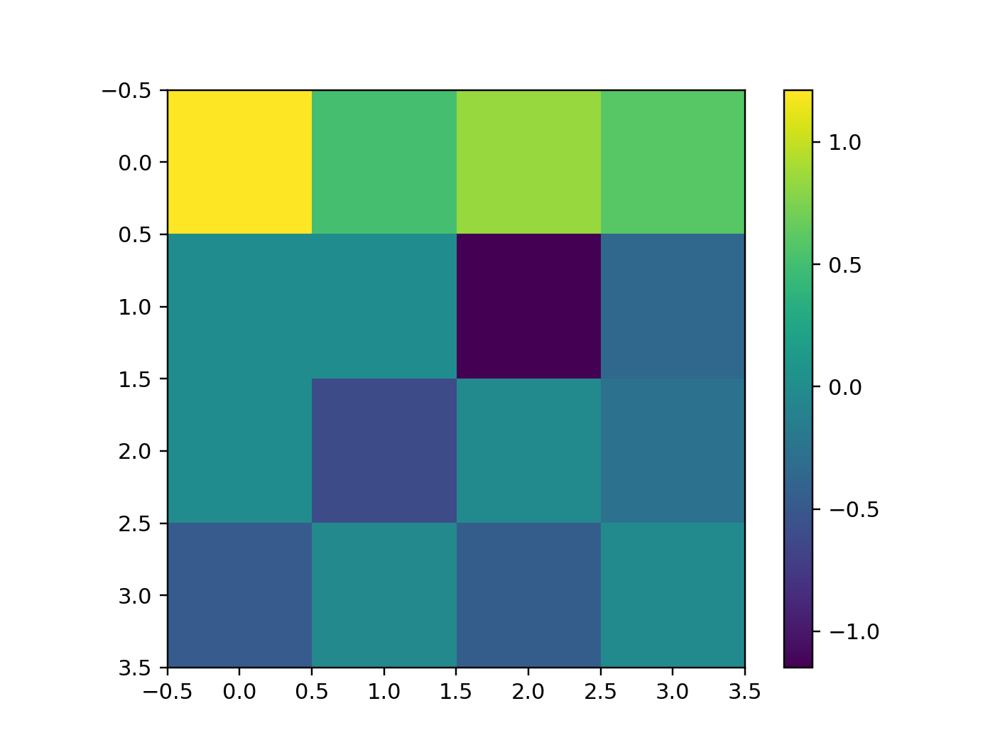

In [218]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()

In [97]:
drH,prH = np.linalg.eig(hess)

In [99]:
drH.shape

(1501,)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


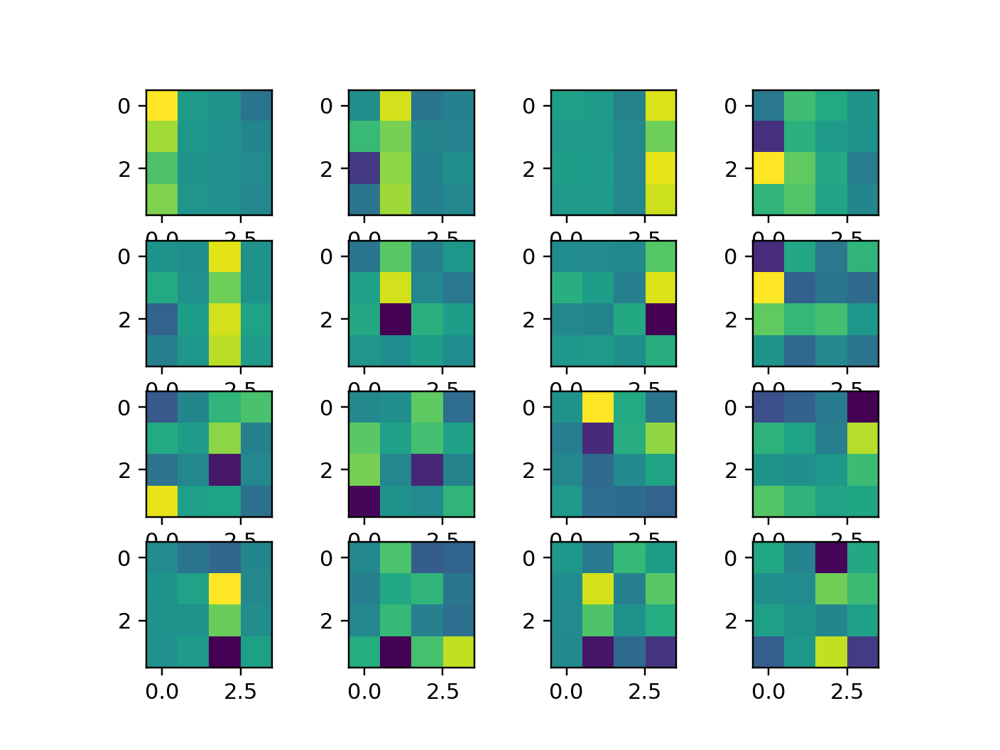

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


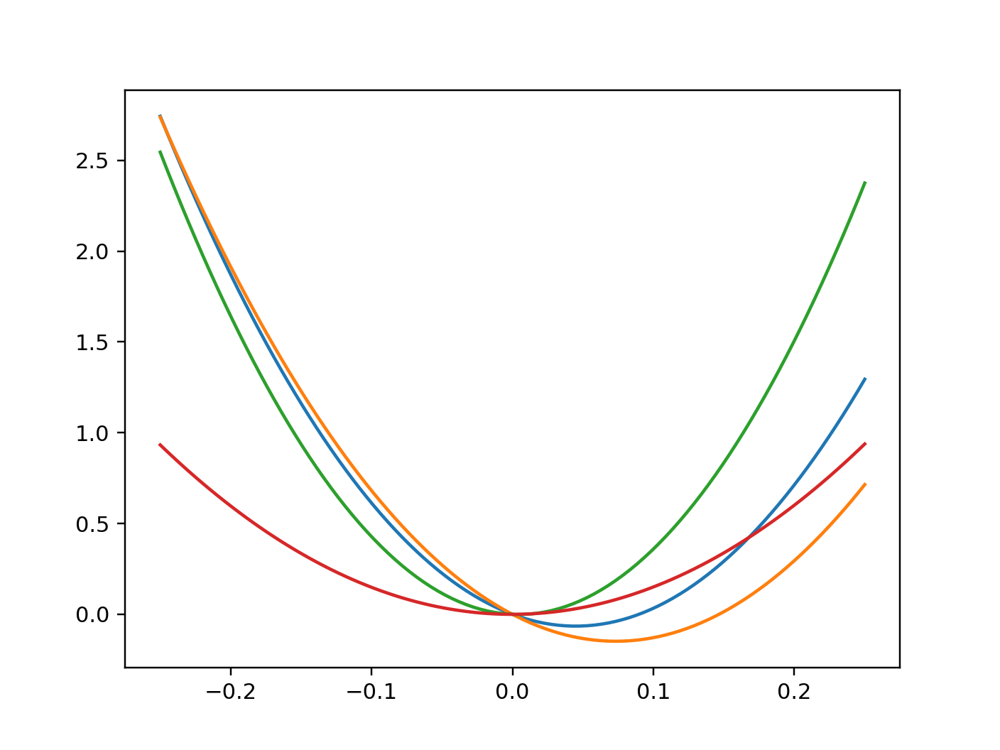

In [224]:
# nH = drH.shape[0]
hessWy = np.zeros((nQ**2,nQ**2))
blankWlist = parse_w(np.zeros(nH,))
blankWlist[1][:] = 1
allhot = unparse_W(*blankWlist)
Wy_entries = slice(np.where(allhot)[0][0],np.where(allhot)[0][-1]+1)
hessWy = hess[Wy_entries,Wy_entries]
gradWy = gr[Wy_entries]
drH,prH = np.linalg.eig(hessWy)
plt.figure()
for iieig,ieig in enumerate(np.arange(16)):
    plt.subplot(4,4,iieig+1)
    plt.imshow(prH[:,ieig].reshape((nQ,nQ))*np.sign(prH[:,ieig].mean()),vmin=-0.6,vmax=0.6)
plt.figure()
for ieig in np.arange(-1,-5,-1):
    x = np.linspace(-0.25,0.25,100)
    y = x*(gradWy @ prH[:,ieig]) + 0.5*x**2*(prH[:,ieig] @ hessWy @ prH[:,ieig])
    plt.plot(x,y)

In [211]:
hessW = np.zeros((nP*nQ+nQ**2,nP*nQ+nQ**2))
blankWlist = parse_W(np.zeros(nH,))
blankWlist[0][:] = 1
blankWlist[1][:] = 1
allhot = unparse_W(*blankWlist)
W_entries = slice(np.where(allhot)[0][0],np.where(allhot)[0][-1]+1)
hessW = hess[W_entries,W_entries]
gradW = gr[W_entries]
drHW,prHW = np.linalg.eig(hessW)

plt.figure()
for iieig,ieig in enumerate(np.arange(nP*nQ+nQ**2)):
    plt.subplot(6,4,iieig+1)
    these_wts = np.real(prHW[:,ieig])
    these_wx = these_wts[:nP*nQ].reshape((nP,nQ))
    these_wy = these_wts[nP*nQ:].reshape((nQ,nQ))
    these_w = np.concatenate((these_wy,these_wx),axis=0)
    plt.imshow(these_w*np.sign(these_w.mean()),vmin=-0.6,vmax=0.6)
plt.figure()
for ieig in np.arange(-1,-5,-1):
    x = np.linspace(-0.5,0.5,100)
    y = x*(gradW @ prHW[:,ieig]) + 0.5*x**2*(prHW[:,ieig] @ hessW @ prHW[:,ieig])
    plt.plot(x,y)

ValueError: too many values to unpack (expected 12)

<IPython.core.display.Javascript object>


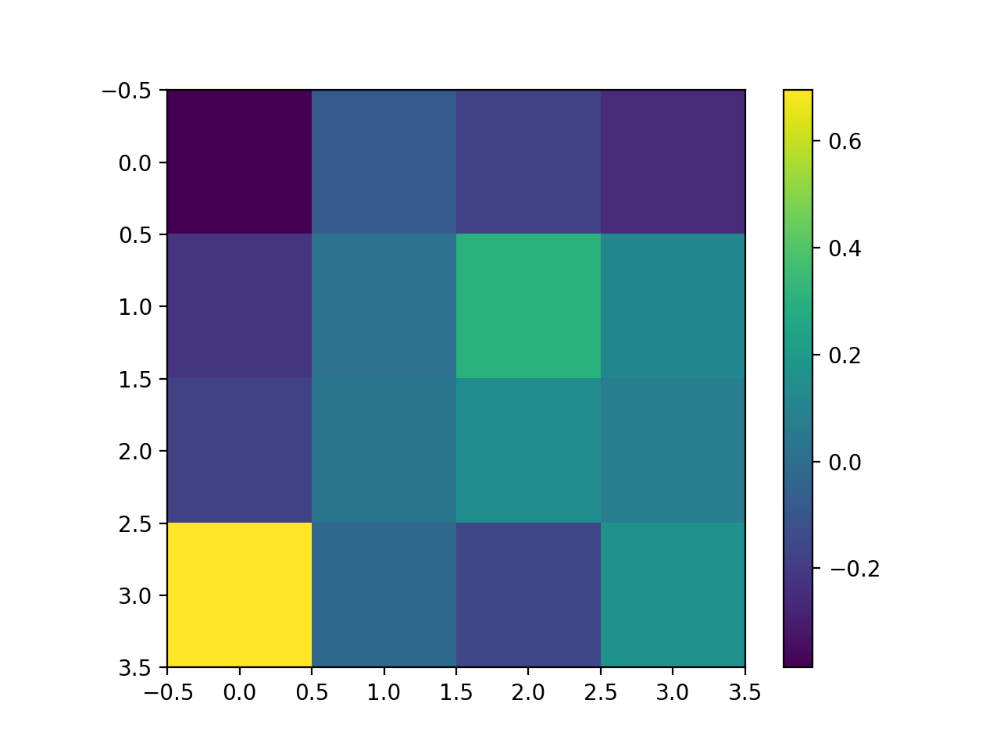

In [2079]:
plt.figure()
plt.imshow(prH[:,-3].reshape((nQ,nQ)))
plt.colorbar()

<IPython.core.display.Javascript object>


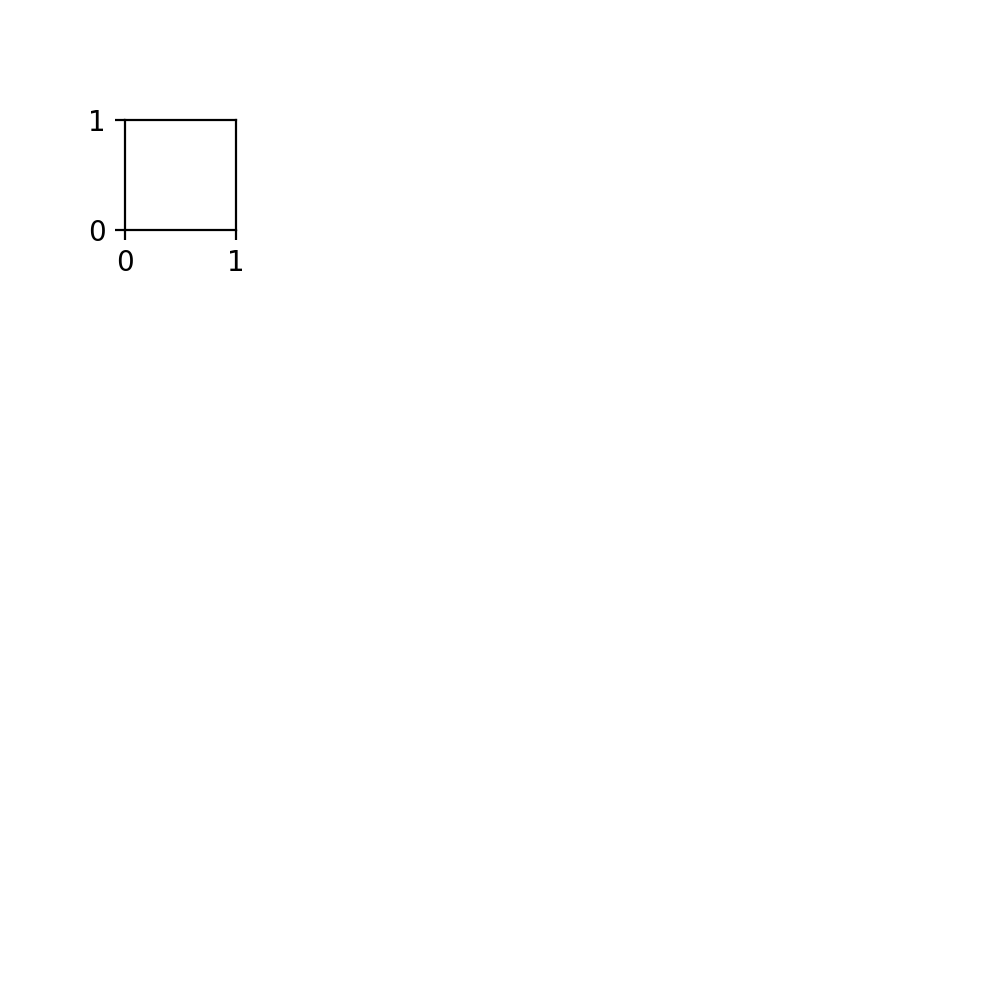

ValueError: cannot reshape array of size 8 into shape (4,4)

In [2080]:
mag = 1
plt.figure(figsize=(5*mag,5*mag))
for iidim,idim in enumerate(np.where(wheavy)[0]):
    plt.subplot(6,6,iidim+1)
    eiglist = parse_W(prH[:,idim])
    plt.imshow(np.real(eiglist[1])*np.sign(np.real(eiglist[1].sum())),vmin=-0.5,vmax=0.5)
    plt.axis('off')
    
mag = 1
plt.figure(figsize=(5*mag,5*mag))
for iidim,idim in enumerate(np.where(wheavy)[0]):
    plt.subplot(6,6,iidim+1)
    eiglist = parse_W(prH[:,idim])
    plt.imshow(np.real(eiglist[3])*np.sign(np.real(eiglist[3].sum())),vmin=-0.5,vmax=0.5)
    plt.axis('off')
#     plt.colorbar()
# plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


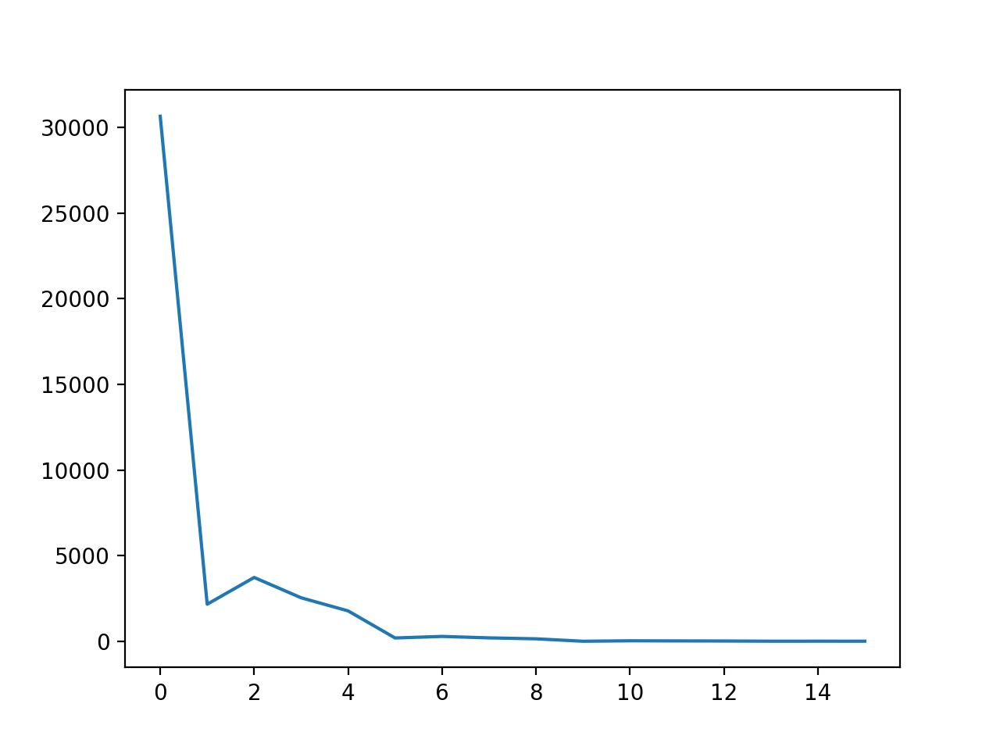

In [1796]:
plt.figure()
plt.plot(np.abs(drH))

In [1247]:
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,YY,Eta,Xi]
# nans: s02, XXp, Eta, Xi

In [1756]:
drW,prW = np.linalg.eig(Wmy-np.eye(Wmy.shape[0]))

In [66]:
len(Wt[0][0])

12

In [105]:
    def gen_Weight(W,K,kappa,T):
        MuT = np.array((1,2,1))
        MuK = np.array((1,kappa))
        WT = circulate(W,T,nT,Mu=MuT)
        KKlist = [K for iT in range(nT)]
        KK = np.concatenate(KKlist,axis=0)
        WW = circulate(WT,KK,nS,Mu=MuK)
        return WW

In [106]:
    def circulate(V,M,nZ,Mu=None):
        Vpartlist = [V*(M[np.newaxis,:]**np.abs(iZ)) for iZ in range(-nZ+1,nZ)]
        if Mu is None:
            Mu = np.ones((nZ,))
        #VVlist = [np.concatenate([m*v for m,v in zip(Mu,Vpartlist[nZ-iZ-1:2*nZ-iZ-1])],axis=1) for iZ in range(nZ)]
        VVlist = [np.concatenate(Vpartlist[nZ-iZ-1:2*nZ-iZ-1],axis=1) for iZ in range(nZ)]
        #VV = np.concatenate(VVlist,axis=0)
        VV = np.concatenate([m*v for m,v in zip(Mu,VVlist)],axis=0)
        return VV

<IPython.core.display.Javascript object>


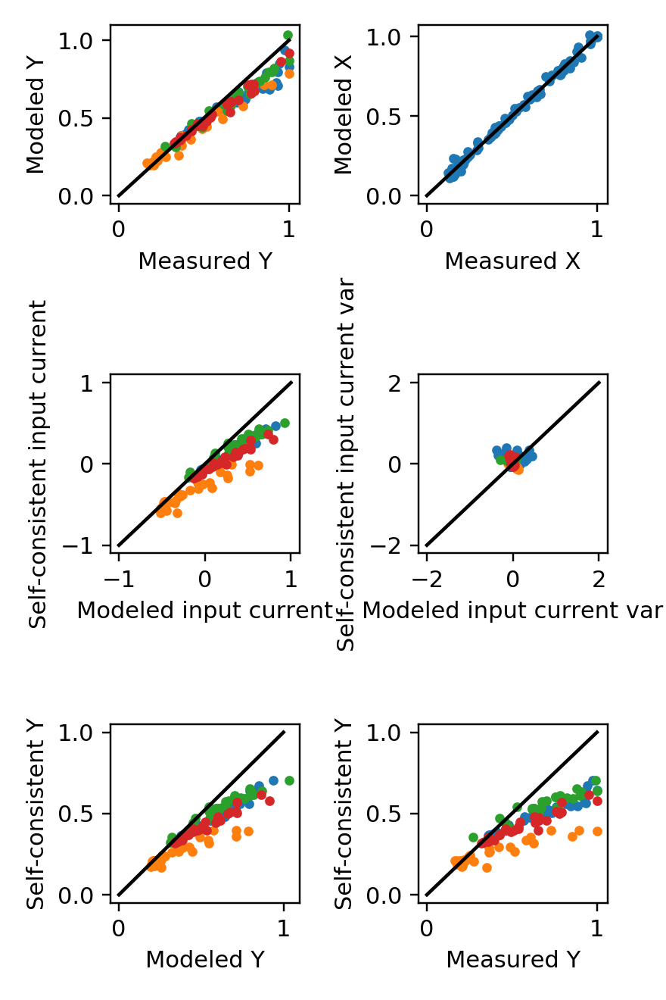

In [160]:
trystars_i,trystars_j = [0],[0]
itry = 0
Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi = Wt[trystars_i[itry]][trystars_j[itry]]
# Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list']
# def gen_Weight(W,K,kappa):
#     WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
#     WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
#     WW = np.concatenate((WW0,WW1),axis=0)
#     return WW

def u_fn(XX,YY,Wx,Wy,k,kappa,T):
    WWx,WWy = [gen_Weight(W,k,kappa,T) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def colorful_scatter(a,b):
    for icelltype in range(ncelltypes-1):
        plt.scatter(a[:,icelltype],b[:,icelltype],s=10)

XXhat = np.concatenate([np.concatenate(x,axis=1) for x in Xhat],axis=1)
YYhat = np.concatenate([np.concatenate(x,axis=1) for x in Yhat],axis=1)
YY = compute_f_(Eta,Xi,s02)
Etastar = u_fn(XX,YY,Wmx,Wmy,k,kappa,T)
Xistar = u_fn(XX,YY,Wsx,Wsy,k,kappa,T)
YYstar = compute_f_(Etastar,Xistar,s02)
nrows = 3
ncols = 2
plt.figure(figsize=(2*ncols,2*nrows))
plt.subplot(nrows,ncols,1)
colorful_scatter(YYhat,YY)
plt.xlabel('Measured Y')
plt.ylabel('Modeled Y')
plt.plot((0,1),(0,1),c='k')
plt.subplot(nrows,ncols,2)
plt.scatter(XXhat,XX,s=10)
plt.xlabel('Measured X')
plt.ylabel('Modeled X')
plt.plot((0,1),(0,1),c='k')
plt.subplot(nrows,ncols,3)
colorful_scatter(Eta,Etastar)
plt.xlabel('Modeled input current')
plt.ylabel('Self-consistent input current')
plt.plot((-1,1),(-1,1),c='k')
plt.subplot(nrows,ncols,4)
colorful_scatter(Xi,Xistar)
plt.xlabel('Modeled input current var')
plt.ylabel('Self-consistent input current var')
plt.plot((-2,2),(-2,2),c='k')
plt.subplot(nrows,ncols,5)
colorful_scatter(YY,YYstar)
plt.xlabel('Modeled Y')
plt.ylabel('Self-consistent Y')
plt.plot((0,1),(0,1),c='k')
plt.subplot(nrows,ncols,6)
colorful_scatter(YYhat,YYstar)
plt.xlabel('Measured Y')
plt.ylabel('Self-consistent Y')
plt.plot((0,1),(0,1),c='k')
plt.tight_layout()
plt.savefig('figures/model_fit_quality.jpg')

In [131]:
trystars_i = (0,)
trystars_j = (0,)
itry = 0
Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi = Wt[trystars_i[itry]][trystars_j[itry]]
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','kappa','T','XX','XXp','Eta','Xi']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wt[trystars_i[itry]][trystars_j[itry]][i]
Wstar_dict['as_list'] = [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi]
np.save('weights_200607.npy',Wstar_dict)

<IPython.core.display.Javascript object>


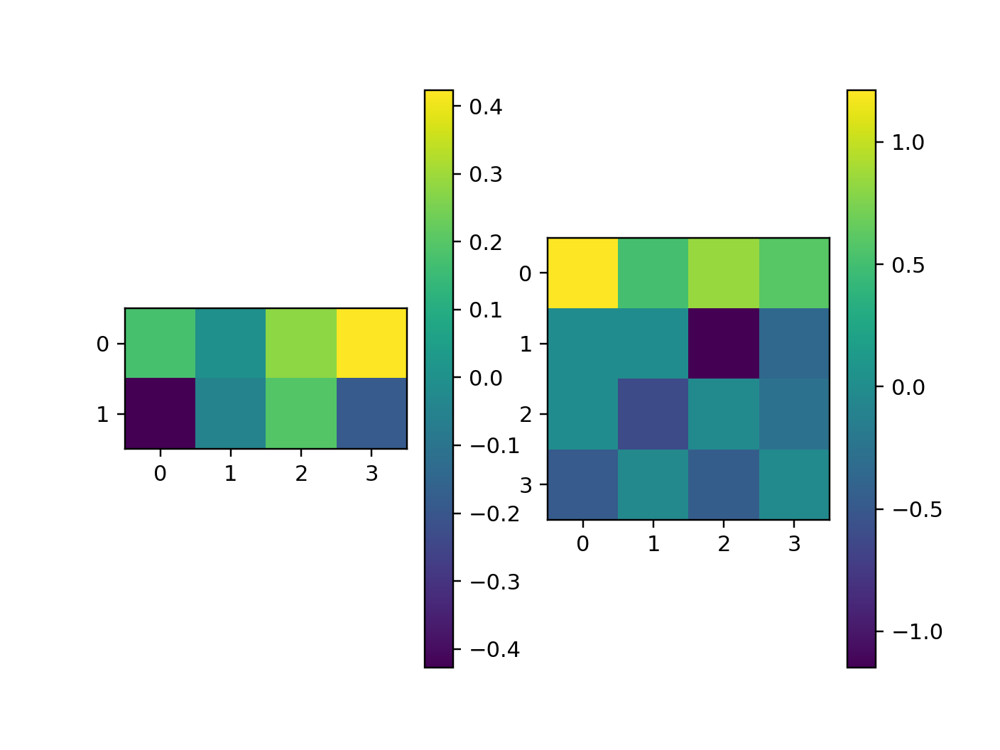

In [162]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(Wmx)
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(Wmy)
plt.colorbar()

In [163]:
def show_four_celltypes(YYstar):
    lbls = ['PC','SST','VIP','PV']
    mag = 2
    plt.figure(figsize=(mag*nQ,mag))
    for itype in range(nQ):
        plt.subplot(1,nQ,itype+1)
        plt.title(lbls[itype])
        sca.show_size_contrast(YYstar[:,itype].reshape((5,6)),flipud=True)
    plt.tight_layout()
    
def show_all_celltypes(YYstar):
    lbls = ['PC','SST','VIP','PV']
    mag = 2
    plt.figure(figsize=(mag*nQ,mag*nQ))
    for itype in range(nQ**2):
        plt.subplot(nQ,nQ,itype+1)
        plt.title(lbls[np.remainder(itype,nQ)])
        sca.show_size_contrast(YYstar[:,itype].reshape((5,6)),flipud=True)
    plt.tight_layout()

<IPython.core.display.Javascript object>


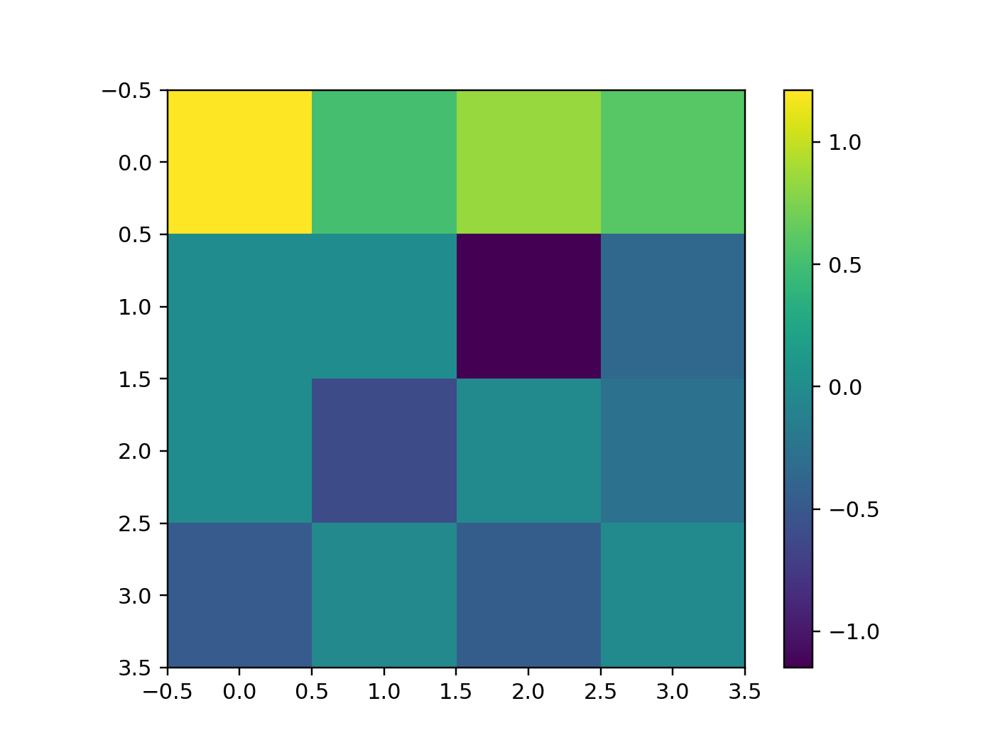

In [164]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()

<IPython.core.display.Javascript object>


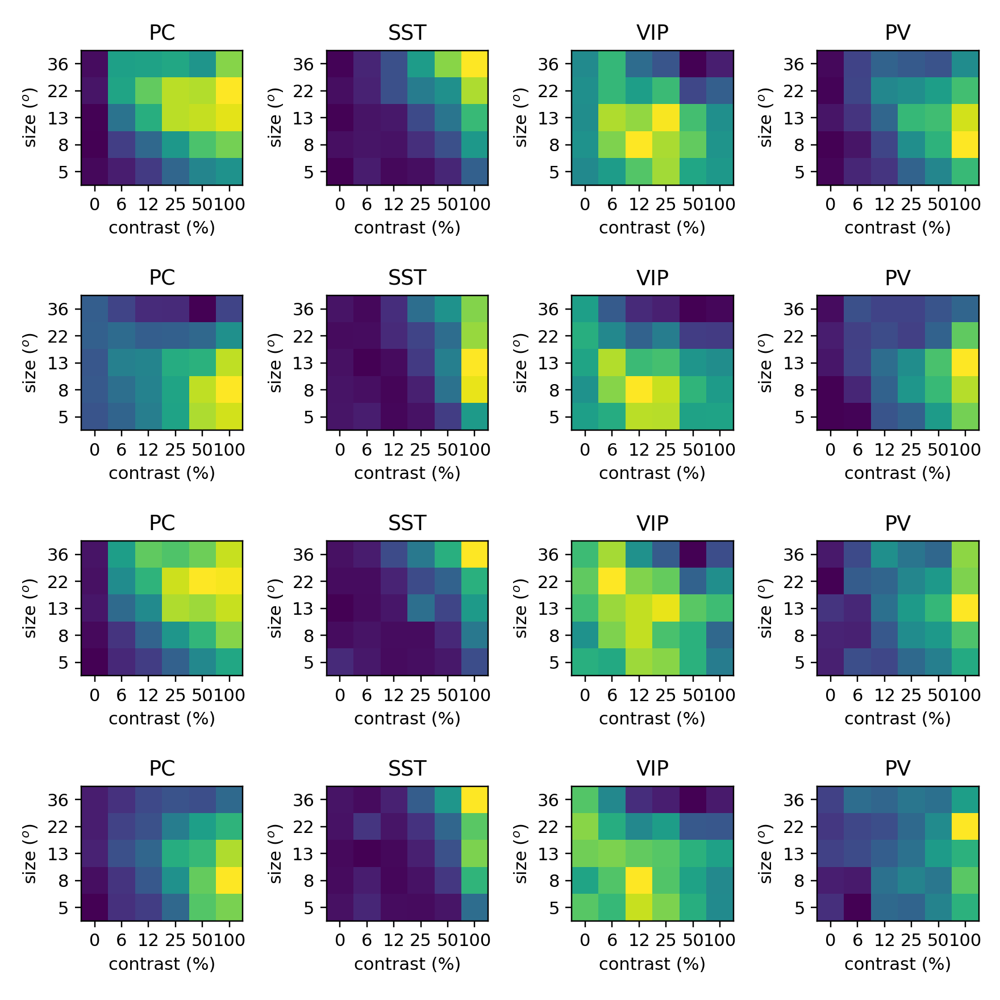

In [165]:
for itry in range(1): #ntries): 
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi = Wt[trystars_i[itry]][trystars_j[itry]]
#     Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[0][itry]
    XXhat = np.concatenate([np.concatenate(xxhh,axis=1) for xxhh in Xhat],axis=1)
    YYhat = np.concatenate([np.concatenate(xxhh,axis=1) for xxhh in Yhat],axis=1)
    YY = compute_f_(Eta,Xi,s02)
    Etastar = u_fn(XX,YY,Wmx,Wmy,k,kappa,T)
    Xistar = u_fn(XX,YY,Wsx,Wsy,k,kappa,T)
    YYstar = compute_f_(Etastar,Xistar,s02)
#     show_four_celltypes(YY)
    show_all_celltypes(YYhat)

#     mag = 2
#     plt.figure(figsize=(mag*nQ,mag))
#     for itype in range(nQ):
#         plt.subplot(1,nQ,itype+1)
#         plt.title(lbls[itype])
#         sca.show_size_contrast(YYstar[:,itype].reshape((5,6)),flipud=True)
#     plt.tight_layout()
#     plt.savefig('figures/modeled_four_cell_types.jpg',dpi=300)

In [166]:
K

array([0.96775473, 1.        , 1.        , 0.95124705])

In [167]:
Xhat[0][1].shape

(30, 2)

In [168]:
[np.concatenate(xh,axis=1) for xh in Xhat[0]]

AxisError: axis 1 is out of bounds for array of dimension 1

<IPython.core.display.Javascript object>


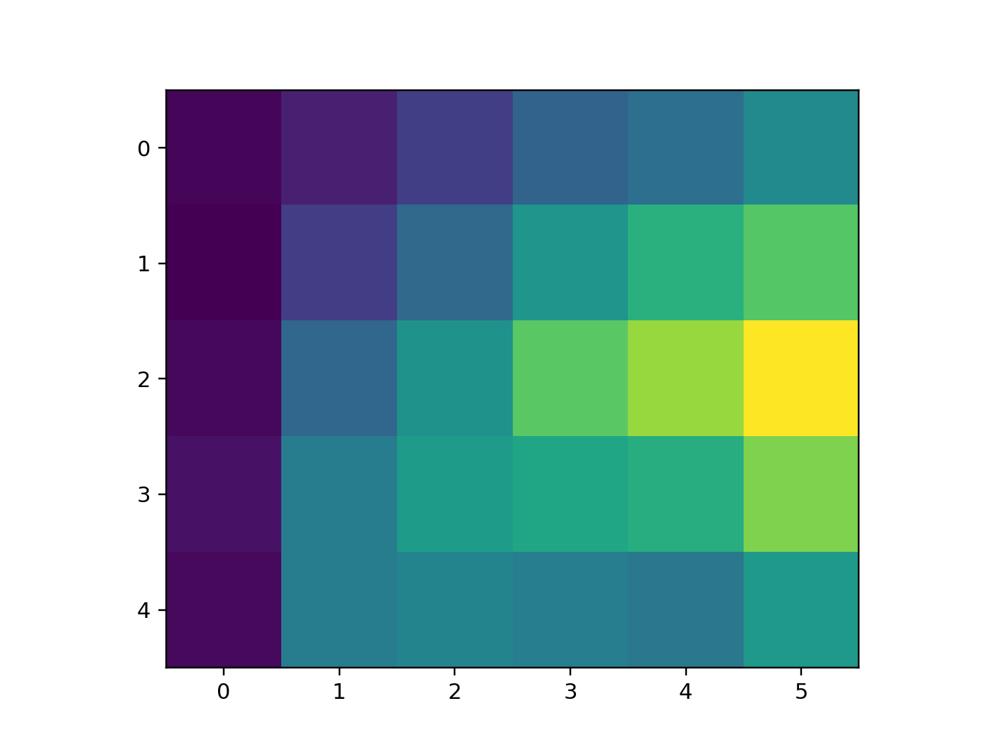

In [169]:
plt.figure()
plt.imshow(YY[:,0].reshape((5,6)))

<IPython.core.display.Javascript object>


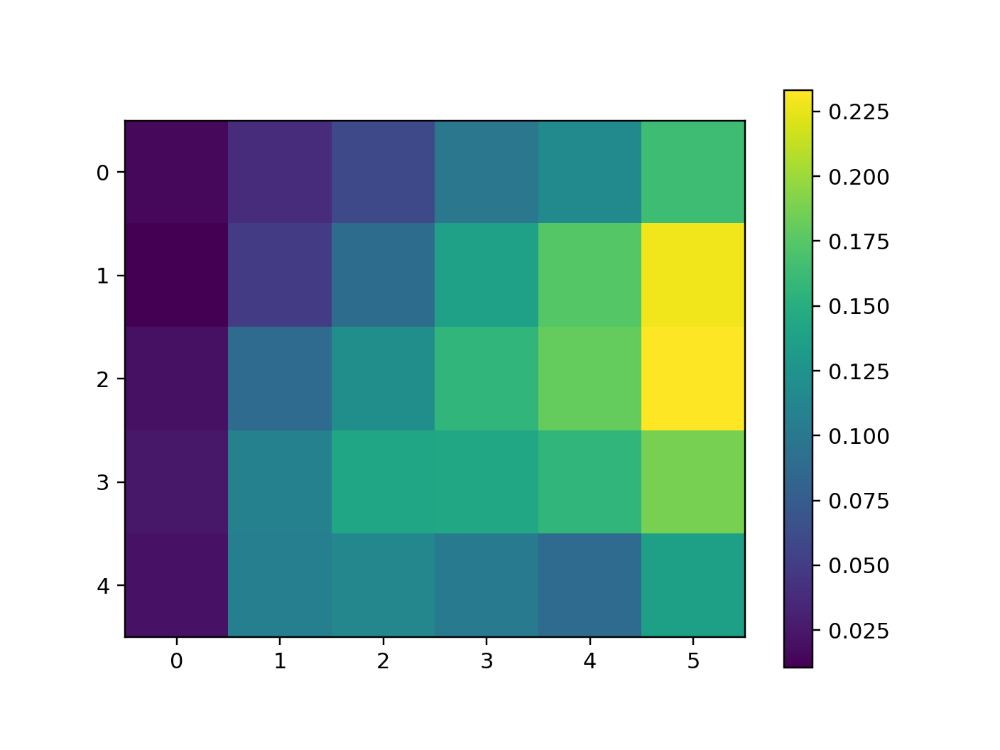

In [170]:
plt.figure()
plt.imshow((YY-YYstar)[:,0].reshape((nsize,ncontrast)))
plt.colorbar()

In [176]:
ww = gen_Weight(Wmy,k,kappa,T)
eig_actual = np.zeros((Etastar.shape[0],))
for istim in range(Etastar.shape[0]):
    eig_actual[istim] = np.max(np.real(np.linalg.eig(compute_fprime_m_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nT*nQ))[0]))
#     eig_actual[istim] = np.max(np.real(np.linalg.eig(compute_fprime_(Etastar,Xistar,s02)[istim]@ww - np.eye(ww.shape[0]))[0]))
    eig_no_gain = np.max(np.real(np.linalg.eig(ww - np.eye(ww.shape[0]))[0]))
    print((eig_actual[istim],eig_no_gain))

(-0.9999999999999991, 1.088034755720857)
(-0.9999999999999992, 1.088034755720857)
(-0.9999999999999988, 1.088034755720857)
(-0.9999999999999988, 1.088034755720857)
(-0.9999999999999991, 1.088034755720857)
(-0.9999999999999991, 1.088034755720857)
(-0.9999999999999996, 1.088034755720857)
(-0.9999999999999996, 1.088034755720857)
(-0.848225270985385, 1.088034755720857)
(-0.9604814209467221, 1.088034755720857)
(-0.999999999999999, 1.088034755720857)
(-0.9999999999999994, 1.088034755720857)
(-0.9999999999999989, 1.088034755720857)
(-0.6109516292711623, 1.088034755720857)
(0.3099997607014833, 1.088034755720857)
(1.229447081031667, 1.088034755720857)
(-0.8526056751437843, 1.088034755720857)
(-0.9999999999999989, 1.088034755720857)
(-0.9999999999999989, 1.088034755720857)
(0.034620661111890466, 1.088034755720857)
(0.6481192249056755, 1.088034755720857)
(0.5272874509875263, 1.088034755720857)
(-0.09844560349576625, 1.088034755720857)
(-0.8344092426209275, 1.088034755720857)
(-0.9999999999999989,

In [179]:
istim = 29
drf,prf = np.linalg.eig(compute_fprime_m_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nT*nQ))

In [180]:
prf[:,1]

array([ 0.29496136+0.j        ,  0.00116019-0.26394207j,
       -0.09285491-0.22113501j, -0.16856478-0.18666271j,
       -0.16856478-0.18666271j, -0.09285491-0.22113501j,
       -0.09285491-0.22113501j, -0.09285491-0.22113501j,
       -0.16856478-0.18666271j, -0.09285491-0.22113501j,
       -0.16856478-0.18666271j, -0.09285491-0.22113501j,
       -0.05499998-0.23837116j, -0.05499998-0.23837116j,
       -0.05499998-0.23837116j, -0.01714505-0.25560731j])

In [183]:
istim = -1
np.linalg.eig(compute_fprime_m_(Eta,Xi,s02)[istim]@ww - np.eye(nS*nQ*nT))[1][0]

array([ 0.25      +0.j,  0.29496136+0.j,  0.29496136-0.j,  0.28331681+0.j,
       -0.77347889+0.j, -0.07853726+0.j, -0.17463673+0.j,  0.00994753+0.j,
       -0.05456866+0.j, -0.08480812+0.j, -0.22399136+0.j,  0.03081336+0.j,
       -0.03280542+0.j,  0.18922642+0.j,  0.26636756+0.j, -0.06710447+0.j])

In [184]:
(Wmy[1,2],Wmy[2,1],Wmy[3,0],Wmy[1,0])

(-1.1482292355447987,
 -0.6056465769385639,
 -0.47033946527741916,
 -0.002764627122127211)

In [185]:
YY = compute_f_(Eta,Xi,s02)

<IPython.core.display.Javascript object>


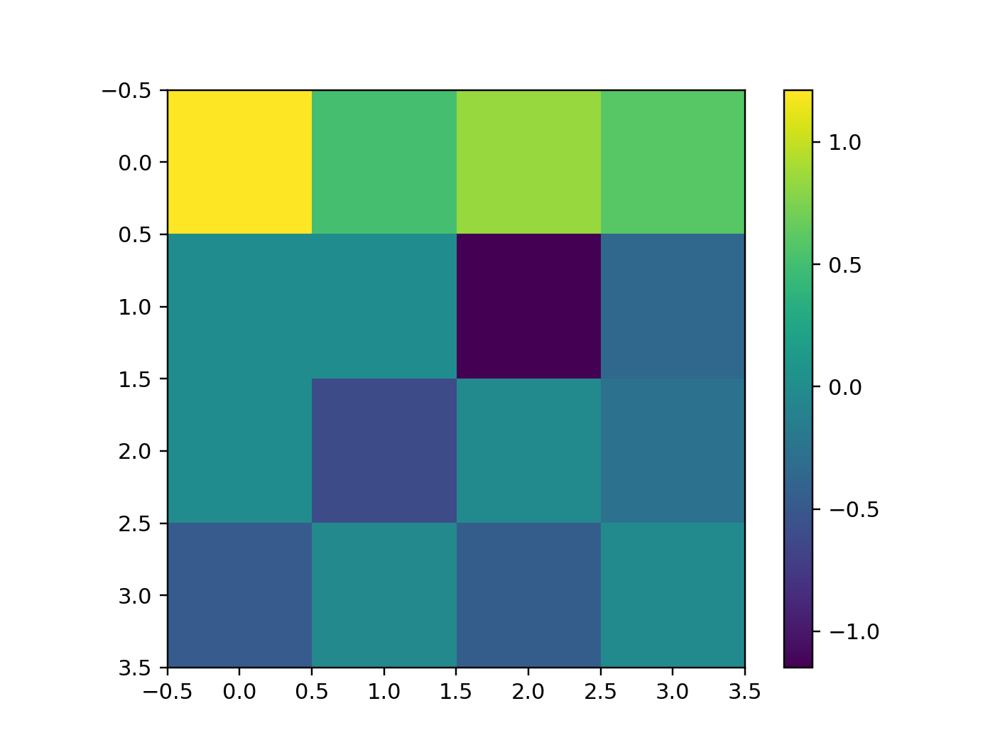

<IPython.core.display.Javascript object>


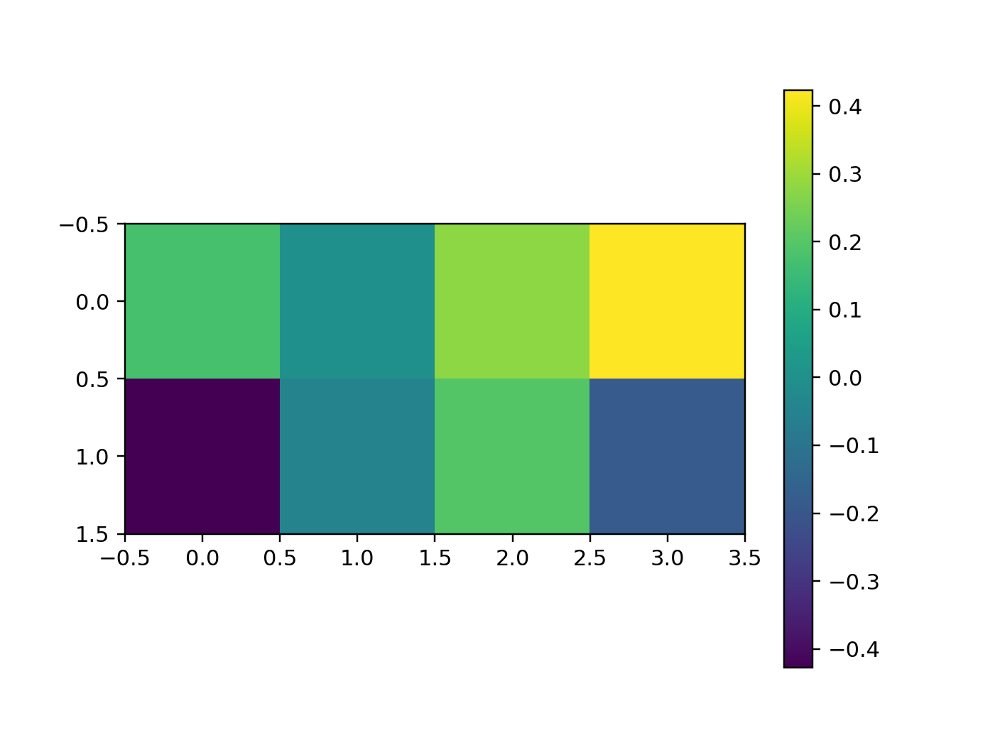

In [186]:
plt.figure()
plt.imshow(Wmy)
plt.colorbar()
plt.figure()
plt.imshow(Wmx)#,vmin=-2,vmax=2)
plt.colorbar()

In [187]:
Wmy_bounds

array([[ 2,  2,  2,  2],
       [-2,  0, -2, -2],
       [ 0, -2, -2, -2],
       [-2, -2, -2, -2]])

<IPython.core.display.Javascript object>


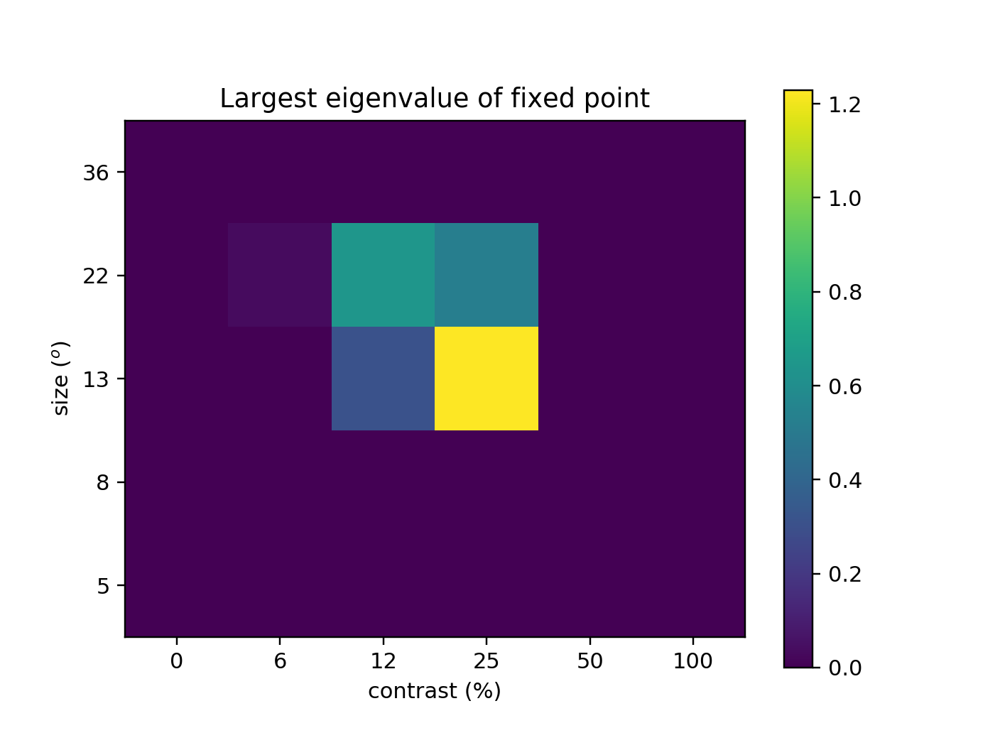

Text(0.5, 1.0, 'Largest eigenvalue of fixed point')

In [188]:
plt.figure()
sca.show_size_contrast(eig_actual.reshape((nsize,ncontrast)),vmin=0,flipud=True)#,vmin=-1,vmax=1)
plt.colorbar()
plt.title('Largest eigenvalue of fixed point')
# plt.savefig('figures/possible_gamma_substrate.jpg',dpi=300)

In [1915]:
# Wstar_dict = np.load('weights_200111b.npy',allow_pickle=True)[()]

In [189]:
nstar = len(trystars_i)
YY = [None for istar in range(nstar)]
Nvals = 10
max_val = 1
Niter = int(1e3)
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    def fY(XX,YY):
        return compute_f_(u_fn(XX,YY,Wmx,Wmy,k,kappa),u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY(XX,YY0,eta=1e-2):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    YY = np.zeros((Nvals,Nvals,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta[0],Xi[0],s02)
    XX = np.ones((Nvals,Nvals,4))
    XX[:,:,0],XX[:,:,2] = np.meshgrid(np.linspace(0,max_val,Nvals),np.linspace(0,max_val,Nvals),indexing='ij')
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for ival in range(Nvals):
        YY[ival,0] = predict_YY(XX[ival,0],YY0)
        print(ival)
        for jval in range(1,Nvals):
            YY[ival,jval] = predict_YY(XX[ival,jval],YY[ival-1,jval,-1])
            
    mag = 2
    plt.figure(figsize=(mag*ncelltypes,mag))
    for icelltype in range(nQ):
        plt.subplot(1,ncelltypes,icelltype+1)
        plt.imshow(YY[:,:,-1,icelltype],vmin=0)#,interpolation='bilinear')
        plt.axis('off')

0


ValueError: too many values to unpack (expected 11)

In [1946]:
nstar = len(trystars_i)
YYsc = [None for istar in range(nstar)]
Niter = int(2e3)
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    def fY(XX,YY):
        return compute_f_(resEta[ival]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[ival]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY(XX,YY0,eta=2e-2):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YYsc[istar] = np.zeros((nN,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02) + 0.05*np.tile(np.array((0,1,0,0,0,1,0,0))[np.newaxis],(nN,1)) #*np.random.randn(nN,nS*nQ)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for ival in range(nN):
        YYsc[istar][ival] = predict_YY(XX[ival],YY0[ival])
        print(ival)
            
#     mag = 2
#     plt.figure(figsize=(mag*ncelltypes,mag))
#     for icelltype in range(nQ):
#         plt.subplot(1,ncelltypes,icelltype+1)
#         plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
#         plt.axis('off')

0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


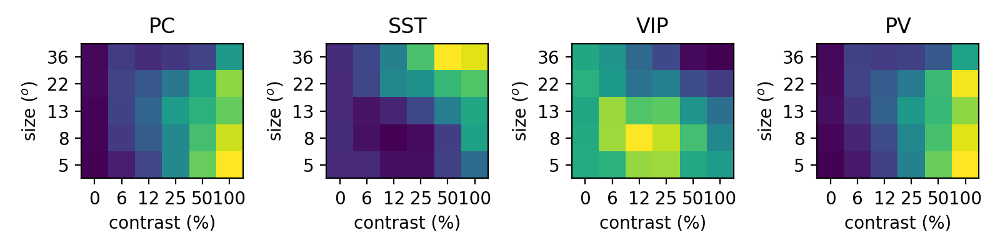

In [1947]:
show_four_celltypes(YYsc[0][:,-1])
# plt.savefig('figures/self_consistent_model_no_residual_currents.jpg',dpi=300)

In [205]:
YY = compute_f_(Eta,Xi,s02)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


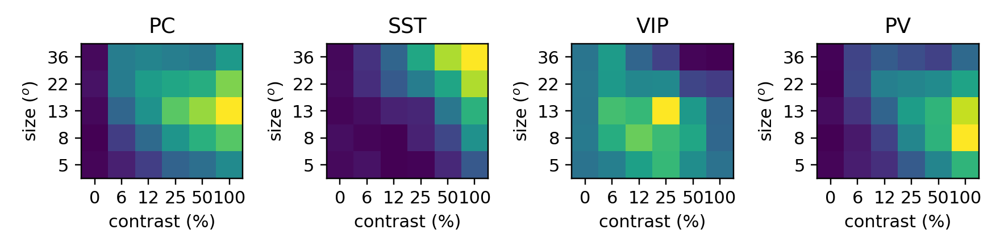

In [206]:
show_four_celltypes(YY)#[0][:,-1])
# plt.savefig('figures/self_consistent_model_with_residual_currents.jpg',dpi=300)

array([[0.39086693, 0.21484218, 0.58632514, 0.34584914, 0.22859653,
        0.20503422, 0.41731107, 0.26258943, 0.36987473, 0.2647083 ,
        0.71122421, 0.39903011, 0.2273314 , 0.19702482, 0.48613217,
        0.29203617],
       [0.43169382, 0.2318594 , 0.62277941, 0.38423189, 0.23736838,
        0.20647303, 0.43180682, 0.26773159, 0.42344258, 0.24078546,
        0.70430321, 0.46280198, 0.24139063, 0.2000154 , 0.46636541,
        0.27163461],
       [0.47886062, 0.20612953, 0.72256559, 0.4151469 , 0.27220334,
        0.17896325, 0.5094148 , 0.32443159, 0.46008977, 0.21455186,
        0.8146748 , 0.46421441, 0.24976802, 0.17909547, 0.54554288,
        0.34823162],
       [0.56900887, 0.21168364, 0.79631677, 0.50323752, 0.29059425,
        0.18628887, 0.50546355, 0.34822425, 0.51360551, 0.21591154,
        0.81412997, 0.53000407, 0.26961431, 0.17844957, 0.51336273,
        0.35385627],
       [0.64403624, 0.26681506, 0.66155108, 0.60125777, 0.32454671,
        0.23827165, 0.42395552, 

In [207]:
YY[0].shape

(16,)

In [2099]:
def compute_f_(Eta,Xi,s02):
    return utils.f_miller_troyer(Eta,Xi**2+np.concatenate((s02,s02),axis=0))

def compute_fprime_m_(Eta,Xi,s02):
    return utils.fprime_miller_troyer(Eta,Xi**2+np.concatenate((s02,s02),axis=0))*Xi

def compute_fprime_s_(Eta,Xi,s02):
    s2 = Xi**2+np.concatenate((s02,s02),axis=0)
    return utils.fprime_s_miller_troyer(Eta,s2)*(Xi/s2)

def sorted_r_eigs(w):
    drW,prW = np.linalg.eig(w)
    srtinds = np.argsort(drW)
    return drW[srtinds],prW[:,srtinds]

def gen_Weight(W,K,kappa):
    WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
    WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
    WW = np.concatenate((WW0,WW1),axis=0)
    return WW

def u_fn(XX,YY,Wx,Wy,k,kappa):
    WWx,WWy = [gen_Weight(W,k,kappa) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def compute_steady_state(Wlist,Niter=int(4e2),max_val=2.5,Ny=50,fix_dim=None,stim_vals=None,dt=1e-2,perturbation_size=5e-2):
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wlist
    nQ = Wmy.shape[0]
    nN = Eta.shape[0]
    nS = int(Eta.shape[1]/nQ)
    
    if fix_dim is None:
        fix_dim = [None]
        Nfix = 1
        yvals = (0,)
        Ny = 1
        max_val = 0
    else:
        Nfix = len(fix_dim)
        yvals = np.linspace(0,max_val,Ny)
    
    if stim_vals is None:
        stim_vals = np.arange(nN)
    Nstim = len(stim_vals)
    
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    
    def fY(XX,YY):
        return compute_f_(resEta[stim_val]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[stim_val]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY_fix_dim(XX,YY0,fix_dim=None,run_backward=False,):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0 #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = dt*dYYdt(YY[iiter])
            if not fix_dim is None:
                dYY[fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_ss = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ifix in range(Nfix):
                yy0 = YY0[stim_val] + perturbation_size*np.random.randn(*(YY0[stim_val].shape))
                if not fix_dim[ifix] is None:
                    yy0[fix_dim[ifix]] = yval
                YY_ss[ifix,istim,iy] = predict_YY_fix_dim(XX[stim_val],yy0,fix_dim=fix_dim[ifix])
    if fix_dim[0] is None:
        YY_ss = YY_ss[0,:,0,:,:]
    return YY_ss

In [2100]:
nstar = len(trystars_i)
Niter = int(3e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
#     ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    def fY(XX,YY):
        return compute_f_(resEta[stim_val]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[stim_val]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY_fix_dim(XX,YY0,eta=1e-2,fix_dim=None,run_backward=False):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = eta*dYYdt(YY[iiter])
            if not fix_dim is None:
                dYY[fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_ss = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ifix in range(Nfix):
                yy0 = YY0[stim_val] #+np.random.randn(yy0.shape)
                yy0[fix_dim[ifix]] = yval
                YY_ss[ifix,istim,iy] = predict_YY_fix_dim(XX[stim_val],yy0,fix_dim=fix_dim[ifix])

0
0


KeyboardInterrupt: 

In [1040]:
# YY_ss = YY.copy()

In [ ]:
# def u_fn(XX,YY,Wx,Wy,k,kappa):
#     WWx,WWy = [gen_Weight(W,k,kappa) for W in [Wx,Wy]]
#     return XX @ WWx + YY @ WWy

In [1527]:
reload(utils)
nstar = len(trystars_i)
Niter = int(4e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
Nx = 20
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
xvals = np.linspace(0,max_val,Nx)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    WWmx,WWmy = [gen_Weight(W,k,kappa) for W in [Wmx,Wmy]]
    WWsx,WWsy = [gen_Weight(W,k,kappa) for W in [Wsx,Wsy]]
    def u_fn_m(XX,YY):
        return u_fn_WW(XX,YY,WWx=WWmx,WWy=WWmy)
    def u_fn_s(XX,YY):
        return u_fn_WW(XX,YY,WWx=WWsx,WWy=WWsy)
    def dfYdY(XX,YY):
        # derivs: (nN,nS*nQ)
        # WWy: (nS*nQ,nS*nQ)
        # (dfYdY)ij = dfj(Y)/dYi
        deriv_m = compute_fprime_m_(resEta[stim_val]+u_fn_m(XX,YY),resXi[stim_val]+u_fn_s(XX,YY),s02)
        deriv_s = compute_fprime_s_(resEta[stim_val]+u_fn_m(XX,YY),resXi[stim_val]+u_fn_s(XX,YY),s02)
        return deriv_m[:,np.newaxis,:]*WWmy[np.newaxis,:,:] + deriv_s[:,np.newaxis,:]*WWsy[np.newaxis,:,:]
    def fY(XX,YY):
        return compute_f_(resEta[stim_val:stim_val+1]+u_fn_m(XX,YY),resXi[stim_val:stim_val+1]+u_fn_s(XX,YY),s02)
    def predict_YY_fix_dim(XX,YY0,eta=2e-1,fix_dim=0,run_backward=False):
        def F(YY):
            # YY: (nN,nS*nQ)
            # F: (nN,nS*nQ)
            return -YY + fY(XX,YY)
        def dFdYY(YY):
            # dFdYY: (nN,nS*nQ,nS*nQ)
            # (dFdYY)ij = dFj(Y)/dYi, inherited from dfYdY convention
            return -np.eye(nS*nQ)[np.newaxis,:,:] + dfYdY(XX,YY)
        def dF2dYY(YY):
            # dFdYY: (nN,nS*nQ,nS*nQ)
            # F: (nN,nS*nQ)
            # dF2dYY: (nN,nS*nQ)
            # (dFdYY)ij = dFj(Y)/dYi, so sum_j ( dFj(Y)/dYi Fj(Y) = sum_j (dFdYY)ij Fj) yields the right answer
            return np.einsum('hij,hj->hi',dFdYY(YY),F(YY))
        YY = np.zeros((1,Niter+1,nS*nQ))
        YY[:,0] = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[:,0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = -eta*dF2dYY(YY[:,iiter])
            dYY[:,fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[:,iiter+1] = YY[:,iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_F2 = np.zeros((Nfix,Nstim,Ny,Nx,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
#     XX[:,2] = np.linspace(0,max_val,Nvals)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ix,xval in enumerate(xvals):
                for ifix in range(Nfix):
    #                 yy0 = YY0[stim_val] #+np.random.randn(yy0.shape)
                    yy0[:] = np.random.rand(*yy0.shape)
                    yy0[fix_dim[ifix]] = yval
                    YY_F2[ifix,istim:istim+1,iy,ix] = predict_YY_fix_dim(XX[stim_val:stim_val+1],yy0[np.newaxis],fix_dim=fix_dim[ifix])
    #             if np.remainder(iy,10)==0:
#                 print(iy)
            
#     mag = 2
#     plt.figure(figsize=(mag*ncelltypes,mag))
#     for icelltype in range(nQ):
#         plt.subplot(1,ncelltypes,icelltype+1)
#         plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
#         plt.axis('off')

0
0


KeyboardInterrupt: 

In [1057]:
pdb.pm()

> <ipython-input-1056-9146c9d1360a>(48)dF2dYY()
-> return dFdYY(YY) @ F(YY)
(Pdb) dFdYY.shape
*** AttributeError: 'function' object has no attribute 'shape'
(Pdb) dFdYY(YY).shape
(1, 8, 8)
(Pdb) F(YY).shape
(1, 8)
(Pdb) exit


<IPython.core.display.Javascript object>


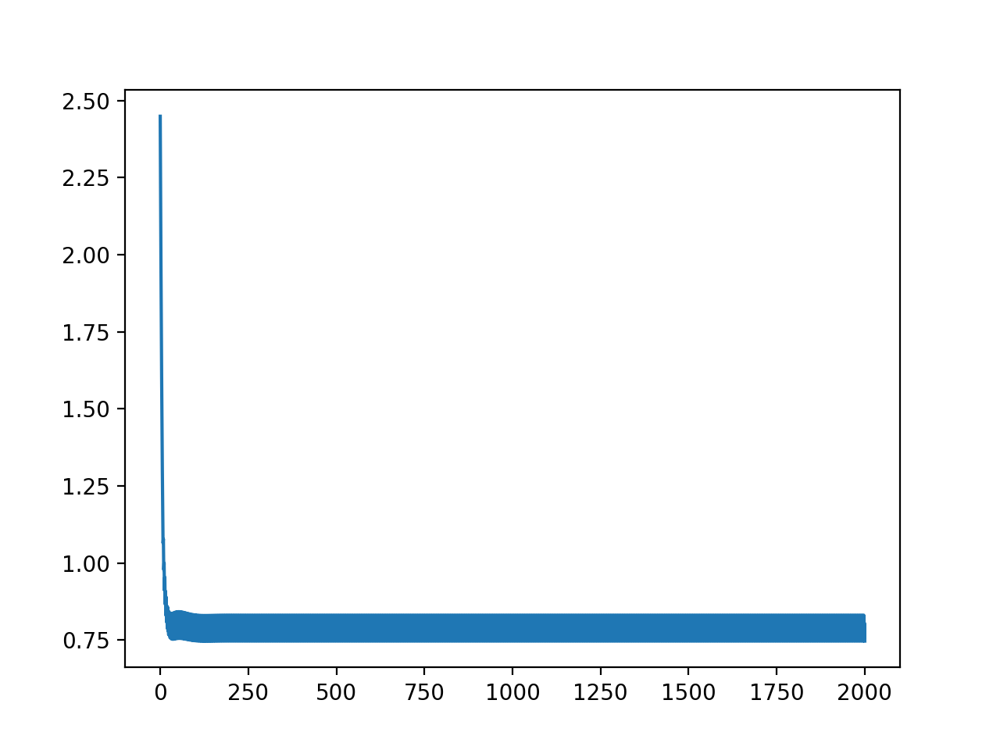

In [604]:
plt.figure()
plt.plot(YY[ix,istim,-1,:,iy])

In [1960]:
Wmy[2,1],Wmy[1,2]

(-2.144034644009146, -0.5218867289146812)

<IPython.core.display.Javascript object>


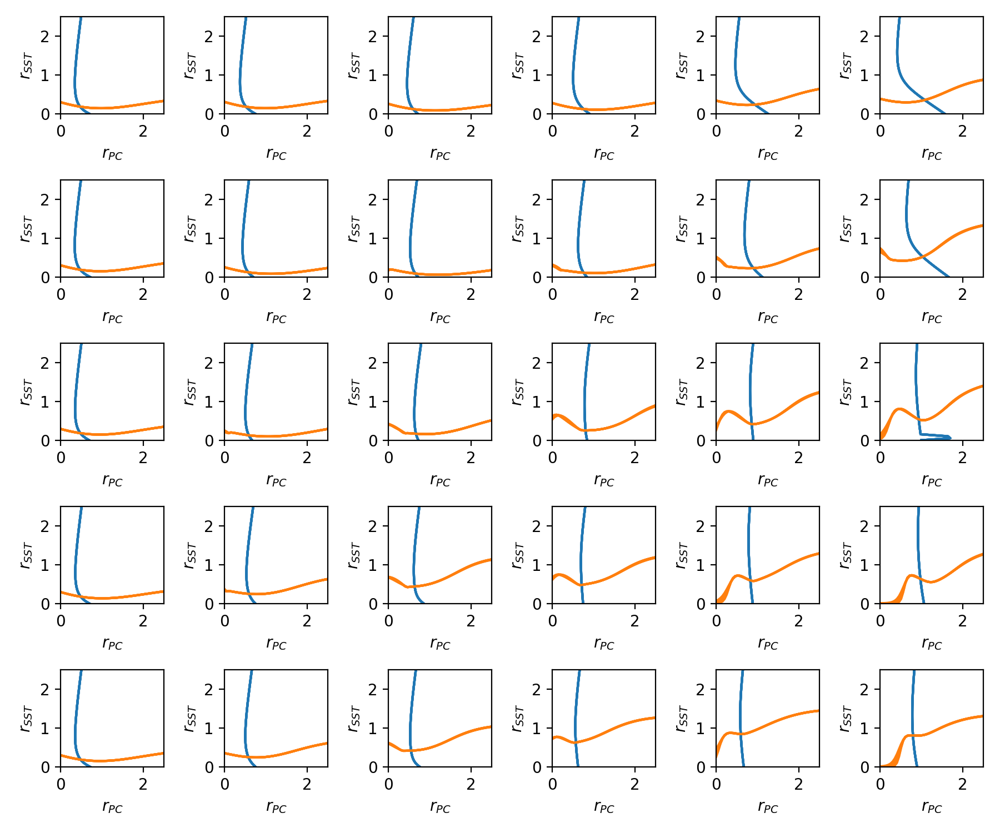

In [1986]:
mag = 1.5
plt.figure(figsize=(ncontrast*mag,nsize*mag))
# YY = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
ix = 0
iy = 1
for yy in [YY_ss]:#,YY_F2]:
    linestyles = ['solid','dashed']
    for istim in range(Nstim):
        plt.subplot(nsize,ncontrast,stim_vals[istim]+1)
        for it in np.arange(-1001,0,200):
            xvals = yy[iy,istim,:,it,ix]
            gd = xvals < max_val
            plt.plot(xvals[gd],yvals[gd],label='$dr_{PC}/dt=0$',c='C0',linestyle=linestyles[idir])
            xvals = yy[ix,istim,:,it,iy]
            gd = xvals < max_val
            plt.plot(yvals[gd],xvals[gd],label='$dr_{SST}/dt=0$',c='C1',linestyle=linestyles[idir])
    #     plt.legend()
        plt.xlabel('$r_{%s}$' % lbls[ix])
        plt.ylabel('$r_{%s}$' % lbls[iy])
#         plt.axis('equal')
        plt.ylim((0,1*max_val))
        plt.xlim((0,1*max_val))
    plt.tight_layout()

In [2101]:
nstar = len(trystars_i)
Niter = int(3e3)
fix_dim = [0,1,2,3]
Nfix = len(fix_dim)
# YY = [None for ifix in range(Nfix)]
Ny = 50
max_val = 2.5
yvals = np.linspace(0,max_val,Ny)
stim_vals = np.arange(30)
Nstim = len(stim_vals)
for istar in (0,): #range(nstar):
    print(istar)
#     ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list'] #Wt[ti][tj]
    YY_ctrl = compute_steady_state(Wstar_dict['as_list'],Niter=int(5e2),dt=1e-1,perturbation_size=5e-2,max_val=None,Ny=None,fix_dim=None,stim_vals=None)

0
0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


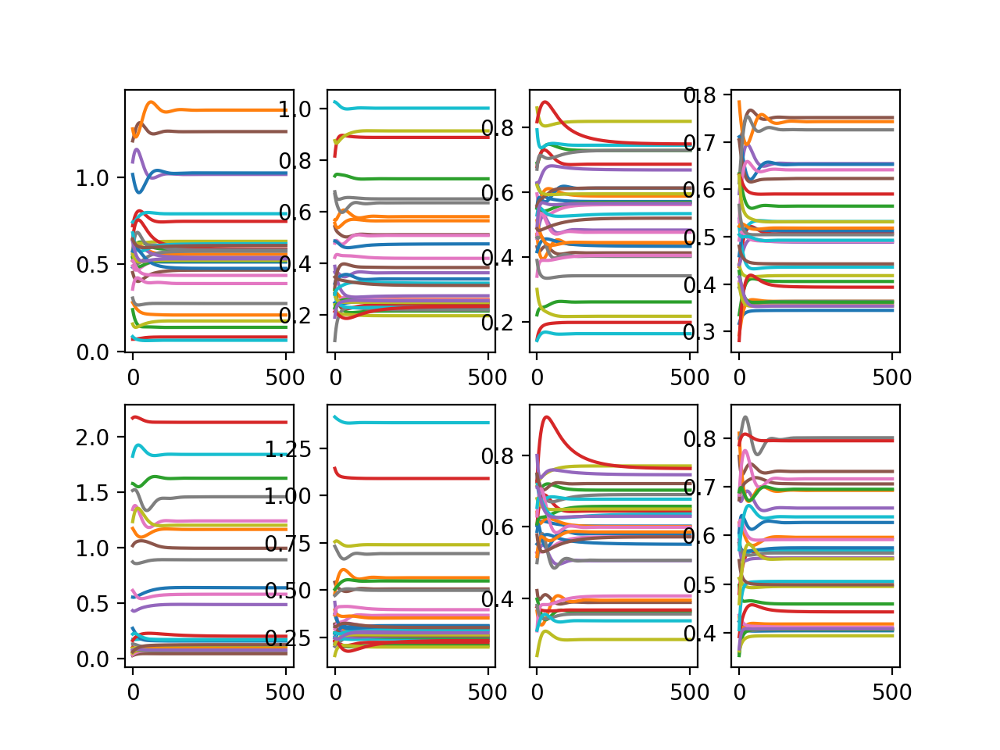

In [2104]:
plt.figure()
for icelltype in range(8):
    plt.subplot(2,4,icelltype+1)
    plt.plot(YY_ctrl[:,:,icelltype].T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


<IPython.core.display.Javascript object>


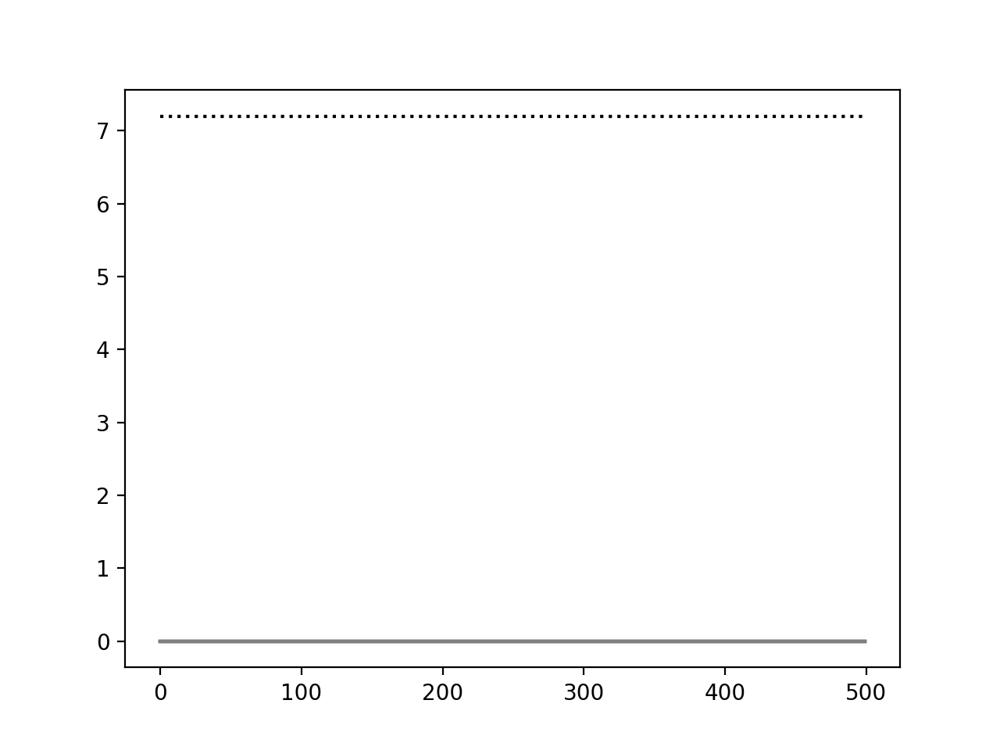

In [2105]:
istim = 29
iy = 0
others = np.arange(8)!=iy
# this_yy = YY_F2[iy,istim,:,iinit,:,:]
this_yy = YY_ss[iy,istim,:,:,:]
def fY(XX,YY):
    return compute_f_(resEta[istim]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[istim]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
speed = np.sum(np.abs(fY(XX[istim],this_yy)-this_yy)[:,:,others],-1)
plt.figure()
this_one = 25
plt.plot(speed[this_one,-500:].T,c='k',linestyle='dotted')
plt.plot(YY_ss[iy,istim,this_one,-500:,:])

In [1414]:
fY(XX[istim],this_yy).shape

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: overflow encountered in square
  


(50, 4001, 8)

<IPython.core.display.Javascript object>


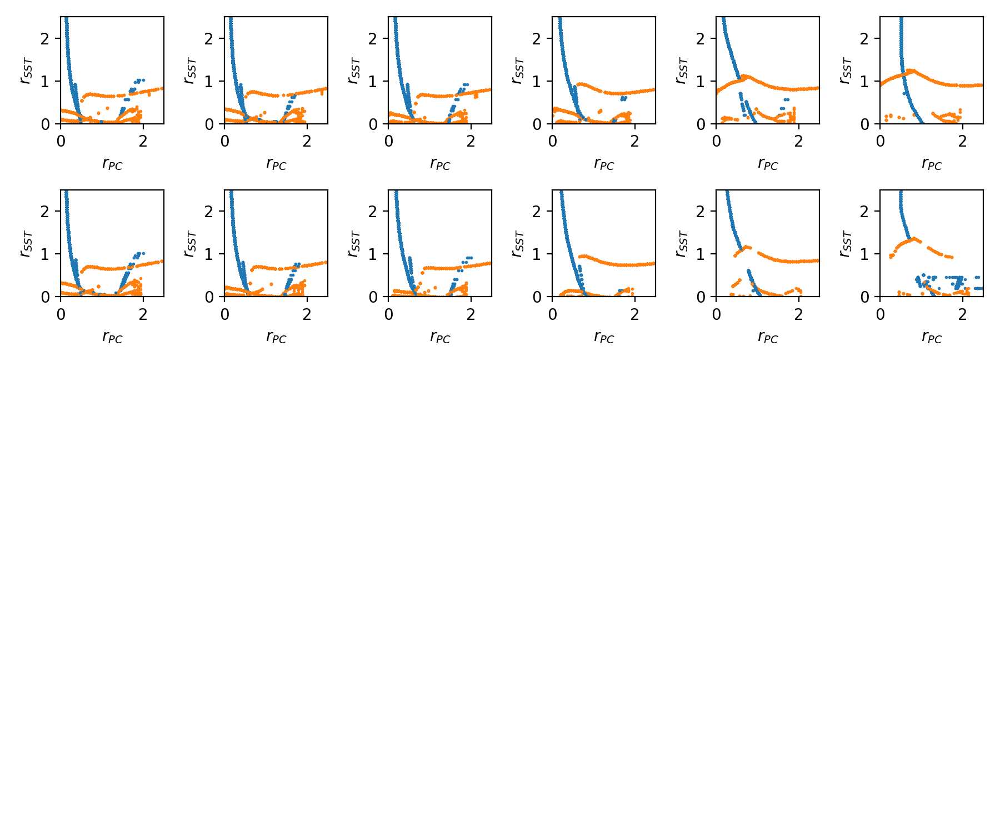

In [1399]:
mag = 1.5
plt.figure(figsize=(ncontrast*mag,nsize*mag))
# YY = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
ix = 0
iy = 1
idir = 0
for yy in [YY_F2]:
    linestyles = ['solid','dashed']
    for istim in range(12):#Nstim):
        def fY(YY):
            return compute_f_(resEta[stim_vals[istim]]+u_fn(XX[stim_vals[istim]],YY,Wmx,Wmy,k,kappa),resXi[stim_vals[istim]]+u_fn(XX[stim_vals[istim]],YY,Wsx,Wsy,k,kappa),s02)
        plt.subplot(nsize,ncontrast,stim_vals[istim]+1)
        for it in (-250,-100,-1):
            for iinit in range(Nx):
                this_yy = yy[iy,istim,:,iinit,it,:]
                xvals = yy[iy,istim,:,iinit,it,ix]
                gd = (xvals < max_val) & np.sum(np.abs(fY(this_yy)-this_yy),-1)<1e-4
                plt.scatter(xvals[gd],yvals[gd],label='$dr_{PC}/dt=0$',c='C0',linestyle=linestyles[idir],s=1)
                xvals = yy[ix,istim,:,iinit,it,iy]
                gd = xvals < max_val
                plt.scatter(yvals[gd],xvals[gd],label='$dr_{SST}/dt=0$',c='C1',linestyle=linestyles[idir],s=1)
    #     plt.legend()
        plt.xlabel('$r_{%s}$' % lbls[ix])
        plt.ylabel('$r_{%s}$' % lbls[iy])
#         plt.axis('equal')
        plt.ylim((0,1*max_val))
        plt.xlim((0,1*max_val))
    plt.tight_layout()

<IPython.core.display.Javascript object>


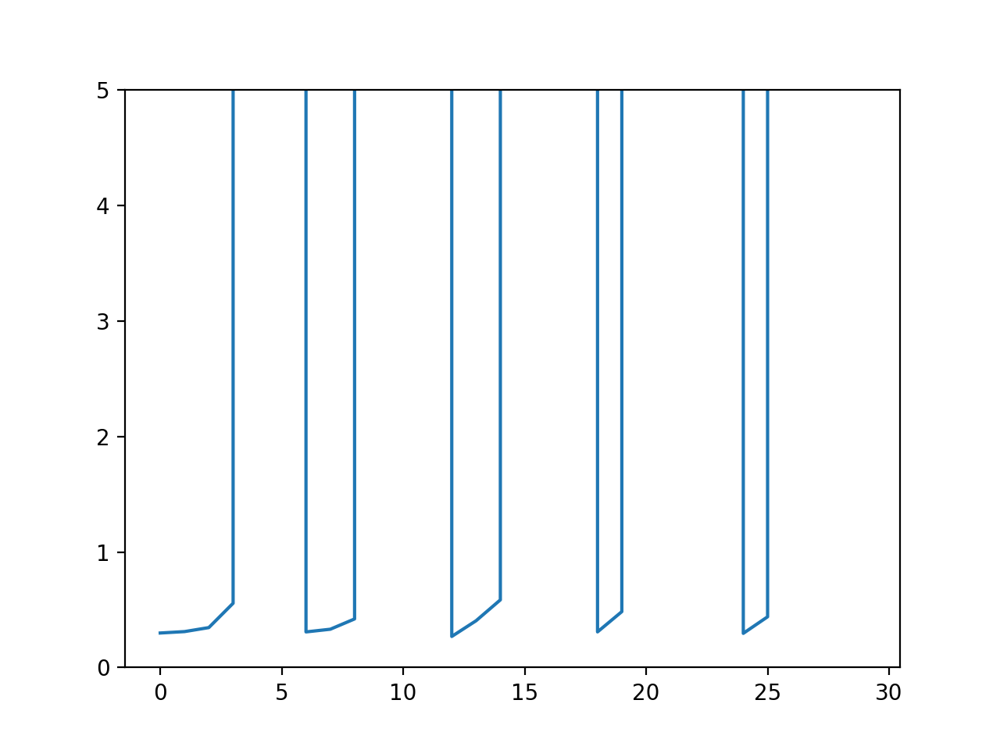

(0, 5)

In [873]:
plt.figure()
plt.plot(YY[iy,:,0,it,ix])
plt.ylim((0,5))

<IPython.core.display.Javascript object>


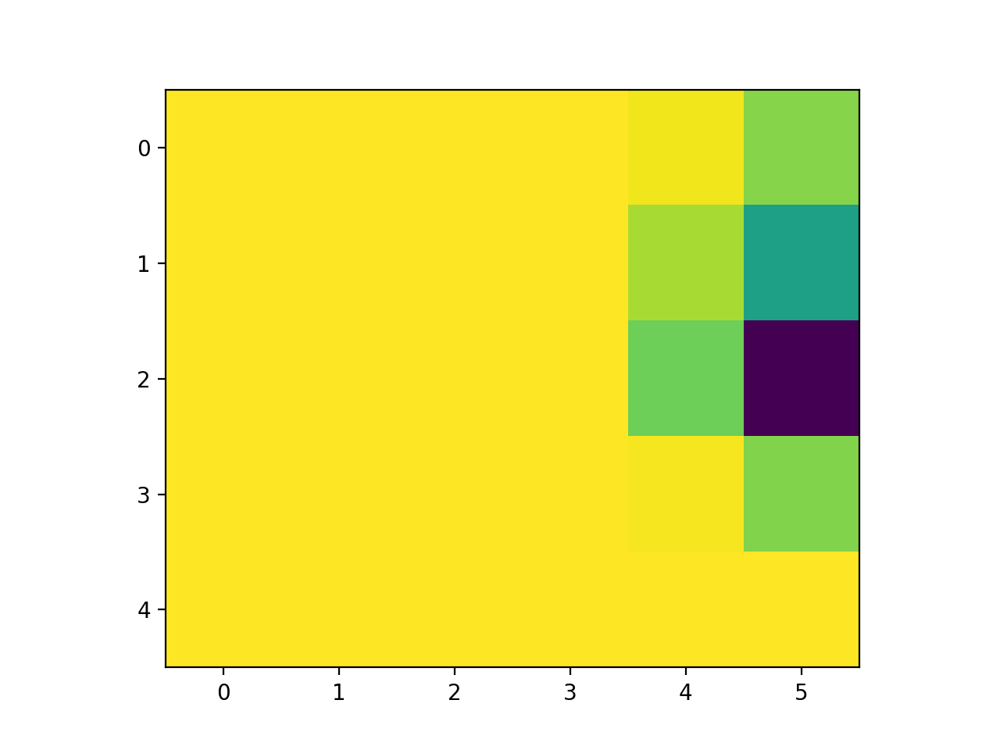

In [464]:
plt.figure()
istim = -12
plt.imshow((YY[0][:,1000,0]-YY[0][:,-1,0]).reshape((nsize,ncontrast)))

In [424]:
YY[0].shape

(30, 2001, 8)

<IPython.core.display.Javascript object>


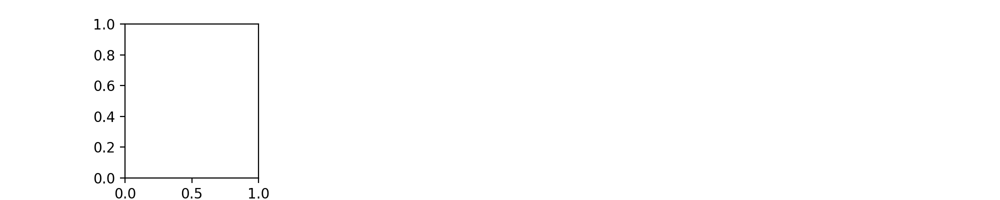

IndexError: too many indices for array

In [1268]:
mag = 2
plt.figure(figsize=(mag*ncelltypes,mag))
for icelltype in range(nQ):
    plt.subplot(1,ncelltypes,icelltype+1)
    plt.imshow(YY[:,:,-1,icelltype],vmin=0,interpolation='bilinear')
    plt.axis('off')

In [1278]:
nstar = len(trystars_i)
YY_no_vip = [None for istar in range(nstar)]
YY_no_sst = [None for istar in range(nstar)]
for istar in range(nstar):
    print(istar)
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    YY = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,YY,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,YY,Wsx,Wsy,k,kappa)
    def fY(XX,YY,resEta,resXi):
        return compute_f_(u_fn(XX,YY,Wmx,Wmy,k,kappa)+resEta,u_fn(XX,YY,Wsx,Wsy,k,kappa)+resXi,s02)
    def thisfY(YY0):
        return fY(XX,YY0,resEta,resXi)
    def predict_YY_silencing(YY0,XX,resEta,resXi,silenced,eta=1e-4):
        def dYYdt(YY):
            return -YY + thisfY(YY)
        YY = YY0.copy() #np.zeros((nN,nS*nQ))
        dYY = np.ones_like(YY)
        iiter = 0
        while iiter < 1e4: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            iiter = iiter+1
            dYY = eta*dYYdt(YY)
            YY = YY + dYY
            YY[:,silenced] = 0
        return YY
    silenced = np.array((0,0,1,0,0,0,1,0),dtype='bool')
    YY_no_vip[istar] = predict_YY_silencing(YY,XX,resEta,resXi,silenced)
    silenced = np.array((0,1,0,0,0,1,0,0),dtype='bool')
    YY_no_sst[istar] = predict_YY_silencing(YY,XX,resEta,resXi,silenced)

0


In [1224]:
# plt.figure()
# inputs = XXhat[:,[0,2]]
# sort_inp = np.argsort(inputs[:,0])
# plt.scatter(inputs[:,0],inputs[:,1])

<IPython.core.display.Javascript object>


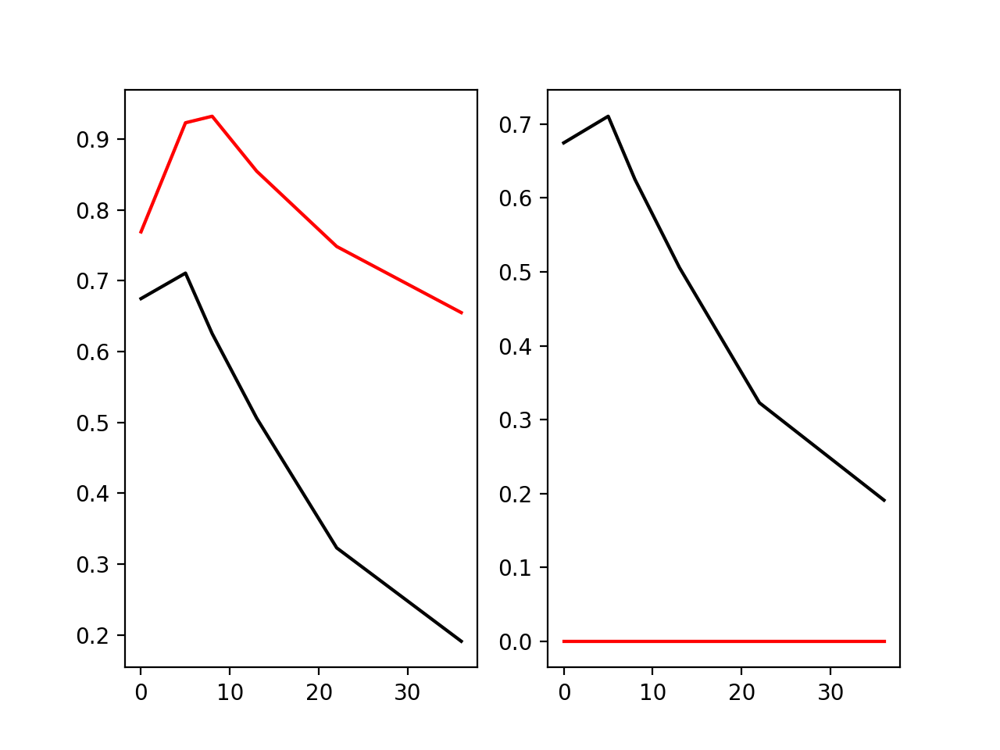

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:35: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


In [1270]:
plt.figure()
alpha1 = 0.25
ic = 2
icontrast = 5
colors = ['k','r']
def norm01(arr):
    return (arr-arr.min())/(arr.max()-arr.min())
for istar in range(nstar):
    ti,tj = trystars_i[istar],trystars_j[istar]
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
    YY = compute_f_(Eta,Xi,s02)
    plt.subplot(1,2,1)
    usize0 = (0,5,8,13,22,36)
    sc = YY[:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    if istar == 0:
        avg_curves = np.zeros((2,2,)+to_plot.shape)
    avg_curves[0,0] = avg_curves[0,0] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[0],alpha=alpha1)
    sc = YY_no_sst[istar][:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[0,1] = avg_curves[0,1] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[1],alpha=alpha1)
    plt.subplot(1,2,2)
    usize0 = (0,5,8,13,22,36)
    sc = YY[:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[1,0] = avg_curves[1,0] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[0],alpha=alpha1)
    sc = YY_no_vip[istar][:,ic].reshape((nsize,ncontrast))
    to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
    avg_curves[1,1] = avg_curves[1,1] + to_plot/nstar
    plt.plot(usize0,to_plot,c=colors[1],alpha=alpha1)
for imanip in range(2):
    plt.subplot(1,2,imanip+1)
    plt.plot(usize0,avg_curves[imanip,0],c=colors[0])
    plt.plot(usize0,avg_curves[imanip,1],c=colors[1])
    

<IPython.core.display.Javascript object>


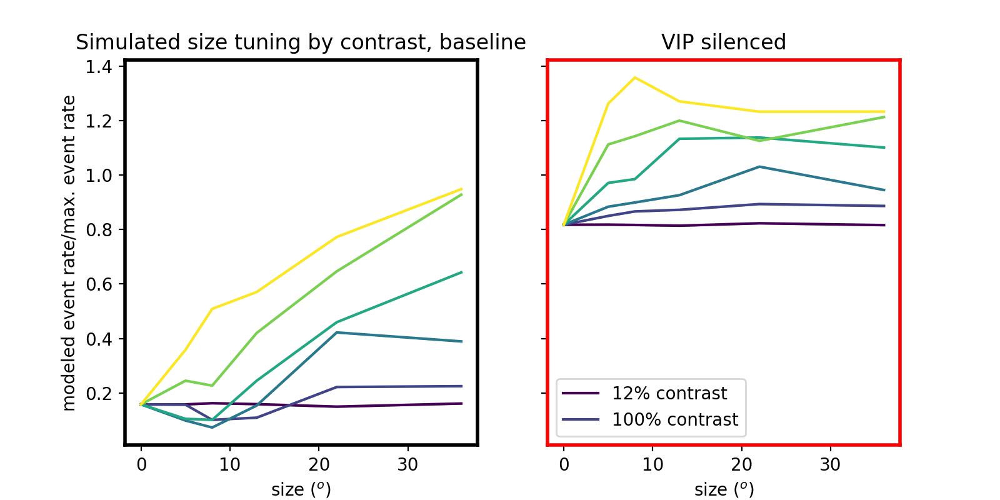

In [1281]:
fig,axes = plt.subplots(1,2,sharey=True,figsize=(8,4))
alpha1 = 0.25
ic = 1
icontrasts = np.arange(6)
colors = ['k','r']
colors = plt.cm.viridis(np.linspace(0,1,6))
nstar = 1
def norm01(arr):
    return (arr-arr.min())/(arr.max()-arr.min())
for icontrast in icontrasts:
    for istar in range(nstar):
        ti,tj = trystars_i[istar],trystars_j[istar]
        Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wt[ti][tj]
        YY = compute_f_(Eta,Xi,s02)
        usize0 = (0,5,8,13,22,36)
        sc = YY[:,ic].reshape((nsize,ncontrast))
        to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
        if istar == 0:
            avg_curves = np.zeros((2,2,)+to_plot.shape)
            to_plots = [np.zeros((0,)+to_plot.shape) for il in range(2)]
        avg_curves[1,0] = avg_curves[1,0] + to_plot/nstar
#         plt.subplot(1,2,1)
        to_plots[0] = np.concatenate((to_plots[0],to_plot[np.newaxis]))
#         plt.plot(usize0,to_plot,c=colors[icontrast],alpha=alpha1)
        sc = YY_no_vip[istar][:,ic].reshape((nsize,ncontrast))
        to_plot = np.concatenate(((sc[:,0].mean(),),sc[:,icontrast]))
        avg_curves[1,1] = avg_curves[1,1] + to_plot/nstar
#         plt.subplot(1,2,2)
#         plt.plot(usize0,to_plot,c=colors[icontrast],alpha=alpha1)
        to_plots[1] = np.concatenate((to_plots[1],to_plot[np.newaxis]))
    for il in range(2):
#         plt.subplot(1,2,il+1)
        axes[il].plot(usize0,avg_curves[1,il],c=colors[icontrast])
        lb,ub = ut.bootstrap(to_plots[il],pct=(16,84),fn=np.nanmean,axis=0)
        axes[il].fill_between(usize0,lb,ub,color=colors[icontrast],alpha=alpha1)
# plt.subplot(1,2,1)
# plt.title('Center-aligned, response to 12% contrast')
# plt.subplot(1,2,1)
axes[0].set_ylabel('modeled event rate/max. event rate')
axes[0].set_xlabel('size ($^o$)')
axes[1].set_xlabel('size ($^o$)')
plt.setp(axes[0].spines.values(),color='k',linewidth=2)
plt.setp(axes[1].spines.values(),color='r',linewidth=2)
axes[0].set_title('Simulated size tuning by contrast, baseline')
axes[1].set_title('VIP silenced')
axes[1].legend(['12% contrast','100% contrast'])
# plt.savefig('figures/modeled_vip_halo_size_tuning_by_contrast_fill_between.jpg',dpi=300)

In [428]:
(ti,),(tj,) = np.where(loss==np.min(loss)) #2*loss.min()
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = Wt[ti][tj]

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


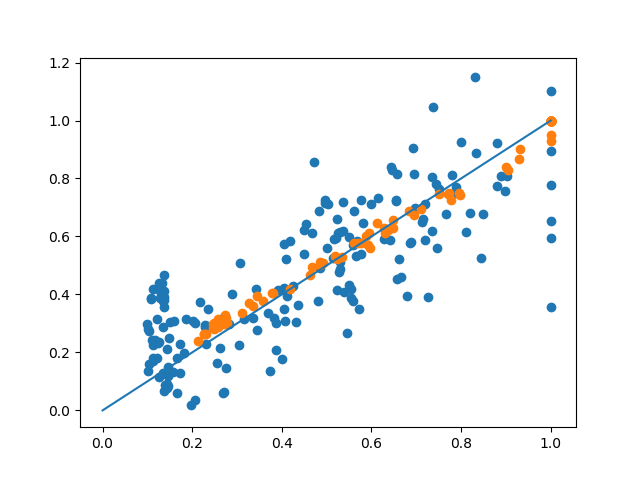

In [429]:
plt.figure()
XXhat = np.concatenate(Xhat,axis=1)
YYhat = np.concatenate(Yhat,axis=1)
plt.scatter(YYhat.flatten(),YY.flatten())
plt.scatter(XXhat.flatten(),XX.flatten())
plt.plot((0,1),(0,1))

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


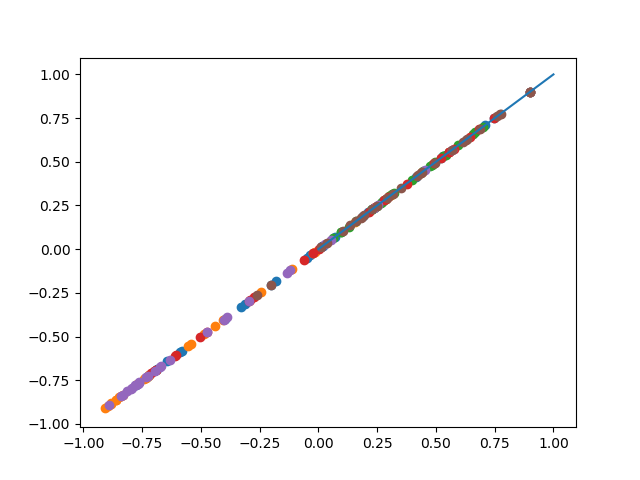

In [430]:
Etas = u_fn(XX,YY,Wmx,Wmy,k,kappa)
plt.figure()
for ic in range(6):
    plt.scatter(Eta[:,ic],Etas[:,ic])
plt.plot((0,1),(0,1))

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


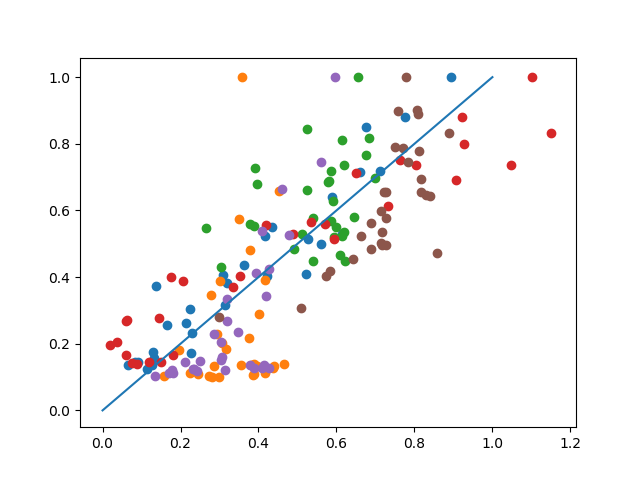

In [431]:
plt.figure()
YYs = compute_f_(Eta,Xi,s02)
for ic in range(6):
    plt.scatter(YY[:,ic],YYs[:,ic])
plt.plot((0,1),(0,1))

<IPython.core.display.Javascript object>


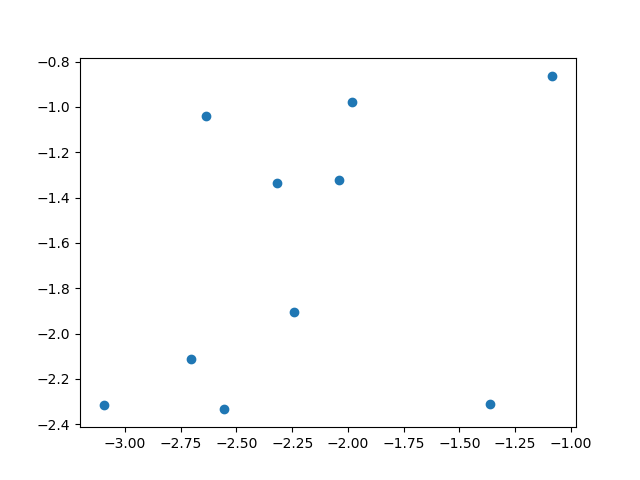

In [291]:
plt.figure()
plt.scatter(wmys[:,1,0],wmys[:,2,1])

In [514]:
wmys = np.concatenate([w[1][np.newaxis] for w in np.concatenate(Wt)],axis=0)
# trystar = np.argmax(wmys[:,1,0]*wmys[:,2,1])
# trystar = np.argmin(loss)

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


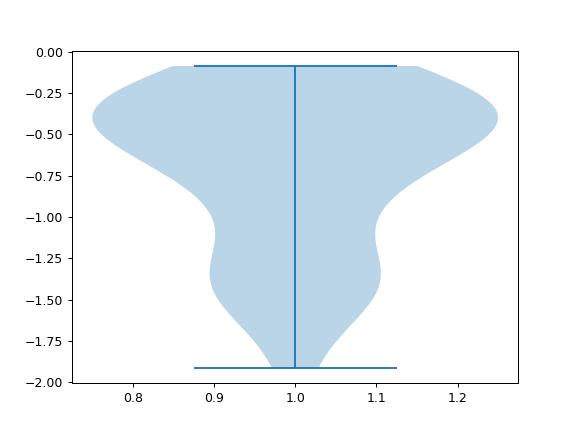

{'bodies': [<matplotlib.collections.PolyCollection at 0x7f1bdc083a90>],
 'cmaxes': <matplotlib.collections.LineCollection at 0x7f1bdb9cec50>,
 'cmins': <matplotlib.collections.LineCollection at 0x7f1bdc083790>,
 'cbars': <matplotlib.collections.LineCollection at 0x7f1bdc083990>}

In [516]:
plt.figure()
plt.violinplot(wmys[:,1,0])

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


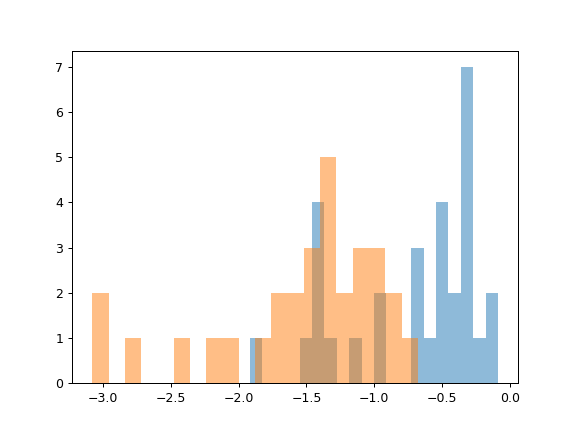

(array([2., 0., 1., 0., 0., 1., 0., 1., 1., 0., 1., 2., 2., 3., 5., 2., 3.,
        3., 2., 1.]),
 array([-3.08046601, -2.96038626, -2.84030651, -2.72022677, -2.60014702,
        -2.48006727, -2.35998753, -2.23990778, -2.11982804, -1.99974829,
        -1.87966854, -1.7595888 , -1.63950905, -1.51942931, -1.39934956,
        -1.27926981, -1.15919007, -1.03911032, -0.91903057, -0.79895083,
        -0.67887108]),
 <a list of 20 Patch objects>)

In [515]:
plt.figure()
plt.hist(wmys[:,1,0],bins=20,alpha=0.5)
plt.hist(wmys[:,2,1],bins=20,alpha=0.5)

In [518]:
ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws

In [541]:
ws = [np.concatenate([Wt[ti][tj][q][np.newaxis] for ti,tj in zip(trystars_i,trystars_j)],axis=0) for q in range(len(Wt[0][0]))]
[Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


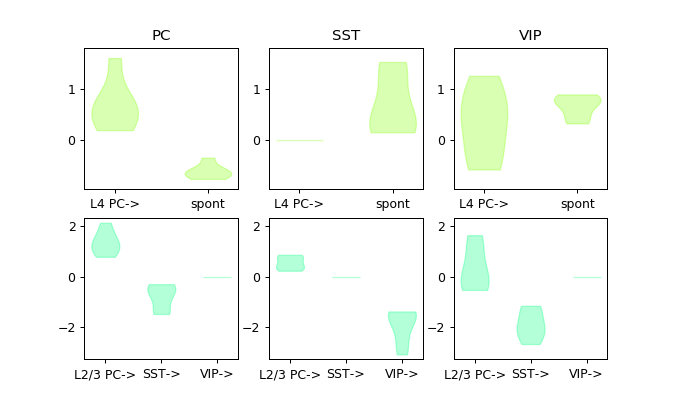

In [552]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(7.5,4.5))
for datas in [[Wmx,Wmy]]:#,[Wsx,Wsy]]:
    titles = ['PC','SST','VIP']
    data = datas[0]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L4 PC->','spont']
    for icelltype in range(3):
        plt.subplot(2,3,icelltype+1)
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.5,1,0.0])
            pc.set_edgecolor([0.5,1,0.0])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
        plt.title(titles[icelltype])
#     plt.figure(figsize=(7.5,2))
    data = datas[1]
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC->','SST->','VIP->']
    for icelltype in range(3):
        plt.subplot(2,3,3+icelltype+1)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
        violin_parts = plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
        for pc in violin_parts['bodies']:
            pc.set_facecolor([0.0,1,0.5])
            pc.set_edgecolor([0.0,1,0.5])
        plt.xticks(x,xlbl)
        plt.ylim(data.min()-0.2,data.max()+0.2)
#         plt.title(titles[icelltype])
plt.savefig('violinplots_fit_weights.jpg',dpi=300)

/home/mossing/anaconda3/envs/py3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


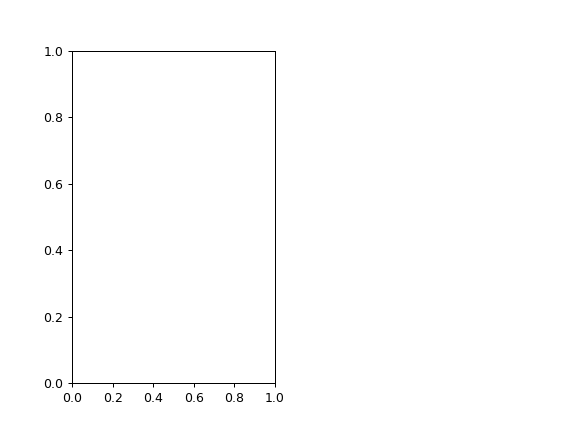

TypeError: list indices must be integers or slices, not tuple

In [543]:
plt.figure()
plt.subplot(1,2,1)
for ic in (0,):
    sca.scatter_size_contrast(YY[:,ic],YY_no_vip[:,ic])
    plt.plot((0,1),(0,1),c='k')
plt.axis('equal')
plt.subplot(1,2,2)
for ic in (0,):
    sca.scatter_size_contrast(YY[:,ic],YY_no_sst[:,ic])
    plt.plot((0,1),(0,1),c='k')
plt.axis('equal')

<IPython.core.display.Javascript object>


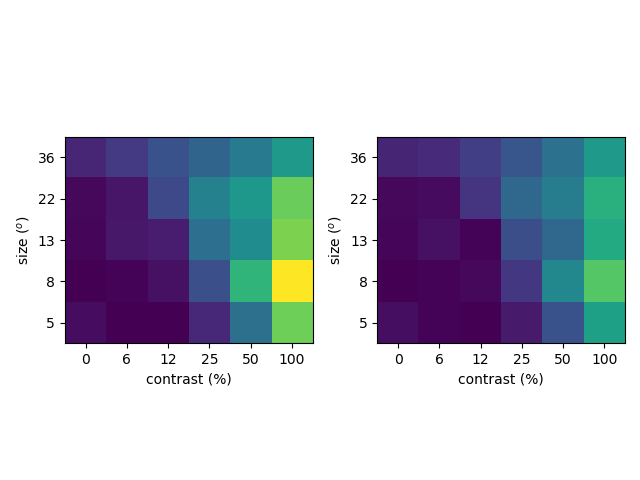

In [327]:
plt.figure()
ic = 0
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=YY[:,ic].max())
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_vip[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=YY[:,ic].max())
plt.tight_layout()

<IPython.core.display.Javascript object>


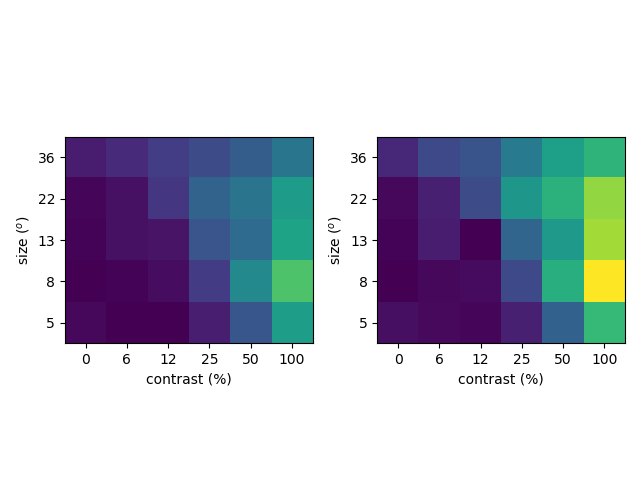

In [330]:
plt.figure()
ic = 0
mx = np.maximum(YY[:,ic].max(),YY_no_sst[:,ic].max())
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=mx)
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_sst[:,ic].reshape((nsize,ncontrast)),flipud=True,vmax=mx)
plt.tight_layout()

<IPython.core.display.Javascript object>


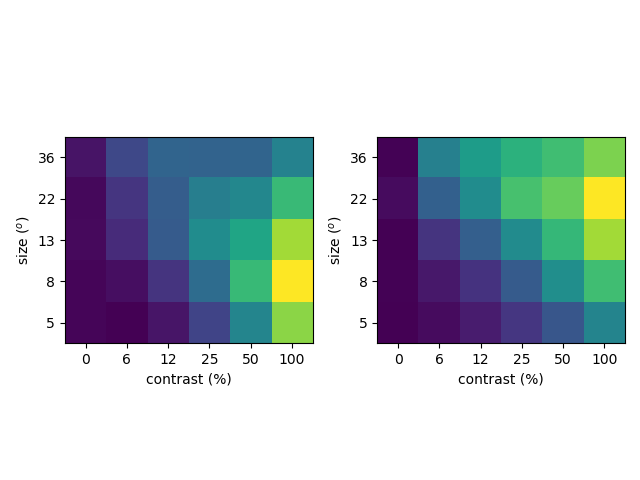

<IPython.core.display.Javascript object>


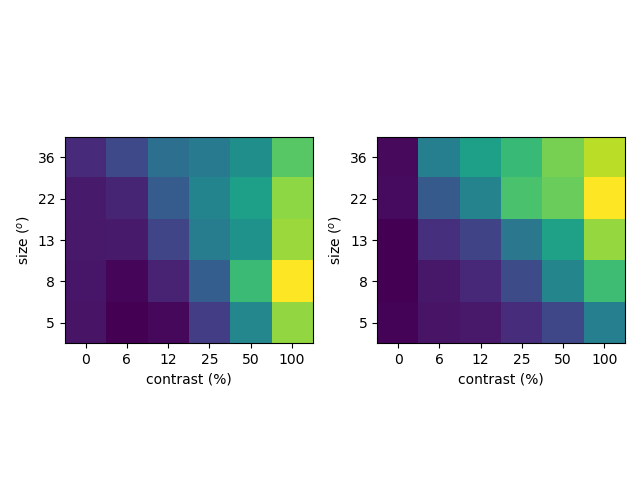

<IPython.core.display.Javascript object>


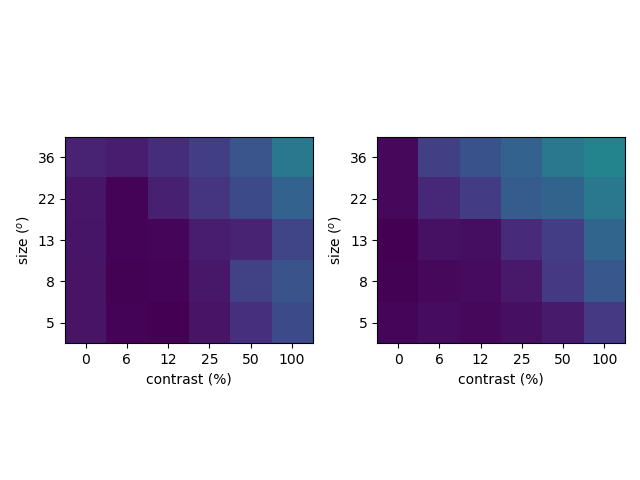

In [296]:
plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YYhat[:,0].reshape((5,6)),flipud=True)
plt.subplot(1,2,2)
sca.show_size_contrast(YYhat[:,3].reshape((5,6)),flipud=True)
plt.tight_layout()

plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YY[:,0].reshape((5,6)),flipud=True)
plt.subplot(1,2,2)
sca.show_size_contrast(YY[:,3].reshape((5,6)),flipud=True)
plt.tight_layout()

plt.figure()
reload(sca)
plt.subplot(1,2,1)
sca.show_size_contrast(YY_no_vip[:,0].reshape((5,6)),flipud=True,vmax=YY[:,0].max())
plt.subplot(1,2,2)
sca.show_size_contrast(YY_no_vip[:,3].reshape((5,6)),flipud=True,vmax=YY[:,3].max())
plt.tight_layout()

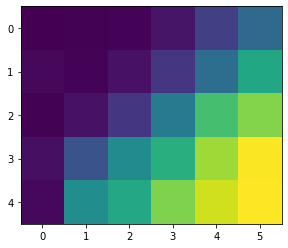

In [382]:
plt.figure()
plt.imshow(XX[:,2].reshape((5,6)))

In [383]:
vip_silencing = np.array((1,1,0,1,1,0))[np.newaxis,:]
Etas = u_fn(XX,YY,Wmx,Wmy,k)
Eta_no_vip = u_fn(XX,vip_silencing*YY,Wmx,Wmy,k) + Eta - Etas
YY_no_vip = compute_f_(Eta_no_vip,Xi,s02)*vip_silencing

In [ ]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','k','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [ ]:
evaluate_stability(W0my,k0)

In [ ]:
def sorted_r_eigs(w):
    drW,prW = np.linalg.eig(w)
    srtinds = np.argsort(drW)
    return drW[srtinds],prW[:,srtinds]

def gen_Weight(W,K):
    WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
    WW1 = np.concatenate((W*K[np.newaxis,:],W),axis=1)
    WW = np.concatenate((WW0,WW1),axis=0)
    return WW
    
def evaluate_stability(Wmy,k):
    W = gen_Weight(Wmy,k)
    drW,prW = sorted_r_eigs(W - np.eye(npixels*nQ))
    return np.real(drW[-1])

In [ ]:
t = 999
W0mx,W0my,W0sx,W0sy,s020,k0 = [Wstar_t2[i][t].copy() for i in range(6)]

In [ ]:
nbeta = 51
loss = np.zeros((nbeta,))
stability = np.zeros((nbeta,))
betas = np.linspace(-1,1,nbeta)
vecY = np.random.randn(nQ,nQ)
vecX = np.random.randn(nP,nQ)
for ibeta,beta in enumerate(betas):
    perturbationY = beta*vecY
    perturbationX = beta*vecX
#     perturbationY = beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
#     perturbationX = beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
#     perturbationSY = 0*beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
    Wmy_beta = perturbationY+W0my.copy()
    Wmx_beta = perturbationX+W0mx.copy()
#     Wsy_beta = perturbationSY+W0sy.copy()
    loss[ibeta] = evaluate_LW(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=Wmx_beta,W0my=Wmy_beta,W0sx=W0sx.copy(),W0sy=W0sy,s020=s020.copy(),k0=k0.copy(),bounds=bounds,weight=weight)
    stability[ibeta] = evaluate_stability(Wmy_beta,k0)

In [ ]:
plt.figure()
lkat = stability < 0
plt.plot(betas[lkat],loss[lkat])
plt.plot(betas[lkat],stability[lkat])
plt.ylim(-1,0.5)

In [ ]:
(betas[lkat][np.argmin(loss[lkat])],np.min(loss[lkat]))

In [ ]:
beta_star = betas[lkat][np.argmin(loss[lkat])]

In [ ]:
niter = int(1e3)
eta = 0.3
gamma = 0.9
weight = np.array((0,1,0))
beta = 0
perturbationY = beta*beta_star*vecY*1e-2
perturbationX = beta*beta_star*vecX*1e-2
# perturbationY = 0*beta*np.array(((-1,0,0),(0,0,-1),(0,-1,0))) #beta*np.array(((2,0,0),(0,0,0),(0,0,0))) #perturbationY = beta*np.array(((0,0,0),(0,0,-1),(0,0,0))) # np.array(((0,0,0),(-1,0,0),(0,0,0)))
# perturbationX = 0*beta*np.array(((-1,0,0),(0,0,0))) #beta*np.array(((-1,0,0),(0,0,0))) #perturbationX = beta*np.array(((0,0,1),(0,0,0)))
# # perturbationSY = beta*np.array(((0,0,0),(0,0,1),(0,0,0)))
# thisY0 = np.ones_like(Y0)
Y0 = [np.concatenate([x.mean(0)[:,np.newaxis] for x in Yhat[ialign]],axis=1) for ialign in range(npixels)]
Wstar_t2 = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=Y0.copy(),W0mx=perturbationX+W0mx.copy(),W0my=perturbationY+W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),k0=k0.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma,barrier_wt=100e-4)#,eta_decay=eta_decay)

In [ ]:
np.linalg.eig(Wstar_dict2['Wmy'][400]-np.eye(nQ))

In [ ]:
titles = ['PC','SST','VIP']
t = 500
plt.figure(figsize=(6,2))
lbl = 'Wmx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wmy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])
    
plt.figure(figsize=(6,2))
lbl = 'Wsx'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L4 PC->','spont']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])

plt.figure(figsize=(9,2))
lbl = 'Wsy'
data = Wstar_dict2[lbl][t]
x = np.arange(data.shape[0])
xlbl = ['L2/3 PC->','SST->','VIP->']
for icelltype in range(3):
    plt.subplot(1,3,icelltype+1)
    plt.bar(x,data[:,icelltype])
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.title(titles[icelltype])


In [ ]:
#Wstar_dict = np.load('w_over_time_miller_troyer_data_loss.npy',allow_pickle=True)[()]

In [ ]:
Wstar_t_init = [ww[-1].copy() for ww in Wstar_t2]
W0mx,W0my,W0sx,W0sy,s020 = [Wstar_t_init[i].copy() for i in range(5)]
Y0 = Wstar_t_init[-3].copy()

In [ ]:
niter = int(1e4)
eta = 1
gamma = 0.9
eta_decay = 1e-3
weight = np.array((1,1,1))
thisY0 = np.ones_like(Y0)
Wstar_t_novar = fit_W_momentum(X.copy(),Yhat.copy(),pop_rate_fn=f_miller_troyer,neuron_rate_fn=evaluate_f_mt,Y0=thisY0,W0mx=W0mx.copy(),W0my=W0my.copy(),W0sx=W0sx.copy(),W0sy=W0sy.copy(),s020=s020.copy(),bounds=bounds,niter=niter,weight=weight,eta=eta,gamma=gamma)#,eta_decay=eta_decay)

In [ ]:
# niter = int(1e3)
plt.figure()
for i in range(4):
    plt.subplot(2,2,i+1)
    plt.plot(Wstar_t2[i].reshape((niter+1,-1)))
plt.figure()
plt.plot(Wstar_t2[4].reshape((niter+1,-1)))

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
# Wstar_dict = {}
# for i,label in enumerate(labels):
#     Wstar_dict[label] = Wstar_t[i]
# np.save('w_over_time_miller_troyer_data_loss.npy',Wstar_dict,allow_pickle=True)

In [ ]:
# labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
#Wstar_dict = {}
#for i,label in enumerate(labels):
#    Wstar_dict[label] = Wstar_t[i]


In [ ]:
def plot_tuning_and_loss(this_Wstar):
    plt.figure()
    plt.plot((this_Wstar[-3]/this_Wstar[-3].sum(1)[:,np.newaxis]).reshape((niter+1,-1)))
    plt.figure()
    plt.plot(this_Wstar[-1].reshape((niter+1,-1)))

In [ ]:
#niter = 300
plot_tuning_and_loss([x[:niter+1] for x in Wstar_t2])

In [ ]:
def scatter_results_spatial(this_Wstar,t=-1):
    plt.figure(figsize=(9,6))
    celltype = ['PC','SST','VIP']
    ialign = 0
    for ialign in range(2):
        for i in range(3):
            plt.subplot(2,3,3*ialign+i+1)
            plt.title(celltype[i])
            xx = Yhat[ialign][i].mean(0)/Yhat[ialign][i].mean(0).sum()
            yy = this_Wstar[-3][t,:,3*ialign+i]/this_Wstar[-3][t,:,3*ialign+i].sum()
            sca.scatter_size_contrast(xx,yy)
            plt.plot((0,xx.max()),(0,xx.max()),c='k')
            plt.xlabel('measured')
            plt.ylabel('modeled')
            plt.tight_layout()

In [ ]:
t = 500
scatter_results_spatial(Wstar_t2,t=t) #int(5e3))
# plt.savefig('figures/pc_sst_vip_measured_modeled_miller_troyer.pdf')

In [ ]:
def gaussian_fn(mu,sigma):
    return lambda x: 1/np.sqrt(2*np.pi)/np.abs(sigma)*np.exp(-0.5*(x-mu)/sigma**2)
xs = np.linspace(0,1,100)
ipt = 0
# plt.figure()
# for icelltype in range(2):
#     plt.plot(xs,gaussian_fn(um_fn(X[ipt],Y[ipt])[icelltype],us_fn(X[ipt],Y[ipt])[icelltype])(xs))

In [224]:
iiter = -1
Wmx,Wmy,Wsx,Wsy = [Wstar_t[i][iiter] for i in range(4)]

def fXY(x,y):
    return f_miller_troyer(x @ Wmx + y @ Wmy, x @ Wsx + y @ Wsy)

def u_fn_fn(Wx,Wy):
    return lambda x,y: x @ Wx + y @ Wy

def um_fn(x,y):
    return u_fn_fn(Wmy,Wmx)(x,y)

def us_fn(x,y):
    return u_fn_fn(Wsy,Wsx)(x,y)

# Ysolns = compute_Y_nonlinear_t_evolution(X,Wmx,Wmy,Wsx,Wsy,f_miller_troyer,Y0=Wstar_t[-2][iiter+1].copy())

NameError: name 'Wstar_t' is not defined

In [327]:
Xlbl = [['L4','spont'],['PC','SST','VIP']]
Ylbl = ['PC','SST','VIP']

In [283]:
for i in range(2):
    values0 = np.round(Wstar_t_novar[i][-1],decimals=2)
    values1 = np.round(Wstar_t_novar[i+2][-1],decimals=2)
    to_print = np.zeros_like(values0,dtype='<U32')
    if np.mod(i,2)==0:
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Xlbl[0][i] + ' -> ' + Xlbl[1][j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    else: 
        for i in range(to_print.shape[0]):
            for j in range(to_print.shape[1]):
                to_print[i,j] = Ylbl[i] + ' -> ' + Ylbl[j] + ': ' + str(values0[i,j]) + ' +/- ' + str(values1[i,j])
    print(to_print)
    print('\n')
# for i in range(4,5):
#     values = np.round(Wstar_t[i][-1],decimals=2)
#     print(values)

NameError: name 'Wstar_t_novar' is not defined

<IPython.core.display.Javascript object>


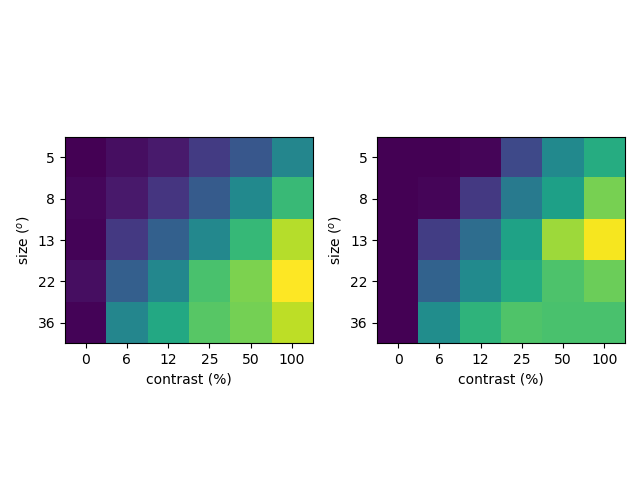

<IPython.core.display.Javascript object>


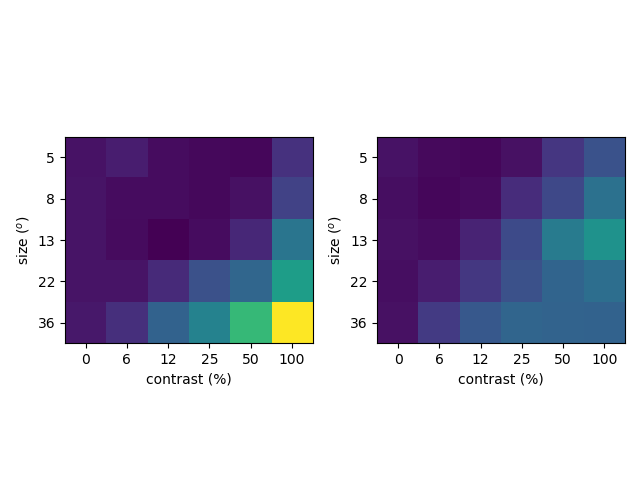

<IPython.core.display.Javascript object>


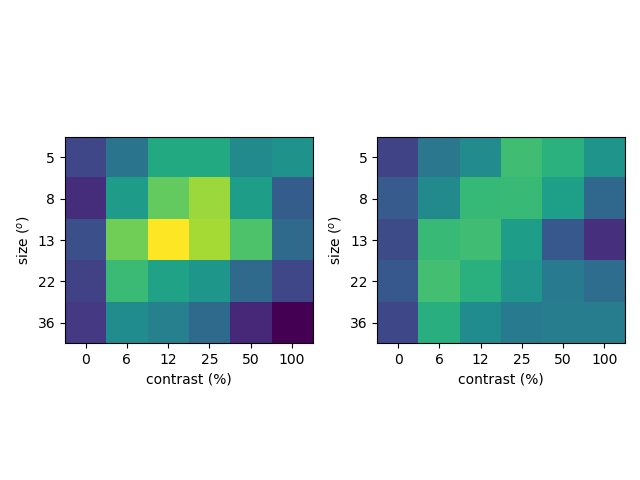

In [541]:
#lbl = ['pc','sst','vip']
#for icelltype in range(3):
#    this_Wstar = Wstar_t_novar
#    t = -1
#    display_model_fit(Yhat[icelltype].mean(0)/Yhat[icelltype].mean(0).sum(),this_Wstar[-3][t,:,icelltype]/this_Wstar[-3][t,:,icelltype].sum())
#    plt.savefig('figures/' + lbl[icelltype] + '_measured_modeled.pdf')

In [585]:
labels = ['Wmx','Wmy','Wsx','Wsy','s02','Y','momentum','loss']
Wstar_dict = {}
for i,label in enumerate(labels):
    Wstar_dict[label] = Wstar_t[i]

In [586]:
np.save('w_over_time_miller_troyer_data_loss_momentum.npy',Wstar_dict,allow_pickle=True)

In [270]:
def scatter_results(this_Wstar,t=-1):
    plt.figure(figsize=(9,3))
    celltype = ['PC','SST','VIP']
    for i in range(3):
        plt.subplot(1,3,i+1)
        plt.title(celltype[i])
        xx = Yhat[i].mean(0)/Yhat[i].mean(0).sum()
        yy = this_Wstar[-3][t,:,i]/this_Wstar[-3][t,:,i].sum()
        sca.scatter_size_contrast(xx,yy)
        plt.plot((0,xx.max()),(0,xx.max()),c='k')
        plt.xlabel('measured')
        plt.ylabel('modeled')
        plt.tight_layout()

In [1]:
icelltype = 3
u,s,v = np.linalg.svd(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])])
# plt.figure()
# plt.imshow(Rs[1][])

NameError: name 'np' is not defined

<IPython.core.display.Javascript object>


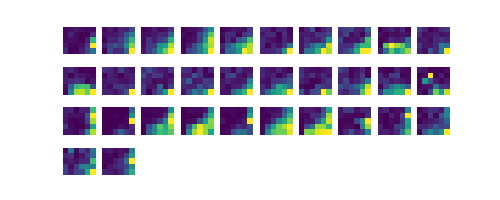

In [500]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


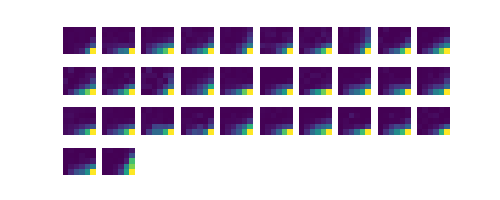

In [501]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]<np.percentile(u[:,0],5))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


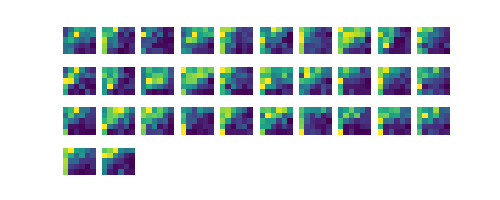

In [502]:
ut.imshow_in_rows(Rs[icelltype][~np.isnan(Rs[icelltype][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))

<IPython.core.display.Javascript object>


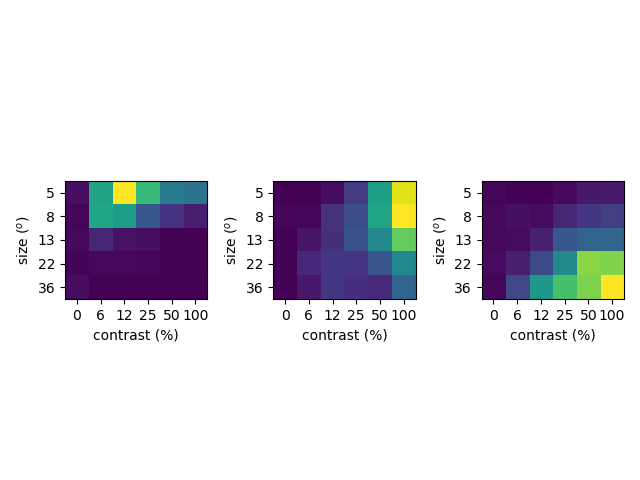

In [508]:
# ut.imshow_in_rows(Rs[1][~np.isnan(Rs[1][:,0])][np.where(u[:,0]>np.percentile(u[:,0],95))].reshape((-1,5,6)))
lower = np.where(u[:,0]<np.percentile(u[:,0],5))[0][28]
middle = np.where(np.logical_and(u[:,0]<np.percentile(u[:,0],52.5),u[:,0]>np.percentile(u[:,0],47.5)))[0][19]
upper = np.where(u[:,0]>np.percentile(u[:,0],95))[0][90]
plt.figure()
for i,thisone in enumerate([upper,middle,lower]):
    plt.subplot(1,3,i+1)
    sca.show_size_contrast(Rs[1][~np.isnan(Rs[1][:,0])][thisone].reshape((5,6)))
plt.tight_layout()
plt.savefig('figures/l23_pc_variability.pdf')

<IPython.core.display.Javascript object>


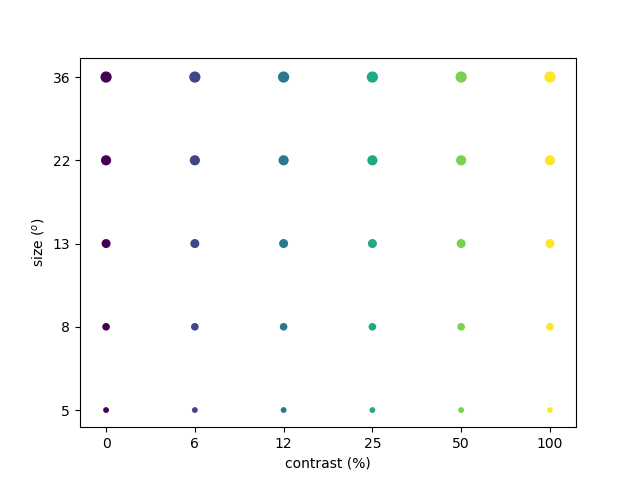

In [519]:
plt.figure()
xx,yy = np.meshgrid(np.arange(6),np.arange(5))
xx = xx.flatten()
yy = yy.flatten()
sca.scatter_size_contrast(xx,yy)
plt.xticks(np.arange(6),(0,6,12,25,50,100))
plt.xlabel('contrast (%)')
plt.yticks(np.arange(5),(5,8,13,22,36))
plt.ylabel('size ($^o$)')
plt.savefig('figures/measured_modeled_legend.pdf')
# plt.axis('off')

In [278]:
#niter = int(1e3)
#Ws = [Wstar_t[i][-1].copy() + 1e-2*np.random.randn(*Wstar_t[i][-1].shape) for i in range(4)]
#Wstar_t2 = fit_W_linearized_pointwise(X.copy(),Yhat.copy(),f_miller_troyer,Y0=Yhat.copy(),W0mx=Ws[0],W0my=Ws[1],W0sx=Ws[2],W0sy=Ws[3],bounds=bounds,niter=niter,weight=np.array((1,10,1)))
#scatter_results(Wstar_t2)

In [308]:
def pca_denoise(arr,Npc):
    u,s,v = np.linalg.svd(arr)
    return u[:,:Npc] @ np.diag(s[:Npc]) @ v[:Npc,:]

In [309]:
Rpc2 = pca_denoise(Rpc[~np.isnan(Rpc.sum(1))],10)

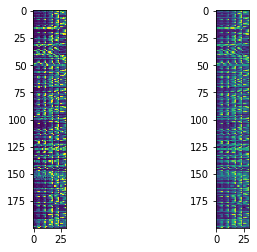

In [312]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(Rpc[:200])
plt.subplot(1,2,2)
plt.imshow(Rpc2[:200])